In [27]:
import pandas as pd
import numpy as np
import collections
from matplotlib import pyplot as plt

In [5]:
day1 = pd.read_csv("./lbnl.anon-ftp.03-01-11.csv")
day2 = pd.read_csv("./lbnl.anon-ftp.03-01-14.csv")
day3 = pd.read_csv("./lbnl.anon-ftp.03-01-18.csv")

In [6]:
day1.head()

,No.,Time,Source,Destination,Protocol,Length,Info
0,1,0.000000,142.164.6.70,131.243.1.10,TCP,62,1313 > 21 [SYN] Seq=1734984547 Win=8760 Len=...
1,2,0.000718,131.243.1.10,142.164.6.70,TCP,58,"21 > 1313 [SYN, ACK] Seq=1166102836 Ack=1734..."
2,3,2.962409,142.164.6.70,131.243.1.10,TCP,62,1313 > 21 [SYN] Seq=1734984547 Win=8760 Len...
3,4,3.000339,131.243.1.10,142.164.6.70,TCP,58,"21 > 1313 [SYN, ACK] Seq=1166102836 Ack=173..."
4,5,4.695735,142.164.6.70,131.243.1.10,TCP,54,1313 > 21 [ACK] Seq=1734984548 Ack=116610283...


In [21]:
day1.iloc[-1]

No.                                        282746
Time                                        86386
Source                               131.243.2.12
Destination                         16.69.134.221
Protocol                                      FTP
Length                                         80
Info           Response: 500 Illegal PORT Command
Name: 282745, dtype: object

In [9]:
day1['Source'].value_counts()

131.243.2.12       59441
131.243.1.10       40445
107.34.21.92       14827
128.3.28.48         9941
203.174.5.11        9569
157.231.148.18      8074
136.118.224.122     7616
131.201.66.31       7169
211.57.73.255       6456
143.156.1.2         6126
45.20.44.38         5868
73.6.91.115         4994
82.143.24.12        4486
100.249.76.9        4358
165.252.43.195      4334
92.209.69.32        4031
236.135.226.142     3830
79.37.53.67         3735
38.93.253.216       3025
16.69.134.221       3003
45.7.36.127         2524
128.3.12.44         2521
246.94.203.142      2506
130.24.176.37       2252
169.92.87.70        2145
64.37.1.243         2028
140.95.236.81       1910
121.204.82.134      1712
83.1.240.233        1670
155.127.0.177       1495
                   ...  
129.95.100.98          9
171.153.201.216        8
136.107.80.219         8
168.29.177.209         8
201.218.43.164         8
141.25.137.236         7
234.147.130.114        7
57.171.69.110          7
194.208.35.238         7


In [10]:
day1['Destination'].value_counts()

131.243.2.12       112306
203.174.5.11        17269
131.243.1.10        14261
128.3.28.48          9521
107.34.21.92         7516
45.20.44.38          6324
157.231.148.18       5918
136.118.224.122      3830
131.201.66.31        3655
211.57.73.255        3279
143.156.1.2          3151
73.6.91.115          2535
128.3.12.44          2531
82.143.24.12         2431
79.37.53.67          2220
100.249.76.9         2201
165.252.43.195       2181
92.209.69.32         2022
236.135.226.142      1966
38.93.253.216        1579
16.69.134.221        1512
113.170.127.199      1460
244.30.184.242       1284
45.7.36.127          1275
246.94.203.142       1275
120.221.194.180      1145
130.24.176.37        1135
169.92.87.70         1087
64.37.1.243          1026
92.222.78.98          987
                    ...  
22.97.19.4             11
253.226.179.73         11
6.30.34.164            11
102.237.40.194         10
200.131.126.75         10
171.153.201.216        10
201.218.43.164          9
129.95.100.9

In [12]:
day1.shape

(282746, 7)

In [49]:
[1,2,3].index(52)

ValueError: 52 is not in list

TypeError: unsupported operand type(s) for +: 'int' and 'NoneType'

In [157]:
"vdvfs".find("vf")

2

In [221]:
def list_finder(li,tup):
    li2 = [ i[:-1] for i in li]
    try:
        ans = li2.index(tup)
    except:
        return -1
    return ans

def find_unique_tcps(df):
    clients = []; servers=[];  #unique clients and servers
    unique=[]      #unique TCP flows
    time_array=[]  #hourly initiation times of TCP flows
    syn_array=[]   #array of syn packets
    fin_array=[]   #array of fin/rst packets
    size_array_recv=[]  #bytes received during the connection  --fix error
    size_array_send=[]  #bytes sent during the connection  --fix error
    arrivals=[]   #time of opening new TCP connections
    inter_arrivals=[]  #interarrival times between two TCP connections being opened
    elapsed_size=[]
    elapsed=[]  #time elapsed between opening and closing a TCP connection
    elapsed_sent=[]  #times of sending new packets to the servers
    elapsed_sent_inter=[]
    sent_bytes=[]  #bytes sent by the client to server
    recv_bytes=[]  #bytes received by the client from the server 
    signal_ack_dict = {}  #sequence numbers of the signals sent by the server and the corresponding ACKS
    for i in range(df.shape[0]):
        if(df.iloc[i]['Protocol']=='TCP'):
            src = df.iloc[i]['Source']
            dest = df.iloc[i]['Destination']
            info = df.iloc[i]['Info'].strip()
            time = df.iloc[i]["Time"]
            length = df.iloc[i]["Length"]
            pos_right_arrow = info.find(">")
            pos_open_brack = info.find("[")
            pos_close_brack = info.find("]")
            inside_bracks = info[pos_open_brack+1:pos_close_brack]
            
            if("Seq=" in info):
                seq_pos = info.find("Seq=")
                space_after_seq = info[seq_pos:].find(" ")
                seq_no = info[seq_pos+4:seq_pos+space_after_seq]
            else:
                seq_no=-1
            print("seq_no:",seq_no) 
            if("Ack=" in info):
                ack_pos = info.find("Ack=")
                space_after_ack = info[ack_pos:].find(" ")
                ack_no = info[ack_pos+4:ack_pos+space_after_ack]
            else:
                ack_no = -1
            print("ack_number:",ack_no)
            
            src_port = info[:pos_right_arrow-2]
            dest_port = info[pos_right_arrow+3: pos_open_brack-1]
            id_tup = src,dest,src_port,dest_port
            print(id_tup)
            syn = info[pos_open_brack:pos_open_brack+5]
            #print(syn)
            if(syn=="[SYN]"):
                #print("added syn")
                if(src not in clients):
                    clients.append(src)
                if(dest not in servers):
                    servers.append(dest)
                    
                if not (1 + list_finder(syn_array,(src,dest,src_port,dest_port))):
                    syn_array.append((src,dest,src_port,dest_port,time))
                    size_array_recv.append(0); size_array_send.append(0)
                    arrivals.append(time)
                
            if 1+list_finder(syn_array,(src,dest,src_port,dest_port)):
                print("yo")
                syn_idx = list_finder(syn_array,(src,dest,src_port,dest_port))
                print(syn_idx, length)
                elapsed_sent.append(time)
                size_array_send[syn_idx]+=length
                
                if("ACK" in inside_bracks):
                    try:
                        print(dest,src,dest_port,src_port)
                        li = signal_ack_dict[(dest,src,dest_port,src_port)]
                        print(li)
                        print("seq_no: ",seq_no)
                        for element_no in range(len(li)):
                            element=li[element_no]
                            if(element[0].strip()==seq_no.strip() and element[2]==0):
                                print(element[2],time)
                                li[element_no]=(li[element_no][0],li[element_no][1],time)
                                signal_ack_dict[(dest,src,dest_port,src_port)] = li
                                print(signal_ack_dict[(dest,src,dest_port,src_port)])
                                print("FILLED TIME")
                                break
                    except:
                        prin("some trouble")
                    
                sent_bytes.append(length)
                
            if 1+list_finder(syn_array,(dest,src,dest_port,src_port)):
                print("oy")
                print(syn_idx, length)
                syn_idx = list_finder(syn_array,(dest,src,dest_port,src_port))
                size_array_recv[syn_idx]+=length
                try:
                    signal_ack_dict[id_tup] = signal_ack_dict[id_tup] + (ack_no, time, 0)
                except:
                    signal_ack_dict[id_tup] = [(ack_no, time, 0)]
                recv_bytes.append(length)
                
            if(syn[1:-1]=="FIN" or syn[1:-1]=='RST'):
                #print("in fin")
                if 1+list_finder(syn_array, id_tup):
                    dummy_idx = list_finder(syn_array,id_tup)
                    size_array_send[dummy_idx]+=length
                    #print(dummy_idx)
                    elapsed.append(time - syn_array[dummy_idx][-1])
                    elapsed_size.append((size_array_send[dummy_idx],size_array_recv[dummy_idx]))
                    del size_array_recv[dummy_idx]; del size_array_send[dummy_idx]
                    del syn_array[dummy_idx]
                    
                elif 1+list_finder(syn_array,(dest,src,dest_port,src_port)):
                    dummy_idx = list_finder(syn_array,(dest,src,dest_port,src_port))
                    size_array_recv[dummy_idx]+=length
                    #print(dummy_idx)
                    elapsed_size.append((size_array_send[dummy_idx],size_array_recv[dummy_idx]))
                    elapsed.append(time - syn_array[dummy_idx][-1])
                    del syn_array[dummy_idx]
            
            if id_tup not in unique:
                unique.append(id_tup)
                time_array.append((float(time))//3600)
    
    for i in range(1,len(arrivals)):
        inter_arrivals.append((arrivals[i]-arrivals[i-1]))
        
    for i in range(1,len(elapsed_sent)):
        elapsed_sent_inter.append(elapsed_sent[i]-elapsed_sent[i-1])
        
    return clients,servers,unique,time_array,elapsed,elapsed_size,inter_arrivals, elapsed_sent_inter, sent_bytes,recv_bytes, signal_ack_dict

In [222]:
clients_d1,servers_d1,unique_d1,time_array_d1,elapsed_d1,elapsed_size_d1,inter_arrivals_d1, elapsed_sent_inter_d1, sent_bytes_d1,recv_bytes_d1, signal_ack_dict_d1 = find_unique_tcps(day1)

seq_no: 1734984547
ack_number: -1
('142.164.6.70', '131.243.1.10', '1313', '21')
yo
0 62
seq_no: 1166102836
ack_number: 1734984548
('131.243.1.10', '142.164.6.70', '21', '1313')
oy
0 58
seq_no: 1734984547
ack_number: -1
('142.164.6.70', '131.243.1.10', '1313', '21')
yo
0 62
seq_no: 1166102836
ack_number: 1734984548
('131.243.1.10', '142.164.6.70', '21', '1313')
oy
0 58
seq_no: 1734984548
ack_number: 1166102837
('142.164.6.70', '131.243.1.10', '1313', '21')
yo
0 54
131.243.1.10 142.164.6.70 21 1313
[('1734984548', 3.000339, 0)]
seq_no:  1734984548
0 4.695735
[('1734984548', 3.000339, 4.695735)]
FILLED TIME
seq_no: 1734984548
ack_number: 1166104151
('142.164.6.70', '131.243.1.10', '1313', '21')
yo
0 54
131.243.1.10 142.164.6.70 21 1313
[('1734984548', 3.000339, 4.695735)]
seq_no:  1734984548
seq_no: 1166104151
ack_number: 1734984564
('131.243.1.10', '142.164.6.70', '21', '1313')
oy
0 54
seq_no: 1734984564
ack_number: 1166104227
('142.164.6.70', '131.243.1.10', '1313', '21')
yo
0 54
131.2

seq_no:  1734985248
0 200.69391000000002
[('1734985248', 200.672719, 200.69391000000002)]
FILLED TIME
seq_no: 1166105742
ack_number: 1734985255
('131.243.1.10', '142.164.6.70', '21', '1313')
oy
0 54
seq_no: 1734985255
ack_number: 1166105771
('142.164.6.70', '131.243.1.10', '1313', '21')
yo
0 54
131.243.1.10 142.164.6.70 21 1313
[('1734985255', 202.237211, 0)]
seq_no:  1734985255
0 202.254929
[('1734985255', 202.237211, 202.254929)]
FILLED TIME
seq_no: 4190972923
ack_number: 364766454
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190972923
seq_no: 4190972949
ack_number: 364766484
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190972949
seq_no: 1734985255
ack_number: 1166105771
('142.164.6.70', '131.243.1.10', '1313', '21')
yo
0 54
131.243.1.10 142.164.6.70 21 1313
[('1734985255', 202.237211, 202.254929)]
seq_no:  1734985255


seq_no: 4190974405
ack_number: 364768164
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190974405
seq_no: 4190974431
ack_number: 364768194
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190974431
seq_no: 4190974457
ack_number: 364768224
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190974457
seq_no: 4190974483
ack_number: 364768254
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190974483
seq_no: 4190974509
ack_number: 364768284
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190974509
seq_no: 4190974535
ack_number: 364768314
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.2

seq_no: 184180266
ack_number: 3849372
('131.243.1.10', '67.243.63.146', '21', '1380')
oy
1 54
seq_no: 3849372
ack_number: 184180295
('67.243.63.146', '131.243.1.10', '1380', '21')
yo
1 54
131.243.1.10 67.243.63.146 21 1380
[('3849372', 398.728177, 0)]
seq_no:  3849372
0 399.233703
[('3849372', 398.728177, 399.233703)]
FILLED TIME
seq_no: 184180295
ack_number: 3849379
('131.243.1.10', '67.243.63.146', '21', '1380')
oy
1 54
seq_no: 4190975445
ack_number: 364769364
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190975445
seq_no: 184180324
ack_number: 3849386
('131.243.1.10', '67.243.63.146', '21', '1380')
oy
0 54
seq_no: 3849386
ack_number: 184180353
('67.243.63.146', '131.243.1.10', '1380', '21')
yo
1 54
131.243.1.10 67.243.63.146 21 1380
[('3849386', 399.990526, 0)]
seq_no:  3849386
0 400.527729
[('3849386', 399.990526, 400.527729)]
FILLED TIME
seq_no: 184180353
ack_number: 3849393
('131.243.1.10', '67.243

('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190976459
seq_no: 4190976485
ack_number: 364770564
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190976485
seq_no: 4190976511
ack_number: 364770594
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190976511
seq_no: 4190976537
ack_number: 364770624
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190976537
seq_no: 4190976563
ack_number: 364770654
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190976563
seq_no: 4190976589
ack_number: 364770684
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418

131.243.2.12 79.37.53.67 21 35478
[('76300487', 646.5186769999999, 0)]
seq_no:  76300504
seq_no: 76300510
ack_number: 443928662
('79.37.53.67', '131.243.2.12', '35478', '21')
yo
1 54
131.243.2.12 79.37.53.67 21 35478
[('76300487', 646.5186769999999, 0)]
seq_no:  76300510
seq_no: 76300510
ack_number: 443929153
('79.37.53.67', '131.243.2.12', '35478', '21')
yo
1 54
131.243.2.12 79.37.53.67 21 35478
[('76300487', 646.5186769999999, 0)]
seq_no:  76300510
seq_no: 4190978643
ack_number: 364773054
('73.6.91.115', '131.243.2.12', '2027', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 2027
[('4190971418', 105.474218, 0)]
seq_no:  4190978643
seq_no: 76300532
ack_number: 443929179
('79.37.53.67', '131.243.2.12', '35478', '21')
yo
1 54
131.243.2.12 79.37.53.67 21 35478
[('76300487', 646.5186769999999, 0)]
seq_no:  76300532
seq_no: 76300554
ack_number: 443929205
('79.37.53.67', '131.243.2.12', '35478', '21')
yo
1 54
131.243.2.12 79.37.53.67 21 35478
[('76300487', 646.5186769999999, 0)]
seq_no:  76300554

ack_number: 2645955292
('131.243.1.10', '172.211.70.122', '21', '40037')
oy
0 54
seq_no: 3678261592
ack_number: 2645955292
('131.243.1.10', '172.211.70.122', '21', '40037')
oy
0 54
seq_no: 2645955292
ack_number: 3678261593
('172.211.70.122', '131.243.1.10', '40037', '21')
seq_no: 2645955292
ack_number: 3678261593
('172.211.70.122', '131.243.1.10', '40037', '21')
seq_no: 3678261593
ack_number: 2645955293
('131.243.1.10', '172.211.70.122', '21', '40037')
seq_no: 2848098330
ack_number: -1
('180.69.204.185', '131.243.1.10', '1494', '21')
yo
2 74
seq_no: 121947253
ack_number: 2848098331
('131.243.1.10', '180.69.204.185', '21', '1494')
oy
2 58
seq_no: 2848098331
ack_number: 121947254
('180.69.204.185', '131.243.1.10', '1494', '21')
yo
2 54
131.243.1.10 180.69.204.185 21 1494
[('2848098331', 778.2793230000001, 0)]
seq_no:  2848098331
0 778.661834
[('2848098331', 778.2793230000001, 778.661834)]
FILLED TIME
seq_no: 2848098331
ack_number: 121948570
('180.69.204.185', '131.243.1.10', '1494', '21'

seq_no: 554447332
ack_number: 563782612
('79.37.53.67', '131.243.2.12', '33678', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 33678
[('554447177', 1460.818169, 0)]
seq_no:  554447332
seq_no: 554447354
ack_number: 563782638
('79.37.53.67', '131.243.2.12', '33678', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 33678
[('554447177', 1460.818169, 0)]
seq_no:  554447354
seq_no: 554447376
ack_number: 563782664
('79.37.53.67', '131.243.2.12', '33678', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 33678
[('554447177', 1460.818169, 0)]
seq_no:  554447376
seq_no: 554447398
ack_number: 563782690
('79.37.53.67', '131.243.2.12', '33678', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 33678
[('554447177', 1460.818169, 0)]
seq_no:  554447398
seq_no: 554447420
ack_number: 563782716
('79.37.53.67', '131.243.2.12', '33678', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 33678
[('554447177', 1460.818169, 0)]
seq_no:  554447420
seq_no: 554447426
ack_number: 563782716
('79.37.53.67', '131.243.2.12', '33678', '21')
yo
2 54
131.2

seq_no: 3739856342
ack_number: 3795674153
('131.243.1.10', '4.251.189.14', '21', '46315')
oy
0 54
seq_no: 3795674153
ack_number: 3739856397
('4.251.189.14', '131.243.1.10', '46315', '21')
yo
0 54
131.243.1.10 4.251.189.14 21 46315
[('3795674153', 1793.2364440000001, 0)]
seq_no:  3795674153
0 1793.4418600000001
[('3795674153', 1793.2364440000001, 1793.4418600000001)]
FILLED TIME
seq_no: 3795674153
ack_number: 3739856421
('4.251.189.14', '131.243.1.10', '46315', '21')
yo
0 54
131.243.1.10 4.251.189.14 21 46315
[('3795674153', 1793.2364440000001, 1793.4418600000001)]
seq_no:  3795674153
seq_no: 3739856421
ack_number: 3795674161
('131.243.1.10', '4.251.189.14', '21', '46315')
oy
0 54
seq_no: 3795674161
ack_number: 3739856441
('4.251.189.14', '131.243.1.10', '46315', '21')
yo
0 54
131.243.1.10 4.251.189.14 21 46315
[('3795674161', 1794.212431, 0)]
seq_no:  3795674161
0 1794.3000530000002
[('3795674161', 1794.212431, 1794.3000530000002)]
FILLED TIME
seq_no: 3739856441
ack_number: 3795674167


ack_number: 1533754042
('131.243.1.10', '62.87.148.206', '21', '20553')
oy
0 54
seq_no: 757796811
ack_number: 1533754073
('131.243.1.10', '62.87.148.206', '21', '20553')
oy
0 54
seq_no: 757796859
ack_number: 1533754105
('131.243.1.10', '62.87.148.206', '21', '20553')
oy
0 54
seq_no: 757796908
ack_number: 1533754120
('131.243.1.10', '62.87.148.206', '21', '20553')
oy
0 54
seq_no: 757796940
ack_number: 1533754136
('131.243.1.10', '62.87.148.206', '21', '20553')
oy
0 54
seq_no: 757796973
ack_number: 1533754166
('131.243.1.10', '62.87.148.206', '21', '20553')
oy
0 54
seq_no: 757797020
ack_number: 1533754183
('131.243.1.10', '62.87.148.206', '21', '20553')
oy
0 54
seq_no: 757797054
ack_number: 1533754205
('131.243.1.10', '62.87.148.206', '21', '20553')
oy
0 54
seq_no: 757797093
ack_number: 1533754232
('131.243.1.10', '62.87.148.206', '21', '20553')
oy
0 54
seq_no: 757797137
ack_number: 1533754251
('131.243.1.10', '62.87.148.206', '21', '20553')
oy
0 54
seq_no: 757797173
ack_number: 15337542

seq_no: 3813955667
ack_number: 723775885
('82.143.24.12', '131.243.2.12', '2433', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 2433
[('3813955108', 2414.8794589999998, 0)]
seq_no:  3813955667
seq_no: 3813955693
ack_number: 723775915
('82.143.24.12', '131.243.2.12', '2433', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 2433
[('3813955108', 2414.8794589999998, 0)]
seq_no:  3813955693
seq_no: 3813955720
ack_number: 723775945
('82.143.24.12', '131.243.2.12', '2433', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 2433
[('3813955108', 2414.8794589999998, 0)]
seq_no:  3813955720
seq_no: 3813955743
ack_number: 723775971
('82.143.24.12', '131.243.2.12', '2433', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 2433
[('3813955108', 2414.8794589999998, 0)]
seq_no:  3813955743
seq_no: 3813955768
ack_number: 723776001
('82.143.24.12', '131.243.2.12', '2433', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 2433
[('3813955108', 2414.8794589999998, 0)]
seq_no:  3813955768
seq_no: 3813955793
ack_number: 723776031
('82.143.

ack_number: 1903424755
('246.94.203.142', '203.174.5.11', '1070', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1070
[('3346926218', 2648.312753, 2648.4897309999997)]
seq_no:  3346926539
seq_no: 1280435694
ack_number: 1903872776
('79.37.53.67', '203.174.5.11', '34674', '21')
yo
1 54
203.174.5.11 79.37.53.67 21 34674
[('1280435421', 2661.298092, 0)]
seq_no:  1280435694
seq_no: 1280435716
ack_number: 1903872803
('79.37.53.67', '203.174.5.11', '34674', '21')
yo
1 54
203.174.5.11 79.37.53.67 21 34674
[('1280435421', 2661.298092, 0)]
seq_no:  1280435716
seq_no: 1280435738
ack_number: 1903872830
('79.37.53.67', '203.174.5.11', '34674', '21')
yo
1 54
203.174.5.11 79.37.53.67 21 34674
[('1280435421', 2661.298092, 0)]
seq_no:  1280435738
seq_no: 3346926564
ack_number: 1903424782
('246.94.203.142', '203.174.5.11', '1070', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1070
[('3346926218', 2648.312753, 2648.4897309999997)]
seq_no:  3346926564
seq_no: 1280435760
ack_number: 1903872857
('79.37.53.67',

2 58
seq_no: 17486729
ack_number: 3776346367
('53.55.176.50', '131.243.1.10', '10252', '21')
yo
2 54
131.243.1.10 53.55.176.50 21 10252
[('17486729', 2787.990222, 0)]
seq_no:  17486729
0 2788.224425
[('17486729', 2787.990222, 2788.224425)]
FILLED TIME
seq_no: 17486729
ack_number: 3776347681
('53.55.176.50', '131.243.1.10', '10252', '21')
yo
2 54
131.243.1.10 53.55.176.50 21 10252
[('17486729', 2787.990222, 2788.224425)]
seq_no:  17486729
seq_no: 3776347681
ack_number: 17486745
('131.243.1.10', '53.55.176.50', '21', '10252')
oy
2 54
seq_no: 3776347757
ack_number: 17486762
('131.243.1.10', '53.55.176.50', '21', '10252')
oy
2 54
seq_no: 3776347808
ack_number: 17486767
('131.243.1.10', '53.55.176.50', '21', '10252')
oy
2 54
seq_no: 3776347839
ack_number: 17486772
('131.243.1.10', '53.55.176.50', '21', '10252')
oy
2 54
seq_no: 3776347870
ack_number: 17486791
('131.243.1.10', '53.55.176.50', '21', '10252')
oy
2 54
seq_no: 3346928050
ack_number: 1903426393
('246.94.203.142', '203.174.5.11', '

seq_no: 17546574
ack_number: -1
('53.55.176.50', '131.243.1.10', '10122', '21')
yo
3 62
seq_no: 2578397407
ack_number: 17546575
('131.243.1.10', '53.55.176.50', '21', '10122')
oy
3 58
seq_no: 2616378104
ack_number: 17541630
('131.243.1.10', '53.55.176.50', '21', '10088')
oy
3 54
seq_no: 17546575
ack_number: 2578397408
('53.55.176.50', '131.243.1.10', '10122', '21')
yo
3 54
131.243.1.10 53.55.176.50 21 10122
[('17546575', 2847.821226, 0)]
seq_no:  17546575
0 2848.04966
[('17546575', 2847.821226, 2848.04966)]
FILLED TIME
seq_no: 2616378133
ack_number: 17541637
('131.243.1.10', '53.55.176.50', '21', '10088')
oy
3 54
seq_no: 17546575
ack_number: 2578398722
('53.55.176.50', '131.243.1.10', '10122', '21')
yo
3 54
131.243.1.10 53.55.176.50 21 10122
[('17546575', 2847.821226, 2848.04966)]
seq_no:  17546575
seq_no: 2578398722
ack_number: 17546591
('131.243.1.10', '53.55.176.50', '21', '10122')
oy
3 54
seq_no: 2616378162
ack_number: 17541644
('131.243.1.10', '53.55.176.50', '21', '10088')
oy
3 5

ack_number: 1903428097
('246.94.203.142', '203.174.5.11', '1070', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1070
[('3346926218', 2648.312753, 2648.4897309999997)]
seq_no:  3346929616
seq_no: 3346929641
ack_number: 1903428124
('246.94.203.142', '203.174.5.11', '1070', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1070
[('3346926218', 2648.312753, 2648.4897309999997)]
seq_no:  3346929641
seq_no: 3346929666
ack_number: 1903428151
('246.94.203.142', '203.174.5.11', '1070', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1070
[('3346926218', 2648.312753, 2648.4897309999997)]
seq_no:  3346929666
seq_no: 3346929691
ack_number: 1903428178
('246.94.203.142', '203.174.5.11', '1070', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1070
[('3346926218', 2648.312753, 2648.4897309999997)]
seq_no:  3346929691
seq_no: 3346929716
ack_number: 1903428205
('246.94.203.142', '203.174.5.11', '1070', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1070
[('3346926218', 2648.312753, 2648.4897309999997)]
seq_no:  33469

FILLED TIME
seq_no: 2120492377
ack_number: 2478888995
('24.83.76.105', '131.243.1.10', '1978', '21')
yo
2 54
131.243.1.10 24.83.76.105 21 1978
[('2120492377', 3059.311061, 3059.522837)]
seq_no:  2120492377
seq_no: 2478888995
ack_number: 2120492393
('131.243.1.10', '24.83.76.105', '21', '1978')
oy
2 54
seq_no: 2478889071
ack_number: 2120492410
('131.243.1.10', '24.83.76.105', '21', '1978')
oy
2 54
seq_no: 3346931489
ack_number: 1903430119
('246.94.203.142', '203.174.5.11', '1070', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1070
[('3346930629', 2993.085852, 2993.426257)]
seq_no:  3346931489
seq_no: 2478889122
ack_number: 2120492420
('131.243.1.10', '24.83.76.105', '21', '1978')
oy
0 54
seq_no: 2478889191
ack_number: 2120492428
('131.243.1.10', '24.83.76.105', '21', '1978')
oy
2 54
seq_no: 2478889258
ack_number: 2120492436
('131.243.1.10', '24.83.76.105', '21', '1978')
oy
2 54
seq_no: 2478889278
ack_number: 2120492442
('131.243.1.10', '24.83.76.105', '21', '1978')
oy
2 54
seq_no: 247888

4 58
seq_no: 17808434
ack_number: 2420190944
('53.55.176.50', '131.243.1.10', '10227', '21')
yo
4 54
131.243.1.10 53.55.176.50 21 10227
[('17808434', 3109.608941, 0)]
seq_no:  17808434
0 3109.825934
[('17808434', 3109.608941, 3109.825934)]
FILLED TIME
seq_no: 17808434
ack_number: 2420192258
('53.55.176.50', '131.243.1.10', '10227', '21')
yo
4 54
131.243.1.10 53.55.176.50 21 10227
[('17808434', 3109.608941, 3109.825934)]
seq_no:  17808434
seq_no: 2420192258
ack_number: 17808450
('131.243.1.10', '53.55.176.50', '21', '10227')
oy
4 54
seq_no: 2420192334
ack_number: 17808467
('131.243.1.10', '53.55.176.50', '21', '10227')
oy
4 54
seq_no: 17808467
ack_number: 2420192385
('53.55.176.50', '131.243.1.10', '10227', '21')
yo
4 54
131.243.1.10 53.55.176.50 21 10227
[('17808467', 3110.3099460000003, 0)]
seq_no:  17808467
0 3111.5551379999997
[('17808467', 3110.3099460000003, 3111.5551379999997)]
FILLED TIME
seq_no: 3346932126
ack_number: 1903430812
('246.94.203.142', '203.174.5.11', '1070', '21')


[('3346930629', 2993.085852, 2993.426257)]
seq_no:  3346933462
seq_no: 4097446272
ack_number: 855256481
('82.143.24.12', '131.243.2.12', '1628', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 1628
[('4097445608', 3150.0703559999997, 0)]
seq_no:  4097446272
seq_no: 3346933490
ack_number: 1903432285
('246.94.203.142', '203.174.5.11', '1070', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1070
[('3346930629', 2993.085852, 2993.426257)]
seq_no:  3346933490
seq_no: 4097446297
ack_number: 855256511
('82.143.24.12', '131.243.2.12', '1628', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 1628
[('4097445608', 3150.0703559999997, 0)]
seq_no:  4097446297
seq_no: 3346933515
ack_number: 1903432312
('246.94.203.142', '203.174.5.11', '1070', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1070
[('3346930629', 2993.085852, 2993.426257)]
seq_no:  3346933515
seq_no: 1117365431
ack_number: -1
('213.30.184.86', '131.243.1.10', '53045', '21')
yo
5 62
seq_no: 3002528668
ack_number: 1117365432
('131.243.1.10', '213.30.184

seq_no: 3596391
ack_number: -1
('114.201.61.120', '131.243.1.10', '1244', '21')
seq_no: 3596391
ack_number: -1
('114.201.61.120', '131.243.1.10', '1244', '21')
seq_no: 3596391
ack_number: -1
('114.201.61.120', '131.243.1.10', '1244', '21')
seq_no: 3596391
ack_number: -1
('114.201.61.120', '131.243.1.10', '1244', '21')
seq_no: 3596391
ack_number: -1
('114.201.61.120', '131.243.1.10', '1244', '21')
seq_no: 3596391
ack_number: -1
('114.201.61.120', '131.243.1.10', '1244', '21')
seq_no: 3596391
ack_number: -1
('114.201.61.120', '131.243.1.10', '1244', '21')
seq_no: 3596391
ack_number: -1
('114.201.61.120', '131.243.1.10', '1244', '21')
seq_no: 3596391
ack_number: -1
('114.201.61.120', '131.243.1.10', '1244', '21')
seq_no: 3596391
ack_number: -1
('114.201.61.120', '131.243.1.10', '1244', '21')
seq_no: 3599162
ack_number: 155443668
('114.201.61.120', '131.243.1.10', '1246', '21')
yo
1 54
131.243.1.10 114.201.61.120 21 1246
[('3599162', 3404.2877829999998, 0)]
seq_no:  3599162
0 3406.660421
[

seq_no: 2853901193
ack_number: 4234012771
('24.190.46.234', '131.243.1.10', '36078', '21')
yo
0 54
131.243.1.10 24.190.46.234 21 36078
[('2853901193', 3617.1186380000004, 0)]
seq_no:  2853901193
0 3617.210036
[('2853901193', 3617.1186380000004, 3617.210036)]
FILLED TIME
seq_no: 2853901193
ack_number: 4234012795
('24.190.46.234', '131.243.1.10', '36078', '21')
yo
0 54
131.243.1.10 24.190.46.234 21 36078
[('2853901193', 3617.1186380000004, 3617.210036)]
seq_no:  2853901193
seq_no: 4234012795
ack_number: 2853901194
('131.243.1.10', '24.190.46.234', '21', '36078')
seq_no: 4234012795
ack_number: 2853901194
('131.243.1.10', '24.190.46.234', '21', '36078')
seq_no: 2853901194
ack_number: 4234012796
('24.190.46.234', '131.243.1.10', '36078', '21')
seq_no: 1975234601
ack_number: -1
('79.37.53.67', '131.243.2.12', '36242', '21')
yo
0 62
seq_no: 957634500
ack_number: 1975234602
('131.243.2.12', '79.37.53.67', '21', '36242')
oy
0 62
seq_no: 1975234602
ack_number: 957634501
('79.37.53.67', '131.243.

ack_number: 1927234100
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
1 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899656271
seq_no: 2207732346
ack_number: 1019537557
('79.37.53.67', '131.243.2.12', '32918', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 32918
[('2207732143', 4204.74528, 0)]
seq_no:  2207732346
seq_no: 2207732368
ack_number: 1019537583
('79.37.53.67', '131.243.2.12', '32918', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 32918
[('2207732143', 4204.74528, 0)]
seq_no:  2207732368
seq_no: 2207732390
ack_number: 1019537609
('79.37.53.67', '131.243.2.12', '32918', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 32918
[('2207732143', 4204.74528, 0)]
seq_no:  2207732390
seq_no: 2207732412
ack_number: 1019537635
('79.37.53.67', '131.243.2.12', '32918', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 32918
[('2207732143', 4204.74528, 0)]
seq_no:  2207732412
seq_no: 899656298
ack_number: 1927234130
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
1 54

seq_no: 899658080
ack_number: 1927236110
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899658080
seq_no: 899658107
ack_number: 1927236140
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899658107
seq_no: 899658134
ack_number: 1927236170
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899658134
seq_no: 899658161
ack_number: 1927236200
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899658161
seq_no: 899658188
ack_number: 1927236230
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899658188
seq_no: 899658215
ack_number: 1927236260
('16

ack_number: 1927237880
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899659673
seq_no: 899659700
ack_number: 1927237910
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899659700
seq_no: 2738636382
ack_number: 1056027064
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738636382
seq_no: 2738636438
ack_number: 1056027124
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738636438
seq_no: 899659727
ack_number: 1927237940
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899659727
seq_no: 2738636550
ack_number: 1056027244
('157.231.148.18', '131.243

seq_no: 4076406589
ack_number: 4291927840
('198.132.228.204', '128.3.28.48', '4422', '21')
yo
2 54
128.3.28.48 198.132.228.204 21 4422
[('4076406589', 4530.133195, 0)]
seq_no:  4076406589
0 4530.97391
[('4076406589', 4530.133195, 4530.97391)]
FILLED TIME
seq_no: 899660753
ack_number: 1927239080
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899660753
seq_no: 2738643121
ack_number: 1056034270
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738643121
seq_no: 899660780
ack_number: 1927239110
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899660780
seq_no: 899660807
ack_number: 1927239140
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq

[('899654747', 4116.951948, 4117.150945)]
seq_no:  899661293
seq_no: 2507109542
ack_number: 1082128664
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507109542
seq_no: 899661320
ack_number: 1927239710
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899661320
seq_no: 2507109568
ack_number: 1082128694
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507109568
seq_no: 2738646920
ack_number: 1056038322
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738646920
seq_no: 2738646976
ack_number: 1056038382
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738646976
seq_

seq_no: 2460906481
ack_number: 1944896001
('79.37.53.67', '203.174.5.11', '35622', '21')
yo
6 54
203.174.5.11 79.37.53.67 21 35622
[('2460906481', 4619.392189, 0)]
seq_no:  2460906481
0 4619.572451
[('2460906481', 4619.392189, 4619.572451)]
FILLED TIME
seq_no: 899661941
ack_number: 1927240400
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899654747', 4116.951948, 4117.150945)]
seq_no:  899661941
seq_no: 2738650947
ack_number: 1056042630
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738650947
seq_no: 4089852967
ack_number: 49445278
('198.132.228.204', '128.3.28.48', '4437', '21')
yo
4 54
128.3.28.48 198.132.228.204 21 4437
[('4089852859', 4614.505805, 0)]
seq_no:  4089852967
seq_no: 2507110166
ack_number: 1082129384
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  250711016

yo
1 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738655204
seq_no: 899662589
ack_number: 1927241120
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899662481', 4659.424156, 4659.757616)]
seq_no:  899662589
seq_no: 2507110790
ack_number: 1082130104
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507110790
seq_no: 4101987955
ack_number: 103616436
('198.132.228.204', '128.3.28.48', '4454', '21')
yo
4 54
128.3.28.48 198.132.228.204 21 4454
[('4101987762', 4661.067646, 0)]
seq_no:  4101987955
seq_no: 2738655232
ack_number: 1056047212
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738655232
seq_no: 899662616
ack_number: 1927241150
('169.92.87.70', '203.174.5.11', '2722', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 2722
[('899662481', 4659.424

ack_number: 1056052820
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738660490
seq_no: 2738660546
ack_number: 1056052880
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738660546
seq_no: 2507111570
ack_number: 1082131004
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507111570
seq_no: 2507111596
ack_number: 1082131034
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507111596
seq_no: 4118879024
ack_number: 172236060
('198.132.228.204', '128.3.28.48', '4472', '21')
yo
3 54
128.3.28.48 198.132.228.204 21 4472
[('4118878914', 4725.908004, 0)]
seq_no:  4118879024
seq_no: 2507111622
ack_number: 1082131064
('107.34.21.92', '131.243.2.12', '4303', '21')

seq_no:  2738668855
seq_no: 2738668883
ack_number: 1056061780
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738668883
seq_no: 2507112818
ack_number: 1082132444
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507112818
seq_no: 2738668911
ack_number: 1056061810
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738668911
seq_no: 2738668939
ack_number: 1056061840
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738668939
seq_no: 2507112844
ack_number: 1082132474
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507112844
seq_no: 2507112870
ack_number: 1082132504
('107.

('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738673725
seq_no: 2507113650
ack_number: 1082133404
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507113650
seq_no: 2738673837
ack_number: 1056067078
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738673837
seq_no: 2507113676
ack_number: 1082133434
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507113676
seq_no: 2738674061
ack_number: 1056067318
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738674061
seq_no: 2738674145
ack_number: 1056067408
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.1

('128.3.28.48', '198.132.228.204', '21', '4556')
oy
2 62
seq_no: 2738679438
ack_number: 1056073070
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738679438
seq_no: 2507114482
ack_number: 1082134364
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507114482
seq_no: 2738679522
ack_number: 1056073160
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 1678
[('2738632242', 4402.474828, 0)]
seq_no:  2738679522
seq_no: 4184427904
ack_number: 443852153
('198.132.228.204', '128.3.28.48', '4556', '21')
yo
2 54
128.3.28.48 198.132.228.204 21 4556
[('4184427904', 4944.342751, 0)]
seq_no:  4184427904
0 4945.560945
[('4184427904', 4944.342751, 4945.560945)]
FILLED TIME
seq_no: 2738679578
ack_number: 1056073220
('157.231.148.18', '131.243.2.12', '1678', '21')
yo
0 54
131.243.2.12 157.231.148.18 

seq_no: 2695510318
ack_number: -1
('79.37.53.67', '203.174.5.11', '34960', '21')
yo
3 62
seq_no: 1949504000
ack_number: 2695510319
('203.174.5.11', '79.37.53.67', '21', '34960')
oy
3 58
seq_no: 2695510319
ack_number: 1949504001
('79.37.53.67', '203.174.5.11', '34960', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 34960
[('2695510319', 5007.169218, 0)]
seq_no:  2695510319
0 5007.34808
[('2695510319', 5007.169218, 5007.34808)]
FILLED TIME
seq_no: 2695510319
ack_number: 1949504082
('79.37.53.67', '203.174.5.11', '34960', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 34960
[('2695510319', 5007.169218, 5007.34808)]
seq_no:  2695510319
seq_no: 2507115314
ack_number: 1082135324
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507115314
seq_no: 2695510358
ack_number: 1949504208
('79.37.53.67', '203.174.5.11', '34960', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 34960
[('2695510319', 5007.169218, 5007.34808)]
seq_no:  2695

seq_no:  2507116978
seq_no: 2507117004
ack_number: 1082137274
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507117004
seq_no: 2507117030
ack_number: 1082137304
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507117030
seq_no: 2507117056
ack_number: 1082137334
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507117056
seq_no: 615344025
ack_number: 4228120314
('128.3.28.48', '198.132.228.204', '21', '4612')
oy
0 54
seq_no: 2507117082
ack_number: 1082137364
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507117082
seq_no: 2507117108
ack_number: 1082137394
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083',

FILLED TIME
seq_no: 2066898568
ack_number: 3798838148
('131.243.1.10', '255.143.100.71', '21', '2519')
oy
3 54
seq_no: 2066898579
ack_number: 3798838175
('131.243.1.10', '255.143.100.71', '21', '2519')
oy
3 54
seq_no: 2507118772
ack_number: 1082139314
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507118772
seq_no: 3798838175
ack_number: 2066898660
('255.143.100.71', '131.243.1.10', '2519', '21')
yo
3 54
131.243.1.10 255.143.100.71 21 2519
[('3798838175', 5274.381343999999, 0)]
seq_no:  3798838175
0 5275.313464
[('3798838175', 5274.381343999999, 5275.313464)]
FILLED TIME
seq_no: 2507118798
ack_number: 1082139344
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507118798
seq_no: 2507118824
ack_number: 1082139374
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.9

131.243.2.12 79.37.53.67 21 34788
[('2917251890', 5381.41221, 0)]
seq_no:  2917251907
seq_no: 2917251913
ack_number: 1228719217
('79.37.53.67', '131.243.2.12', '34788', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34788
[('2917251890', 5381.41221, 0)]
seq_no:  2917251913
seq_no: 2507120176
ack_number: 1082140934
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507120176
seq_no: 2917251913
ack_number: 1228719708
('79.37.53.67', '131.243.2.12', '34788', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34788
[('2917251890', 5381.41221, 0)]
seq_no:  2917251913
seq_no: 2917251935
ack_number: 1228719734
('79.37.53.67', '131.243.2.12', '34788', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34788
[('2917251890', 5381.41221, 0)]
seq_no:  2917251935
seq_no: 2507120202
ack_number: 1082140964
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  25071202

seq_no: 3349038230
ack_number: 1951552331
('177.81.214.10', '203.174.5.11', '1265', '21')
yo
3 54
203.174.5.11 177.81.214.10 21 1265
[('3349038135', 5439.180709, 5439.444678)]
seq_no:  3349038230
seq_no: 3349038236
ack_number: 1951552388
('177.81.214.10', '203.174.5.11', '1265', '21')
yo
3 54
203.174.5.11 177.81.214.10 21 1265
[('3349038135', 5439.180709, 5439.444678)]
seq_no:  3349038236
seq_no: 3349038236
ack_number: 1951552412
('177.81.214.10', '203.174.5.11', '1265', '21')
yo
3 54
203.174.5.11 177.81.214.10 21 1265
[('3349038135', 5439.180709, 5439.444678)]
seq_no:  3349038236
seq_no: 2507120956
ack_number: 1082141834
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507120956
seq_no: 1951552426
ack_number: 3349038242
('203.174.5.11', '177.81.214.10', '21', '1265')
oy
0 54
seq_no: 3349038242
ack_number: 1951552427
('177.81.214.10', '203.174.5.11', '1265', '21')
seq_no: 3349038242
ack_number: 195155242

ack_number: 1799203336
('131.243.1.10', '12.47.80.49', '21', '2074')
oy
3 54
seq_no: 2507122230
ack_number: 1082143304
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507122230
seq_no: 1799203336
ack_number: 569546192
('12.47.80.49', '131.243.1.10', '2074', '21')
yo
3 54
131.243.1.10 12.47.80.49 21 2074
[('1799203336', 5538.8635810000005, 0)]
seq_no:  1799203336
0 5541.318082
[('1799203336', 5538.8635810000005, 5541.318082)]
FILLED TIME
seq_no: 569546192
ack_number: 1799203353
('131.243.1.10', '12.47.80.49', '21', '2074')
oy
3 54
seq_no: 2167605168
ack_number: 1234186605
('38.5.158.54', '131.243.2.12', '2520', '21')
yo
1 54
131.243.2.12 38.5.158.54 21 2520
[('2167604526', 5423.385817, 0)]
seq_no:  2167605168
seq_no: 2507122256
ack_number: 1082143334
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507122256
seq_no: 179920

[('2507109083', 4538.913429, 0)]
seq_no:  2507123322
seq_no: 2167605593
ack_number: 1234187115
('38.5.158.54', '131.243.2.12', '2520', '21')
yo
1 54
131.243.2.12 38.5.158.54 21 2520
[('2167604526', 5423.385817, 0)]
seq_no:  2167605593
seq_no: 2507123348
ack_number: 1082144594
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507123348
seq_no: 2507123374
ack_number: 1082144624
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507123374
seq_no: 2167605618
ack_number: 1234187145
('38.5.158.54', '131.243.2.12', '2520', '21')
yo
1 54
131.243.2.12 38.5.158.54 21 2520
[('2167604526', 5423.385817, 0)]
seq_no:  2167605618
seq_no: 2507123400
ack_number: 1082144654
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507123400
seq_no: 1133372188
ack_number: 

yo
3 54
131.243.2.12 82.143.24.12 21 5202
[('765372594', 5678.722151, 0)]
seq_no:  765373148
seq_no: 2507124648
ack_number: 1082146094
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  2507124648
seq_no: 765373173
ack_number: 1270467731
('82.143.24.12', '131.243.2.12', '5202', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 5202
[('765372594', 5678.722151, 0)]
seq_no:  765373173
seq_no: 2167606118
ack_number: 1234187745
('38.5.158.54', '131.243.2.12', '2520', '21')
yo
1 54
131.243.2.12 38.5.158.54 21 2520
[('2167604526', 5423.385817, 0)]
seq_no:  2167606118
seq_no: 765373196
ack_number: 1270467757
('82.143.24.12', '131.243.2.12', '5202', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 5202
[('765372594', 5678.722151, 0)]
seq_no:  765373196
seq_no: 2507124674
ack_number: 1082146124
('107.34.21.92', '131.243.2.12', '4303', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4303
[('2507109083', 4538.913429, 0)]
seq_no:  250712

[('2167604526', 5423.385817, 0)]
seq_no:  2167607068
seq_no: 2167607093
ack_number: 1234188915
('38.5.158.54', '131.243.2.12', '2520', '21')
yo
0 54
131.243.2.12 38.5.158.54 21 2520
[('2167604526', 5423.385817, 0)]
seq_no:  2167607093
seq_no: 2167607118
ack_number: 1234188945
('38.5.158.54', '131.243.2.12', '2520', '21')
yo
0 54
131.243.2.12 38.5.158.54 21 2520
[('2167604526', 5423.385817, 0)]
seq_no:  2167607118
seq_no: 2167607143
ack_number: 1234188975
('38.5.158.54', '131.243.2.12', '2520', '21')
yo
0 54
131.243.2.12 38.5.158.54 21 2520
[('2167604526', 5423.385817, 0)]
seq_no:  2167607143
seq_no: 2167607168
ack_number: 1234189005
('38.5.158.54', '131.243.2.12', '2520', '21')
yo
0 54
131.243.2.12 38.5.158.54 21 2520
[('2167604526', 5423.385817, 0)]
seq_no:  2167607168
seq_no: 2167607193
ack_number: 1234189035
('38.5.158.54', '131.243.2.12', '2520', '21')
yo
0 54
131.243.2.12 38.5.158.54 21 2520
[('2167604526', 5423.385817, 0)]
seq_no:  2167607193
seq_no: 2167607218
ack_number: 123418

0 54
128.3.28.48 198.132.228.204 21 4970
[('214794576', 6195.137790999999, 0)]
seq_no:  214794576
0 6196.101168
[('214794576', 6195.137790999999, 6196.101168)]
FILLED TIME
seq_no: 1757142254
ack_number: 214794592
('128.3.28.48', '198.132.228.204', '21', '4970')
oy
0 54
seq_no: 214794697
ack_number: 1757142450
('198.132.228.204', '128.3.28.48', '4970', '21')
yo
0 54
128.3.28.48 198.132.228.204 21 4970
[('214794592', 6230.175796, 0)]
seq_no:  214794697
seq_no: 214794771
ack_number: 1757142579
('198.132.228.204', '128.3.28.48', '4970', '21')
yo
0 54
128.3.28.48 198.132.228.204 21 4970
[('214794592', 6230.175796, 0)]
seq_no:  214794771
seq_no: 2938834729
ack_number: -1
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
1 62
seq_no: 1367927433
ack_number: 2938834730
('131.243.2.12', '107.34.21.92', '21', '2931')
oy
1 62
seq_no: 2938834730
ack_number: 1367927434
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2931
[('2938834730', 6253.894898, 0)]
seq_no:  2

131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938836687
seq_no: 2938836713
ack_number: 1367931342
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938836713
seq_no: 2938836739
ack_number: 1367931372
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938836739
seq_no: 2938836765
ack_number: 1367931402
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938836765
seq_no: 2938836791
ack_number: 1367931432
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938836791
seq_no: 2938836817
ack_number: 1367931462
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 

131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938838637
seq_no: 3621623982
ack_number: 1416641241
('79.37.53.67', '131.243.2.12', '35579', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 35579
[('3621623871', 6536.196599, 0)]
seq_no:  3621623982
seq_no: 2938838663
ack_number: 1367933592
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938838663
seq_no: 3621624004
ack_number: 1416641267
('79.37.53.67', '131.243.2.12', '35579', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 35579
[('3621623871', 6536.196599, 0)]
seq_no:  3621624004
seq_no: 2938838689
ack_number: 1367933622
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938838689
seq_no: 3621624026
ack_number: 1416641293
('79.37.53.67', '131.243.2.12', '35579', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 35579
[('3621623871', 6536.196599,

[('2938834746', 6254.287789999999, 0)]
seq_no:  2938840171
seq_no: 2938840197
ack_number: 1367935362
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938840197
seq_no: 2938840223
ack_number: 1367935392
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938840223
seq_no: 2206996622
ack_number: 328760330
('128.3.28.48', '198.132.228.204', '21', '3131')
oy
0 54
seq_no: 2938840249
ack_number: 1367935422
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938840249
seq_no: 2938840275
ack_number: 1367935452
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938840275
seq_no: 328760437
ack_number: 2206996818
('198.132.228.204', '128.3.28.48', '3131',

seq_no: 2938842017
ack_number: 1367937462
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938842017
seq_no: 2938842043
ack_number: 1367937492
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938842043
seq_no: 2938842069
ack_number: 1367937522
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938842069
seq_no: 2938842095
ack_number: 1367937552
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938842095
seq_no: 2938842121
ack_number: 1367937582
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938842121
seq_no: 2938842147
ack_number: 1367937612
('107.34

131.243.1.10 165.196.252.224 21 1097
[('18435520', 6951.421173999999, 0)]
seq_no:  18435520
0 6951.804817
[('18435520', 6951.421173999999, 6951.804817)]
FILLED TIME
seq_no: 2938843967
ack_number: 1367939712
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938843967
seq_no: 3862700981
ack_number: -1
('79.37.53.67', '131.243.2.12', '35045', '21')
yo
4 62
seq_no: 1498143521
ack_number: 3862700982
('131.243.2.12', '79.37.53.67', '21', '35045')
oy
4 62
seq_no: 3862700982
ack_number: 1498143522
('79.37.53.67', '131.243.2.12', '35045', '21')
yo
4 54
131.243.2.12 79.37.53.67 21 35045
[('3862700982', 6951.931976000001, 0)]
seq_no:  3862700982
0 6952.111669
[('3862700982', 6951.931976000001, 6952.111669)]
FILLED TIME
seq_no: 18435519
ack_number: 2528054780
('165.196.252.224', '131.243.1.10', '1096', '21')
yo
2 54
131.243.1.10 165.196.252.224 21 1096
[('18435519', 6951.421071, 6951.788457)]
seq_no:  18435519


seq_no: 2938844331
ack_number: 1367940132
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938844331
seq_no: 3878513932
ack_number: 1955008857
('79.37.53.67', '203.174.5.11', '35130', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 35130
[('3878513559', 6974.000762999999, 6974.180288)]
seq_no:  3878513932
seq_no: 3878513954
ack_number: 1955008884
('79.37.53.67', '203.174.5.11', '35130', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 35130
[('3878513559', 6974.000762999999, 6974.180288)]
seq_no:  3878513954
seq_no: 3878513976
ack_number: 1955008911
('79.37.53.67', '203.174.5.11', '35130', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 35130
[('3878513559', 6974.000762999999, 6974.180288)]
seq_no:  3878513976
seq_no: 2938844357
ack_number: 1367940162
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938844357
seq_no: 1955008911
a

ack_number: 1367941932
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938845891
seq_no: 437847507
ack_number: 2678231670
('198.132.228.204', '128.3.28.48', '3281', '21')
yo
1 54
128.3.28.48 198.132.228.204 21 3281
[('437847336', 7082.242512000001, 0)]
seq_no:  437847507
seq_no: 2678231707
ack_number: 437847508
('128.3.28.48', '198.132.228.204', '21', '3281')
seq_no: 452421282
ack_number: -1
('198.132.228.204', '128.3.28.48', '3305', '21')
yo
1 62
seq_no: 2722543187
ack_number: 452421283
('128.3.28.48', '198.132.228.204', '21', '3305')
oy
1 62
seq_no: 437847508
ack_number: -1
('198.132.228.204', '128.3.28.48', '3281', '21')
seq_no: 437847508
ack_number: -1
('198.132.228.204', '128.3.28.48', '3281', '21')
seq_no: 2938845917
ack_number: 1367941962
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938845917
seq_no

ack_number: 1367944182
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938847841
seq_no: 988319830
ack_number: 18726108
('131.243.1.10', '165.196.252.224', '21', '1124')
oy
0 54
seq_no: 2938847867
ack_number: 1367944212
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938847867
seq_no: 988319881
ack_number: 18726114
('131.243.1.10', '165.196.252.224', '21', '1124')
oy
0 54
seq_no: 480716687
ack_number: 2846056297
('198.132.228.204', '128.3.28.48', '3342', '21')
yo
1 54
128.3.28.48 198.132.228.204 21 3342
[('480716518', 7245.339212999999, 0)]
seq_no:  480716687
seq_no: 988319907
ack_number: 18726120
('131.243.1.10', '165.196.252.224', '21', '1124')
oy
1 54
seq_no: 2938847893
ack_number: 1367944242
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.28778

131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938849037
seq_no: 18726410
ack_number: 988321103
('165.196.252.224', '131.243.1.10', '1124', '21')
yo
1 54
131.243.1.10 165.196.252.224 21 1124
[('18726410', 7342.265745999999, 0)]
seq_no:  18726410
0 7343.690003
[('18726410', 7342.265745999999, 7343.690003)]
FILLED TIME
seq_no: 988321103
ack_number: 18726417
('131.243.1.10', '165.196.252.224', '21', '1124')
oy
1 54
seq_no: 2938849063
ack_number: 1367945592
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938849063
seq_no: 4099139647
ack_number: -1
('79.37.53.67', '131.243.2.12', '36061', '21')
yo
3 62
seq_no: 1558980399
ack_number: 4099139648
('131.243.2.12', '79.37.53.67', '21', '36061')
oy
3 62
seq_no: 18726417
ack_number: 988321132
('165.196.252.224', '131.243.1.10', '1124', '21')
yo
1 54
131.243.1.10 165.196.252.224 21 1124
[('18726417', 7343.963022, 0)]
seq_no:

seq_no: 894671957
ack_number: 1564428567
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
4 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894671957
seq_no: 4115290359
ack_number: 1955904773
('79.37.53.67', '203.174.5.11', '35372', '21')
yo
1 54
203.174.5.11 79.37.53.67 21 35372
[('4115290050', 7367.151540000001, 7367.330628)]
seq_no:  4115290359
seq_no: 1955904773
ack_number: 4115290360
('203.174.5.11', '79.37.53.67', '21', '35372')
seq_no: 1955904787
ack_number: 4115290360
('203.174.5.11', '79.37.53.67', '21', '35372')
seq_no: 2938849791
ack_number: 1367946432
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938849791
seq_no: 4115290360
ack_number: -1
('79.37.53.67', '203.174.5.11', '35372', '21')
seq_no: 4115290360
ack_number: -1
('79.37.53.67', '203.174.5.11', '35372', '21')
seq_no: 894671984
ack_number: 1564428597
('131.201.66.31', '131.243.2.12', '4702', '21')

yo
2 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894673226
seq_no: 2938850571
ack_number: 1367947332
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938850571
seq_no: 894673253
ack_number: 1564430007
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894673253
seq_no: 894673280
ack_number: 1564430037
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894673280
seq_no: 2938850577
ack_number: 1367947378
('107.34.21.92', '131.243.2.12', '2931', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2931
[('2938834746', 6254.287789999999, 0)]
seq_no:  2938850577
seq_no: 1367947378
ack_number: 2938850578
('131.243.2.12', '107.34.21.92', '21', '2931')
seq_no: 2938850578
ack_number: -1
('107.34.21.92', '131.243.2.12', '2931',

seq_no: 894674603
ack_number: 1564431507
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894674603
seq_no: 894674630
ack_number: 1564431537
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894674630
seq_no: 894674657
ack_number: 1564431567
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894674657
seq_no: 894674684
ack_number: 1564431597
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894674684
seq_no: 894674711
ack_number: 1564431627
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894674711
seq_no: 894674738
ack_number: 1564431657
('131.201.66.31', '131.243.2.12', '4702', '21')
y

('6.80.138.33', '131.243.1.10', '36252', '21')
yo
4 54
131.243.1.10 6.80.138.33 21 36252
[('1583076928', 7602.602081999999, 0)]
seq_no:  1583076928
0 7602.8253030000005
[('1583076928', 7602.602081999999, 7602.8253030000005)]
FILLED TIME
seq_no: 2667454465
ack_number: 1583076968
('131.243.1.10', '6.80.138.33', '21', '36252')
oy
4 54
seq_no: 2667454485
ack_number: 1583077008
('131.243.1.10', '6.80.138.33', '21', '36252')
oy
4 54
seq_no: 1583077008
ack_number: 2667454579
('6.80.138.33', '131.243.1.10', '36252', '21')
yo
4 54
131.243.1.10 6.80.138.33 21 36252
[('1583077008', 7603.058361, 0)]
seq_no:  1583077008
0 7603.3200879999995
[('1583077008', 7603.058361, 7603.3200879999995)]
FILLED TIME
seq_no: 894676358
ack_number: 1564433457
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894676358
seq_no: 894676385
ack_number: 1564433487
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66

131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894678761
seq_no: 894678788
ack_number: 1564436157
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894678788
seq_no: 894678815
ack_number: 1564436187
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894678815
seq_no: 894678842
ack_number: 1564436217
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894678842
seq_no: 603714792
ack_number: 3339891996
('198.132.228.204', '128.3.28.48', '3505', '21')
yo
3 54
128.3.28.48 198.132.228.204 21 3505
[('603714681', 7715.258804000001, 0)]
seq_no:  603714792
seq_no: 894678869
ack_number: 1564436247
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894678

[('59326431', 7771.410853, 7771.589575)]
seq_no:  59326910
seq_no: 59326916
ack_number: 1956608989
('79.37.53.67', '203.174.5.11', '34196', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 34196
[('59326431', 7771.410853, 7771.589575)]
seq_no:  59326916
seq_no: 59326910
ack_number: 1956608989
('79.37.53.67', '203.174.5.11', '34196', '21')
seq_no: 1956608989
ack_number: 59326916
('203.174.5.11', '79.37.53.67', '21', '34196')
seq_no: 1956608989
ack_number: 59326917
('203.174.5.11', '79.37.53.67', '21', '34196')
seq_no: 1956609003
ack_number: 59326917
('203.174.5.11', '79.37.53.67', '21', '34196')
seq_no: 59326917
ack_number: -1
('79.37.53.67', '203.174.5.11', '34196', '21')
seq_no: 59326917
ack_number: -1
('79.37.53.67', '203.174.5.11', '34196', '21')
seq_no: 894680219
ack_number: 1564437747
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894680219
seq_no: 894680246
ack_number: 1564437777
('131.201.66.31', '131.2

0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894682757
seq_no: 894682784
ack_number: 1564440597
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894682784
seq_no: 894682811
ack_number: 1564440627
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894682811
seq_no: 894682838
ack_number: 1564440657
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894682838
seq_no: 894682865
ack_number: 1564440687
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894682865
seq_no: 894682892
ack_number: 1564440717
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894682892


131.243.1.10 102.182.6.132 21 52287
[('1698719838', 7945.617388, 0)]
seq_no:  1698719838
0 7945.7898
[('1698719838', 7945.617388, 7945.7898)]
FILLED TIME
seq_no: 38599562
ack_number: 1698719846
('131.243.1.10', '102.182.6.132', '21', '52287')
oy
5 54
seq_no: 38599582
ack_number: 1698719852
('131.243.1.10', '102.182.6.132', '21', '52287')
oy
5 54
seq_no: 894684053
ack_number: 1564442007
('131.201.66.31', '131.243.2.12', '4702', '21')
yo
0 54
131.243.2.12 131.201.66.31 21 4702
[('894671562', 7377.48027, 0)]
seq_no:  894684053
seq_no: 1698719852
ack_number: 38599632
('102.182.6.132', '131.243.1.10', '52287', '21')
yo
5 54
131.243.1.10 102.182.6.132 21 52287
[('1698719852', 7945.964088, 0)]
seq_no:  1698719852
0 7946.170112000001
[('1698719852', 7945.964088, 7946.170112000001)]
FILLED TIME
seq_no: 38599632
ack_number: 1698719873
('131.243.1.10', '102.182.6.132', '21', '52287')
oy
5 54
seq_no: 1698719873
ack_number: 38599707
('102.182.6.132', '131.243.1.10', '52287', '21')
yo
5 54
131.243.1

yo
7 54
131.243.1.10 127.1.58.114 21 1153
[('2288831', 7985.012575, 0)]
seq_no:  2288831
0 7985.481331
[('2288831', 7985.012575, 7985.481331)]
FILLED TIME
seq_no: 1181547547
ack_number: 2282812
('131.243.1.10', '127.1.58.114', '21', '1151')
oy
7 54
seq_no: 1181547576
ack_number: 2282819
('131.243.1.10', '127.1.58.114', '21', '1151')
oy
6 54
seq_no: 1181547605
ack_number: 2282826
('131.243.1.10', '127.1.58.114', '21', '1151')
oy
6 54
seq_no: 1181547634
ack_number: 2282833
('131.243.1.10', '127.1.58.114', '21', '1151')
oy
6 54
seq_no: 510214881
ack_number: 2288836
('131.243.1.10', '127.1.58.114', '21', '1153')
oy
6 54
seq_no: 1181547663
ack_number: 2282840
('131.243.1.10', '127.1.58.114', '21', '1151')
oy
7 54
seq_no: 510214918
ack_number: 2288843
('131.243.1.10', '127.1.58.114', '21', '1153')
oy
6 54
seq_no: 1181547692
ack_number: 2282847
('131.243.1.10', '127.1.58.114', '21', '1151')
oy
7 54
seq_no: 510214947
ack_number: 2288856
('131.243.1.10', '127.1.58.114', '21', '1153')
oy
6 54
se

seq_no: 293298689
ack_number: 1956864584
('79.37.53.67', '203.174.5.11', '34862', '21')
yo
6 54
203.174.5.11 79.37.53.67 21 34862
[('293298540', 8155.73676, 8155.915569)]
seq_no:  293298689
seq_no: 293298711
ack_number: 1956864611
('79.37.53.67', '203.174.5.11', '34862', '21')
yo
6 54
203.174.5.11 79.37.53.67 21 34862
[('293298540', 8155.73676, 8155.915569)]
seq_no:  293298711
seq_no: 293298733
ack_number: 1956864638
('79.37.53.67', '203.174.5.11', '34862', '21')
yo
6 54
203.174.5.11 79.37.53.67 21 34862
[('293298540', 8155.73676, 8155.915569)]
seq_no:  293298733
seq_no: 293298755
ack_number: 1956864665
('79.37.53.67', '203.174.5.11', '34862', '21')
yo
6 54
203.174.5.11 79.37.53.67 21 34862
[('293298540', 8155.73676, 8155.915569)]
seq_no:  293298755
seq_no: 293298777
ack_number: 1956864692
('79.37.53.67', '203.174.5.11', '34862', '21')
yo
6 54
203.174.5.11 79.37.53.67 21 34862
[('293298540', 8155.73676, 8155.915569)]
seq_no:  293298777
seq_no: 293298799
ack_number: 1956864719
('79.37.5

ack_number: 3975841617
('198.132.228.204', '128.3.28.48', '3690', '21')
yo
3 54
128.3.28.48 198.132.228.204 21 3690
[('761349195', 8320.856469, 0)]
seq_no:  761349358
seq_no: 2167628916
ack_number: 1714572730
('211.57.73.255', '131.243.2.12', '1262', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 1262
[('2167627879', 8253.520099, 0)]
seq_no:  2167628916
seq_no: 761349358
ack_number: 3975841641
('198.132.228.204', '128.3.28.48', '3690', '21')
yo
3 54
128.3.28.48 198.132.228.204 21 3690
[('761349195', 8320.856469, 0)]
seq_no:  761349358
seq_no: 3975841678
ack_number: 761349359
('128.3.28.48', '198.132.228.204', '21', '3690')
seq_no: 761349359
ack_number: -1
('198.132.228.204', '128.3.28.48', '3690', '21')
seq_no: 761349359
ack_number: -1
('198.132.228.204', '128.3.28.48', '3690', '21')
seq_no: 772835902
ack_number: -1
('198.132.228.204', '128.3.28.48', '3703', '21')
yo
5 62
seq_no: 4028310850
ack_number: 772835903
('128.3.28.48', '198.132.228.204', '21', '3703')
oy
5 62
seq_no: 2167628942
a

FILLED TIME
seq_no: 1236128463
ack_number: 10752436
('131.243.1.10', '225.76.177.112', '21', '3480')
oy
6 54
seq_no: 10752436
ack_number: 1236128519
('225.76.177.112', '131.243.1.10', '3480', '21')
yo
6 54
131.243.1.10 225.76.177.112 21 3480
[('10752436', 8379.630022, 0)]
seq_no:  10752436
0 8379.877003
[('10752436', 8379.630022, 8379.877003)]
FILLED TIME
seq_no: 2167629584
ack_number: 1714573452
('211.57.73.255', '131.243.2.12', '1262', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1262
[('2167627879', 8253.520099, 0)]
seq_no:  2167629584
seq_no: 633677772
ack_number: 1928933975
('106.20.55.102', '131.243.1.10', '1525', '21')
yo
5 54
131.243.1.10 106.20.55.102 21 1525
[('633677772', 8378.65557, 8378.862654999999)]
seq_no:  633677772
seq_no: 10752436
ack_number: 1236128519
('225.76.177.112', '131.243.1.10', '3480', '21')
yo
6 54
131.243.1.10 225.76.177.112 21 3480
[('10752436', 8379.630022, 8379.877003)]
seq_no:  10752436
seq_no: 1236128519
ack_number: 10752437
('131.243.1.10', '225.76.1

yo
0 54
131.243.2.12 211.57.73.255 21 1262
[('2167627879', 8253.520099, 0)]
seq_no:  2167631397
seq_no: 811343854
ack_number: 4167450038
('198.132.228.204', '128.3.28.48', '3756', '21')
yo
4 54
128.3.28.48 198.132.228.204 21 3756
[('811343754', 8511.326151000001, 0)]
seq_no:  811343854
seq_no: 512001368
ack_number: -1
('79.37.53.67', '131.243.2.12', '34188', '21')
yo
5 62
seq_no: 1763938351
ack_number: 512001369
('131.243.2.12', '79.37.53.67', '21', '34188')
oy
5 62
seq_no: 512001369
ack_number: 1763938352
('79.37.53.67', '131.243.2.12', '34188', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34188
[('512001369', 8517.599035, 0)]
seq_no:  512001369
0 8517.778458
[('512001369', 8517.599035, 8517.778458)]
FILLED TIME
seq_no: 1763938435
ack_number: 512001385
('131.243.2.12', '79.37.53.67', '21', '34188')
oy
5 54
seq_no: 512001402
ack_number: 1763938569
('79.37.53.67', '131.243.2.12', '34188', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34188
[('512001385', 8518.02076, 0)]
seq_no:  512001402
seq_

131.243.2.12 211.57.73.255 21 1262
[('2167627879', 8253.520099, 0)]
seq_no:  2167632572
seq_no: 2167632599
ack_number: 1714576706
('211.57.73.255', '131.243.2.12', '1262', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1262
[('2167627879', 8253.520099, 0)]
seq_no:  2167632599
seq_no: 2167632625
ack_number: 1714576732
('211.57.73.255', '131.243.2.12', '1262', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1262
[('2167627879', 8253.520099, 0)]
seq_no:  2167632625
seq_no: 4293787387
ack_number: 837296020
('128.3.28.48', '198.132.228.204', '21', '3788')
oy
0 54
seq_no: 2167632652
ack_number: 1714576762
('211.57.73.255', '131.243.2.12', '1262', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1262
[('2167627879', 8253.520099, 0)]
seq_no:  2167632652
seq_no: 2167632679
ack_number: 1714576792
('211.57.73.255', '131.243.2.12', '1262', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1262
[('2167627879', 8253.520099, 0)]
seq_no:  2167632679
seq_no: 2167632706
ack_number: 1714576822
('211.57.73.255', '131.243.2

seq_no:  2167634623
seq_no: 874846346
ack_number: 138863732
('198.132.228.204', '128.3.28.48', '3836', '21')
yo
1 54
128.3.28.48 198.132.228.204 21 3836
[('874846167', 8754.650609, 0)]
seq_no:  874846346
seq_no: 138863769
ack_number: 874846347
('128.3.28.48', '198.132.228.204', '21', '3836')
seq_no: 888130062
ack_number: -1
('198.132.228.204', '128.3.28.48', '3854', '21')
yo
1 62
seq_no: 196073114
ack_number: 888130063
('128.3.28.48', '198.132.228.204', '21', '3854')
oy
1 62
seq_no: 874846347
ack_number: -1
('198.132.228.204', '128.3.28.48', '3836', '21')
seq_no: 874846347
ack_number: -1
('198.132.228.204', '128.3.28.48', '3836', '21')
seq_no: 2167634650
ack_number: 1714578920
('211.57.73.255', '131.243.2.12', '1262', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1262
[('2167627879', 8253.520099, 0)]
seq_no:  2167634650
seq_no: 888130063
ack_number: 196073115
('198.132.228.204', '128.3.28.48', '3854', '21')
yo
1 54
128.3.28.48 198.132.228.204 21 3854
[('888130063', 8770.787086, 0)]
seq_n

ack_number: 1959233442
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623612508', 8847.656234999999, 8847.832833)]
seq_no:  623613461
seq_no: 623613486
ack_number: 1959233469
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623612508', 8847.656234999999, 8847.832833)]
seq_no:  623613486
seq_no: 623613511
ack_number: 1959233496
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623612508', 8847.656234999999, 8847.832833)]
seq_no:  623613511
seq_no: 623613539
ack_number: 1959233526
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623612508', 8847.656234999999, 8847.832833)]
seq_no:  623613539
seq_no: 623613564
ack_number: 1959233553
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623612508', 8847.656234999999, 8847.832833)]
seq_no:  623613564
seq_no: 33101

seq_no: 1603433077
ack_number: 505568526
('131.243.1.10', '131.88.227.195', '21', '1308')
oy
2 54
seq_no: 505568526
ack_number: 1603433166
('131.88.227.195', '131.243.1.10', '1308', '21')
yo
2 54
131.243.1.10 131.88.227.195 21 1308
[('505568526', 9053.237607, 0)]
seq_no:  505568526
0 9053.544592
[('505568526', 9053.237607, 9053.544592)]
FILLED TIME
seq_no: 623615246
ack_number: 1959235374
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623614858', 9024.663981, 9024.951968000001)]
seq_no:  623615246
seq_no: 623615271
ack_number: 1959235401
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623614858', 9024.663981, 9024.951968000001)]
seq_no:  623615271
seq_no: 623615296
ack_number: 1959235428
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623614858', 9024.663981, 9024.951968000001)]
seq_no:  623615296
seq_no: 623615321
ack_number: 1959235455
('246

[('623616508', 9153.059268, 9153.360456)]
seq_no:  623616758
seq_no: 623616787
ack_number: 1959237042
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623616508', 9153.059268, 9153.360456)]
seq_no:  623616787
seq_no: 623616812
ack_number: 1959237069
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623616508', 9153.059268, 9153.360456)]
seq_no:  623616812
seq_no: 623616837
ack_number: 1959237096
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623616508', 9153.059268, 9153.360456)]
seq_no:  623616837
seq_no: 623616862
ack_number: 1959237123
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623616508', 9153.059268, 9153.360456)]
seq_no:  623616862
seq_no: 623616887
ack_number: 1959237150
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623616508', 9153.05926

yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623616508', 9153.059268, 9153.360456)]
seq_no:  623617864
seq_no: 623617892
ack_number: 1959238230
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623616508', 9153.059268, 9153.360456)]
seq_no:  623617892
seq_no: 610326699
ack_number: 3794204617
('131.243.1.10', '186.4.2.111', '21', '4698')
oy
0 54
seq_no: 2029121487
ack_number: 1190577706
('128.3.12.44', '150.121.58.207', '21', '2092')
oy
3 54
seq_no: 1190577706
ack_number: 2029121558
('150.121.58.207', '128.3.12.44', '2092', '21')
yo
1 54
128.3.12.44 150.121.58.207 21 2092
[('1190577706', 9259.886764, 0)]
seq_no:  1190577706
0 9260.387571
[('1190577706', 9259.886764, 9260.387571)]
FILLED TIME
seq_no: 3794204623
ack_number: 610326757
('186.4.2.111', '131.243.1.10', '4698', '21')
yo
3 54
131.243.1.10 186.4.2.111 21 4698
[('3794204617', 9259.868918, 0)]
seq_no:  3794204623
seq_no: 610326757
ack_number: 3794204624
('131.243.1.10', '186.4.2.111'

ack_number: 1976704773
('79.37.53.67', '203.174.5.11', '35742', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 35742
[('1001955297', 9334.65255, 0)]
seq_no:  1001955407
seq_no: 1001955429
ack_number: 1976704800
('79.37.53.67', '203.174.5.11', '35742', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 35742
[('1001955297', 9334.65255, 0)]
seq_no:  1001955429
seq_no: 623618887
ack_number: 1959239310
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623618274', 9289.254265000001, 9289.5825)]
seq_no:  623618887
seq_no: 1001955495
ack_number: 1976704881
('79.37.53.67', '203.174.5.11', '35742', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 35742
[('1001955297', 9334.65255, 0)]
seq_no:  1001955495
seq_no: 1001955517
ack_number: 1976704908
('79.37.53.67', '203.174.5.11', '35742', '21')
yo
3 54
203.174.5.11 79.37.53.67 21 35742
[('1001955297', 9334.65255, 0)]
seq_no:  1001955517
seq_no: 1001955539
ack_number: 1976704935
('79.37.53.67', '203.174.5.11', '35742', '21')

0 54
203.174.5.11 246.94.203.142 21 1601
[('623618274', 9289.254265000001, 9289.5825)]
seq_no:  623619579
seq_no: 2457942713
ack_number: 1902309953
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457942713
seq_no: 2269050304
ack_number: 1906607670
('73.6.91.115', '131.243.2.12', '1299', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1299
[('2269050021', 9384.038617, 0)]
seq_no:  2269050304
seq_no: 2269050330
ack_number: 1906607700
('73.6.91.115', '131.243.2.12', '1299', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1299
[('2269050021', 9384.038617, 0)]
seq_no:  2269050330
seq_no: 623619604
ack_number: 1959240084
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623618274', 9289.254265000001, 9289.5825)]
seq_no:  623619604
seq_no: 2269050356
ack_number: 1906607730
('73.6.91.115', '131.243.2.12', '1299', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1299
[('2269050021', 

131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457943439
seq_no: 623620324
ack_number: 1959240861
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623619759', 9404.850043, 9405.144859)]
seq_no:  623620324
seq_no: 2457943465
ack_number: 1902310773
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457943465
seq_no: 623620349
ack_number: 1959240888
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623619759', 9404.850043, 9405.144859)]
seq_no:  623620349
seq_no: 2457943492
ack_number: 1902310803
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457943492
seq_no: 623620355
ack_number: 1959240888
('246.94.203.142', '203.174.5.11', '1601', '21')
yo
0 54
203.174.5.11 246.94.203.142 21 1601
[('623619759', 9

yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457945991
seq_no: 2457946018
ack_number: 1902313501
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457946018
seq_no: 2457946045
ack_number: 1902313531
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457946045
seq_no: 2457946071
ack_number: 1902313557
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457946071
seq_no: 2457946097
ack_number: 1902313583
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457946097
seq_no: 2457946124
ack_number: 1902313613
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703

1 54
203.174.5.11 79.37.53.67 21 36074
[('1240212916', 9734.152535, 9734.332432)]
seq_no:  1240212999
seq_no: 1240213021
ack_number: 1981504530
('79.37.53.67', '203.174.5.11', '36074', '21')
yo
1 54
203.174.5.11 79.37.53.67 21 36074
[('1240212916', 9734.152535, 9734.332432)]
seq_no:  1240213021
seq_no: 1240213043
ack_number: 1981504557
('79.37.53.67', '203.174.5.11', '36074', '21')
yo
1 54
203.174.5.11 79.37.53.67 21 36074
[('1240212916', 9734.152535, 9734.332432)]
seq_no:  1240213043
seq_no: 1240213065
ack_number: 1981504584
('79.37.53.67', '203.174.5.11', '36074', '21')
yo
1 54
203.174.5.11 79.37.53.67 21 36074
[('1240212916', 9734.152535, 9734.332432)]
seq_no:  1240213065
seq_no: 2457947243
ack_number: 1902314809
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457947243
seq_no: 1240213087
ack_number: 1981504611
('79.37.53.67', '203.174.5.11', '36074', '21')
yo
1 54
203.174.5.11 79.37.53.67 21 36074

131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457948574
seq_no: 2457948600
ack_number: 1902316259
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457948600
seq_no: 2457948626
ack_number: 1902316285
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457948626
seq_no: 2457948652
ack_number: 1902316311
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457948652
seq_no: 2457948678
ack_number: 1902316337
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
seq_no:  2457948678
seq_no: 2457948705
ack_number: 1902316367
('211.57.73.255', '131.243.2.12', '1126', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1126
[('2457942241', 9356.930703, 0)]
se

0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905122499
seq_no: 2905122526
ack_number: 2000150612
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905122526
seq_no: 2905122554
ack_number: 2000150642
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905122554
seq_no: 2905122582
ack_number: 2000150672
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905122582
seq_no: 2905122610
ack_number: 2000150702
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905122610
seq_no: 2905122637
ack_number: 2000150732
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 995

[('2905121780', 9959.415621, 0)]
seq_no:  2905124763
seq_no: 2905124790
ack_number: 2000153098
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905124790
seq_no: 2905124817
ack_number: 2000153128
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905124817
seq_no: 2905124844
ack_number: 2000153158
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905124844
seq_no: 2905124871
ack_number: 2000153188
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905124871
seq_no: 2905124898
ack_number: 2000153218
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905124898
seq_no:

203.174.5.11 79.37.53.67 21 32370
[('1477836403', 10131.09512, 10131.274119)]
seq_no:  1477836596
seq_no: 1477836618
ack_number: 1982080665
('79.37.53.67', '203.174.5.11', '32370', '21')
yo
2 54
203.174.5.11 79.37.53.67 21 32370
[('1477836403', 10131.09512, 10131.274119)]
seq_no:  1477836618
seq_no: 2905126067
ack_number: 2000154500
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905126067
seq_no: 1477836640
ack_number: 1982080692
('79.37.53.67', '203.174.5.11', '32370', '21')
yo
2 54
203.174.5.11 79.37.53.67 21 32370
[('1477836403', 10131.09512, 10131.274119)]
seq_no:  1477836640
seq_no: 2905126094
ack_number: 2000154530
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905126094
seq_no: 1477836662
ack_number: 1982080719
('79.37.53.67', '203.174.5.11', '32370', '21')
yo
2 54
203.174.5.11 79.37.53.67 21 32370
[('14

yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905127950
seq_no: 2905127977
ack_number: 2000156592
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905127977
seq_no: 2905128004
ack_number: 2000156622
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905128004
seq_no: 2905128031
ack_number: 2000156652
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905128031
seq_no: 2905128058
ack_number: 2000156682
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905128058
seq_no: 2905128085
ack_number: 2000156712
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 

ack_number: 2000159332
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905130456
seq_no: 2905130483
ack_number: 2000159362
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905130483
seq_no: 2905130510
ack_number: 2000159392
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905130510
seq_no: 2905130537
ack_number: 2000159422
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905130537
seq_no: 2905130564
ack_number: 2000159452
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905130564
seq_no: 2905130591
ack_number: 2000159482
('165.252.43.195', '131.243.2.12', '2

ack_number: 2000161120
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905132073
seq_no: 3006611529
ack_number: 2061809510
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006611529
seq_no: 2485184464
ack_number: 2053843561
('20.105.218.163', '131.243.2.12', '2102', '21')
yo
3 54
131.243.2.12 20.105.218.163 21 2102
[('2485184150', 10309.138381, 10315.39558)]
seq_no:  2485184464
seq_no: 2905132102
ack_number: 2000161150
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905132102
seq_no: 3006611556
ack_number: 2061809540
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006611556
seq_no: 2905132129
ack_number: 2000161180
('165.252.43

ack_number: 2061810766
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006612672
seq_no: 2905133374
ack_number: 2000162540
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905133374
seq_no: 3006612699
ack_number: 2061810796
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006612699
seq_no: 2905133401
ack_number: 2000162570
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905133401
seq_no: 3006612726
ack_number: 2061810826
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006612726
seq_no: 2905133428
ack_number: 2000162600
('165.252.43.195

seq_no: 3006613844
ack_number: 2061812056
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
3 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006613844
seq_no: 2905134547
ack_number: 2000163830
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905134547
seq_no: 3006613871
ack_number: 2061812086
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
3 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006613871
seq_no: 2905134574
ack_number: 2000163860
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905134574
seq_no: 3006613896
ack_number: 2061812112
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
3 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006613896
seq_no: 2905134599
ack_number: 20001638

0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905135446
seq_no: 3006614981
ack_number: 2061813288
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006614981
seq_no: 2905135474
ack_number: 2000164842
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905135474
seq_no: 3006615006
ack_number: 2061813314
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006615006
seq_no: 2905135499
ack_number: 2000164868
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905135499
seq_no: 3006615033
ack_number: 2061813344
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 3088
[('30

yo
2 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006615740
seq_no: 2905136339
ack_number: 2000165790
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905136339
seq_no: 3006615767
ack_number: 2061814154
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006615767
seq_no: 2905136366
ack_number: 2000165820
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 2972
[('2905121780', 9959.415621, 0)]
seq_no:  2905136366
seq_no: 3006615794
ack_number: 2061814184
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006615794
seq_no: 2905136393
ack_number: 2000165850
('165.252.43.195', '131.243.2.12', '2972', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 

seq_no:  3006617961
seq_no: 3006617988
ack_number: 2061816614
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006617988
seq_no: 3006618015
ack_number: 2061816644
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006618015
seq_no: 3006618042
ack_number: 2061816674
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006618042
seq_no: 3006618069
ack_number: 2061816704
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006618069
seq_no: 3006618096
ack_number: 2061816734
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006618096
seq_n

('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006620185
seq_no: 3006620212
ack_number: 2061819062
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006620212
seq_no: 3006620239
ack_number: 2061819092
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006620239
seq_no: 3006620266
ack_number: 2061819122
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006620266
seq_no: 3006620293
ack_number: 2061819152
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006620293
seq_no: 3006620320
ack_number: 2061819182
('165.252.43.195', '131.2

[('3006610811', 10351.017179999999, 0)]
seq_no:  3006622011
seq_no: 3006622038
ack_number: 2061821072
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006622038
seq_no: 3006622065
ack_number: 2061821102
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006622065
seq_no: 3006622092
ack_number: 2061821132
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006622092
seq_no: 3006622119
ack_number: 2061821162
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006622119
seq_no: 3006622146
ack_number: 2061821192
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017

seq_no: 358611165
ack_number: 2797173143
('131.243.1.10', '69.163.37.69', '21', '32849')
oy
7 54
seq_no: 358611204
ack_number: 2797173170
('131.243.1.10', '69.163.37.69', '21', '32849')
oy
7 54
seq_no: 358611248
ack_number: 2797173189
('131.243.1.10', '69.163.37.69', '21', '32849')
oy
7 54
seq_no: 3006623229
ack_number: 2061822384
('165.252.43.195', '131.243.2.12', '3088', '21')
yo
0 54
131.243.2.12 165.252.43.195 21 3088
[('3006610811', 10351.017179999999, 0)]
seq_no:  3006623229
seq_no: 358611284
ack_number: 2797173204
('131.243.1.10', '69.163.37.69', '21', '32849')
oy
0 54
seq_no: 358611316
ack_number: 2797173226
('131.243.1.10', '69.163.37.69', '21', '32849')
oy
7 54
seq_no: 358611355
ack_number: 2797173245
('131.243.1.10', '69.163.37.69', '21', '32849')
oy
7 54
seq_no: 358611391
ack_number: 2797173264
('131.243.1.10', '69.163.37.69', '21', '32849')
oy
7 54
seq_no: 358611427
ack_number: 2797173279
('131.243.1.10', '69.163.37.69', '21', '32849')
oy
7 54
seq_no: 358611459
ack_number:

seq_no: 1181971816
ack_number: 2240203678
('131.243.1.10', '163.64.85.121', '21', '1068')
oy
8 54
seq_no: 1181971842
ack_number: 2240203684
('131.243.1.10', '163.64.85.121', '21', '1068')
oy
8 54
seq_no: 2240203684
ack_number: 1181971861
('163.64.85.121', '131.243.1.10', '1068', '21')
yo
8 54
131.243.1.10 163.64.85.121 21 1068
[('2240203684', 10915.265965, 0)]
seq_no:  2240203684
0 10915.286069
[('2240203684', 10915.265965, 10915.286069)]
FILLED TIME
seq_no: 1950295026
ack_number: 1983168584
('79.37.53.67', '203.174.5.11', '35600', '21')
yo
7 54
203.174.5.11 79.37.53.67 21 35600
[('1950294877', 10911.34957, 10911.528409)]
seq_no:  1950295026
seq_no: 1181971861
ack_number: 2240203701
('131.243.1.10', '163.64.85.121', '21', '1068')
oy
7 54
seq_no: 2240203701
ack_number: 1181971981
('163.64.85.121', '131.243.1.10', '1068', '21')
yo
8 54
131.243.1.10 163.64.85.121 21 1068
[('2240203701', 10915.458711, 0)]
seq_no:  2240203701
0 10915.664212
[('2240203701', 10915.458711, 10915.664212)]
FILLE

seq_no: 451230931
ack_number: -1
('82.145.243.51', '131.243.1.10', '1512', '21')
yo
3 54
seq_no: 2795349021
ack_number: -1
('82.143.24.12', '131.243.2.12', '2753', '21')
yo
3 62
seq_no: 2163330964
ack_number: 2795349022
('131.243.2.12', '82.143.24.12', '21', '2753')
oy
3 62
seq_no: 2795349022
ack_number: 2163330965
('82.143.24.12', '131.243.2.12', '2753', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 2753
[('2795349022', 11076.22819, 0)]
seq_no:  2795349022
0 11076.408539
[('2795349022', 11076.22819, 11076.408539)]
FILLED TIME
seq_no: 2163331048
ack_number: 2795349038
('131.243.2.12', '82.143.24.12', '21', '2753')
oy
3 54
seq_no: 2795349055
ack_number: 2163331182
('82.143.24.12', '131.243.2.12', '2753', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 2753
[('2795349038', 11076.63982, 0)]
seq_no:  2795349055
seq_no: 2795349055
ack_number: 2163332623
('82.143.24.12', '131.243.2.12', '2753', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 2753
[('2795349038', 11076.63982, 0)]
seq_no:  2795349055
seq_n

seq_no:  1942454351
seq_no: 1942454378
ack_number: 1983552445
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942454102', 11489.451854, 11489.643420999999)]
seq_no:  1942454378
seq_no: 1942454405
ack_number: 1983552475
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942454102', 11489.451854, 11489.643420999999)]
seq_no:  1942454405
seq_no: 1942454432
ack_number: 1983552505
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942454102', 11489.451854, 11489.643420999999)]
seq_no:  1942454432
seq_no: 1942454459
ack_number: 1983552535
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942454102', 11489.451854, 11489.643420999999)]
seq_no:  1942454459
seq_no: 1942454486
ack_number: 1983552565
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942454102', 11489.451854, 1

seq_no: 601339588
ack_number: 3466210963
('120.16.202.242', '131.243.1.10', '11002', '21')
yo
1 54
131.243.1.10 120.16.202.242 21 11002
[('601339588', 11602.915522, 0)]
seq_no:  601339588
0 11603.214638
[('601339588', 11602.915522, 11603.214638)]
FILLED TIME
seq_no: 1942456646
ack_number: 1983554965
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942454102', 11489.451854, 11489.643420999999)]
seq_no:  1942456646
seq_no: 1942456673
ack_number: 1983554995
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942454102', 11489.451854, 11489.643420999999)]
seq_no:  1942456673
seq_no: 1942456700
ack_number: 1983555025
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942454102', 11489.451854, 11489.643420999999)]
seq_no:  1942456700
seq_no: 1942456727
ack_number: 1983555055
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4

203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942459535
seq_no: 1942459562
ack_number: 1983558205
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942459562
seq_no: 1942459589
ack_number: 1983558235
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942459589
seq_no: 1942459616
ack_number: 1983558265
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942459616
seq_no: 1942459643
ack_number: 1983558295
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942459643
seq_no: 1942459670
ack_number: 1983558325
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.

seq_no:  1942460804
seq_no: 2347968090
ack_number: 1994945073
('79.37.53.67', '203.174.5.11', '35040', '21')
yo
4 54
203.174.5.11 79.37.53.67 21 35040
[('2347967738', 11790.561878, 0)]
seq_no:  2347968090
seq_no: 1942460831
ack_number: 1983559615
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942460831
seq_no: 2347968112
ack_number: 1994945100
('79.37.53.67', '203.174.5.11', '35040', '21')
yo
4 54
203.174.5.11 79.37.53.67 21 35040
[('2347967738', 11790.561878, 0)]
seq_no:  2347968112
seq_no: 2347968134
ack_number: 1994945127
('79.37.53.67', '203.174.5.11', '35040', '21')
yo
4 54
203.174.5.11 79.37.53.67 21 35040
[('2347967738', 11790.561878, 0)]
seq_no:  2347968134
seq_no: 2347968156
ack_number: 1994945154
('79.37.53.67', '203.174.5.11', '35040', '21')
yo
4 54
203.174.5.11 79.37.53.67 21 35040
[('2347967738', 11790.561878, 0)]
seq_no:  2347968156
seq_no: 1942460858
ack_number: 1983559645


203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942462262
seq_no: 1942462289
ack_number: 1983561235
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942462289
seq_no: 1942462316
ack_number: 1983561265
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942462316
seq_no: 1942462343
ack_number: 1983561295
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942462343
seq_no: 1942462370
ack_number: 1983561325
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942462370
seq_no: 1942462397
ack_number: 1983561355
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.

[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942463504
seq_no: 1393759283
ack_number: 4281996787
('23.189.2.205', '131.243.1.10', '1027', '21')
yo
1 54
131.243.1.10 23.189.2.205 21 1027
[('1393759283', 11916.439345, 0)]
seq_no:  1393759283
0 11916.648973000001
[('1393759283', 11916.439345, 11916.648973000001)]
FILLED TIME
seq_no: 6098779
ack_number: 2291081649
('254.17.77.244', '131.243.2.12', '64322', '21')
yo
3 54
131.243.2.12 254.17.77.244 21 64322
[('6098552', 11905.454045999999, 0)]
seq_no:  6098779
seq_no: 2291081649
ack_number: 6098780
('131.243.2.12', '254.17.77.244', '21', '64322')
seq_no: 2291081686
ack_number: 6098780
('131.243.2.12', '254.17.77.244', '21', '64322')
seq_no: 6098780
ack_number: -1
('254.17.77.244', '131.243.2.12', '64322', '21')
seq_no: 6098780
ack_number: -1
('254.17.77.244', '131.243.2.12', '64322', '21')
seq_no: 1942463531
ack_number: 1983562615
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('19424570

seq_no:  1942464800
seq_no: 1942464827
ack_number: 1983564055
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942464827
seq_no: 1665411550
ack_number: 1367420772
('45.226.3.174', '131.243.1.10', '44782', '21')
yo
4 54
131.243.1.10 45.226.3.174 21 44782
[('1665411550', 11974.718617, 0)]
seq_no:  1665411550
0 11978.238577
[('1665411550', 11974.718617, 11978.238577)]
FILLED TIME
seq_no: 1942464854
ack_number: 1983564085
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942464854
seq_no: 1942464881
ack_number: 1983564115
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 4318
[('1942457078', 11622.768042, 11623.133168)]
seq_no:  1942464881
seq_no: 1942464908
ack_number: 1983564145
('38.93.253.216', '203.174.5.11', '4318', '21')
yo
0 54
203.174.5.11 38.93.253.216 21

yo
4 54
131.243.2.12 79.37.53.67 21 32774
[('2565024723', 12140.290403, 0)]
seq_no:  2565024740
seq_no: 2565024746
ack_number: 2327159209
('79.37.53.67', '131.243.2.12', '32774', '21')
yo
4 54
131.243.2.12 79.37.53.67 21 32774
[('2565024723', 12140.290403, 0)]
seq_no:  2565024746
seq_no: 2565024746
ack_number: 2327159700
('79.37.53.67', '131.243.2.12', '32774', '21')
yo
4 54
131.243.2.12 79.37.53.67 21 32774
[('2565024723', 12140.290403, 0)]
seq_no:  2565024746
seq_no: 2565024768
ack_number: 2327159726
('79.37.53.67', '131.243.2.12', '32774', '21')
yo
4 54
131.243.2.12 79.37.53.67 21 32774
[('2565024723', 12140.290403, 0)]
seq_no:  2565024768
seq_no: 2565024790
ack_number: 2327159752
('79.37.53.67', '131.243.2.12', '32774', '21')
yo
4 54
131.243.2.12 79.37.53.67 21 32774
[('2565024723', 12140.290403, 0)]
seq_no:  2565024790
seq_no: 2565024812
ack_number: 2327159778
('79.37.53.67', '131.243.2.12', '32774', '21')
yo
4 54
131.243.2.12 79.37.53.67 21 32774
[('2565024723', 12140.290403, 0)]

seq_no: 2153858444
ack_number: 2354458378
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153858444
seq_no: 2153858471
ack_number: 2354458408
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153858471
seq_no: 527681084
ack_number: 2334287104
('110.112.122.22', '131.243.2.12', '3547', '21')
yo
1 54
131.243.2.12 110.112.122.22 21 3547
[('527679989', 12185.478127, 0)]
seq_no:  527681084
seq_no: 2153858498
ack_number: 2354458438
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153858498
seq_no: 2153858525
ack_number: 2354458468
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153858525
seq_no: 2153858552
ack_number: 2354458498
('131.201.66.31', '131.2

seq_no:  527681702
seq_no: 2153860496
ack_number: 2354460658
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153860496
seq_no: 2153860523
ack_number: 2354460688
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153860523
seq_no: 2153860550
ack_number: 2354460718
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153860550
seq_no: 527681729
ack_number: 2334287812
('110.112.122.22', '131.243.2.12', '3547', '21')
yo
1 54
131.243.2.12 110.112.122.22 21 3547
[('527679989', 12185.478127, 0)]
seq_no:  527681729
seq_no: 2153860577
ack_number: 2354460748
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153860577
seq_no: 2153860604
ack_number: 2354460778
('131

131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153862440
seq_no: 2153862467
ack_number: 2354462848
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153862467
seq_no: 527682457
ack_number: 2334288614
('110.112.122.22', '131.243.2.12', '3547', '21')
yo
1 54
131.243.2.12 110.112.122.22 21 3547
[('527679989', 12185.478127, 0)]
seq_no:  527682457
seq_no: 2153862494
ack_number: 2354462878
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153862494
seq_no: 2153862521
ack_number: 2354462908
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153862521
seq_no: 2153862548
ack_number: 2354462938
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0

1 54
131.243.2.12 110.112.122.22 21 3547
[('527679989', 12185.478127, 0)]
seq_no:  527682834
seq_no: 2817699811
ack_number: 2006400719
('79.37.53.67', '203.174.5.11', '33903', '21')
yo
4 54
203.174.5.11 79.37.53.67 21 33903
[('2817699552', 12552.311776, 12552.49116)]
seq_no:  2817699811
seq_no: 2153863466
ack_number: 2354463958
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153863466
seq_no: 2817699833
ack_number: 2006400746
('79.37.53.67', '203.174.5.11', '33903', '21')
yo
4 54
203.174.5.11 79.37.53.67 21 33903
[('2817699552', 12552.311776, 12552.49116)]
seq_no:  2817699833
seq_no: 2817699855
ack_number: 2006400773
('79.37.53.67', '203.174.5.11', '33903', '21')
yo
4 54
203.174.5.11 79.37.53.67 21 33903
[('2817699552', 12552.311776, 12552.49116)]
seq_no:  2817699855
seq_no: 2817699861
ack_number: 2006400773
('79.37.53.67', '203.174.5.11', '33903', '21')
yo
4 54
203.174.5.11 79.37.53.67 21 33903
[('2

seq_no: 527683213
ack_number: 2334289454
('110.112.122.22', '131.243.2.12', '3547', '21')
yo
1 54
131.243.2.12 110.112.122.22 21 3547
[('527679989', 12185.478127, 0)]
seq_no:  527683213
seq_no: 2153864870
ack_number: 2354465518
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153864870
seq_no: 2153864897
ack_number: 2354465548
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153864897
seq_no: 527683240
ack_number: 2334289484
('110.112.122.22', '131.243.2.12', '3547', '21')
yo
1 54
131.243.2.12 110.112.122.22 21 3547
[('527679989', 12185.478127, 0)]
seq_no:  527683240
seq_no: 2153864924
ack_number: 2354465578
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153864924
seq_no: 2153864951
ack_number: 2354465608
('131.201.66.31', '131.24

seq_no:  527683835
seq_no: 2153866814
ack_number: 2354467678
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153866814
seq_no: 2153866841
ack_number: 2354467708
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153866841
seq_no: 2153866868
ack_number: 2354467738
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153866868
seq_no: 527683862
ack_number: 2334290174
('110.112.122.22', '131.243.2.12', '3547', '21')
yo
1 54
131.243.2.12 110.112.122.22 21 3547
[('527679989', 12185.478127, 0)]
seq_no:  527683862
seq_no: 2153866895
ack_number: 2354467768
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153866895
seq_no: 2153866922
ack_number: 2354467798
('131

131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153868569
seq_no: 2153868596
ack_number: 2354469658
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
2 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153868596
seq_no: 527684437
ack_number: 2334290804
('110.112.122.22', '131.243.2.12', '3547', '21')
yo
1 54
131.243.2.12 110.112.122.22 21 3547
[('527679989', 12185.478127, 0)]
seq_no:  527684437
seq_no: 527684438
ack_number: -1
('110.112.122.22', '131.243.2.12', '3547', '21')
seq_no: 527684438
ack_number: -1
('110.112.122.22', '131.243.2.12', '3547', '21')
seq_no: 2153868623
ack_number: 2354469688
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153868623
seq_no: 2153868650
ack_number: 2354469718
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153868650


yo
1 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153870972
seq_no: 2153870999
ack_number: 2354472328
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153870999
seq_no: 2153871026
ack_number: 2354472358
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153871026
seq_no: 2153871053
ack_number: 2354472388
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153871053
seq_no: 2153871080
ack_number: 2354472418
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.805573, 0)]
seq_no:  2153871080
seq_no: 2153871107
ack_number: 2354472448
('131.201.66.31', '131.243.2.12', '7045', '21')
yo
1 54
131.243.2.12 131.201.66.31 21 7045
[('2153858157', 12319.

yo
0 54
seq_no: 3054234489
ack_number: -1
('105.99.75.92', '131.243.1.10', '63348', '21')
yo
0 74
seq_no: 1091255600
ack_number: 3054234490
('131.243.1.10', '105.99.75.92', '21', '63348')
oy
0 58
seq_no: 3054234490
ack_number: 1091255601
('105.99.75.92', '131.243.1.10', '63348', '21')
yo
0 54
131.243.1.10 105.99.75.92 21 63348
[('3054234490', 13305.075898000001, 0)]
seq_no:  3054234490
0 13305.289182999999
[('3054234490', 13305.075898000001, 13305.289182999999)]
FILLED TIME
seq_no: 3054234490
ack_number: 1091256915
('105.99.75.92', '131.243.1.10', '63348', '21')
yo
0 54
131.243.1.10 105.99.75.92 21 63348
[('3054234490', 13305.075898000001, 13305.289182999999)]
seq_no:  3054234490
seq_no: 1091256915
ack_number: 3054234506
('131.243.1.10', '105.99.75.92', '21', '63348')
oy
0 54
seq_no: 1091256991
ack_number: 3054234523
('131.243.1.10', '105.99.75.92', '21', '63348')
oy
0 54
seq_no: 1091257042
ack_number: 3054234539
('131.243.1.10', '105.99.75.92', '21', '63348')
oy
0 54
seq_no: 109125705

131.243.2.12 82.143.24.12 21 5443
[('1553105388', 13363.039662000001, 0)]
seq_no:  1553106432
seq_no: 1553106455
ack_number: 2521439902
('82.143.24.12', '131.243.2.12', '5443', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 5443
[('1553105388', 13363.039662000001, 0)]
seq_no:  1553106455
seq_no: 1553106480
ack_number: 2521439932
('82.143.24.12', '131.243.2.12', '5443', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 5443
[('1553105388', 13363.039662000001, 0)]
seq_no:  1553106480
seq_no: 1553106505
ack_number: 2521439962
('82.143.24.12', '131.243.2.12', '5443', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 5443
[('1553105388', 13363.039662000001, 0)]
seq_no:  1553106505
seq_no: 1553106532
ack_number: 2521439992
('82.143.24.12', '131.243.2.12', '5443', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 5443
[('1553105388', 13363.039662000001, 0)]
seq_no:  1553106532
seq_no: 1553106559
ack_number: 2521440022
('82.143.24.12', '131.243.2.12', '5443', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 5443
[('15531053

seq_no: 841930556
ack_number: 2554581639
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841930556
seq_no: 1553107366
ack_number: 2521440978
('82.143.24.12', '131.243.2.12', '5443', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 5443
[('1553105388', 13363.039662000001, 0)]
seq_no:  1553107366
seq_no: 841930640
ack_number: 2554581729
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841930640
seq_no: 841930780
ack_number: 2554581875
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841930780
seq_no: 841930808
ack_number: 2554581905
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841930808
seq_no: 841930836
ack_number: 2554581935
('157.231.148.18', '131.243.

131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841933851
seq_no: 841933879
ack_number: 2554585189
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841933879
seq_no: 841933907
ack_number: 2554585219
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841933907
seq_no: 841933935
ack_number: 2554585249
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841933935
seq_no: 1553107689
ack_number: 2521441364
('82.143.24.12', '131.243.2.12', '5443', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 5443
[('1553105388', 13363.039662000001, 0)]
seq_no:  1553107689
seq_no: 841933963
ack_number: 2554585279
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
s

131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841937321
seq_no: 841937349
ack_number: 2554588889
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841937349
seq_no: 841937377
ack_number: 2554588919
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841937377
seq_no: 841937405
ack_number: 2554588949
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841937405
seq_no: 841937433
ack_number: 2554588979
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841937433
seq_no: 3780619484
ack_number: 2575694132
('82.143.24.12', '131.243.2.12', '2381', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 2381
[('3780619346', 13698.865952000002, 0)]
se

2 54
seq_no: 3519618744
ack_number: 2581749667
('79.37.53.67', '131.243.2.12', '34633', '21')
yo
4 54
131.243.2.12 79.37.53.67 21 34633
[('3519618655', 13738.191791, 0)]
seq_no:  3519618744
seq_no: 841939811
ack_number: 2554591521
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841939811
seq_no: 1625727599
ack_number: 3229043395
('131.243.1.10', '77.112.39.234', '21', '57757')
oy
2 54
seq_no: 1625727650
ack_number: 3229043401
('131.243.1.10', '77.112.39.234', '21', '57757')
oy
5 54
seq_no: 3780619836
ack_number: 2575694540
('82.143.24.12', '131.243.2.12', '2381', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 2381
[('3780619346', 13698.865952000002, 0)]
seq_no:  3780619836
seq_no: 1553108257
ack_number: 2521442038
('82.143.24.12', '131.243.2.12', '5443', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 5443
[('1553105388', 13363.039662000001, 0)]
seq_no:  1553108257
seq_no: 1625727669
ack_number: 3229043406
('1

ack_number: -1
('79.37.53.67', '203.174.5.11', '36087', '21')
seq_no: 3536201901
ack_number: -1
('79.37.53.67', '203.174.5.11', '36087', '21')
seq_no: 1553108531
ack_number: 2521442360
('82.143.24.12', '131.243.2.12', '5443', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 5443
[('1553105388', 13363.039662000001, 0)]
seq_no:  1553108531
seq_no: 841943029
ack_number: 2554594955
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841943029
seq_no: 1553108556
ack_number: 2521442390
('82.143.24.12', '131.243.2.12', '5443', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 5443
[('1553105388', 13363.039662000001, 0)]
seq_no:  1553108556
seq_no: 3983448332
ack_number: -1
('73.231.82.55', '131.243.1.10', '53572', '21')
yo
5 58
seq_no: 1735929073
ack_number: 3983448333
('131.243.1.10', '73.231.82.55', '21', '53572')
oy
5 58
seq_no: 841943364
ack_number: 2554595311
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
2 54
131.

131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841948875
seq_no: 841948903
ack_number: 2554601227
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841948903
seq_no: 841948931
ack_number: 2554601257
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841948931
seq_no: 841948959
ack_number: 2554601287
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841948959
seq_no: 841948987
ack_number: 2554601317
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841948987
seq_no: 841949015
ack_number: 2554601347
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:

ack_number: 2554605381
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841952789
seq_no: 841952817
ack_number: 2554605411
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841952817
seq_no: 841952845
ack_number: 2554605441
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841952845
seq_no: 841952873
ack_number: 2554605471
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841952873
seq_no: 841952901
ack_number: 2554605501
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841952901
seq_no: 841952929
ack_number: 2554605531
('157.231.148.18', '131.243.2.12', '2992', '21')
yo


seq_no: 841957155
ack_number: 2554610057
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841957155
seq_no: 841957183
ack_number: 2554610087
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841957183
seq_no: 841957211
ack_number: 2554610117
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841957211
seq_no: 841957239
ack_number: 2554610147
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841957239
seq_no: 841957267
ack_number: 2554610177
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841957267
seq_no: 841957295
ack_number: 2554610207
('157.231.148.18', '131.243.2.12',

oy
0 54
seq_no: 2747751972
ack_number: 3686411728
('131.243.1.10', '161.193.137.36', '21', '61062')
oy
3 54
seq_no: 841961011
ack_number: 2554614181
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841961011
seq_no: 841961039
ack_number: 2554614211
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841961039
seq_no: 2747752004
ack_number: 3686411750
('131.243.1.10', '161.193.137.36', '21', '61062')
oy
0 54
seq_no: 2747752043
ack_number: 3686411769
('131.243.1.10', '161.193.137.36', '21', '61062')
oy
3 54
seq_no: 2747752079
ack_number: 3686411788
('131.243.1.10', '161.193.137.36', '21', '61062')
oy
3 54
seq_no: 841961123
ack_number: 2554614301
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841961123
seq_no: 2747752115
ack_number: 368641

ack_number: 2554617083
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841963725
seq_no: 270658535
ack_number: 2627577358
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
3 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270658535
seq_no: 841963753
ack_number: 2554617113
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841963753
seq_no: 2282980751
ack_number: 2105231551
('131.243.1.10', '176.193.178.169', '21', '54089')
oy
0 54
seq_no: 2105231551
ack_number: 2282980771
('176.193.178.169', '131.243.1.10', '54089', '21')
yo
4 54
131.243.1.10 176.193.178.169 21 54089
[('2105231551', 14043.668762000001, 0)]
seq_no:  2105231551
0 14043.682630000001
[('2105231551', 14043.668762000001, 14043.682630000001)]
FILLED TIME
seq_no: 2282980771
ack_number: 2105231580
('131.243.1.10', '176.19

seq_no:  270658940
seq_no: 841966158
ack_number: 2554619689
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841966158
seq_no: 270658967
ack_number: 2627577838
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
1 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270658967
seq_no: 841966323
ack_number: 2554619865
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841966323
seq_no: 841966351
ack_number: 2554619895
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841966351
seq_no: 841966379
ack_number: 2554619925
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841966379
seq_no: 841966407
ack_number: 2554619955
('157.23

ack_number: 2554623145
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841969397
seq_no: 841969425
ack_number: 2554623175
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841969425
seq_no: 270659507
ack_number: 2627578438
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
1 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270659507
seq_no: 841969621
ack_number: 2554623385
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841969621
seq_no: 841969649
ack_number: 2554623415
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841969649
seq_no: 841969677
ack_number: 2554623445
('157.231.148.18', '131.243.2.12', '2992', '2

('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841972025
seq_no: 841972053
ack_number: 2554625983
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841972053
seq_no: 270659939
ack_number: 2627578918
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
1 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270659939
seq_no: 3771898065
ack_number: 2007296208
('79.37.53.67', '203.174.5.11', '36176', '21')
yo
2 54
203.174.5.11 79.37.53.67 21 36176
[('3771898026', 14148.321972, 14148.502684000001)]
seq_no:  3771898065
seq_no: 841972081
ack_number: 2554626013
('157.231.148.18', '131.243.2.12', '2992', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 2992
[('841926293', 13563.78106, 0)]
seq_no:  841972081
seq_no: 841972109
ack_number: 2554626043
('157.231.148.18', '131.243.2.12', '2992', '21')
yo

131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270661262
seq_no: 270661289
ack_number: 2627580418
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270661289
seq_no: 270661316
ack_number: 2627580448
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270661316
seq_no: 270661343
ack_number: 2627580478
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270661343
seq_no: 270661370
ack_number: 2627580508
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270661370
seq_no: 270661397
ack_number: 2627580538
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('2

128.3.12.44 255.126.43.101 21 50496
[('4169322996', 14343.976494999999, 14344.05283)]
seq_no:  4169323143
seq_no: 270662909
ack_number: 2627582218
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270662909
seq_no: 270662936
ack_number: 2627582248
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270662936
seq_no: 270662963
ack_number: 2627582278
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270662963
seq_no: 270662990
ack_number: 2627582308
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270662990
seq_no: 270663017
ack_number: 2627582338
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 2

seq_no: 270664691
ack_number: 2627584198
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270664691
seq_no: 270664718
ack_number: 2627584228
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270664718
seq_no: 270664745
ack_number: 2627584258
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270664745
seq_no: 270664772
ack_number: 2627584288
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270664772
seq_no: 270664799
ack_number: 2627584318
('197.105.135.7', '131.243.2.12', '33337', '21')
yo
0 54
131.243.2.12 197.105.135.7 21 33337
[('270658356', 14031.813709999999, 0)]
seq_no:  270664799
seq_no: 270664826
ack_number: 2627584348

oy
1 54
seq_no: 1564561428
ack_number: 3688356506
('131.243.1.10', '12.248.73.217', '21', '1433')
oy
1 54
seq_no: 1564561448
ack_number: 3688356512
('131.243.1.10', '12.248.73.217', '21', '1433')
oy
1 54
seq_no: 1564561497
ack_number: 3688356530
('131.243.1.10', '12.248.73.217', '21', '1433')
oy
1 54
seq_no: 1564561541
ack_number: 3688356548
('131.243.1.10', '12.248.73.217', '21', '1433')
oy
1 54
seq_no: 1564561585
ack_number: 3688356565
('131.243.1.10', '12.248.73.217', '21', '1433')
oy
1 54
seq_no: 3688356565
ack_number: 1564561629
('12.248.73.217', '131.243.1.10', '1433', '21')
yo
1 54
131.243.1.10 12.248.73.217 21 1433
[('3688356565', 14645.708776, 0)]
seq_no:  3688356565
0 14645.944605
[('3688356565', 14645.708776, 14645.944605)]
FILLED TIME
seq_no: 4165663161
ack_number: 561664746
('140.90.232.130', '128.3.12.44', '46127', '21')
yo
0 54
128.3.12.44 140.90.232.130 21 46127
[('4165663161', 14357.685062, 14357.809813999998)]
seq_no:  4165663161
seq_no: 561664746
ack_number: 41656631

131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847665797
seq_no: 847665823
ack_number: 2731876617
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
1 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847665823
seq_no: 847665848
ack_number: 2731876643
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
1 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847665848
seq_no: 847665874
ack_number: 2731876673
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
1 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847665874
seq_no: 847665900
ack_number: 2731876703
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
1 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847665900
seq_no: 847665926
ack_number: 2731876733
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
1 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847

seq_no: 3903944835
ack_number: 547580468
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903944835', 14988.763888999998, 0)]
seq_no:  3903944835
0 14988.852124000001
[('3903944835', 14988.763888999998, 14988.852124000001)]
FILLED TIME
seq_no: 3903944835
ack_number: 547581785
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903944835', 14988.763888999998, 14988.852124000001)]
seq_no:  3903944835
seq_no: 547581785
ack_number: 3903944851
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 547581861
ack_number: 3903944868
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 547581912
ack_number: 3903944873
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 547581943
ack_number: 3903944878
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 547581974
ack_number: 3903944885
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no

0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847668396
seq_no: 547585560
ack_number: 3903946151
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
0 54
seq_no: 547585597
ack_number: 3903946179
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 547585627
ack_number: 3903946185
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 3903946185
ack_number: 547585706
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903946185', 15014.350155000002, 0)]
seq_no:  3903946185
0 15014.571553999998
[('3903946185', 15014.350155000002, 15014.571553999998)]
FILLED TIME
seq_no: 547585706
ack_number: 3903946198
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 547585735
ack_number: 3903946226
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 547585765
ack_number: 3903946232
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 3903946232
ack_numbe

ack_number: 3903947048
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 3903947048
ack_number: 547588303
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903947048', 15053.271594, 0)]
seq_no:  3903947048
0 15053.495438999998
[('3903947048', 15053.271594, 15053.495438999998)]
FILLED TIME
seq_no: 547588303
ack_number: 3903947053
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 847668996
ack_number: 2731880253
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847668996
seq_no: 3903947053
ack_number: 547588343
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903947053', 15053.501065999999, 0)]
seq_no:  3903947053
0 15053.774766
[('3903947053', 15053.501065999999, 15053.774766)]
FILLED TIME
seq_no: 547588343
ack_number: 3903947063
('131.243.1.10', '113.170.127.199', '21', '4637

0 15110.594856
[('3903947965', 15110.39344, 15110.594856)]
FILLED TIME
seq_no: 547590957
ack_number: 3903947970
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 3903947970
ack_number: 547591008
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903947970', 15110.618602, 0)]
seq_no:  3903947970
0 15110.827965999999
[('3903947970', 15110.618602, 15110.827965999999)]
FILLED TIME
seq_no: 547591008
ack_number: 3903947993
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 547591048
ack_number: 3903948022
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 847669876
ack_number: 2731881265
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847669876
seq_no: 3903948022
ack_number: 547591078
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903948022', 15111.985716, 0)]
seq_

oy
1 54
seq_no: 3903949171
ack_number: 547594049
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903949171', 15156.168866999998, 0)]
seq_no:  3903949171
0 15156.360341
[('3903949171', 15156.168866999998, 15156.360341)]
FILLED TIME
seq_no: 847670547
ack_number: 2731882029
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847670547
seq_no: 547594049
ack_number: 3903949176
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
0 54
seq_no: 3903949176
ack_number: 547594100
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903949176', 15156.931838999999, 0)]
seq_no:  3903949176
0 15157.177727
[('3903949176', 15156.931838999999, 15157.177727)]
FILLED TIME
seq_no: 547594100
ack_number: 3903949210
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 547594129
ack_number: 3903949237
('131.243.1.10', '113

seq_no: 547596470
ack_number: 3903950265
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
0 54
seq_no: 3903950265
ack_number: 547596528
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903950265', 15219.886988999999, 0)]
seq_no:  3903950265
0 15220.082013999998
[('3903950265', 15219.886988999999, 15220.082013999998)]
FILLED TIME
seq_no: 847671555
ack_number: 2731883179
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847671555
seq_no: 547596528
ack_number: 3903950293
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
0 54
seq_no: 547596558
ack_number: 3903950299
('131.243.1.10', '113.170.127.199', '21', '4637')
oy
1 54
seq_no: 3903950299
ack_number: 547596637
('113.170.127.199', '131.243.1.10', '4637', '21')
yo
1 54
131.243.1.10 113.170.127.199 21 4637
[('3903950299', 15220.966549, 0)]
seq_no:  3903950299
0 15221.174084
[('3903950299', 15220.966549

0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847672221
seq_no: 847672247
ack_number: 2731883969
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847672247
seq_no: 847672273
ack_number: 2731883999
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847672273
seq_no: 847672297
ack_number: 2731884025
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847672297
seq_no: 847672321
ack_number: 2731884051
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:  847672321
seq_no: 847672345
ack_number: 2731884077
('155.127.0.177', '131.243.2.12', '5025', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 5025
[('847663443', 14682.135588, 0)]
seq_no:

oy
0 54
seq_no: 2923971031
ack_number: 1658685421
('131.243.1.10', '94.99.144.179', '21', '1128')
oy
0 54
seq_no: 2923971082
ack_number: 1658685427
('131.243.1.10', '94.99.144.179', '21', '1128')
oy
0 54
seq_no: 2923971101
ack_number: 1658685453
('131.243.1.10', '94.99.144.179', '21', '1128')
oy
0 54
seq_no: 2923971131
ack_number: 1658685461
('131.243.1.10', '94.99.144.179', '21', '1128')
oy
0 54
seq_no: 2923971151
ack_number: 1658685481
('131.243.1.10', '94.99.144.179', '21', '1128')
oy
0 54
seq_no: 2923971197
ack_number: 1658685500
('131.243.1.10', '94.99.144.179', '21', '1128')
oy
0 54
seq_no: 1658685500
ack_number: 2923971243
('94.99.144.179', '131.243.1.10', '1128', '21')
yo
0 54
131.243.1.10 94.99.144.179 21 1128
[('1658685500', 15851.448106, 0)]
seq_no:  1658685500
0 15851.699266999998
[('1658685500', 15851.448106, 15851.699266999998)]
FILLED TIME
seq_no: 2923971243
ack_number: 1658685501
('131.243.1.10', '94.99.144.179', '21', '1128')
seq_no: 2923971243
ack_number: 1658685501
(

[('2815773517', 16275.664132, 0)]
seq_no:  2815773584
seq_no: 2815773609
ack_number: 2999315275
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
2 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815773609
seq_no: 2226729188
ack_number: -1
('219.81.128.59', '131.243.1.10', '1587', '21')
yo
3 62
seq_no: 3332817247
ack_number: 2226729189
('131.243.1.10', '219.81.128.59', '21', '1587')
oy
3 58
seq_no: 2226729189
ack_number: 3332817248
('219.81.128.59', '131.243.1.10', '1587', '21')
yo
3 54
131.243.1.10 219.81.128.59 21 1587
[('2226729189', 16282.769757, 0)]
seq_no:  2226729189
0 16283.075128
[('2226729189', 16282.769757, 16283.075128)]
FILLED TIME
seq_no: 2815773634
ack_number: 2999315301
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
2 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815773634
seq_no: 2226729189
ack_number: 3332818563
('219.81.128.59', '131.243.1.10', '1587', '21')
yo
3 54
131.243.1.10 219.81.128

ack_number: 2790845098
('116.26.146.22', '131.243.1.10', '1825', '21')
yo
5 54
131.243.1.10 116.26.146.22 21 1825
[('3167945307', 16377.665144, 0)]
seq_no:  3167945307
0 16378.124378999999
[('3167945307', 16377.665144, 16378.124378999999)]
FILLED TIME
seq_no: 3167945307
ack_number: 2790846413
('116.26.146.22', '131.243.1.10', '1825', '21')
yo
5 54
131.243.1.10 116.26.146.22 21 1825
[('3167945307', 16377.665144, 16378.124378999999)]
seq_no:  3167945307
seq_no: 2790846413
ack_number: 3167945323
('131.243.1.10', '116.26.146.22', '21', '1825')
oy
5 54
seq_no: 3167945323
ack_number: 2790846489
('116.26.146.22', '131.243.1.10', '1825', '21')
yo
5 54
131.243.1.10 116.26.146.22 21 1825
[('3167945323', 16378.803700999999, 0)]
seq_no:  3167945323
0 16378.921209
[('3167945323', 16378.803700999999, 16378.921209)]
FILLED TIME
seq_no: 2815774841
ack_number: 2999316565
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
2 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no

2 54
seq_no: 4033767537
ack_number: 2089708894
('131.243.1.10', '109.101.191.162', '21', '3279')
oy
7 54
seq_no: 2089708894
ack_number: 4033767587
('109.101.191.162', '131.243.1.10', '3279', '21')
yo
7 54
131.243.1.10 109.101.191.162 21 3279
[('2089708894', 16443.018296000002, 0)]
seq_no:  2089708894
0 16443.239215
[('2089708894', 16443.018296000002, 16443.239215)]
FILLED TIME
seq_no: 4033767587
ack_number: 2089708900
('131.243.1.10', '109.101.191.162', '21', '3279')
oy
7 54
seq_no: 2089708900
ack_number: 4033767665
('109.101.191.162', '131.243.1.10', '3279', '21')
yo
7 54
131.243.1.10 109.101.191.162 21 3279
[('2089708900', 16443.428452, 0)]
seq_no:  2089708900
0 16443.649883000002
[('2089708900', 16443.428452, 16443.649883000002)]
FILLED TIME
seq_no: 2089708900
ack_number: 4033767665
('109.101.191.162', '131.243.1.10', '3279', '21')
yo
7 54
131.243.1.10 109.101.191.162 21 3279
[('2089708900', 16443.428452, 16443.649883000002)]
seq_no:  2089708900
seq_no: 4033767665
ack_number: 208970

ack_number: 2008513495
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
4 54
203.174.5.11 38.93.253.216 21 2380
[('3212683370', 16470.572056, 16470.760022)]
seq_no:  3212684591
seq_no: 2815777083
ack_number: 2999318917
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
1 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815777083
seq_no: 2815777108
ack_number: 2999318943
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
1 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815777108
seq_no: 3212684672
ack_number: 2008513585
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
4 54
203.174.5.11 38.93.253.216 21 2380
[('3212683370', 16470.572056, 16470.760022)]
seq_no:  3212684672
seq_no: 857984608
ack_number: 2967308774
('244.195.221.109', '131.243.2.12', '1936', '21')
yo
0 54
131.243.2.12 244.195.221.109 21 1936
[('857984509', 16082.360822999999, 0)]
seq_no:  857984608
seq_no: 2967308774
ack_number: 857984609
('131.243.

131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815778166
seq_no: 3212686319
ack_number: 2008515415
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
2 54
203.174.5.11 38.93.253.216 21 2380
[('3212686103', 16617.181721, 16617.343137)]
seq_no:  3212686319
seq_no: 3212686346
ack_number: 2008515445
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
2 54
203.174.5.11 38.93.253.216 21 2380
[('3212686103', 16617.181721, 16617.343137)]
seq_no:  3212686346
seq_no: 2815778191
ack_number: 2999320077
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
0 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815778191
seq_no: 3212686373
ack_number: 2008515475
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
2 54
203.174.5.11 38.93.253.216 21 2380
[('3212686103', 16617.181721, 16617.343137)]
seq_no:  3212686373
seq_no: 2815778216
ack_number: 2999320103
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
0 54
131.243.2.12 246.94.203.142 

[('2815773517', 16275.664132, 0)]
seq_no:  2815779527
seq_no: 3212688020
ack_number: 2008517305
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 2380
[('3212687183', 16670.979843, 16671.395178)]
seq_no:  3212688020
seq_no: 3212688047
ack_number: 2008517335
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 2380
[('3212687183', 16670.979843, 16671.395178)]
seq_no:  3212688047
seq_no: 2815779552
ack_number: 2999321497
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
0 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815779552
seq_no: 3212688074
ack_number: 2008517365
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 2380
[('3212687183', 16670.979843, 16671.395178)]
seq_no:  3212688074
seq_no: 3212688101
ack_number: 2008517395
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 2380
[('3212687183', 16670.979843, 

('246.94.203.142', '131.243.2.12', '1119', '21')
yo
0 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815780540
seq_no: 3212689991
ack_number: 2008519495
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 2380
[('3212688533', 16740.377182, 0)]
seq_no:  3212689991
seq_no: 2815780565
ack_number: 2999322557
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
0 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815780565
seq_no: 3212690018
ack_number: 2008519525
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 2380
[('3212688533', 16740.377182, 0)]
seq_no:  3212690018
seq_no: 2815780590
ack_number: 2999322583
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
0 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815780590
seq_no: 3212690045
ack_number: 2008519555
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
1 54
203

0 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815781480
seq_no: 3212691476
ack_number: 2008521145
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 2380
[('3212688533', 16740.377182, 0)]
seq_no:  3212691476
seq_no: 2815781505
ack_number: 2999323547
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
0 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815781505
seq_no: 3212691503
ack_number: 2008521175
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 2380
[('3212688533', 16740.377182, 0)]
seq_no:  3212691503
seq_no: 2815781530
ack_number: 2999323573
('246.94.203.142', '131.243.2.12', '1119', '21')
yo
0 54
131.243.2.12 246.94.203.142 21 1119
[('2815773517', 16275.664132, 0)]
seq_no:  2815781530
seq_no: 3212691557
ack_number: 2008521235
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 2380
[('3212688533', 1674

seq_no:  3212693555
seq_no: 3212693582
ack_number: 2008523485
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 2380
[('3212688533', 16740.377182, 0)]
seq_no:  3212693582
seq_no: 3212693609
ack_number: 2008523515
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 2380
[('3212688533', 16740.377182, 0)]
seq_no:  3212693609
seq_no: 3212693636
ack_number: 2008523545
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 2380
[('3212688533', 16740.377182, 0)]
seq_no:  3212693636
seq_no: 3212693663
ack_number: 2008523575
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 2380
[('3212688533', 16740.377182, 0)]
seq_no:  3212693663
seq_no: 3212693690
ack_number: 2008523605
('38.93.253.216', '203.174.5.11', '2380', '21')
yo
0 54
203.174.5.11 38.93.253.216 21 2380
[('3212688533', 16740.377182, 0)]
seq_no:  3212693690
seq_no: 3212693717
ack_number: 2008523635
('3

FILLED TIME
seq_no: 1734520525
ack_number: 139221364
('131.243.1.10', '133.183.60.94', '21', '4574')
oy
0 54
seq_no: 1734520539
ack_number: 139221364
('131.243.1.10', '133.183.60.94', '21', '4574')
oy
0 54
seq_no: 139221364
ack_number: 1734520540
('133.183.60.94', '131.243.1.10', '4574', '21')
seq_no: 139221364
ack_number: 1734520540
('133.183.60.94', '131.243.1.10', '4574', '21')
seq_no: 1734520540
ack_number: 139221365
('131.243.1.10', '133.183.60.94', '21', '4574')
seq_no: 2358476689
ack_number: -1
('59.119.174.139', '131.243.1.10', '52064', '21')
yo
0 58
seq_no: 861847800
ack_number: 2358476690
('131.243.1.10', '59.119.174.139', '21', '52064')
oy
0 58
seq_no: 2358476690
ack_number: 861847801
('59.119.174.139', '131.243.1.10', '52064', '21')
yo
0 54
131.243.1.10 59.119.174.139 21 52064
[('2358476690', 17153.208647, 0)]
seq_no:  2358476690
0 17153.391154
[('2358476690', 17153.208647, 17153.391154)]
FILLED TIME
seq_no: 2358476690
ack_number: 861849117
('59.119.174.139', '131.243.1.10'

ack_number: 2336571836
('129.163.126.82', '128.3.20.245', '2229', '21')
yo
1 54
128.3.20.245 129.163.126.82 21 2229
[('73894349', 17615.551608, 17615.758326)]
seq_no:  73894382
seq_no: 73894541
ack_number: 2336675645
('129.163.126.82', '128.3.20.245', '2230', '21')
yo
2 54
128.3.20.245 129.163.126.82 21 2230
[('73894508', 17615.710279, 17615.877824)]
seq_no:  73894541
seq_no: 73896031
ack_number: -1
('129.163.126.82', '128.3.20.245', '2233', '21')
yo
3 62
seq_no: 2337179829
ack_number: 73896032
('128.3.20.245', '129.163.126.82', '21', '2233')
oy
3 58
seq_no: 73896031
ack_number: -1
('129.163.126.82', '128.3.20.245', '2234', '21')
yo
4 62
seq_no: 2337245199
ack_number: 73896032
('128.3.20.245', '129.163.126.82', '21', '2234')
oy
4 58
seq_no: 73896032
ack_number: 2337179830
('129.163.126.82', '128.3.20.245', '2233', '21')
yo
3 54
128.3.20.245 129.163.126.82 21 2233
[('73896032', 17617.234596000002, 0)]
seq_no:  73896032
0 17617.401314
[('73896032', 17617.234596000002, 17617.401314)]
FILL

seq_no: 73910770
ack_number: 2341963197
('129.163.126.82', '128.3.20.245', '2252', '21')
yo
5 54
128.3.20.245 129.163.126.82 21 2252
[('73910571', 17632.382196000002, 17632.5907)]
seq_no:  73910770
seq_no: 2341963197
ack_number: 73910771
('128.3.20.245', '129.163.126.82', '21', '2252')
seq_no: 2341963197
ack_number: 73910771
('128.3.20.245', '129.163.126.82', '21', '2252')
seq_no: 73912653
ack_number: 2342891774
('129.163.126.82', '128.3.20.245', '2260', '21')
yo
8 54
128.3.20.245 129.163.126.82 21 2260
[('73912620', 17634.633191, 17634.884680000003)]
seq_no:  73912653
seq_no: 73910642
ack_number: 2341765220
('129.163.126.82', '128.3.20.245', '2249', '21')
seq_no: 73910647
ack_number: 2341821840
('129.163.126.82', '128.3.20.245', '2250', '21')
seq_no: 73910648
ack_number: 2341877638
('129.163.126.82', '128.3.20.245', '2251', '21')
seq_no: 73910771
ack_number: 2341963198
('129.163.126.82', '128.3.20.245', '2252', '21')
seq_no: 73912464
ack_number: 2342697173
('129.163.126.82', '128.3.20

7 54
128.3.12.44 158.214.230.206 21 13695
[('3017812846', 17962.624763, 0)]
seq_no:  3017812846
0 17963.636376
[('3017812846', 17962.624763, 17963.636376)]
FILLED TIME
seq_no: 1325397507
ack_number: 3270166116
('82.143.24.12', '131.243.2.12', '7958', '21')
yo
5 54
131.243.2.12 82.143.24.12 21 7958
[('1325396925', 17903.556899, 0)]
seq_no:  1325397507
seq_no: 3017812875
ack_number: 1030336554
('158.214.230.206', '128.3.12.44', '13695', '21')
yo
7 54
128.3.12.44 158.214.230.206 21 13695
[('3017812846', 17962.624763, 17963.636376)]
seq_no:  3017812875
seq_no: 2244890650
ack_number: -1
('136.118.224.122', '131.243.2.12', '3565', '21')
yo
8 78
seq_no: 3280773579
ack_number: 2244890651
('131.243.2.12', '136.118.224.122', '21', '3565')
oy
8 78
seq_no: 2244890651
ack_number: 3280773580
('136.118.224.122', '131.243.2.12', '3565', '21')
yo
8 66
131.243.2.12 136.118.224.122 21 3565
[('2244890651', 17966.300447, 0)]
seq_no:  2244890651
0 17966.604608
[('2244890651', 17966.300447, 17966.604608)]
FI

seq_no: 2274680386
ack_number: 3296028583
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274680386
seq_no: 2274680414
ack_number: 3296028613
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274680414
seq_no: 2274680444
ack_number: 3296028643
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274680444
seq_no: 2274680474
ack_number: 3296028673
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274680474
seq_no: 2274680502
ack_number: 3296028703
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274680502
seq_no: 2274680530
ack_number: 3296028733
('1

6 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274682353
seq_no: 1954194362
ack_number: 3313611800
('42.30.77.233', '131.243.2.12', '6668', '21')
yo
7 54
131.243.2.12 42.30.77.233 21 6668
[('1954194047', 18179.159538, 0)]
seq_no:  1954194362
seq_no: 2274682381
ack_number: 3296030689
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274682381
seq_no: 2274682409
ack_number: 3296030719
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274682409
seq_no: 2274682437
ack_number: 3296030749
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274682437
seq_no: 1954194387
ack_number: 3313611830
('42.30.77.233', '131.243.2.12', '6668', '21')
yo
7 54
131.243.2.12 42.30.77.233 21 6668
[('1954194047',

seq_no: 2274684405
ack_number: 3296032823
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274684405
seq_no: 2274684433
ack_number: 3296032853
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274684433
seq_no: 2274684461
ack_number: 3296032883
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274684461
seq_no: 2274684489
ack_number: 3296032913
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274684489
seq_no: 2274684517
ack_number: 3296032943
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274684517
seq_no: 1954194935
ack_number: 3313612486
('4

ack_number: 3296034891
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274686357
seq_no: 2625596874
ack_number: 3347375537
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625596874
seq_no: 2274686385
ack_number: 3296034921
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274686385
seq_no: 1954195438
ack_number: 3313613082
('42.30.77.233', '131.243.2.12', '6668', '21')
yo
2 54
131.243.2.12 42.30.77.233 21 6668
[('1954194047', 18179.159538, 0)]
seq_no:  1954195438
seq_no: 2274686413
ack_number: 3296034951
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274686413
seq_no: 2625596899
ack_number: 3347375567
('100.249.76.9', '131.243.2.12', '11

seq_no: 2274687834
ack_number: 3296036457
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274687834
seq_no: 1954195864
ack_number: 3313613588
('42.30.77.233', '131.243.2.12', '6668', '21')
yo
2 54
131.243.2.12 42.30.77.233 21 6668
[('1954194047', 18179.159538, 0)]
seq_no:  1954195864
seq_no: 2625597726
ack_number: 3347376553
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625597726
seq_no: 2274687862
ack_number: 3296036487
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274687862
seq_no: 2274687890
ack_number: 3296036517
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274687890
seq_no: 2625597751
ack_number: 3347376583
('100.249.76.9', 

yo
4 66
131.243.2.12 136.118.224.122 21 1051
[('2390834072', 18492.751732, 0)]
seq_no:  2390834424
seq_no: 2274688924
ack_number: 3296037607
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274688924
seq_no: 2274688952
ack_number: 3296037637
('136.118.224.122', '131.243.2.12', '3749', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 3749
[('2274678553', 18061.591266, 0)]
seq_no:  2274688952
seq_no: 2390834452
ack_number: 3365821041
('136.118.224.122', '131.243.2.12', '1051', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 1051
[('2390834072', 18492.751732, 0)]
seq_no:  2390834452
seq_no: 2625598326
ack_number: 3347377269
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625598326
seq_no: 1954196163
ack_number: 3313613940
('42.30.77.233', '131.243.2.12', '6668', '21')
yo
2 54
131.243.2.12 42.30.77.233 21 6668
[('1954194047'

131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625598954
seq_no: 2625598979
ack_number: 3347378049
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625598979
seq_no: 1954196530
ack_number: 3313614374
('42.30.77.233', '131.243.2.12', '6668', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 6668
[('1954194047', 18179.159538, 0)]
seq_no:  1954196530
seq_no: 2625599004
ack_number: 3347378079
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625599004
seq_no: 2625599029
ack_number: 3347378109
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625599029
seq_no: 2625599054
ack_number: 3347378139
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  26255990

131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482656483
seq_no: 3766796544
ack_number: 3068772798
('131.243.1.10', '99.120.228.142', '21', '43149')
oy
3 54
seq_no: 3068772798
ack_number: 3766796616
('99.120.228.142', '131.243.1.10', '43149', '21')
yo
4 54
131.243.1.10 99.120.228.142 21 43149
[('3068772798', 18646.683705, 0)]
seq_no:  3068772798
0 18647.007355
[('3068772798', 18646.683705, 18647.007355)]
FILLED TIME
seq_no: 482656510
ack_number: 3384065971
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
3 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482656510
seq_no: 1954197021
ack_number: 3313614958
('42.30.77.233', '131.243.2.12', '6668', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 6668
[('1954194047', 18179.159538, 0)]
seq_no:  1954197021
seq_no: 2625600008
ack_number: 3347379279
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625600008
s

203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 18711.574777)]
seq_no:  3438485316
seq_no: 482657455
ack_number: 3384067021
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
3 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482657455
seq_no: 2625600812
ack_number: 3347380239
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625600812
seq_no: 3438485341
ack_number: 2026112256
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
4 54
203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 18711.574777)]
seq_no:  3438485341
seq_no: 482657482
ack_number: 3384067051
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
3 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482657482
seq_no: 2625600837
ack_number: 3347380269
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0

131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482658103
seq_no: 3438485919
ack_number: 2026112880
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
4 54
203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 18711.574777)]
seq_no:  3438485919
seq_no: 1954197717
ack_number: 3313615786
('42.30.77.233', '131.243.2.12', '6668', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 6668
[('1954194047', 18179.159538, 0)]
seq_no:  1954197717
seq_no: 2625601414
ack_number: 3347380955
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625601414
seq_no: 482658130
ack_number: 3384067771
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
3 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482658130
seq_no: 3438485944
ack_number: 2026112907
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
4 54
203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 1

ack_number: 3384068611
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
2 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482658886
seq_no: 2625602139
ack_number: 3347381825
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625602139
seq_no: 3438486649
ack_number: 2026113669
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
3 54
203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 18711.574777)]
seq_no:  3438486649
seq_no: 2199789397
ack_number: 3365245779
('17.177.104.232', '86.110.60.6', '1849', '21')
yo
4 54
86.110.60.6 17.177.104.232 21 1849
[('2199788664', 18769.069805000003, 18770.118094)]
seq_no:  2199789397
seq_no: 482658913
ack_number: 3384068641
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
2 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482658913
seq_no: 2625602164
ack_number: 3347381855
('100.249.76.9', '131.243.

ack_number: 3384069511
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
2 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482659696
seq_no: 2625602968
ack_number: 3347382815
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625602968
seq_no: 3438487399
ack_number: 2026114479
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
3 54
203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 18711.574777)]
seq_no:  3438487399
seq_no: 482659723
ack_number: 3384069541
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
2 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482659723
seq_no: 2625602993
ack_number: 3347382845
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625602993
seq_no: 2199790275
ack_number: 3365247437
('17.177.104.232', '86.110.60.6', '1849', '21')

131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482660236
seq_no: 2746508621
ack_number: 3428938198
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
6 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746508621
seq_no: 2625603516
ack_number: 3347383471
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625603516
seq_no: 2199790863
ack_number: 3365248549
('17.177.104.232', '86.110.60.6', '1849', '21')
yo
4 54
86.110.60.6 17.177.104.232 21 1849
[('2199788664', 18769.069805000003, 18770.118094)]
seq_no:  2199790863
seq_no: 3438487932
ack_number: 2026115055
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
3 54
203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 18711.574777)]
seq_no:  3438487932
seq_no: 482660263
ack_number: 3384070141
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
2 54
131.243.2.12 169.92.87.70 21 1046
[('482655974'

131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482660857
seq_no: 3438488513
ack_number: 2026115682
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
3 54
203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 18711.574777)]
seq_no:  3438488513
seq_no: 2625604116
ack_number: 3347384187
('100.249.76.9', '131.243.2.12', '1142', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 1142
[('2625596706', 18388.0203, 0)]
seq_no:  2625604116
seq_no: 2746509195
ack_number: 3428938880
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
6 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746509195
seq_no: 482660884
ack_number: 3384070831
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
2 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482660884
seq_no: 3438488538
ack_number: 2026115709
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
3 54
203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 1

seq_no: 2672209154
ack_number: 3443602874
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
6 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672209154
seq_no: 482661424
ack_number: 3384071431
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482661424
seq_no: 2746509700
ack_number: 3428939480
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
5 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746509700
seq_no: 3438489116
ack_number: 2026116333
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
2 54
203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 18711.574777)]
seq_no:  3438489116
seq_no: 2672209178
ack_number: 3443602904
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
6 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672209178
seq_no: 482661451
ack_number: 3384071461
('169.92.87.70', '131.243.2

seq_no: 2746510276
ack_number: 3428940166
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746510276
seq_no: 2672209729
ack_number: 3443603590
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
5 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672209729
seq_no: 482662126
ack_number: 3384072211
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482662126
seq_no: 3438489719
ack_number: 2026116984
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
2 54
203.174.5.11 246.94.203.142 21 3078
[('3438485233', 18711.39143, 18711.574777)]
seq_no:  3438489719
seq_no: 482662153
ack_number: 3384072241
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482662153
seq_no: 2746510301
ack_number: 3428940196
('100.249.76.9', '131.243.2

ack_number: 3428940916
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746510904
seq_no: 2672210279
ack_number: 3443604276
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
5 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672210279
seq_no: 3438490351
ack_number: 2026117665
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
2 54
203.174.5.11 246.94.203.142 21 3078
[('3438490076', 19082.689816, 19083.060613999998)]
seq_no:  3438490351
seq_no: 2746510929
ack_number: 3428940946
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746510929
seq_no: 482662828
ack_number: 3384072991
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482662828
seq_no: 2672210301
ack_number: 3443604302
('45.7.36.127', '131.243.2.12', '402

131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672210783
seq_no: 482663395
ack_number: 3384073621
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482663395
seq_no: 3438490907
ack_number: 2026118265
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
2 54
203.174.5.11 246.94.203.142 21 3078
[('3438490557', 19119.888452000003, 19120.181521000002)]
seq_no:  3438490907
seq_no: 2746511504
ack_number: 3428941636
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746511504
seq_no: 482663422
ack_number: 3384073651
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482663422
seq_no: 2672210807
ack_number: 3443604932
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
5 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.1

seq_no: 2746512029
ack_number: 3428942266
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746512029
seq_no: 3438491460
ack_number: 2026118862
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
2 54
203.174.5.11 246.94.203.142 21 3078
[('3438490557', 19119.888452000003, 19120.181521000002)]
seq_no:  3438491460
seq_no: 482664016
ack_number: 3384074311
('169.92.87.70', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 169.92.87.70 21 1046
[('482655974', 18609.531668, 0)]
seq_no:  482664016
seq_no: 2672211339
ack_number: 3443605592
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
5 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672211339
seq_no: 2817003718
ack_number: 3476733756
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
6 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817003718
seq_no: 3438491485
ack_number: 2026118889
('246

seq_no: 2746512553
ack_number: 3428942896
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746512553
seq_no: 2672211866
ack_number: 3443606248
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
4 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672211866
seq_no: 3438492035
ack_number: 2026119483
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
1 54
203.174.5.11 246.94.203.142 21 3078
[('3438490557', 19119.888452000003, 19120.181521000002)]
seq_no:  3438492035
seq_no: 2817004268
ack_number: 3476734416
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
5 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817004268
seq_no: 2746512579
ack_number: 3428942926
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746512579
seq_no: 2672211890
ack_number: 3443606278
('

seq_no: 2817004870
ack_number: 3476735132
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
5 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817004870
seq_no: 2746513180
ack_number: 3428943646
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746513180
seq_no: 2672212464
ack_number: 3443606994
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
4 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672212464
seq_no: 3438492690
ack_number: 2026120191
('246.94.203.142', '203.174.5.11', '3078', '21')
yo
1 54
203.174.5.11 246.94.203.142 21 3078
[('3438490557', 19119.888452000003, 19120.181521000002)]
seq_no:  3438492690
seq_no: 2817004895
ack_number: 3476735162
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
5 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817004895
seq_no: 2746513204
ack_number: 3428943

131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746513826
seq_no: 2817005513
ack_number: 3476735904
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817005513
seq_no: 2672213092
ack_number: 3443607770
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
3 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672213092
seq_no: 1646760467
ack_number: 843348808
('188.206.49.124', '131.243.193.93', '49744', '21')
yo
5 66
131.243.193.93 188.206.49.124 21 49744
[('1646760173', 19334.814059, 19334.994303)]
seq_no:  1646760467
seq_no: 843348808
ack_number: 1646760468
('131.243.193.93', '188.206.49.124', '21', '49744')
seq_no: 843348844
ack_number: 1646760468
('131.243.193.93', '188.206.49.124', '21', '49744')
seq_no: 2746513851
ack_number: 3428944456
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 

131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817006237
seq_no: 2672213759
ack_number: 3443608598
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
3 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672213759
seq_no: 2817006262
ack_number: 3476736800
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817006262
seq_no: 2746514503
ack_number: 3428945236
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746514503
seq_no: 2672213783
ack_number: 3443608628
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
3 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672213783
seq_no: 2746514528
ack_number: 3428945266
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]

4 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817006983
seq_no: 2746515400
ack_number: 3428946316
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746515400
seq_no: 2672214501
ack_number: 3443609524
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
3 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672214501
seq_no: 2817007008
ack_number: 3476737692
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817007008
seq_no: 2746515424
ack_number: 3428946346
('100.249.76.9', '131.243.2.12', '3312', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 3312
[('2746508228', 18891.063171, 0)]
seq_no:  2746515424
seq_no: 2672214525
ack_number: 3443609554
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
3 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738

ack_number: 3443610630
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
2 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672215392
seq_no: 2817007985
ack_number: 3476738862
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817007985
seq_no: 2672215416
ack_number: 3443610660
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
2 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672215416
seq_no: 2817008010
ack_number: 3476738892
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817008010
seq_no: 2672215440
ack_number: 3443610690
('45.7.36.127', '131.243.2.12', '4026', '21')
yo
2 66
131.243.2.12 45.7.36.127 21 4026
[('2672208874', 18986.142738, 0)]
seq_no:  2672215440
seq_no: 2817008035
ack_number: 3476738922
('100.249.76.9', '131.243.2.12', '3406', '21')

5 54
86.110.60.6 98.95.181.58 21 20427
[('379186', 19622.31708, 0)]
seq_no:  379217
seq_no: 2817009178
ack_number: 3476740302
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817009178
seq_no: 2909539413
ack_number: 3539239400
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909539413
seq_no: 379312
ack_number: 3477870059
('98.95.181.58', '86.110.60.6', '20427', '21')
yo
5 54
86.110.60.6 98.95.181.58 21 20427
[('379186', 19622.31708, 0)]
seq_no:  379312
seq_no: 2817009203
ack_number: 3476740332
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817009203
seq_no: 2909539438
ack_number: 3539239430
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  290

ack_number: 1769625424
('131.243.1.10', '72.181.178.3', '21', '33801')
oy
4 54
seq_no: 1549818895
ack_number: 1769625424
('131.243.1.10', '72.181.178.3', '21', '33801')
oy
5 54
seq_no: 1769625424
ack_number: 1549818896
('72.181.178.3', '131.243.1.10', '33801', '21')
seq_no: 1549818896
ack_number: 1769625425
('131.243.1.10', '72.181.178.3', '21', '33801')
seq_no: 2817009910
ack_number: 3476741172
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817009910
seq_no: 2909540039
ack_number: 3539240150
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909540039
seq_no: 1769625425
ack_number: -1
('72.181.178.3', '131.243.1.10', '33801', '21')
seq_no: 2926759628
ack_number: 3551151195
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926759628


yo
1 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909540635
seq_no: 2817010441
ack_number: 3476741802
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817010441
seq_no: 2926760174
ack_number: 3551151851
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926760174
seq_no: 2909540660
ack_number: 3539240896
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909540660
seq_no: 2817010466
ack_number: 3476741832
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817010466
seq_no: 2926760199
ack_number: 3551151881
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631

seq_no:  2817011009
seq_no: 2723110583
ack_number: 3567240239
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
6 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723110583
seq_no: 2926760845
ack_number: 3551152657
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
4 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926760845
seq_no: 2909541257
ack_number: 3539241616
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909541257
seq_no: 2817011034
ack_number: 3476742518
('100.249.76.9', '131.243.2.12', '3406', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3406
[('2817003527', 19179.712294999998, 0)]
seq_no:  2817011034
seq_no: 2723110612
ack_number: 3567240269
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
6 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723110612
seq_no: 2909541282
ack_number

131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723111424
seq_no: 2926761541
ack_number: 3551153493
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926761541
seq_no: 2909541953
ack_number: 3539242452
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909541953
seq_no: 2723111453
ack_number: 3567241139
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
5 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723111453
seq_no: 2926761566
ack_number: 3551153523
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926761566
seq_no: 2909541978
ack_number: 3539242482
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.2

ack_number: -1
('190.35.217.89', '128.3.28.48', '2497', '21')
seq_no: 1408210987
ack_number: -1
('190.35.217.89', '128.3.28.48', '2497', '21')
seq_no: 2909542502
ack_number: 3539243104
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909542502
seq_no: 2723112120
ack_number: 3567241829
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
5 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723112120
seq_no: 2926762117
ack_number: 3551154183
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926762117
seq_no: 2909542527
ack_number: 3539243134
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909542527
seq_no: 2723112149
ack_number: 3567241859
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
5 54
131.243.

seq_no:  2926762837
seq_no: 2909543349
ack_number: 3539244120
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909543349
seq_no: 2723113135
ack_number: 3567242879
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
5 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723113135
seq_no: 2926762862
ack_number: 3551155083
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926762862
seq_no: 2723113164
ack_number: 3567242909
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
5 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723113164
seq_no: 2909543374
ack_number: 3539244150
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909543374
seq_no: 2926762887
ack_number: 3551

seq_no: 2140352919
ack_number: 1482290659
('131.243.1.10', '108.97.140.165', '21', '48861')
oy
3 54
seq_no: 2140352970
ack_number: 1482290667
('131.243.1.10', '108.97.140.165', '21', '48861')
oy
6 54
seq_no: 1482290667
ack_number: 2140352996
('108.97.140.165', '131.243.1.10', '48861', '21')
yo
6 54
131.243.1.10 108.97.140.165 21 48861
[('1482290667', 19992.984418, 0)]
seq_no:  1482290667
0 19993.366495
[('1482290667', 19992.984418, 19993.366495)]
FILLED TIME
seq_no: 2909544316
ack_number: 3539245274
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909544316
seq_no: 2723113976
ack_number: 3567243749
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
5 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723113976
seq_no: 2926763565
ack_number: 3551155923
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.2017

[('2926759040', 19631.201786, 0)]
seq_no:  2926764339
seq_no: 2723114788
ack_number: 3567244589
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
4 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723114788
seq_no: 2909545184
ack_number: 3539246304
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909545184
seq_no: 2926764363
ack_number: 3551156875
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926764363
seq_no: 2723114817
ack_number: 3567244619
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
4 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723114817
seq_no: 2909545209
ack_number: 3539246334
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909545209
s

seq_no: 2723115571
ack_number: 3567245399
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
4 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723115571
seq_no: 2926765129
ack_number: 3551157789
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926765129
seq_no: 2909545901
ack_number: 3539247170
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909545901
seq_no: 2723115600
ack_number: 3567245429
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
4 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723115600
seq_no: 2926765154
ack_number: 3551157819
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926765154
seq_no: 2909545924
ack_number: 3539247196
('100.249.76.

('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3523
[('2909538600', 19560.281704, 0)]
seq_no:  2909546622
seq_no: 3060616501
ack_number: 3635398907
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
6 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060616501
seq_no: 2926765801
ack_number: 3551158595
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
3 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926765801
seq_no: 2124130408
ack_number: 3634825772
('82.143.24.12', '131.243.2.12', '5086', '21')
yo
5 54
131.243.2.12 82.143.24.12 21 5086
[('2124130267', 20151.183049, 0)]
seq_no:  2124130408
seq_no: 2723116383
ack_number: 3567246239
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
4 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723116383
seq_no: 2909546647
ack_number: 3539248062
('100.249.76.9', '131.243.2.12', '3523', '21')
yo
0 54
131.243.2.

131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926766479
seq_no: 3060617124
ack_number: 3635399649
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
5 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060617124
seq_no: 2926766504
ack_number: 3551159435
('100.249.76.9', '131.243.2.12', '3544', '21')
yo
2 54
131.243.2.12 100.249.76.9 21 3544
[('2926759040', 19631.201786, 0)]
seq_no:  2926766504
seq_no: 2723117108
ack_number: 3567246989
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
3 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723117108
seq_no: 2124130883
ack_number: 3634826330
('82.143.24.12', '131.243.2.12', '5086', '21')
yo
4 54
131.243.2.12 82.143.24.12 21 5086
[('2124130267', 20151.183049, 0)]
seq_no:  2124130883
seq_no: 3060617149
ack_number: 3635399679
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
5 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0

seq_no:  2723118123
seq_no: 3060618004
ack_number: 3635400699
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060618004
seq_no: 2723118152
ack_number: 3567248069
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
0 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723118152
seq_no: 3060618029
ack_number: 3635400729
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060618029
seq_no: 3060618053
ack_number: 3635400759
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060618053
seq_no: 2723118181
ack_number: 3567248099
('217.148.52.180', '131.243.2.12', '3409', '21')
yo
0 54
131.243.2.12 217.148.52.180 21 3409
[('2723109986', 19726.253908000002, 0)]
seq_no:  2723118181
seq_no: 3060618078
ack_number: 3635

131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060619651
seq_no: 3060619676
ack_number: 3635402701
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060619676
seq_no: 3060619701
ack_number: 3635402731
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060619701
seq_no: 3060619726
ack_number: 3635402761
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060619726
seq_no: 3060619751
ack_number: 3635402791
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060619751
seq_no: 3060619776
ack_number: 3635402821
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:

[('3060616409', 20154.245196, 0)]
seq_no:  3060621911
seq_no: 3060621936
ack_number: 3635405423
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060621936
seq_no: 3060621961
ack_number: 3635405453
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060621961
seq_no: 3060621986
ack_number: 3635405483
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060621986
seq_no: 3060622010
ack_number: 3635405513
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060622010
seq_no: 3060622035
ack_number: 3635405543
('100.249.76.9', '131.243.2.12', '3833', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 3833
[('3060616409', 20154.245196, 0)]
seq_no:  3060622035
seq_no: 3060622060
ac

0 54
seq_no: 3132138398
ack_number: 168367590
('131.243.1.10', '62.40.240.133', '21', '3946')
oy
2 54
seq_no: 3132138434
ack_number: 168367609
('131.243.1.10', '62.40.240.133', '21', '3946')
oy
2 54
seq_no: 3132138470
ack_number: 168367624
('131.243.1.10', '62.40.240.133', '21', '3946')
oy
2 54
seq_no: 3132138502
ack_number: 168367643
('131.243.1.10', '62.40.240.133', '21', '3946')
oy
2 54
seq_no: 3132138538
ack_number: 168367663
('131.243.1.10', '62.40.240.133', '21', '3946')
oy
2 54
seq_no: 3132138575
ack_number: 168367683
('131.243.1.10', '62.40.240.133', '21', '3946')
oy
2 54
seq_no: 3132138612
ack_number: 168367709
('131.243.1.10', '62.40.240.133', '21', '3946')
oy
2 54
seq_no: 3132138655
ack_number: 168367732
('131.243.1.10', '62.40.240.133', '21', '3946')
oy
2 54
seq_no: 3132138695
ack_number: 168367751
('131.243.1.10', '62.40.240.133', '21', '3946')
oy
2 54
seq_no: 3132138731
ack_number: 168367772
('131.243.1.10', '62.40.240.133', '21', '3946')
oy
2 54
seq_no: 2354798541
ack_nu

oy
3 54
seq_no: 3657855069
ack_number: 1872547
('131.243.1.10', '188.112.20.144', '21', '1410')
oy
3 54
seq_no: 3657855110
ack_number: 1872574
('131.243.1.10', '188.112.20.144', '21', '1410')
oy
3 54
seq_no: 3657855154
ack_number: 1872597
('131.243.1.10', '188.112.20.144', '21', '1410')
oy
3 54
seq_no: 3221285794
ack_number: 3722979269
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221285794
seq_no: 3657855194
ack_number: 1872615
('131.243.1.10', '188.112.20.144', '21', '1410')
oy
1 54
seq_no: 3657855229
ack_number: 1872638
('131.243.1.10', '188.112.20.144', '21', '1410')
oy
3 54
seq_no: 3221285819
ack_number: 3722979299
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
1 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221285819
seq_no: 3657855269
ack_number: 1872658
('131.243.1.10', '188.112.20.144', '21', '1410')
oy
1 54
seq_no: 3657855306
ack_number: 1872681
('131.2

seq_no: 3221287067
ack_number: 3722980799
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221287067
seq_no: 3221287092
ack_number: 3722980829
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221287092
seq_no: 3221287117
ack_number: 3722980859
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221287117
seq_no: 3221287142
ack_number: 3722980889
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221287142
seq_no: 3221287167
ack_number: 3722980919
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221287167
seq_no: 3221287192
ack_number: 3722980949
('100.249.76.9', '131.243.2.12', 

ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
('141.92.198.155', '203.174.5.11', '2161', '21')
seq_no: 188500503
ack_number: -1
(

131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221289988
seq_no: 3221290013
ack_number: 3722984339
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221290013
seq_no: 3221290038
ack_number: 3722984369
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221290038
seq_no: 3221290063
ack_number: 3722984399
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221290063
seq_no: 3221290088
ack_number: 3722984429
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221290088
seq_no: 3221290113
ack_number: 3722984459
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:

seq_no: 3221291537
ack_number: 3722986169
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221291537
seq_no: 3221291562
ack_number: 3722986199
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221291562
seq_no: 3221291587
ack_number: 3722986229
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221291587
seq_no: 3221291612
ack_number: 3722986259
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221291612
seq_no: 3221291637
ack_number: 3722986289
('100.249.76.9', '131.243.2.12', '4142', '21')
yo
0 54
131.243.2.12 100.249.76.9 21 4142
[('3221285374', 20789.564115, 0)]
seq_no:  3221291637
seq_no: 3221291662
ack_number: 3722986319
('100.249.76.9', '131.243.2.12', 

131.243.1.10 8.140.239.183 21 4719
[('283909385', 21434.791325, 0)]
seq_no:  283909385
0 21435.412213
[('283909385', 21434.791325, 21435.412213)]
FILLED TIME
seq_no: 283909385
ack_number: 1149661747
('8.140.239.183', '131.243.1.10', '4719', '21')
yo
0 54
131.243.1.10 8.140.239.183 21 4719
[('283909385', 21434.791325, 21435.412213)]
seq_no:  283909385
seq_no: 4173075597
ack_number: -1
('7.167.69.53', '131.243.1.10', '2598', '21')
yo
1 62
seq_no: 3519645286
ack_number: 4173075598
('131.243.1.10', '7.167.69.53', '21', '2598')
oy
1 58
seq_no: 4173075598
ack_number: 3519645287
('7.167.69.53', '131.243.1.10', '2598', '21')
yo
1 54
131.243.1.10 7.167.69.53 21 2598
[('4173075598', 21581.230552, 0)]
seq_no:  4173075598
0 21581.331034
[('4173075598', 21581.230552, 21581.331034)]
FILLED TIME
seq_no: 4173075598
ack_number: 3519646600
('7.167.69.53', '131.243.1.10', '2598', '21')
yo
1 54
131.243.1.10 7.167.69.53 21 2598
[('4173075598', 21581.230552, 21581.331034)]
seq_no:  4173075598
seq_no: 351964

('190.35.217.89', '128.3.28.48', '2508', '21')
yo
2 66
128.3.28.48 190.35.217.89 21 2508
[('3312576610', 21668.333878, 21668.609048)]
seq_no:  3312576610
seq_no: 915773291
ack_number: 3312576611
('128.3.28.48', '190.35.217.89', '21', '2508')
seq_no: 3312576611
ack_number: -1
('190.35.217.89', '128.3.28.48', '2508', '21')
seq_no: 3312576611
ack_number: -1
('190.35.217.89', '128.3.28.48', '2508', '21')
seq_no: 4196695287
ack_number: 2605715681
('7.167.69.53', '131.243.1.10', '2620', '21')
yo
2 54
131.243.1.10 7.167.69.53 21 2620
[('4196695287', 21670.90455, 0)]
seq_no:  4196695287
0 21671.208875
[('4196695287', 21670.90455, 21671.208875)]
FILLED TIME
seq_no: 283909385
ack_number: 1149661747
('8.140.239.183', '131.243.1.10', '4719', '21')
yo
0 54
131.243.1.10 8.140.239.183 21 4719
[('283909385', 21434.791325, 21435.412213)]
seq_no:  283909385
seq_no: 1149661747
ack_number: 283909386
('131.243.1.10', '8.140.239.183', '21', '4719')
seq_no: 1149661747
ack_number: 283909386
('131.243.1.10', '

seq_no:  284472614
seq_no: 284472638
ack_number: 3885260496
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
2 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284472638
seq_no: 284472664
ack_number: 3885260526
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
2 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284472664
seq_no: 284472688
ack_number: 3885260556
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
2 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284472688
seq_no: 284472712
ack_number: 3885260586
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
2 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284472712
seq_no: 284472738
ack_number: 3885260616
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
2 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284472738
seq_no: 284472762
ack_number: 3885260646
('52.23.39.95', '131.243.2.12', '3158', 

ack_number: 1124263301
('131.243.1.10', '245.105.23.166', '21', '3496')
oy
2 54
seq_no: 1124263301
ack_number: 1862622069
('245.105.23.166', '131.243.1.10', '3496', '21')
seq_no: 3920307003
ack_number: 3917562002
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920307003
seq_no: 284474374
ack_number: 3885262626
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
0 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284474374
seq_no: 3920307031
ack_number: 3917562032
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920307031
seq_no: 284474398
ack_number: 3885262656
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
0 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284474398
seq_no: 3920307059
ack_number: 3917562062
('236.135.226.142', '131.243.2.12', '1223', '

[('3402014234', 22215.528833, 22216.052452)]
FILLED TIME
seq_no: 1519597325
ack_number: 3947996296
('211.57.73.255', '131.243.2.12', '4187', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]
seq_no:  1519597325
seq_no: 3920308909
ack_number: 3917564038
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920308909
seq_no: 284475495
ack_number: 3885264006
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
0 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284475495
seq_no: 3920308937
ack_number: 3917564068
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920308937
seq_no: 1519597352
ack_number: 3947996326
('211.57.73.255', '131.243.2.12', '4187', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]
seq_no:  1519597352
seq_no:

131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284476055
seq_no: 3920309864
ack_number: 3917565058
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920309864
seq_no: 1519598241
ack_number: 3947997312
('211.57.73.255', '131.243.2.12', '4187', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]
seq_no:  1519598241
seq_no: 3920309892
ack_number: 3917565088
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920309892
seq_no: 284476079
ack_number: 3885264726
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
0 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284476079
seq_no: 1519598267
ack_number: 3947997342
('211.57.73.255', '131.243.2.12', '4187', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]

131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]
seq_no:  1519599183
seq_no: 3920310901
ack_number: 3917566164
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920310901
seq_no: 284476734
ack_number: 3885265536
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
0 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
seq_no:  284476734
seq_no: 1519599210
ack_number: 3947998392
('211.57.73.255', '131.243.2.12', '4187', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]
seq_no:  1519599210
seq_no: 3920310929
ack_number: 3917566194
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920310929
seq_no: 284476758
ack_number: 3885265566
('52.23.39.95', '131.243.2.12', '3158', '21')
yo
0 54
131.243.2.12 52.23.39.95 21 3158
[('284472279', 21840.813167, 0)]
s

ack_number: 924057354
('131.243.1.10', '21.242.196.102', '21', '14533')
oy
2 54
seq_no: 924057354
ack_number: 2231520364
('21.242.196.102', '131.243.1.10', '14533', '21')
yo
2 54
131.243.1.10 21.242.196.102 21 14533
[('924057354', 22448.326433000002, 0)]
seq_no:  924057354
0 22448.854022
[('924057354', 22448.326433000002, 22448.854022)]
FILLED TIME
seq_no: 3920312167
ack_number: 3917567514
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920312167
seq_no: 1519600524
ack_number: 3947999850
('211.57.73.255', '131.243.2.12', '4187', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]
seq_no:  1519600524
seq_no: 2231520364
ack_number: 924057362
('131.243.1.10', '21.242.196.102', '21', '14533')
oy
1 54
seq_no: 2231520384
ack_number: 924057368
('131.243.1.10', '21.242.196.102', '21', '14533')
oy
2 54
seq_no: 2231520398
ack_number: 924057368
('131.243.1.10', '21.242.196.102

seq_no: 3920313623
ack_number: 3917569066
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920313623
seq_no: 1519601711
ack_number: 3948001170
('211.57.73.255', '131.243.2.12', '4187', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]
seq_no:  1519601711
seq_no: 3920313651
ack_number: 3917569096
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920313651
seq_no: 3920313679
ack_number: 3917569126
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920313679
seq_no: 1519601738
ack_number: 3948001200
('211.57.73.255', '131.243.2.12', '4187', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]
seq_no:  1519601738
seq_no: 3920313707
ack_number: 3917569156
('236.135.2

seq_no: 1519603031
ack_number: 3948002636
('211.57.73.255', '131.243.2.12', '4187', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]
seq_no:  1519603031
seq_no: 3920315054
ack_number: 3917570592
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920315054
seq_no: 1519603058
ack_number: 3948002666
('211.57.73.255', '131.243.2.12', '4187', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 4187
[('1519597146', 22203.512779, 0)]
seq_no:  1519603058
seq_no: 3920315083
ack_number: 3917570622
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920315083
seq_no: 3920315089
ack_number: 3917570622
('236.135.226.142', '131.243.2.12', '1223', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 1223
[('3920306312', 22041.573437, 0)]
seq_no:  3920315089
seq_no: 3920315090
ack_number: -1
('236.135.226.142',

131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943437483
seq_no: 2943437511
ack_number: 4068119848
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943437511
seq_no: 2943437539
ack_number: 4068119878
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943437539
seq_no: 2943437566
ack_number: 4068119908
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943437566
seq_no: 2943437594
ack_number: 4068119938
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943437594
seq_no: 2943437622
ack_number: 4068119968
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 228

203.174.5.11 217.148.52.180 21 3325
[('3541771883', 22910.433547999997, 22910.625023)]
seq_no:  3541772467
seq_no: 2764061804
ack_number: -1
('92.153.240.120', '131.243.1.10', '1335', '21')
yo
4 54
seq_no: 2943438322
ack_number: 4068120718
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943438322
seq_no: 3541772496
ack_number: 2049536775
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
2 54
203.174.5.11 217.148.52.180 21 3325
[('3541771883', 22910.433547999997, 22910.625023)]
seq_no:  3541772496
seq_no: 2943438350
ack_number: 4068120748
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943438350
seq_no: 3541772525
ack_number: 2049536805
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
2 54
203.174.5.11 217.148.52.180 21 3325
[('3541771883', 22910.433547999997, 22910.625023)]
seq_no:  3541772525
seq_no: 2943

ack_number: 2049537675
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
2 54
203.174.5.11 217.148.52.180 21 3325
[('3541771883', 22910.433547999997, 22910.625023)]
seq_no:  3541773366
seq_no: 653663782
ack_number: -1
('187.18.15.111', '109.103.64.27', '4313', '21')
yo
3 58
seq_no: 601476029
ack_number: 653663783
('109.103.64.27', '187.18.15.111', '21', '4313')
oy
3 58
seq_no: 653663783
ack_number: 601476030
('187.18.15.111', '109.103.64.27', '4313', '21')
yo
3 54
109.103.64.27 187.18.15.111 21 4313
[('653663783', 23012.676586, 0)]
seq_no:  653663783
0 23012.935691
[('653663783', 23012.676586, 23012.935691)]
FILLED TIME
seq_no: 2943439218
ack_number: 4068121674
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943439218
seq_no: 3541773395
ack_number: 2049537705
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
2 54
203.174.5.11 217.148.52.180 21 3325
[('3541771883', 22910.433547999997, 22910.6250

('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943440254
seq_no: 653663948
ack_number: -1
('187.18.15.111', '109.103.64.27', '4313', '21')
seq_no: 653663948
ack_number: -1
('187.18.15.111', '109.103.64.27', '4313', '21')
seq_no: 2943440282
ack_number: 4068122810
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943440282
seq_no: 3541774410
ack_number: 2049538755
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
2 54
203.174.5.11 217.148.52.180 21 3325
[('3541771883', 22910.433547999997, 22910.625023)]
seq_no:  3541774410
seq_no: 2943440310
ack_number: 4068122840
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943440310
seq_no: 3541774439
ack_number: 2049538785
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
2 54
203.17

FILLED TIME
seq_no: 749576634
ack_number: 2057920311
('141.92.198.155', '203.174.5.11', '2483', '21')
yo
4 54
203.174.5.11 141.92.198.155 21 2483
[('749576564', 23164.081423, 23164.165395)]
seq_no:  749576634
seq_no: 749576690
ack_number: 2057920488
('141.92.198.155', '203.174.5.11', '2483', '21')
yo
4 54
203.174.5.11 141.92.198.155 21 2483
[('749576564', 23164.081423, 23164.165395)]
seq_no:  749576690
seq_no: 2943441456
ack_number: 4068124066
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943441456
seq_no: 3541775570
ack_number: 2049539955
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
2 54
203.174.5.11 217.148.52.180 21 3325
[('3541775309', 23147.136904, 23147.446844)]
seq_no:  3541775570
seq_no: 653924061
ack_number: -1
('187.18.15.111', '189.246.241.212', '4708', '21')
yo
5 58
seq_no: 2224099999
ack_number: 653924062
('189.246.241.212', '187.18.15.111', '21', '4708')
oy
5 58
seq_no: 65392

131.243.1.10 83.139.153.25 21 33268
[('1991331079', 23236.418925, 0)]
seq_no:  1991331079
0 23236.727098
[('1991331079', 23236.418925, 23236.727098)]
FILLED TIME
seq_no: 2848391860
ack_number: 1991331086
('131.243.1.10', '83.139.153.25', '21', '33268')
oy
6 54
seq_no: 2943442433
ack_number: 4068125108
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943442433
seq_no: 2848391889
ack_number: 1991331094
('131.243.1.10', '83.139.153.25', '21', '33268')
oy
0 54
seq_no: 2848391909
ack_number: 1991331121
('131.243.1.10', '83.139.153.25', '21', '33268')
oy
6 54
seq_no: 2848391939
ack_number: 1991331127
('131.243.1.10', '83.139.153.25', '21', '33268')
oy
6 54
seq_no: 3541776585
ack_number: 2049541005
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
1 54
203.174.5.11 217.148.52.180 21 3325
[('3541775309', 23147.136904, 23147.446844)]
seq_no:  3541776585
seq_no: 1991331127
ack_number: 2848392018
('83.139.15

131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943443244
seq_no: 3541777513
ack_number: 2049541965
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
1 54
203.174.5.11 217.148.52.180 21 3325
[('3541777020', 23264.332333000002, 23264.651606)]
seq_no:  3541777513
seq_no: 2943443272
ack_number: 4068126008
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943443272
seq_no: 3541777542
ack_number: 2049541995
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
1 54
203.174.5.11 217.148.52.180 21 3325
[('3541777020', 23264.332333000002, 23264.651606)]
seq_no:  3541777542
seq_no: 2943443300
ack_number: 4068126038
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943443300
seq_no: 3541777571
ack_number: 2049542025
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
1 54
203.174.5.11 217.148.

203.174.5.11 217.148.52.180 21 3325
[('3541777020', 23264.332333000002, 23264.651606)]
seq_no:  3541778673
seq_no: 2943444467
ack_number: 4068127286
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943444467
seq_no: 3541778702
ack_number: 2049543195
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
1 54
203.174.5.11 217.148.52.180 21 3325
[('3541777020', 23264.332333000002, 23264.651606)]
seq_no:  3541778702
seq_no: 2943444495
ack_number: 4068127316
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943444495
seq_no: 4023333342
ack_number: 4151656328
('155.127.0.177', '131.243.2.12', '2674', '21')
yo
4 54
131.243.2.12 155.127.0.177 21 2674
[('4023333043', 23335.796768, 0)]
seq_no:  4023333342
seq_no: 3541778731
ack_number: 2049543225
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
1 54
203.174.5.11 217.148.52

seq_no:  3541779659
seq_no: 3541779688
ack_number: 2049544215
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
1 54
203.174.5.11 217.148.52.180 21 3325
[('3541777020', 23264.332333000002, 23264.651606)]
seq_no:  3541779688
seq_no: 4023333680
ack_number: 4151656718
('155.127.0.177', '131.243.2.12', '2674', '21')
yo
3 54
131.243.2.12 155.127.0.177 21 2674
[('4023333043', 23335.796768, 0)]
seq_no:  4023333680
seq_no: 2943445529
ack_number: 4068128426
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943445529
seq_no: 3541779717
ack_number: 2049544245
('217.148.52.180', '203.174.5.11', '3325', '21')
yo
1 54
203.174.5.11 217.148.52.180 21 3325
[('3541777020', 23264.332333000002, 23264.651606)]
seq_no:  3541779717
seq_no: 2943445557
ack_number: 4068128456
('157.231.148.18', '131.243.2.12', '5651', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5651
[('2943437354', 22882.014954, 0)]
seq_no:  2943445557
seq

131.243.2.12 155.127.0.177 21 2674
[('4023333043', 23335.796768, 0)]
seq_no:  4023334455
seq_no: 4023334481
ack_number: 4151657636
('155.127.0.177', '131.243.2.12', '2674', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 2674
[('4023333043', 23335.796768, 0)]
seq_no:  4023334481
seq_no: 4023334507
ack_number: 4151657666
('155.127.0.177', '131.243.2.12', '2674', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 2674
[('4023333043', 23335.796768, 0)]
seq_no:  4023334507
seq_no: 4023334533
ack_number: 4151657696
('155.127.0.177', '131.243.2.12', '2674', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 2674
[('4023333043', 23335.796768, 0)]
seq_no:  4023334533
seq_no: 4023334559
ack_number: 4151657726
('155.127.0.177', '131.243.2.12', '2674', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 2674
[('4023333043', 23335.796768, 0)]
seq_no:  4023334559
seq_no: 4023334585
ack_number: 4151657756
('155.127.0.177', '131.243.2.12', '2674', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 2674
[('4023333043', 23335.796768, 

[('1408245449', 23928.499369, 23928.751685)]
seq_no:  1408245449
seq_no: 3313415077
ack_number: 1408245450
('128.3.28.48', '84.150.201.32', '21', '32784')
seq_no: 1400130472
ack_number: -1
('84.150.201.32', '128.3.28.48', '32786', '21')
yo
2 74
seq_no: 3322116925
ack_number: 1400130473
('128.3.28.48', '84.150.201.32', '21', '32786')
oy
2 74
seq_no: 1408245450
ack_number: -1
('84.150.201.32', '128.3.28.48', '32784', '21')
seq_no: 1408245450
ack_number: -1
('84.150.201.32', '128.3.28.48', '32784', '21')
seq_no: 1400130473
ack_number: 3322116926
('84.150.201.32', '128.3.28.48', '32786', '21')
yo
2 66
128.3.28.48 84.150.201.32 21 32786
[('1400130473', 23928.907519999997, 0)]
seq_no:  1400130473
0 23929.029965
[('1400130473', 23928.907519999997, 23929.029965)]
FILLED TIME
seq_no: 1400130473
ack_number: 3322116980
('84.150.201.32', '128.3.28.48', '32786', '21')
yo
2 66
128.3.28.48 84.150.201.32 21 32786
[('1400130473', 23928.907519999997, 23929.029965)]
seq_no:  1400130473
seq_no: 3322116980

ack_number: 1412022503
('128.3.28.48', '84.150.201.32', '21', '32790')
oy
1 66
seq_no: 3319733445
ack_number: 1412022539
('128.3.28.48', '84.150.201.32', '21', '32790')
oy
1 66
seq_no: 1412022539
ack_number: 3319733532
('84.150.201.32', '128.3.28.48', '32790', '21')
yo
1 66
128.3.28.48 84.150.201.32 21 32790
[('1412022539', 23947.961225, 0)]
seq_no:  1412022539
0 23948.218956
[('1412022539', 23947.961225, 23948.218956)]
FILLED TIME
seq_no: 1412022539
ack_number: 3319733556
('84.150.201.32', '128.3.28.48', '32790', '21')
yo
1 66
128.3.28.48 84.150.201.32 21 32790
[('1412022539', 23947.961225, 23948.218956)]
seq_no:  1412022539
seq_no: 3319733556
ack_number: 1412022545
('128.3.28.48', '84.150.201.32', '21', '32790')
oy
1 66
seq_no: 3319733605
ack_number: 1412022577
('128.3.28.48', '84.150.201.32', '21', '32790')
oy
1 66
seq_no: 1412022577
ack_number: 3319733688
('84.150.201.32', '128.3.28.48', '32790', '21')
yo
1 66
128.3.28.48 84.150.201.32 21 32790
[('1412022577', 23948.51127, 0)]
seq_

('84.150.201.32', '128.3.28.48', '32839', '21')
yo
3 66
128.3.28.48 84.150.201.32 21 32839
[('1548006415', 24074.90333, 24075.170611)]
seq_no:  1548006415
seq_no: 1548006415
ack_number: 3454193877
('84.150.201.32', '128.3.28.48', '32839', '21')
yo
3 66
128.3.28.48 84.150.201.32 21 32839
[('1548006415', 24074.90333, 24075.170611)]
seq_no:  1548006415
seq_no: 3454193914
ack_number: 1548006416
('128.3.28.48', '84.150.201.32', '21', '32839')
seq_no: 1548006416
ack_number: -1
('84.150.201.32', '128.3.28.48', '32839', '21')
seq_no: 1548006416
ack_number: -1
('84.150.201.32', '128.3.28.48', '32839', '21')
seq_no: 3416990613
ack_number: 1545074933
('131.243.1.10', '216.43.247.103', '21', '58440')
oy
3 54
seq_no: 3416990633
ack_number: 1545074961
('131.243.1.10', '216.43.247.103', '21', '58440')
oy
3 54
seq_no: 3416990663
ack_number: 1545074973
('131.243.1.10', '216.43.247.103', '21', '58440')
oy
3 54
seq_no: 1545074973
ack_number: 3416990718
('216.43.247.103', '131.243.1.10', '58440', '21')
yo

('203.174.5.11', '118.110.62.142', '21', '2244')
oy
2 54
seq_no: 1883212555
ack_number: 2069762144
('118.110.62.142', '203.174.5.11', '2244', '21')
yo
2 54
203.174.5.11 118.110.62.142 21 2244
[('1883212555', 24201.497076, 0)]
seq_no:  1883212555
0 24201.819442
[('1883212555', 24201.497076, 24201.819442)]
FILLED TIME
seq_no: 1883212576
ack_number: 2069762237
('118.110.62.142', '203.174.5.11', '2244', '21')
yo
2 54
203.174.5.11 118.110.62.142 21 2244
[('1883212555', 24201.497076, 24201.819442)]
seq_no:  1883212576
seq_no: 1883212609
ack_number: 2069762324
('118.110.62.142', '203.174.5.11', '2244', '21')
yo
2 54
203.174.5.11 118.110.62.142 21 2244
[('1883212555', 24201.497076, 24201.819442)]
seq_no:  1883212609
seq_no: 1883212609
ack_number: 2069762348
('118.110.62.142', '203.174.5.11', '2244', '21')
yo
2 54
203.174.5.11 118.110.62.142 21 2244
[('1883212555', 24201.497076, 24201.819442)]
seq_no:  1883212609
seq_no: 2069762447
ack_number: 1883212663
('203.174.5.11', '118.110.62.142', '21',

ack_number: 3896598897
('120.221.194.180', '131.243.1.10', '29376', '21')
yo
9 54
131.243.1.10 120.221.194.180 21 29376
[('332322522', 24242.989094999997, 24243.431711)]
seq_no:  332322522
seq_no: 1346131274
ack_number: 1739412340
('120.221.194.180', '131.243.1.10', '29377', '21')
yo
10 54
131.243.1.10 120.221.194.180 21 29377
[('1346131274', 24242.99259, 24243.436918)]
seq_no:  1346131274
seq_no: 378080591
ack_number: 1503568739
('120.221.194.180', '131.243.1.10', '29375', '21')
yo
8 54
131.243.1.10 120.221.194.180 21 29375
[('378080591', 24242.985872, 24243.427387)]
seq_no:  378080591
seq_no: 1726316674
ack_number: 1650634581
('120.221.194.180', '131.243.1.10', '29378', '21')
yo
11 54
131.243.1.10 120.221.194.180 21 29378
[('1726316674', 24242.994887, 24243.4398)]
seq_no:  1726316674
seq_no: 1979695787
ack_number: -1
('120.221.194.180', '131.243.1.10', '29430', '21')
yo
12 78
seq_no: 2571363206
ack_number: 1979695788
('131.243.1.10', '120.221.194.180', '21', '29430')
oy
12 58
seq_no:

('120.221.194.180', '131.243.1.10', '30095', '21')
yo
11 78
seq_no: 1271302397
ack_number: 1564709171
('131.243.1.10', '120.221.194.180', '21', '30095')
oy
11 58
seq_no: 608875375
ack_number: 2970179137
('120.221.194.180', '131.243.1.10', '29906', '21')
yo
6 54
131.243.1.10 120.221.194.180 21 29906
[('608875375', 24258.289516999997, 24258.783829)]
seq_no:  608875375
seq_no: 554072407
ack_number: 2884447216
('120.221.194.180', '131.243.1.10', '29907', '21')
yo
7 54
131.243.1.10 120.221.194.180 21 29907
[('554072407', 24258.309506, 24258.801351)]
seq_no:  554072407
seq_no: 798484411
ack_number: 2866431680
('120.221.194.180', '131.243.1.10', '29910', '21')
yo
8 54
131.243.1.10 120.221.194.180 21 29910
[('798484411', 24258.329507, 24258.820001)]
seq_no:  798484411
seq_no: 1249415082
ack_number: 2023001650
('120.221.194.180', '131.243.1.10', '29914', '21')
yo
9 54
131.243.1.10 120.221.194.180 21 29914
[('1249415082', 24258.349511, 24258.822816)]
seq_no:  1249415082
seq_no: 1029263055
ack_nu

5 54
131.243.1.10 120.221.194.180 21 31813
[('1076743038', 24299.015793000002, 0)]
seq_no:  1076743038
0 24300.630541
[('1076743038', 24299.015793000002, 24300.630541)]
FILLED TIME
seq_no: 1926721640
ack_number: 1080221500
('120.221.194.180', '131.243.1.10', '31769', '21')
yo
4 54
131.243.1.10 120.221.194.180 21 31769
[('1926721640', 24297.751471, 24300.047081)]
seq_no:  1926721640
seq_no: 1076743038
ack_number: 4081391057
('120.221.194.180', '131.243.1.10', '31813', '21')
yo
5 54
131.243.1.10 120.221.194.180 21 31813
[('1076743038', 24299.015793000002, 24300.630541)]
seq_no:  1076743038
seq_no: 1791777306
ack_number: -1
('92.222.78.98', '131.243.1.10', '18017', '21')
yo
6 74
seq_no: 1143301873
ack_number: 1791777307
('131.243.1.10', '92.222.78.98', '21', '18017')
oy
6 58
seq_no: 1080221500
ack_number: 1926721656
('131.243.1.10', '120.221.194.180', '21', '31769')
oy
6 54
seq_no: 1926721656
ack_number: 1080221576
('120.221.194.180', '131.243.1.10', '31769', '21')
yo
4 54
131.243.1.10 12

yo
1 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096276235
seq_no: 4096276241
ack_number: 24754586
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096276241
seq_no: 4096276268
ack_number: 24755107
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096276268
seq_no: 728060089
ack_number: 537009717
('131.243.1.10', '128.70.138.248', '21', '1452')
oy
1 54
seq_no: 4096276295
ack_number: 24755137
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096276295
seq_no: 4096276322
ack_number: 24755167
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096276322
seq_no: 4096276349
ack_number: 24755197
('107

seq_no: 2692199124
ack_number: 3143080454
('104.181.5.156', '131.243.1.10', '47260', '21')
yo
3 54
131.243.1.10 104.181.5.156 21 47260
[('2692199124', 24604.696298, 0)]
seq_no:  2692199124
0 24604.902966999998
[('2692199124', 24604.696298, 24604.902966999998)]
FILLED TIME
seq_no: 2692199124
ack_number: 3143081769
('104.181.5.156', '131.243.1.10', '47260', '21')
yo
3 54
131.243.1.10 104.181.5.156 21 47260
[('2692199124', 24604.696298, 24604.902966999998)]
seq_no:  2692199124
seq_no: 4096277267
ack_number: 24756217
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096277267
seq_no: 3143081769
ack_number: 2692199140
('131.243.1.10', '104.181.5.156', '21', '47260')
oy
0 54
seq_no: 2692199140
ack_number: 3143081845
('104.181.5.156', '131.243.1.10', '47260', '21')
yo
3 54
131.243.1.10 104.181.5.156 21 47260
[('2692199140', 24605.247778999998, 0)]
seq_no:  2692199140
0 24605.434467
[('2692199140', 24605.2

seq_no: 296643111
ack_number: 38311208
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296643111
seq_no: 4102907643
ack_number: 27950521
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102907643
seq_no: 4096278158
ack_number: 24757207
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096278158
seq_no: 296643137
ack_number: 38311238
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296643137
seq_no: 4102907670
ack_number: 27950551
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102907670
seq_no: 4096278185
ack_number: 24757237
('107.34.21.92', '131.243.2.12', '4152', '21')
yo

131.243.1.10 97.75.199.255 21 3936
[('2442266162', 24734.599366, 0)]
seq_no:  2442266162
0 24734.820625
[('2442266162', 24734.599366, 24734.820625)]
FILLED TIME
seq_no: 4096279022
ack_number: 24758167
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096279022
seq_no: 2442266162
ack_number: 2420519723
('97.75.199.255', '131.243.1.10', '3936', '21')
yo
5 54
131.243.1.10 97.75.199.255 21 3936
[('2442266162', 24734.599366, 24734.820625)]
seq_no:  2442266162
seq_no: 2420519723
ack_number: 2442266178
('131.243.1.10', '97.75.199.255', '21', '3936')
oy
5 54
seq_no: 2420519799
ack_number: 2442266195
('131.243.1.10', '97.75.199.255', '21', '3936')
oy
5 54
seq_no: 4102908534
ack_number: 27951511
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102908534
seq_no: 2420519850
ack_number: 2442266203
('131.243.1.10', '97.75.199.255

131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152141862
seq_no: 4096279643
ack_number: 24758857
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096279643
seq_no: 296644470
ack_number: 38312858
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296644470
seq_no: 4102909155
ack_number: 27952201
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102909155
seq_no: 4152141888
ack_number: 52778431
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
6 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152141888
seq_no: 4096279670
ack_number: 24758887
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4

131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102909776
seq_no: 296644997
ack_number: 38313510
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296644997
seq_no: 4152142486
ack_number: 52779121
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
6 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152142486
seq_no: 4096280291
ack_number: 24759577
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096280291
seq_no: 4102909803
ack_number: 27952921
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102909803
seq_no: 296645021
ack_number: 38313540
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296645021
s

yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102910478
seq_no: 296645464
ack_number: 38314076
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296645464
seq_no: 4096281020
ack_number: 24760387
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096281020
seq_no: 4152143188
ack_number: 52779931
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
5 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152143188
seq_no: 4102910505
ack_number: 27953701
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102910505
seq_no: 4096281047
ack_number: 24760417
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
se

131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096281722
seq_no: 4152143864
ack_number: 52780711
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152143864
seq_no: 296645912
ack_number: 38314616
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296645912
seq_no: 4102911234
ack_number: 27954511
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102911234
seq_no: 4096281749
ack_number: 24761197
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096281749
seq_no: 4152143890
ack_number: 52780741
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4

131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152144358
seq_no: 4102911747
ack_number: 27955081
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102911747
seq_no: 4096282262
ack_number: 24761767
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096282262
seq_no: 296646229
ack_number: 38314998
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296646229
seq_no: 4152144384
ack_number: 52781311
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152144384
seq_no: 4102911774
ack_number: 27955111
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102911

('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102912476
seq_no: 4152145086
ack_number: 52782121
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152145086
seq_no: 4096282991
ack_number: 24762577
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096282991
seq_no: 296646669
ack_number: 38315530
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296646669
seq_no: 4102912503
ack_number: 27955921
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102912503
seq_no: 2633911293
ack_number: 653924253
('123.47.104.102', '187.18.15.111', '21', '4711')
seq_no: 4152145112
ack_number: 52

seq_no: 4096283693
ack_number: 24763357
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096283693
seq_no: 4102913205
ack_number: 27956701
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102913205
seq_no: 4096283720
ack_number: 24763387
('107.34.21.92', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 4152
[('4096276218', 24529.661519999998, 0)]
seq_no:  4096283720
seq_no: 4152145788
ack_number: 52782931
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152145788
seq_no: 296647116
ack_number: 38316066
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296647116
seq_no: 4102913232
ack_number: 27956731
('107.34.21.92', '131.243.2.12', '1078

131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296647527
seq_no: 4096284402
ack_number: -1
('107.34.21.92', '131.243.2.12', '4152', '21')
seq_no: 4152146490
ack_number: 52783741
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152146490
seq_no: 4102913934
ack_number: 27957511
('107.34.21.92', '131.243.2.12', '1078', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1078
[('4102906054', 24554.662189, 0)]
seq_no:  4102913934
seq_no: 296647551
ack_number: 38316602
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296647551
seq_no: 4152146516
ack_number: 52783771
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152146516
seq_no: 4255284512
ack_number: -1
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
4 66
seq_no: 105279204


131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296647986
seq_no: 4152147218
ack_number: 52784581
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152147218
seq_no: 4255285281
ack_number: 105282197
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255285281
seq_no: 4152147244
ack_number: 52784611
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152147244
seq_no: 4255285308
ack_number: 105282227
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255285308
seq_no: 296648009
ack_number: 38317172
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 2974
[('296642672', 24633.241282, 0)]
seq_no:  296648009
seq

seq_no:  4152148154
seq_no: 4255286253
ack_number: 105283277
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255286253
seq_no: 4152148180
ack_number: 52785691
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152148180
seq_no: 4255286280
ack_number: 105283307
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255286280
seq_no: 4152148206
ack_number: 52785721
('107.34.21.92', '131.243.2.12', '3545', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 3545
[('4152141371', 24744.372849, 0)]
seq_no:  4152148206
seq_no: 4255286307
ack_number: 105283337
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255286307
seq_no: 4152148232
ack_number: 52785751
('107.34.21.92', '131.

seq_no: 4255287522
ack_number: 105284687
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255287522
seq_no: 4255287549
ack_number: 105284717
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255287549
seq_no: 4255287576
ack_number: 105284747
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255287576
seq_no: 4255287603
ack_number: 105284777
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255287603
seq_no: 4255287630
ack_number: 105284807
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255287630
seq_no: 4255287657
ack_number: 105284837
('107.34.21.92', '131.243.2.12', '1580'

oy
1 54
seq_no: 3505743067
ack_number: 1778084508
('131.243.1.10', '210.108.184.159', '21', '34263')
oy
1 54
seq_no: 4255289493
ack_number: 105286877
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255289493
seq_no: 1778084508
ack_number: 3505743147
('210.108.184.159', '131.243.1.10', '34263', '21')
yo
1 54
131.243.1.10 210.108.184.159 21 34263
[('1778084508', 25500.94731, 0)]
seq_no:  1778084508
0 25501.501953
[('1778084508', 25500.94731, 25501.501953)]
FILLED TIME
seq_no: 4255289520
ack_number: 105286907
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255289520
seq_no: 4255289547
ack_number: 105286937
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255289547
seq_no: 4255289574
ack_number: 105286967
('107.34.21.92', '131.243.2.12', '1

ack_number: 105288347
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255290816
seq_no: 2622056712
ack_number: 7222988
('131.243.1.10', '51.88.161.58', '21', '64032')
oy
0 54
seq_no: 2622056732
ack_number: 7223014
('131.243.1.10', '51.88.161.58', '21', '64032')
oy
4 54
seq_no: 2622056762
ack_number: 7223020
('131.243.1.10', '51.88.161.58', '21', '64032')
oy
4 54
seq_no: 7223020
ack_number: 2622056841
('51.88.161.58', '131.243.1.10', '64032', '21')
yo
4 54
131.243.1.10 51.88.161.58 21 64032
[('7223020', 25600.596183, 0)]
seq_no:  7223020
0 25601.023757
[('7223020', 25600.596183, 25601.023757)]
FILLED TIME
seq_no: 4255290843
ack_number: 105288377
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1580
[('4255284529', 25136.581886, 0)]
seq_no:  4255290843
seq_no: 4255290870
ack_number: 105288407
('107.34.21.92', '131.243.2.12', '1580', '21')
yo
0 54
131.243.2.12 107.34.21.

seq_no: 3334070707
ack_number: 947794316
('84.150.201.32', '128.3.28.48', '32858', '21')
yo
3 66
128.3.28.48 84.150.201.32 21 32858
[('3334070707', 25751.883275, 25752.143562999998)]
seq_no:  3334070707
seq_no: 3334070707
ack_number: 947794316
('84.150.201.32', '128.3.28.48', '32858', '21')
yo
3 66
128.3.28.48 84.150.201.32 21 32858
[('3334070707', 25751.883275, 25752.143562999998)]
seq_no:  3334070707
seq_no: 947794353
ack_number: 3334070708
('128.3.28.48', '84.150.201.32', '21', '32858')
seq_no: 3338783078
ack_number: -1
('84.150.201.32', '128.3.28.48', '32860', '21')
yo
3 74
seq_no: 939897988
ack_number: 3338783079
('128.3.28.48', '84.150.201.32', '21', '32860')
oy
3 74
seq_no: 3334070708
ack_number: -1
('84.150.201.32', '128.3.28.48', '32858', '21')
seq_no: 3334070708
ack_number: -1
('84.150.201.32', '128.3.28.48', '32858', '21')
seq_no: 3338783079
ack_number: 939897989
('84.150.201.32', '128.3.28.48', '32860', '21')
yo
3 66
128.3.28.48 84.150.201.32 21 32860
[('3338783079', 25752.

ack_number: 209345598
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669034568
seq_no: 669034592
ack_number: 209345628
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669034592
seq_no: 4271411100
ack_number: 207864870
('82.143.24.12', '131.243.2.12', '2317', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 2317
[('4271410635', 25876.53729, 0)]
seq_no:  4271411100
seq_no: 669034618
ack_number: 209345658
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669034618
seq_no: 669034640
ack_number: 209345684
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669034640
seq_no: 669034665
ack_number: 209345714
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
4 54
131.243.2.12 143.156.1.2 

131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443749591
seq_no: 3443749619
ack_number: 221373516
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443749619
seq_no: 3443749645
ack_number: 221373546
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443749645
seq_no: 669036042
ack_number: 209347400
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669036042
seq_no: 3443749671
ack_number: 221373576
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443749671
seq_no: 3443749697
ack_number: 221373606
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no: 

ack_number: 221375060
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443750971
seq_no: 669036726
ack_number: 209348232
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669036726
seq_no: 3443750997
ack_number: 221375090
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443750997
seq_no: 3443751023
ack_number: 221375120
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443751023
seq_no: 669036750
ack_number: 209348262
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669036750
seq_no: 3443751049
ack_number: 221375150
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.24

seq_no: 213330608
ack_number: 239394776
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
8 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213330608
seq_no: 3443752104
ack_number: 221376340
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443752104
seq_no: 3443752131
ack_number: 221376370
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443752131
seq_no: 669037189
ack_number: 209348802
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669037189
seq_no: 3443752157
ack_number: 221376400
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443752157
seq_no: 217454926
ack_number: 241718594
('107.34.21.92', '131.243.2.12', '2433', '2

ack_number: 221377494
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443753116
seq_no: 217455520
ack_number: 241719254
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
9 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217455520
seq_no: 3443753142
ack_number: 221377524
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443753142
seq_no: 213331206
ack_number: 239395466
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213331206
seq_no: 669037556
ack_number: 209349252
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669037556
seq_no: 3443753168
ack_number: 221377554
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
4 54
131.243.2.

ack_number: 221378494
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443753995
seq_no: 217456033
ack_number: 241719824
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
9 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217456033
seq_no: 3443754021
ack_number: 221378524
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443754021
seq_no: 237921688
ack_number: 253246596
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
10 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237921688
seq_no: 213331700
ack_number: 239396036
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213331700
seq_no: 3443754047
ack_number: 221378554
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
4 54
131.243

seq_no: 217456519
ack_number: 241720364
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
9 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217456519
seq_no: 213332168
ack_number: 239396576
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213332168
seq_no: 3443754593
ack_number: 221379172
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443754593
seq_no: 1577776407
ack_number: 2395284244
('131.243.1.10', '75.16.160.171', '21', '52943')
oy
4 54
seq_no: 1577776421
ack_number: 2395284244
('131.243.1.10', '75.16.160.171', '21', '52943')
oy
11 54
seq_no: 2395284244
ack_number: 1577776422
('75.16.160.171', '131.243.1.10', '52943', '21')
seq_no: 1577776422
ack_number: 2395284245
('131.243.1.10', '75.16.160.171', '21', '52943')
seq_no: 237922201
ack_number: 253247166
('107.34.21.92', '131.243.2.12',

('16.69.134.221', '131.243.2.12', '1692', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443755372
seq_no: 237922687
ack_number: 253247706
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
10 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237922687
seq_no: 217457032
ack_number: 241720934
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
9 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217457032
seq_no: 3443755399
ack_number: 221380090
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443755399
seq_no: 669038458
ack_number: 209350362
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669038458
seq_no: 213332662
ack_number: 239397146
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 249

131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443755861
seq_no: 3541731880
ack_number: 266120090
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
12 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541731880
seq_no: 213332922
ack_number: 239397446
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213332922
seq_no: 669038633
ack_number: 209350572
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669038633
seq_no: 237922984
ack_number: 253248036
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
10 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237922984
seq_no: 217457329
ack_number: 241721264
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
9 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217457329
se

10 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237923389
seq_no: 3541732478
ack_number: 266120768
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
12 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541732478
seq_no: 217457734
ack_number: 241721714
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
9 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217457734
seq_no: 3541732504
ack_number: 266120798
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
12 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541732504
seq_no: 3443756333
ack_number: 221381146
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443756333
seq_no: 213333338
ack_number: 239397926
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no

('16.69.134.221', '131.243.2.12', '1692', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443756852
seq_no: 237923740
ack_number: 253248876
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
9 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237923740
seq_no: 3541733303
ack_number: 266121692
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
11 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541733303
seq_no: 217458085
ack_number: 241722104
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
8 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217458085
seq_no: 3541733329
ack_number: 266121722
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
11 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541733329
seq_no: 669039092
ack_number: 209351142
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
2 54
131.243.2.12 143.156.1.2 

seq_no:  3443757216
seq_no: 213334014
ack_number: 239398706
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
5 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213334014
seq_no: 3541733849
ack_number: 266122298
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
9 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541733849
seq_no: 669039311
ack_number: 209351412
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669039311
seq_no: 3870995244
ack_number: 2075712475
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
13 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3870995244
seq_no: 237924118
ack_number: 253249296
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
8 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237924118
seq_no: 217458463
ack_number: 241722524
('107.34.21.92',

seq_no:  237924442
seq_no: 217458787
ack_number: 241722884
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217458787
seq_no: 3541734466
ack_number: 266122990
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
9 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541734466
seq_no: 3443757680
ack_number: 221382670
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443757680
seq_no: 3870995568
ack_number: 2075712835
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
13 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3870995568
seq_no: 213334352
ack_number: 239399096
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
5 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213334352
seq_no: 3541734492
ack_number: 266123020
('16.69.1

seq_no:  669039702
seq_no: 3870995865
ack_number: 2075713165
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
13 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3870995865
seq_no: 3541735145
ack_number: 266123758
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
9 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541735145
seq_no: 237924766
ack_number: 253250016
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
8 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237924766
seq_no: 217459111
ack_number: 241723244
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217459111
seq_no: 3443758173
ack_number: 221383236
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443758173
seq_no: 3541735171
ack_number: 266123788
('16.69.

yo
5 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213334976
seq_no: 3541735799
ack_number: 266124496
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
9 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541735799
seq_no: 669039898
ack_number: 209352132
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669039898
seq_no: 237925090
ack_number: 253250376
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
8 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237925090
seq_no: 3443758642
ack_number: 221383764
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443758642
seq_no: 3541735825
ack_number: 266124526
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
9 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  

131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541736398
seq_no: 3443759030
ack_number: 221384198
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443759030
seq_no: 213335340
ack_number: 239400236
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
5 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213335340
seq_no: 3541736424
ack_number: 266125200
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
9 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541736424
seq_no: 237925441
ack_number: 253250766
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
8 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237925441
seq_no: 669040118
ack_number: 209352402
('143.156.1.2', '131.243.2.12', '4194', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 4194
[('669033821', 25888.360101, 0)]
seq_no:  669040118

131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443759496
seq_no: 3541737143
ack_number: 266126000
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
8 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541737143
seq_no: 3870996837
ack_number: 2075714245
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
10 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3870996837
seq_no: 217460137
ack_number: 241724384
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
6 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217460137
seq_no: 3541737169
ack_number: 266126030
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
8 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541737169
seq_no: 213335704
ack_number: 239400656
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]

ack_number: 253251486
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237926089
seq_no: 3443759964
ack_number: 221385262
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
2 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443759964
seq_no: 3541738045
ack_number: 266127010
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
8 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541738045
seq_no: 3541738071
ack_number: 266127040
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
8 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541738071
seq_no: 3443759990
ack_number: 221385292
('16.69.134.221', '131.243.2.12', '1692', '21')
yo
2 54
131.243.2.12 16.69.134.221 21 1692
[('3443749263', 25976.192857, 0)]
seq_no:  3443759990
seq_no: 217460461
ack_number: 241724744
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
6 5

ack_number: 241725074
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
6 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217460758
seq_no: 213336302
ack_number: 239401346
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213336302
seq_no: 3541738903
ack_number: 266127988
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
8 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541738903
seq_no: 237926413
ack_number: 253251846
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237926413
seq_no: 3541738929
ack_number: 266128018
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
8 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541738929
seq_no: 3870997458
ack_number: 2075714935
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
9 54
203.17

8 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3870997782
seq_no: 3541739651
ack_number: 266128834
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
7 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541739651
seq_no: 217461136
ack_number: 241725494
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
5 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217461136
seq_no: 237926791
ack_number: 253252266
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
6 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237926791
seq_no: 3541739677
ack_number: 266128864
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
7 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541739677
seq_no: 213336666
ack_number: 239401766
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
s

seq_no: 213337082
ack_number: 239402246
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213337082
seq_no: 3870998241
ack_number: 2075715805
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
6 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3870998241
seq_no: 217461595
ack_number: 241726004
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217461595
seq_no: 237927250
ack_number: 253252776
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237927250
seq_no: 213337108
ack_number: 239402276
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213337108
seq_no: 3870998268
ack_number: 2075715835
('131.201.66.31', '203.174.5.11', '3861

seq_no: 3541741105
ack_number: 266130446
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541741105
seq_no: 213337498
ack_number: 239402726
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213337498
seq_no: 3870998673
ack_number: 2075716285
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
6 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3870998673
seq_no: 357002207
ack_number: 314438038
('107.34.21.92', '131.243.2.12', '1940', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 1940
[('357002022', 26640.211949, 0)]
seq_no:  357002207
seq_no: 217462027
ack_number: 241726484
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 2433
[('217454660', 26110.504864, 0)]
seq_no:  217462027
seq_no: 237927682
ack_number: 253253256
('107.34.21.92', '131.243.2.12', '3

seq_no: 357002612
ack_number: 314438488
('107.34.21.92', '131.243.2.12', '1940', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 1940
[('357002022', 26640.211949, 0)]
seq_no:  357002612
seq_no: 237928141
ack_number: 253253766
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237928141
seq_no: 3541741653
ack_number: 266131072
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
5 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541741653
seq_no: 3870999078
ack_number: 2075716735
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
6 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3870999078
seq_no: 213337914
ack_number: 239403206
('107.34.21.92', '131.243.2.12', '2492', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2492
[('213330195', 26096.98199, 0)]
seq_no:  213337914
seq_no: 3541741679
ack_number: 266131102
('16.69.134.221', '131.243.2.12', 

ack_number: 314438878
('107.34.21.92', '131.243.2.12', '1940', '21')
yo
6 54
131.243.2.12 107.34.21.92 21 1940
[('357002022', 26640.211949, 0)]
seq_no:  357002963
seq_no: 237928492
ack_number: 253254156
('107.34.21.92', '131.243.2.12', '3851', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3851
[('237921368', 26188.478117, 0)]
seq_no:  237928492
seq_no: 3541742251
ack_number: 266131746
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541742251
seq_no: 294830102
ack_number: 321617666
('82.143.24.12', '131.243.2.12', '3844', '21')
yo
7 54
131.243.2.12 82.143.24.12 21 3844
[('294829942', 26694.166555, 0)]
seq_no:  294830102
seq_no: 3870999483
ack_number: 2075717185
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
5 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3870999483
seq_no: 217462864
ack_number: 241727414
('107.34.21.92', '131.243.2.12', '2433', '21')
yo
2 

seq_no:  294830426
seq_no: 922993874
ack_number: 328419809
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
6 54
131.243.2.12 143.156.1.2 21 1309
[('922993874', 26739.093097, 26739.280399)]
seq_no:  922993874
seq_no: 3541743159
ack_number: 266132768
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541743159
seq_no: 3541743185
ack_number: 266132798
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541743185
seq_no: 3870999888
ack_number: 2075717635
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3870999888
seq_no: 3541743211
ack_number: 266132828
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541743211
seq_no: 294830452
ack_number: 321618

1 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541744150
seq_no: 3541744176
ack_number: 266133922
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
1 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541744176
seq_no: 3541744202
ack_number: 266133952
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
1 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541744202
seq_no: 3871000563
ack_number: 2075718385
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 3861
[('3870994941', 26367.973675, 26368.16261)]
seq_no:  3871000563
seq_no: 334173083
ack_number: 334636130
('82.143.24.12', '131.243.2.12', '2440', '21')
yo
4 54
131.243.2.12 82.143.24.12 21 2440
[('334172995', 26786.666128, 0)]
seq_no:  334173083
seq_no: 3541744228
ack_number: 266133982
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
1 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.58

131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541745347
seq_no: 334173561
ack_number: 334636696
('82.143.24.12', '131.243.2.12', '2440', '21')
yo
4 54
131.243.2.12 82.143.24.12 21 2440
[('334172995', 26786.666128, 0)]
seq_no:  334173561
seq_no: 3871001103
ack_number: 2075718985
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 3861
[('3871000590', 26795.600315, 26795.958583)]
seq_no:  3871001103
seq_no: 922994831
ack_number: 328423044
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922994831
seq_no: 334173584
ack_number: 334636722
('82.143.24.12', '131.243.2.12', '2440', '21')
yo
4 54
131.243.2.12 82.143.24.12 21 2440
[('334172995', 26786.666128, 0)]
seq_no:  334173584
seq_no: 3871001130
ack_number: 2075719015
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 3861
[('3871000590', 26795.600315, 26795.958

ack_number: 266136408
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
1 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541746389
seq_no: 3871001616
ack_number: 2075719555
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 3861
[('3871000590', 26795.600315, 26795.958583)]
seq_no:  3871001616
seq_no: 3541746415
ack_number: 266136438
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
1 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541746415
seq_no: 3541746441
ack_number: 266136468
('16.69.134.221', '131.243.2.12', '2456', '21')
yo
1 54
131.243.2.12 16.69.134.221 21 2456
[('3541731404', 26288.581066, 0)]
seq_no:  3541746441
seq_no: 3871001643
ack_number: 2075719585
('131.201.66.31', '203.174.5.11', '3861', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 3861
[('3871000590', 26795.600315, 26795.958583)]
seq_no:  3871001643
seq_no: 922995174
ack_number: 328423464
('143.156.1.2', '131.243.

('143.156.1.2', '131.243.2.12', '1309', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922996194
seq_no: 922996218
ack_number: 328424746
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922996218
seq_no: 922996243
ack_number: 328424776
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922996243
seq_no: 922996267
ack_number: 328424806
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922996267
seq_no: 922996292
ack_number: 328424836
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922996292
seq_no: 922996316
ack_number: 328424866
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 267

seq_no:  1050167074
0 27143.374755
[('1050167074', 27143.168985000004, 27143.374755)]
FILLED TIME
seq_no: 383753016
ack_number: 1050167090
('131.243.2.12', '143.156.1.2', '21', '1786')
oy
3 54
seq_no: 1050167107
ack_number: 383753150
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050167107
seq_no: 922997336
ack_number: 328426126
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922997336
seq_no: 1050167113
ack_number: 383754624
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050167113
seq_no: 1050167113
ack_number: 383755115
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050167113
seq_no: 1050167137
ack_number: 383755145
('143.156.1.2', '131.24

ack_number: 328427146
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922998166
seq_no: 1050167795
ack_number: 383755955
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050167795
seq_no: 922998190
ack_number: 328427176
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922998190
seq_no: 1050167821
ack_number: 383755985
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050167821
seq_no: 922998214
ack_number: 328427206
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922998214
seq_no: 1050167845
ack_number: 383756015
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
2 54
131.243.2.

[('922993890', 26742.072633, 0)]
seq_no:  922998936
seq_no: 1050168567
ack_number: 383756885
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050168567
seq_no: 922998961
ack_number: 328428106
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922998961
seq_no: 1050168591
ack_number: 383756915
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050168591
seq_no: 922998985
ack_number: 328428136
('143.156.1.2', '131.243.2.12', '1309', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1309
[('922993890', 26742.072633, 0)]
seq_no:  922998985
seq_no: 1050168615
ack_number: 383756945
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050168615
seq_no: 922999011
ack_numb

3 66
128.3.28.48 120.14.219.195 21 3178
[('692195871', 27351.615821, 0)]
seq_no:  692195871
0 27351.819367
[('692195871', 27351.615821, 27351.819367)]
FILLED TIME
seq_no: 692195871
ack_number: 2610585346
('120.14.219.195', '128.3.28.48', '3178', '21')
yo
3 66
128.3.28.48 120.14.219.195 21 3178
[('692195871', 27351.615821, 27351.819367)]
seq_no:  692195871
seq_no: 2610585346
ack_number: 692195877
('128.3.28.48', '120.14.219.195', '21', '3178')
oy
3 66
seq_no: 2610585395
ack_number: 692195911
('128.3.28.48', '120.14.219.195', '21', '3178')
oy
3 66
seq_no: 692195911
ack_number: 2610585479
('120.14.219.195', '128.3.28.48', '3178', '21')
yo
3 66
128.3.28.48 120.14.219.195 21 3178
[('692195911', 27352.055868, 0)]
seq_no:  692195911
0 27352.270094
[('692195911', 27352.055868, 27352.270094)]
FILLED TIME
seq_no: 692195911
ack_number: 2610585503
('120.14.219.195', '128.3.28.48', '3178', '21')
yo
3 66
128.3.28.48 120.14.219.195 21 3178
[('692195911', 27352.055868, 27352.270094)]
seq_no:  69219591

seq_no: 1050169789
ack_number: 383758377
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050169789
seq_no: 307680965
ack_number: -1
('37.152.217.89', '131.243.1.10', '2515', '21')
seq_no: 1050169813
ack_number: 383758407
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050169813
seq_no: 1726359179
ack_number: 171747331
('131.243.1.10', '87.106.191.42', '21', '24701')
oy
0 54
seq_no: 1050169837
ack_number: 383758437
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050169837
seq_no: 171747331
ack_number: 1726359180
('87.106.191.42', '131.243.1.10', '24701', '21')
seq_no: 1050169860
ack_number: 383758467
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]

seq_no: 1083460624
ack_number: 3503638745
('97.0.158.29', '131.243.1.10', '49642', '21')
yo
2 54
131.243.1.10 97.0.158.29 21 49642
[('1083460624', 27694.006911, 0)]
seq_no:  1083460624
0 27694.090577
[('1083460624', 27694.006911, 27694.090577)]
FILLED TIME
seq_no: 1083460624
ack_number: 3503638745
('97.0.158.29', '131.243.1.10', '49642', '21')
yo
2 54
131.243.1.10 97.0.158.29 21 49642
[('1083460624', 27694.006911, 27694.090577)]
seq_no:  1083460624
seq_no: 3503638745
ack_number: 1083460625
('131.243.1.10', '97.0.158.29', '21', '49642')
seq_no: 3503638745
ack_number: 1083460625
('131.243.1.10', '97.0.158.29', '21', '49642')
seq_no: 1083460625
ack_number: 3503638746
('97.0.158.29', '131.243.1.10', '49642', '21')
seq_no: 1050171970
ack_number: 383761061
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1786
[('1050167090', 27143.719632999997, 0)]
seq_no:  1050171970
seq_no: 1050171996
ack_number: 383761091
('143.156.1.2', '131.243.2.12', '1786', '21')
yo
0 

seq_no: 923614100
ack_number: 473226297
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923614100
seq_no: 925915212
ack_number: 474448315
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925915212
seq_no: 928294718
ack_number: 475673471
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928294718
seq_no: 928218005
ack_number: 475597702
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928218005
seq_no: 923614128
ack_number: 473226327
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923614128
seq_no: 928294747
ack_number: 475673501
('236.135.226.142',

131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923614638
seq_no: 928295282
ack_number: 475674071
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928295282
seq_no: 928218570
ack_number: 475598302
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928218570
seq_no: 925915776
ack_number: 474448915
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925915776
seq_no: 923614666
ack_number: 473226897
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923614666
seq_no: 928295310
ack_number: 475674101
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.0

ack_number: 2906734936
('216.80.96.14', '131.243.1.10', '33590', '21')
yo
5 54
131.243.1.10 216.80.96.14 21 33590
[('1231781941', 27860.632733, 0)]
seq_no:  1231781941
0 27861.007337
[('1231781941', 27860.632733, 27861.007337)]
FILLED TIME
seq_no: 923615340
ack_number: 473227613
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923615340
seq_no: 925916338
ack_number: 474449511
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925916338
seq_no: 928295845
ack_number: 475674671
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928295845
seq_no: 1231781941
ack_number: 2906736250
('216.80.96.14', '131.243.1.10', '33590', '21')
yo
5 54
131.243.1.10 216.80.96.14 21 33590
[('1231781941', 27860.632733, 27861.007337)]
seq_no:  123178

ack_number: 473228145
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923615840
seq_no: 928219579
ack_number: 475599374
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928219579
seq_no: 944616806
ack_number: 483991357
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944616806
seq_no: 928296293
ack_number: 475675151
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928296293
seq_no: 925916729
ack_number: 474449927
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925916729
seq_no: 923615868
ack_number: 473228175
('236.135.226.142', '131.243.2.12', '

seq_no: 928220116
ack_number: 475599944
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928220116
seq_no: 3195755095
ack_number: 1301838204
('128.3.28.48', '120.14.219.195', '21', '3212')
oy
2 66
seq_no: 925917119
ack_number: 474450339
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925917119
seq_no: 944617173
ack_number: 483991747
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944617173
seq_no: 1301838204
ack_number: 3195755159
('120.14.219.195', '128.3.28.48', '3212', '21')
yo
7 66
128.3.28.48 120.14.219.195 21 3212
[('1301838204', 27898.197807999997, 0)]
seq_no:  1301838204
0 27898.400231
[('1301838204', 27898.197807999997, 27898.400231)]
FILLED TIME
seq_no: 928296825
ack_number: 475675721
('236.135.226.142', '131

seq_no:  925917456
seq_no: 928220570
ack_number: 475600424
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928220570
seq_no: 944617567
ack_number: 483992167
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944617567
seq_no: 928297357
ack_number: 475676291
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928297357
seq_no: 923616825
ack_number: 473229195
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923616825
seq_no: 928297386
ack_number: 475676321
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928297386
seq_no: 944617595
ack_number: 483992197
('236.

131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928221104
seq_no: 923617300
ack_number: 473229701
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923617300
seq_no: 925917875
ack_number: 474451145
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925917875
seq_no: 944618072
ack_number: 483992707
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944618072
seq_no: 928221132
ack_number: 475601024
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928221132
seq_no: 928297948
ack_number: 475676917
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.0

131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928298511
seq_no: 944618636
ack_number: 483993307
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944618636
seq_no: 928298539
ack_number: 475677543
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928298539
seq_no: 944618664
ack_number: 483993337
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944618664
seq_no: 925918326
ack_number: 474451625
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925918326
seq_no: 928221608
ack_number: 475601534
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.0

131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944619254
seq_no: 925918886
ack_number: 474452221
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925918886
seq_no: 923618227
ack_number: 473230691
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923618227
seq_no: 925918914
ack_number: 474452251
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925918914
seq_no: 928299158
ack_number: 475678203
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928299158
seq_no: 944619283
ack_number: 483993997
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 2

[('944616531', 27866.525421, 0)]
seq_no:  944619673
seq_no: 976523287
ack_number: 499818683
('236.135.226.142', '131.243.2.12', '1565', '21')
yo
9 54
131.243.2.12 236.135.226.142 21 1565
[('976522983', 27979.677953, 0)]
seq_no:  976523287
seq_no: 923618647
ack_number: 473231137
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923618647
seq_no: 925919499
ack_number: 474452873
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925919499
seq_no: 928299604
ack_number: 475678679
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928299604
seq_no: 928222423
ack_number: 475602404
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928222423
seq_no:

seq_no:  928222814
seq_no: 925920035
ack_number: 474453443
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925920035
seq_no: 925920064
ack_number: 474453473
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925920064
seq_no: 944620123
ack_number: 483994893
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944620123
seq_no: 923619042
ack_number: 473231557
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923619042
seq_no: 976523599
ack_number: 499819013
('236.135.226.142', '131.243.2.12', '1565', '21')
yo
9 54
131.243.2.12 236.135.226.142 21 1565
[('976522983', 27979.677953, 0)]
seq_no:  976523599
seq_no: 928222842
ack_number: 4756

0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923619326
seq_no: 1426412732
ack_number: 3332639871
('120.14.219.195', '128.3.28.48', '3222', '21')
yo
10 66
128.3.28.48 120.14.219.195 21 3222
[('1426412732', 28020.8295, 0)]
seq_no:  1426412732
0 28021.049105000002
[('1426412732', 28020.8295, 28021.049105000002)]
FILLED TIME
seq_no: 925920516
ack_number: 474453953
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925920516
seq_no: 944620490
ack_number: 483995283
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944620490
seq_no: 925920544
ack_number: 474453983
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925920544
seq_no: 976523879
ack_number: 499819313
('236.135.226.142', '131.

ack_number: 475603660
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928223603
seq_no: 944620884
ack_number: 483995703
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944620884
seq_no: 925921103
ack_number: 474454583
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925921103
seq_no: 923619633
ack_number: 473232187
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923619633
seq_no: 982225952
ack_number: 502428699
('236.135.226.142', '131.243.2.12', '1850', '21')
yo
9 54
131.243.2.12 236.135.226.142 21 1850
[('982225145', 27998.760168, 0)]
seq_no:  982225952
seq_no: 928223631
ack_number: 475603690
('236.135.226.142', '131.243.2.12', '

5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944621222
seq_no: 928224108
ack_number: 475604200
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928224108
seq_no: 982226424
ack_number: 502429201
('236.135.226.142', '131.243.2.12', '1850', '21')
yo
8 54
131.243.2.12 236.135.226.142 21 1850
[('982225145', 27998.760168, 0)]
seq_no:  982226424
seq_no: 925921441
ack_number: 474454943
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925921441
seq_no: 923619888
ack_number: 473232457
('236.135.226.142', '131.243.2.12', '2291', '21')
yo
0 54
131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923619888
seq_no: 928224138
ack_number: 475604230
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27

7 54
131.243.2.12 236.135.226.142 21 1565
[('976522983', 27979.677953, 0)]
seq_no:  976524694
seq_no: 925921801
ack_number: 474455325
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925921801
seq_no: 982227487
ack_number: 502430325
('236.135.226.142', '131.243.2.12', '1850', '21')
yo
8 54
131.243.2.12 236.135.226.142 21 1850
[('982225145', 27998.760168, 0)]
seq_no:  982227487
seq_no: 928301459
ack_number: 475680655
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928301459
seq_no: 982227515
ack_number: 502430355
('236.135.226.142', '131.243.2.12', '1850', '21')
yo
8 54
131.243.2.12 236.135.226.142 21 1850
[('982225145', 27998.760168, 0)]
seq_no:  982227515
seq_no: 944621643
ack_number: 483996513
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27

131.243.2.12 236.135.226.142 21 2291
[('923613657', 27786.414875, 0)]
seq_no:  923620590
seq_no: 944622316
ack_number: 483997233
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.525421, 0)]
seq_no:  944622316
seq_no: 928301879
ack_number: 475681101
('236.135.226.142', '131.243.2.12', '2664', '21')
yo
3 54
131.243.2.12 236.135.226.142 21 2664
[('928294609', 27803.078437, 0)]
seq_no:  928301879
seq_no: 982228775
ack_number: 502431697
('236.135.226.142', '131.243.2.12', '1850', '21')
yo
8 54
131.243.2.12 236.135.226.142 21 1850
[('982225145', 27998.760168, 0)]
seq_no:  982228775
seq_no: 928225116
ack_number: 475605268
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928225116
seq_no: 925922365
ack_number: 474455925
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.0484029

131.243.2.12 236.135.226.142 21 1850
[('982225145', 27998.760168, 0)]
seq_no:  982229392
seq_no: 925922783
ack_number: 474456367
('236.135.226.142', '131.243.2.12', '1355', '21')
yo
1 54
131.243.2.12 236.135.226.142 21 1355
[('925914937', 27795.048402999997, 0)]
seq_no:  925922783
seq_no: 976525426
ack_number: 499820963
('236.135.226.142', '131.243.2.12', '1565', '21')
yo
7 54
131.243.2.12 236.135.226.142 21 1565
[('976522983', 27979.677953, 0)]
seq_no:  976525426
seq_no: 928225424
ack_number: 475605598
('236.135.226.142', '131.243.2.12', '1552', '21')
yo
2 54
131.243.2.12 236.135.226.142 21 1552
[('928217898', 27803.050531, 0)]
seq_no:  928225424
seq_no: 982229420
ack_number: 502432383
('236.135.226.142', '131.243.2.12', '1850', '21')
yo
8 54
131.243.2.12 236.135.226.142 21 1850
[('982225145', 27998.760168, 0)]
seq_no:  982229420
seq_no: 944622651
ack_number: 483997589
('236.135.226.142', '131.243.2.12', '1247', '21')
yo
5 54
131.243.2.12 236.135.226.142 21 1247
[('944616531', 27866.5

ack_number: 1375388443
('131.243.1.10', '224.213.131.57', '21', '32665')
oy
2 54
seq_no: 2797432453
ack_number: 1375338212
('131.243.1.10', '224.213.131.57', '21', '32664')
oy
3 54
seq_no: 1392089397
ack_number: 1375388455
('131.243.1.10', '224.213.131.57', '21', '32665')
oy
2 54
seq_no: 3376048995
ack_number: 1375439931
('131.243.1.10', '224.213.131.57', '21', '32666')
oy
3 54
seq_no: 2797432525
ack_number: 1375338240
('131.243.1.10', '224.213.131.57', '21', '32664')
oy
4 54
seq_no: 1392089468
ack_number: 1375388483
('131.243.1.10', '224.213.131.57', '21', '32665')
oy
2 54
seq_no: 3376049071
ack_number: 1375439948
('131.243.1.10', '224.213.131.57', '21', '32666')
oy
3 54
seq_no: 1375338240
ack_number: 2797432608
('224.213.131.57', '131.243.1.10', '32664', '21')
yo
2 54
131.243.1.10 224.213.131.57 21 32664
[('1375338240', 28242.330464, 0)]
seq_no:  1375338240
0 28243.132512
[('1375338240', 28242.330464, 28243.132512)]
FILLED TIME
seq_no: 1375388483
ack_number: 1392089551
('224.213.131.

('84.68.192.198', '131.243.1.10', '1635', '21')
yo
3 54
131.243.1.10 84.68.192.198 21 1635
[('3631068663', 28563.252032999997, 0)]
seq_no:  3631068663
0 28563.516055
[('3631068663', 28563.252032999997, 28563.516055)]
FILLED TIME
seq_no: 2644794536
ack_number: 3631068669
('131.243.1.10', '84.68.192.198', '21', '1635')
oy
3 54
seq_no: 2644794550
ack_number: 3631068669
('131.243.1.10', '84.68.192.198', '21', '1635')
oy
3 54
seq_no: 3631068669
ack_number: 2644794551
('84.68.192.198', '131.243.1.10', '1635', '21')
seq_no: 3631068669
ack_number: 2644794551
('84.68.192.198', '131.243.1.10', '1635', '21')
seq_no: 2644794551
ack_number: 3631068670
('131.243.1.10', '84.68.192.198', '21', '1635')
seq_no: 925354720
ack_number: 1673902556
('131.243.1.10', '68.186.75.49', '21', '13474')
oy
3 54
seq_no: 1673902556
ack_number: 925354721
('68.186.75.49', '131.243.1.10', '13474', '21')
seq_no: 925354721
ack_number: -1
('131.243.1.10', '68.186.75.49', '21', '13474')
seq_no: 1673902562
ack_number: 9253547

131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.924657, 0)]
seq_no:  4233017787
seq_no: 4233017814
ack_number: 588377948
('65.240.185.205', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.924657, 0)]
seq_no:  4233017814
seq_no: 4233017841
ack_number: 588377978
('65.240.185.205', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.924657, 0)]
seq_no:  4233017841
seq_no: 4233017868
ack_number: 588378008
('65.240.185.205', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.924657, 0)]
seq_no:  4233017868
seq_no: 4233017895
ack_number: 588378038
('65.240.185.205', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.924657, 0)]
seq_no:  4233017895
seq_no: 4233017922
ack_number: 588378068
('65.240.185.205', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.92

1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.924657, 0)]
seq_no:  4233020040
seq_no: 4233020067
ack_number: 588380428
('65.240.185.205', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.924657, 0)]
seq_no:  4233020067
seq_no: 4233020094
ack_number: 588380458
('65.240.185.205', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.924657, 0)]
seq_no:  4233020094
seq_no: 4233020121
ack_number: 588380488
('65.240.185.205', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.924657, 0)]
seq_no:  4233020121
seq_no: 4233020148
ack_number: 588380518
('65.240.185.205', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 28594.924657, 0)]
seq_no:  4233020148
seq_no: 4233020175
ack_number: 588380548
('65.240.185.205', '131.243.2.12', '1046', '21')
yo
1 54
131.243.2.12 65.240.185.205 21 1046
[('4233015661', 285

2 54
seq_no: 1633128615
ack_number: 665287390
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633128615
seq_no: 1633128621
ack_number: 665288864
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633128621
seq_no: 1633128646
ack_number: 665289385
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633128646
seq_no: 1633128670
ack_number: 665289415
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633128670
seq_no: 1616782300
ack_number: 658139955
('143.156.1.2', '131.243.2.12', '3586', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3586
[('1616781641', 29076.763182, 0)]
seq_no:  1616782300
seq_no: 1633128696
ack_number: 665289445
('143.156.1.2', '131.243.2.12', '3666', '21'

131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633129757
seq_no: 1616783255
ack_number: 658141121
('143.156.1.2', '131.243.2.12', '3586', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3586
[('1616781641', 29076.763182, 0)]
seq_no:  1616783255
seq_no: 1633129783
ack_number: 665290761
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633129783
seq_no: 1616783280
ack_number: 658141151
('143.156.1.2', '131.243.2.12', '3586', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3586
[('1616781641', 29076.763182, 0)]
seq_no:  1616783280
seq_no: 1633129808
ack_number: 665290791
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633129808
seq_no: 1616783304
ack_number: 658141181
('143.156.1.2', '131.243.2.12', '3586', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3586
[('1616781641', 29076.763182, 0)]
seq_no:  1616783304
seq

131.243.2.12 143.156.1.2 21 3586
[('1616781641', 29076.763182, 0)]
seq_no:  1616784455
seq_no: 1633131015
ack_number: 665292257
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633131015
seq_no: 1616784478
ack_number: 658142621
('143.156.1.2', '131.243.2.12', '3586', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3586
[('1616781641', 29076.763182, 0)]
seq_no:  1616784478
seq_no: 1633131039
ack_number: 665292287
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633131039
seq_no: 1616784503
ack_number: 658142651
('143.156.1.2', '131.243.2.12', '3586', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3586
[('1616781641', 29076.763182, 0)]
seq_no:  1616784503
seq_no: 1633131063
ack_number: 665292317
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633131063
seq

ack_number: 665294229
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633132613
seq_no: 1616786087
ack_number: 658144597
('143.156.1.2', '131.243.2.12', '3586', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3586
[('1616781641', 29076.763182, 0)]
seq_no:  1616786087
seq_no: 1633132637
ack_number: 665294259
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633132637
seq_no: 1616786111
ack_number: 658144627
('143.156.1.2', '131.243.2.12', '3586', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3586
[('1616781641', 29076.763182, 0)]
seq_no:  1616786111
seq_no: 1633132661
ack_number: 665294289
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633132661
seq_no: 1616786136
ack_number: 658144657
('143.156.1.2', '131.243.2.12', '3586', '21')
yo
0 54
131.243.2.12 1

('143.156.1.2', '131.243.2.12', '4149', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no:  1801317752
seq_no: 1633133666
ack_number: 665295519
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633133666
seq_no: 1801317776
ack_number: 743320417
('143.156.1.2', '131.243.2.12', '4149', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no:  1801317776
seq_no: 1633133690
ack_number: 665295549
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3666
[('1633128598', 29127.030194, 0)]
seq_no:  1633133690
seq_no: 1801317800
ack_number: 743320447
('143.156.1.2', '131.243.2.12', '4149', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no:  1801317800
seq_no: 1633133715
ack_number: 665295579
('143.156.1.2', '131.243.2.12', '3666', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3666
[('

seq_no:  986913857
seq_no: 1801318973
ack_number: 743321879
('143.156.1.2', '131.243.2.12', '4149', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no:  1801318973
seq_no: 986913857
ack_number: 768630310
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
3 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986913857
seq_no: 1497102504
ack_number: 765188052
('82.143.24.12', '131.243.2.12', '1617', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1617
[('1497102264', 29840.251633999997, 0)]
seq_no:  1497102504
seq_no: 986913883
ack_number: 768630340
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
3 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986913883
seq_no: 1826492224
ack_number: 759134642
('143.156.1.2', '131.243.2.12', '1106', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1106
[('1826491663', 29798.996495, 0)]
seq_no:  1826492224
seq_no: 1497102529
ack_number: 765188082
('82.143

131.243.2.12 143.156.1.2 21 1106
[('1826491663', 29798.996495, 0)]
seq_no:  1826492542
seq_no: 1497102925
ack_number: 765188546
('82.143.24.12', '131.243.2.12', '1617', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1617
[('1497102264', 29840.251633999997, 0)]
seq_no:  1497102925
seq_no: 986914517
ack_number: 768631060
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
3 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986914517
seq_no: 1497102948
ack_number: 765188572
('82.143.24.12', '131.243.2.12', '1617', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1617
[('1497102264', 29840.251633999997, 0)]
seq_no:  1497102948
seq_no: 1801319320
ack_number: 743322299
('143.156.1.2', '131.243.2.12', '4149', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no:  1801319320
seq_no: 1497102954
ack_number: 765188572
('82.143.24.12', '131.243.2.12', '1617', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1617
[('1497102264', 29840.2516339999

ack_number: 768632128
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986915456
seq_no: 1801319812
ack_number: 743322895
('143.156.1.2', '131.243.2.12', '4149', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no:  1801319812
seq_no: 1826493053
ack_number: 759135658
('143.156.1.2', '131.243.2.12', '1106', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1106
[('1826491663', 29798.996495, 0)]
seq_no:  1826493053
seq_no: 986915480
ack_number: 768632154
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986915480
seq_no: 986915504
ack_number: 768632180
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986915504
seq_no: 1801319836
ack_number: 743322925
('143.156.1.2', '131.243.2.12', '4149', '21')


seq_no: 986916955
ack_number: 768633832
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986916955
seq_no: 1801320573
ack_number: 743323821
('143.156.1.2', '131.243.2.12', '4149', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no:  1801320573
seq_no: 986916981
ack_number: 768633862
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986916981
seq_no: 1826493812
ack_number: 759136588
('143.156.1.2', '131.243.2.12', '1106', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1106
[('1826491663', 29798.996495, 0)]
seq_no:  1826493812
seq_no: 986917006
ack_number: 768633892
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986917006
seq_no: 1801320598
ack_number: 743323851
('143.156.1.2', '131.243.2.1

seq_no: 2340401490
ack_number: 799675305
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
3 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340401490
seq_no: 1826494345
ack_number: 759137244
('143.156.1.2', '131.243.2.12', '1106', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1106
[('1826491663', 29798.996495, 0)]
seq_no:  1826494345
seq_no: 986918052
ack_number: 768635084
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986918052
seq_no: 2340401517
ack_number: 799675335
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
3 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340401517
seq_no: 1801321130
ack_number: 743324507
('143.156.1.2', '131.243.2.12', '4149', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no:  1801321130
seq_no: 986918078
ack_number: 768635114
('130.24.176.37', '131.243.2.12', '2274

131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no:  1801321523
seq_no: 986918859
ack_number: 768635994
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986918859
seq_no: 2340402165
ack_number: 799676055
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
3 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340402165
seq_no: 1826494760
ack_number: 759137750
('143.156.1.2', '131.243.2.12', '1106', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1106
[('1826491663', 29798.996495, 0)]
seq_no:  1826494760
seq_no: 986918883
ack_number: 768636020
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986918883
seq_no: 2340402192
ack_number: 799676085
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
3 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_n

131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340402867
seq_no: 986919821
ack_number: 768637080
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986919821
seq_no: 1826495202
ack_number: 759138290
('143.156.1.2', '131.243.2.12', '1106', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1106
[('1826491663', 29798.996495, 0)]
seq_no:  1826495202
seq_no: 986919847
ack_number: 768637110
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986919847
seq_no: 2340402894
ack_number: 799676865
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
3 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340402894
seq_no: 1801321990
ack_number: 743325557
('143.156.1.2', '131.243.2.12', '4149', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no

ack_number: 2095105111
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
5 54
203.174.5.11 131.201.66.31 21 4613
[('3103231091', 30248.275955, 30248.459174)]
seq_no:  3103231746
seq_no: 3103177611
ack_number: 2095041141
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4576
[('3103177443', 30260.493768, 30260.683095999997)]
seq_no:  3103177611
seq_no: 1801322375
ack_number: 743326037
('143.156.1.2', '131.243.2.12', '4149', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4149
[('1801317703', 29712.572564, 0)]
seq_no:  1801322375
seq_no: 3103231774
ack_number: 2095105141
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
5 54
203.174.5.11 131.201.66.31 21 4613
[('3103231091', 30248.275955, 30248.459174)]
seq_no:  3103231774
seq_no: 3103177639
ack_number: 2095041171
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4576
[('3103177443', 30260.493768, 30260.683095999997)]
seq_no:  3103177639
seq_no: 3103231802
ack_number: 20

203.174.5.11 131.201.66.31 21 4576
[('3103178339', 30275.672148, 30276.037710000004)]
seq_no:  3103178843
seq_no: 3103233006
ack_number: 2095106461
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
5 54
203.174.5.11 131.201.66.31 21 4613
[('3103231091', 30248.275955, 30248.459174)]
seq_no:  3103233006
seq_no: 986920826
ack_number: 768638206
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986920826
seq_no: 3103178871
ack_number: 2095042491
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4576
[('3103178339', 30275.672148, 30276.037710000004)]
seq_no:  3103178871
seq_no: 3103233034
ack_number: 2095106491
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
5 54
203.174.5.11 131.201.66.31 21 4613
[('3103231091', 30248.275955, 30248.459174)]
seq_no:  3103233034
seq_no: 1801322639
ack_number: 743326367
('143.156.1.2', '131.243.2.12', '4149', '21')
yo
0 54
131.243.2.

131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986921108
seq_no: 3103179795
ack_number: 2095043481
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4576
[('3103178339', 30275.672148, 30276.037710000004)]
seq_no:  3103179795
seq_no: 3103233958
ack_number: 2095107481
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
5 54
203.174.5.11 131.201.66.31 21 4613
[('3103231091', 30248.275955, 30248.459174)]
seq_no:  3103233958
seq_no: 3103179823
ack_number: 2095043511
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4576
[('3103178339', 30275.672148, 30276.037710000004)]
seq_no:  3103179823
seq_no: 3103233986
ack_number: 2095107511
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
5 54
203.174.5.11 131.201.66.31 21 4613
[('3103231091', 30248.275955, 30248.459174)]
seq_no:  3103233986
seq_no: 2340403893
ack_number: 799677975
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
3 54
131.243

seq_no:  986921393
seq_no: 3103180747
ack_number: 2095044501
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4576
[('3103178339', 30275.672148, 30276.037710000004)]
seq_no:  3103180747
seq_no: 3103234910
ack_number: 2095108501
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4613
[('3103231091', 30248.275955, 30248.459174)]
seq_no:  3103234910
seq_no: 3103180775
ack_number: 2095044531
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4576
[('3103178339', 30275.672148, 30276.037710000004)]
seq_no:  3103180775
seq_no: 3103234938
ack_number: 2095108531
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4613
[('3103231091', 30248.275955, 30248.459174)]
seq_no:  3103234938
seq_no: 2340404136
ack_number: 799678245
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340

yo
3 54
203.174.5.11 131.201.66.31 21 4576
[('3103180999', 30325.070335000004, 30325.405524)]
seq_no:  3103181727
seq_no: 3103235890
ack_number: 2095109551
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4613
[('3103235190', 30325.670304000003, 30326.006122000003)]
seq_no:  3103235890
seq_no: 986921672
ack_number: 768639148
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986921672
seq_no: 3103181755
ack_number: 2095045581
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4576
[('3103180999', 30325.070335000004, 30325.405524)]
seq_no:  3103181755
seq_no: 3103235918
ack_number: 2095109581
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4613
[('3103235190', 30325.670304000003, 30326.006122000003)]
seq_no:  3103235918
seq_no: 2340404433
ack_number: 799678575
('83.1.240.233', '131.243.2.12',

0 54
131.243.2.12 143.156.1.2 21 1106
[('1826491663', 29798.996495, 0)]
seq_no:  1826496320
seq_no: 2340404703
ack_number: 799678875
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340404703
seq_no: 3103182707
ack_number: 2095046601
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103182707
seq_no: 3103236870
ack_number: 2095110601
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4613
[('3103235190', 30325.670304000003, 30326.006122000003)]
seq_no:  3103236870
seq_no: 986921958
ack_number: 768639470
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986921958
seq_no: 3103182735
ack_number: 2095046631
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
3 54
203.174.5.11 131.201.66.31 21

[('3103235190', 30325.670304000003, 30326.006122000003)]
seq_no:  3103238158
seq_no: 3103184023
ack_number: 2095048011
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103184023
seq_no: 3103238186
ack_number: 2095112011
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4613
[('3103235190', 30325.670304000003, 30326.006122000003)]
seq_no:  3103238186
seq_no: 3103184051
ack_number: 2095048041
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103184051
seq_no: 986922374
ack_number: 768639942
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986922374
seq_no: 3103238214
ack_number: 2095112041
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 

203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103185031
seq_no: 3103239194
ack_number: 2095113091
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
4 54
203.174.5.11 131.201.66.31 21 4613
[('3103235190', 30325.670304000003, 30326.006122000003)]
seq_no:  3103239194
seq_no: 2340405243
ack_number: 799679475
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340405243
seq_no: 3103185059
ack_number: 2095049121
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103185059
seq_no: 1826496772
ack_number: 759140224
('143.156.1.2', '131.243.2.12', '1106', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 1106
[('1826491663', 29798.996495, 0)]
seq_no:  1826496772
seq_no: 3103239222
ack_number: 2095113121
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
4 54
203.174.5.11 131.201.66.31 2

seq_no: 3103186095
ack_number: 2095050231
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103186095
seq_no: 3103240258
ack_number: 2095114231
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4613
[('3103235190', 30325.670304000003, 30326.006122000003)]
seq_no:  3103240258
seq_no: 3103186123
ack_number: 2095050261
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103186123
seq_no: 3103240286
ack_number: 2095114261
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4613
[('3103235190', 30325.670304000003, 30326.006122000003)]
seq_no:  3103240286
seq_no: 2340405513
ack_number: 799679775
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
1 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340405513


0 54
131.243.2.12 130.24.176.37 21 2274
[('986913840', 29861.035151999997, 0)]
seq_no:  986923281
seq_no: 3103187159
ack_number: 2095051371
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103187159
seq_no: 3103241350
ack_number: 2095115401
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4613
[('3103240762', 30428.866547, 30429.252793)]
seq_no:  3103241350
seq_no: 3103187187
ack_number: 2095051401
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103187187
seq_no: 3103241378
ack_number: 2095115431
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4613
[('3103240762', 30428.866547, 30429.252793)]
seq_no:  3103241378
seq_no: 3103187215
ack_number: 2095051431
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
2 54
203.174.5.11

seq_no: 3103188363
ack_number: 2095052661
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103188363
seq_no: 3103242554
ack_number: 2095116691
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
3 54
203.174.5.11 131.201.66.31 21 4613
[('3103242386', 30460.065356, 30460.365765)]
seq_no:  3103242554
seq_no: 3103188391
ack_number: 2095052691
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103188391
seq_no: 2095116691
ack_number: 3103242582
('203.174.5.11', '131.201.66.31', '21', '4613')
oy
2 54
seq_no: 2340406080
ack_number: 799680405
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
1 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340406080
seq_no: 986923651
ack_number: 768641384
('130.24.176.37', '131.243.2.12', '2274', '21')
yo
0 54
131.243.2.12 130.24.176.37 2

yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103189539
seq_no: 3103243702
ack_number: 2095117921
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103242582', 30463.865343, 30464.172362999998)]
seq_no:  3103243702
seq_no: 3103243730
ack_number: 2095117951
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103242582', 30463.865343, 30464.172362999998)]
seq_no:  3103243730
seq_no: 3103189567
ack_number: 2095053951
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103189567
seq_no: 3103189595
ack_number: 2095053981
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103189595
seq_no: 3103243758
ack_number: 2095117981
('131.201.66.31', '203.174.5.11', '4613', '21'

yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103190715
seq_no: 3103244906
ack_number: 2095119211
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103242582', 30463.865343, 30464.172362999998)]
seq_no:  3103244906
seq_no: 3103190743
ack_number: 2095055211
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103190743
seq_no: 943695573
ack_number: 849023217
('168.254.152.132', '131.243.2.12', '3418', '21')
yo
3 54
131.243.2.12 168.254.152.132 21 3418
[('943695213', 30452.132032999998, 0)]
seq_no:  943695573
seq_no: 3103244934
ack_number: 2095119241
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103242582', 30463.865343, 30464.172362999998)]
seq_no:  3103244934
seq_no: 3103190771
ack_number: 2095055241
('131.201.66.31', '203.174.5.11', '4576', '21')
yo


('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103242582', 30463.865343, 30464.172362999998)]
seq_no:  3103246082
seq_no: 3103191919
ack_number: 2095056471
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103191919
seq_no: 3103246110
ack_number: 2095120501
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103242582', 30463.865343, 30464.172362999998)]
seq_no:  3103246110
seq_no: 3103191947
ack_number: 2095056501
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103191947
seq_no: 2340406944
ack_number: 799681365
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
0 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340406944
seq_no: 3103246138
ack_number: 2095120531
('131.201.66

seq_no: 3103247650
ack_number: 2095122151
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103247622', 30556.461856, 30556.793156)]
seq_no:  3103247650
seq_no: 943695855
ack_number: 849023517
('168.254.152.132', '131.243.2.12', '3418', '21')
yo
3 54
131.243.2.12 168.254.152.132 21 3418
[('943695213', 30452.132032999998, 0)]
seq_no:  943695855
seq_no: 3103193515
ack_number: 2095058181
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103193515
seq_no: 2340407322
ack_number: 799681785
('83.1.240.233', '131.243.2.12', '2835', '21')
yo
0 54
131.243.2.12 83.1.240.233 21 2835
[('2340400933', 30083.621287, 0)]
seq_no:  2340407322
seq_no: 3103247678
ack_number: 2095122181
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103247622', 30556.461856, 30556.793156)]
seq_no:  3103247678
seq_no: 3103193543
ack_number

203.174.5.11 131.201.66.31 21 4613
[('3103247622', 30556.461856, 30556.793156)]
seq_no:  3103248462
seq_no: 943695939
ack_number: 849023607
('168.254.152.132', '131.243.2.12', '3418', '21')
yo
3 54
131.243.2.12 168.254.152.132 21 3418
[('943695213', 30452.132032999998, 0)]
seq_no:  943695939
seq_no: 3103194327
ack_number: 2095059051
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103194327
seq_no: 3103248490
ack_number: 2095123051
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103247622', 30556.461856, 30556.793156)]
seq_no:  3103248490
seq_no: 3103248518
ack_number: 2095123081
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103247622', 30556.461856, 30556.793156)]
seq_no:  3103248518
seq_no: 3103194355
ack_number: 2095059081
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 13

203.174.5.11 131.201.66.31 21 4613
[('3103247622', 30556.461856, 30556.793156)]
seq_no:  3103249666
seq_no: 3103195503
ack_number: 2095060311
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103195503
seq_no: 3103249694
ack_number: 2095124341
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103247622', 30556.461856, 30556.793156)]
seq_no:  3103249694
seq_no: 3103195531
ack_number: 2095060341
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103195531
seq_no: 3103249722
ack_number: 2095124371
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103247622', 30556.461856, 30556.793156)]
seq_no:  3103249722
seq_no: 3103195559
ack_number: 2095060371
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.

('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103250814', 30613.459781, 30613.783595999997)]
seq_no:  3103251122
seq_no: 3103196987
ack_number: 2095061901
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103196987
seq_no: 3103251150
ack_number: 2095125901
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103250814', 30613.459781, 30613.783595999997)]
seq_no:  3103251150
seq_no: 3103251178
ack_number: 2095125931
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103250814', 30613.459781, 30613.783595999997)]
seq_no:  3103251178
seq_no: 3103197015
ack_number: 2095061931
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103197015
seq_no: 3103251206
ack_number: 209

1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103197939
seq_no: 3103252130
ack_number: 2095126951
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103250814', 30613.459781, 30613.783595999997)]
seq_no:  3103252130
seq_no: 3103197967
ack_number: 2095062951
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103197967
seq_no: 3103252158
ack_number: 2095126981
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103250814', 30613.459781, 30613.783595999997)]
seq_no:  3103252158
seq_no: 3103197995
ack_number: 2095062981
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103197995
seq_no: 3702711999
ack_number: 871888492
('211.57.73.255', '131.243.2.12', '1444', '21')
yo

ack_number: 871888702
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
5 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702712188
seq_no: 3103198863
ack_number: 2095063911
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103198863
seq_no: 3103253026
ack_number: 2095127911
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103250814', 30613.459781, 30613.783595999997)]
seq_no:  3103253026
seq_no: 3103198891
ack_number: 2095063941
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103198891
seq_no: 3103253054
ack_number: 2095127941
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103250814', 30613.459781, 30613.783595999997)]
seq_no:  3103253054
seq_no: 3103198919
ack_

yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103253446', 30661.457982, 30661.845261000002)]
seq_no:  3103254090
seq_no: 3702712431
ack_number: 871888972
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
5 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702712431
seq_no: 3103199927
ack_number: 2095065051
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103199927
seq_no: 3103254118
ack_number: 2095129081
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2 54
203.174.5.11 131.201.66.31 21 4613
[('3103253446', 30661.457982, 30661.845261000002)]
seq_no:  3103254118
seq_no: 3103199955
ack_number: 2095065081
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4576
[('3103181895', 30341.669705, 30341.962888)]
seq_no:  3103199955
seq_no: 3103254146
ack_number: 2095129111
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
2

seq_no:  3702712647
seq_no: 3103255070
ack_number: 2095130101
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103255070
seq_no: 3103200907
ack_number: 2095066101
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_no:  3103200907
seq_no: 3103255098
ack_number: 2095130131
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103255098
seq_no: 3103200935
ack_number: 2095066131
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_no:  3103200935
seq_no: 943696610
ack_number: 849024327
('168.254.152.132', '131.243.2.12', '3418', '21')
yo
2 54
131.243.2.12 168.254.152.132 21 3418
[('943695213', 30452.132032999998, 0)]
se

seq_no:  3103256246
seq_no: 3702712918
ack_number: 871889512
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
4 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702712918
seq_no: 3103202111
ack_number: 2095067391
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_no:  3103202111
seq_no: 3103256274
ack_number: 2095131391
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103256274
seq_no: 3103256302
ack_number: 2095131421
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103256302
seq_no: 3103202139
ack_number: 2095067421
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_

[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103257618
seq_no: 3103257646
ack_number: 2095132861
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103257646
seq_no: 3103203483
ack_number: 2095068861
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_no:  3103203483
seq_no: 3103257674
ack_number: 2095132891
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103257674
seq_no: 3103203511
ack_number: 2095068891
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_no:  3103203511
seq_no: 3103257702
ack_number: 2095132921
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 461

[('3702711601', 30611.172244999998, 0)]
seq_no:  3702713485
seq_no: 3103258822
ack_number: 2095134121
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103258822
seq_no: 3103204659
ack_number: 2095070121
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_no:  3103204659
seq_no: 3103258850
ack_number: 2095134151
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103258850
seq_no: 3103204687
ack_number: 2095070151
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_no:  3103204687
seq_no: 3103258878
ack_number: 2095134181
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('

203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_no:  3103205835
seq_no: 3103260026
ack_number: 2095135411
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103260026
seq_no: 3103205863
ack_number: 2095071411
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_no:  3103205863
seq_no: 943697115
ack_number: 849024867
('168.254.152.132', '131.243.2.12', '3418', '21')
yo
2 54
131.243.2.12 168.254.152.132 21 3418
[('943695213', 30452.132032999998, 0)]
seq_no:  943697115
seq_no: 3103260054
ack_number: 2095135441
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103260054
seq_no: 3103205891
ack_number: 2095071441
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203

ack_number: 2095136551
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103261090
seq_no: 943697227
ack_number: 849024987
('168.254.152.132', '131.243.2.12', '3418', '21')
yo
2 54
131.243.2.12 168.254.152.132 21 3418
[('943695213', 30452.132032999998, 0)]
seq_no:  943697227
seq_no: 3103206927
ack_number: 2095072551
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103200515', 30684.057186000002, 30684.419862)]
seq_no:  3103206927
seq_no: 2095072551
ack_number: 3103206955
('203.174.5.11', '131.201.66.31', '21', '4576')
oy
0 54
seq_no: 3103261118
ack_number: 2095136581
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103254258', 30676.257446, 30676.592263)]
seq_no:  3103261118
seq_no: 3103206955
ack_number: 2095072581
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 

seq_no: 3103262658
ack_number: 2095138231
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103262098', 30820.4522, 30820.756919)]
seq_no:  3103262658
seq_no: 3702714376
ack_number: 871891132
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
4 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702714376
seq_no: 3103262686
ack_number: 2095138261
('131.201.66.31', '203.174.5.11', '4613', '21')
yo
1 54
203.174.5.11 131.201.66.31 21 4613
[('3103262098', 30820.4522, 30820.756919)]
seq_no:  3103262686
seq_no: 3103208495
ack_number: 2095074231
('131.201.66.31', '203.174.5.11', '4576', '21')
yo
0 54
203.174.5.11 131.201.66.31 21 4576
[('3103206955', 30802.652841000003, 30803.005530000002)]
seq_no:  3103208495
seq_no: 943697395
ack_number: 849025167
('168.254.152.132', '131.243.2.12', '3418', '21')
yo
2 54
131.243.2.12 168.254.152.132 21 3418
[('943695213', 30452.132032999998, 0)]
seq_no:  943697395
seq_no: 31032

oy
5 54
seq_no: 3676999978
ack_number: 2070382828
('131.243.1.10', '249.123.7.161', '21', '1479')
oy
5 54
seq_no: 3702714943
ack_number: 871891762
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702714943
seq_no: 3677000008
ack_number: 2070382840
('131.243.1.10', '249.123.7.161', '21', '1479')
oy
1 54
seq_no: 2070382840
ack_number: 3677000087
('249.123.7.161', '131.243.1.10', '1479', '21')
yo
5 54
131.243.1.10 249.123.7.161 21 1479
[('2070382840', 30879.150611, 0)]
seq_no:  2070382840
0 30879.796291000002
[('2070382840', 30879.150611, 30879.796291000002)]
FILLED TIME
seq_no: 943697671
ack_number: 849025459
('168.254.152.132', '131.243.2.12', '3418', '21')
yo
0 54
131.243.2.12 168.254.152.132 21 3418
[('943695213', 30452.132032999998, 0)]
seq_no:  943697671
seq_no: 3677000087
ack_number: 2070382848
('131.243.1.10', '249.123.7.161', '21', '1479')
oy
0 54
seq_no: 3677000107
ack_number: 2070382856


ack_number: 902549200
('89.124.219.32', '131.243.2.12', '1506', '21')
yo
3 54
131.243.2.12 89.124.219.32 21 1506
[('3133828732', 30836.771152999998, 0)]
seq_no:  3133829256
seq_no: 3702715969
ack_number: 871892902
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702715969
seq_no: 3702715996
ack_number: 871892932
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702715996
seq_no: 943698147
ack_number: 849025969
('168.254.152.132', '131.243.2.12', '3418', '21')
yo
0 54
131.243.2.12 168.254.152.132 21 3418
[('943695213', 30452.132032999998, 0)]
seq_no:  943698147
seq_no: 3702716023
ack_number: 871892962
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702716023
seq_no: 3133829283
ack_number: 902549230
('89.124.219.32',

seq_no: 3702717131
ack_number: 871894192
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702717131
seq_no: 943698655
ack_number: 849026505
('168.254.152.132', '131.243.2.12', '3418', '21')
yo
0 54
131.243.2.12 168.254.152.132 21 3418
[('943695213', 30452.132032999998, 0)]
seq_no:  943698655
seq_no: 3702717158
ack_number: 871894222
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702717158
seq_no: 943698656
ack_number: -1
('168.254.152.132', '131.243.2.12', '3418', '21')
seq_no: 3133829652
ack_number: 902549646
('89.124.219.32', '131.243.2.12', '1506', '21')
yo
1 54
131.243.2.12 89.124.219.32 21 1506
[('3133828732', 30836.771152999998, 0)]
seq_no:  3133829652
seq_no: 3702717185
ack_number: 871894252
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 

yo
0 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702718454
seq_no: 57459494
ack_number: -1
('26.236.81.102', '131.243.1.10', '1277', '21')
seq_no: 3702718481
ack_number: 871895692
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702718481
seq_no: 3133830078
ack_number: 902550126
('89.124.219.32', '131.243.2.12', '1506', '21')
yo
1 54
131.243.2.12 89.124.219.32 21 1506
[('3133828732', 30836.771152999998, 0)]
seq_no:  3133830078
seq_no: 3702718508
ack_number: 871895722
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702718508
seq_no: 3702718535
ack_number: 871895752
('211.57.73.255', '131.243.2.12', '1444', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1444
[('3702711601', 30611.172244999998, 0)]
seq_no:  3702718535
seq_no: 3702718562
ack_number: 871895782
('211.57

131.243.2.12 82.143.24.12 21 6947
[('2094656448', 31397.848871, 0)]
seq_no:  2094656639
seq_no: 2094656662
ack_number: 979224397
('82.143.24.12', '131.243.2.12', '6947', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 6947
[('2094656448', 31397.848871, 0)]
seq_no:  2094656662
seq_no: 2094656688
ack_number: 979224427
('82.143.24.12', '131.243.2.12', '6947', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 6947
[('2094656448', 31397.848871, 0)]
seq_no:  2094656688
seq_no: 3133831056
ack_number: 902551232
('89.124.219.32', '131.243.2.12', '1506', '21')
yo
0 54
131.243.2.12 89.124.219.32 21 1506
[('3133828732', 30836.771152999998, 0)]
seq_no:  3133831056
seq_no: 2094656713
ack_number: 979224457
('82.143.24.12', '131.243.2.12', '6947', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 6947
[('2094656448', 31397.848871, 0)]
seq_no:  2094656713
seq_no: 1146348325
ack_number: 2199723181
('242.4.57.99', '131.243.1.83', '1310', '21')
seq_no: 2199723181
ack_number: -1
('131.243.1.83', '242.4.57.99', '21', '1310')


131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950790733
seq_no: 950790761
ack_number: 988357775
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950790761
seq_no: 950790789
ack_number: 988357805
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950790789
seq_no: 950790818
ack_number: 988357835
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950790818
seq_no: 950790847
ack_number: 988357865
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950790847
seq_no: 950790875
ack_number: 988357895
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
s

131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950793569
seq_no: 950793597
ack_number: 988360763
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950793597
seq_no: 950793625
ack_number: 988360793
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950793625
seq_no: 950793653
ack_number: 988360823
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950793653
seq_no: 950793681
ack_number: 988360853
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950793681
seq_no: 950793709
ack_number: 988360883
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
s

seq_no:  950795836
seq_no: 950795865
ack_number: 988363163
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950795865
seq_no: 950795894
ack_number: 988363193
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950795894
seq_no: 950795923
ack_number: 988363223
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950795923
seq_no: 950795952
ack_number: 988363253
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950795952
seq_no: 950795981
ack_number: 988363283
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950795981
seq_no: 950796010
ack_number: 988363313
('255.111.1

ack_number: -1
('102.207.27.181', '86.110.60.6', '3290', '21')
seq_no: 343379636
ack_number: 713434945
('102.207.27.181', '86.110.60.6', '3292', '21')
yo
3 54
86.110.60.6 102.207.27.181 21 3292
[('343379636', 31759.333592000003, 0)]
seq_no:  343379636
0 31759.447637
[('343379636', 31759.333592000003, 31759.447637)]
FILLED TIME
seq_no: 342746786
ack_number: -1
('102.207.27.181', '86.110.60.6', '3290', '21')
seq_no: 950797544
ack_number: 988364933
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950797544
seq_no: 713435028
ack_number: 343379652
('86.110.60.6', '102.207.27.181', '21', '3292')
oy
0 54
seq_no: 950797573
ack_number: 988364963
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950797573
seq_no: 344055069
ack_number: -1
('102.207.27.181', '86.110.60.6', '3294', '21')
yo
4 62
seq_no: 713963503
ack_number: 344

('42.30.77.233', '131.243.2.12', '1797', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 1797
[('3371634037', 31782.492233999998, 0)]
seq_no:  3371634405
seq_no: 950799247
ack_number: 988366729
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950799247
seq_no: 950799275
ack_number: 988366759
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950799275
seq_no: 950799303
ack_number: 988366789
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950799303
seq_no: 950799331
ack_number: 988366819
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950799331
seq_no: 3371634430
ack_number: 1033686214
('42.30.77.233', '131.243.2.12', '1797', '21')
yo
1 54
131.243.2.

seq_no: 950801996
ack_number: 988369623
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950801996
seq_no: 3371635229
ack_number: 1033687166
('42.30.77.233', '131.243.2.12', '1797', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 1797
[('3371634037', 31782.492233999998, 0)]
seq_no:  3371635229
seq_no: 950802024
ack_number: 988369653
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950802024
seq_no: 950802053
ack_number: 988369683
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950802053
seq_no: 950802081
ack_number: 988369713
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950802081
seq_no: 3371635254
ack_number: 1033687196
('42.30.77.233', '131.2

131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950804144
seq_no: 950804172
ack_number: 988371917
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950804172
seq_no: 950804198
ack_number: 988371943
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43731, 0)]
seq_no:  950804198
seq_no: 3371635903
ack_number: 1033687972
('42.30.77.233', '131.243.2.12', '1797', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 1797
[('3371634037', 31782.492233999998, 0)]
seq_no:  3371635903
seq_no: 3371635928
ack_number: 1033688002
('42.30.77.233', '131.243.2.12', '1797', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 1797
[('3371634037', 31782.492233999998, 0)]
seq_no:  3371635928
seq_no: 950804228
ack_number: 988371973
('255.111.165.141', '131.243.2.12', '2913', '21')
yo
0 54
131.243.2.12 255.111.165.141 21 2913
[('950789495', 31467.43

seq_no: 3371637027
ack_number: 1033689314
('42.30.77.233', '131.243.2.12', '1797', '21')
yo
0 54
131.243.2.12 42.30.77.233 21 1797
[('3371634037', 31782.492233999998, 0)]
seq_no:  3371637027
seq_no: 3371637050
ack_number: 1033689340
('42.30.77.233', '131.243.2.12', '1797', '21')
yo
0 54
131.243.2.12 42.30.77.233 21 1797
[('3371634037', 31782.492233999998, 0)]
seq_no:  3371637050
seq_no: 3371637075
ack_number: 1033689370
('42.30.77.233', '131.243.2.12', '1797', '21')
yo
0 54
131.243.2.12 42.30.77.233 21 1797
[('3371634037', 31782.492233999998, 0)]
seq_no:  3371637075
seq_no: 3371637100
ack_number: 1033689400
('42.30.77.233', '131.243.2.12', '1797', '21')
yo
0 54
131.243.2.12 42.30.77.233 21 1797
[('3371634037', 31782.492233999998, 0)]
seq_no:  3371637100
seq_no: 3371637125
ack_number: 1033689430
('42.30.77.233', '131.243.2.12', '1797', '21')
yo
0 54
131.243.2.12 42.30.77.233 21 1797
[('3371634037', 31782.492233999998, 0)]
seq_no:  3371637125
seq_no: 3371637150
ack_number: 1033689460
('4

seq_no: 3371638612
ack_number: 1033691194
('42.30.77.233', '131.243.2.12', '1797', '21')
yo
0 54
131.243.2.12 42.30.77.233 21 1797
[('3371634037', 31782.492233999998, 0)]
seq_no:  3371638612
seq_no: 283473761
ack_number: -1
('235.96.20.232', '128.3.12.44', '35870', '21')
yo
2 62
seq_no: 775808000
ack_number: 283473762
('128.3.12.44', '235.96.20.232', '21', '35870')
oy
2 54
seq_no: 283473762
ack_number: 775808001
('235.96.20.232', '128.3.12.44', '35870', '21')
yo
2 54
128.3.12.44 235.96.20.232 21 35870
[('283473762', 32296.062427999997, 0)]
seq_no:  283473762
0 32296.134789
[('283473762', 32296.062427999997, 32296.134789)]
FILLED TIME
seq_no: 283473762
ack_number: 775808083
('235.96.20.232', '128.3.12.44', '35870', '21')
yo
2 54
128.3.12.44 235.96.20.232 21 35870
[('283473762', 32296.062427999997, 32296.134789)]
seq_no:  283473762
seq_no: 775808285
ack_number: 283473815
('128.3.12.44', '235.96.20.232', '21', '35870')
oy
2 54
seq_no: 775808385
ack_number: 283473925
('128.3.12.44', '235.9

[('3359235816', 32596.440624000003, 0)]
seq_no:  3359235816
0 32596.679014999998
[('3359235816', 32596.440624000003, 32596.679014999998)]
FILLED TIME
seq_no: 3360191627
ack_number: -1
('183.173.223.0', '131.243.1.10', '1296', '21')
yo
3 62
seq_no: 1202272304
ack_number: 3360191628
('131.243.1.10', '183.173.223.0', '21', '1296')
oy
3 58
seq_no: 3360191628
ack_number: 1202272305
('183.173.223.0', '131.243.1.10', '1296', '21')
yo
3 54
131.243.1.10 183.173.223.0 21 1296
[('3360191628', 32596.771751, 0)]
seq_no:  3360191628
0 32596.970095
[('3360191628', 32596.771751, 32596.970095)]
FILLED TIME
seq_no: 3360191628
ack_number: 1202273620
('183.173.223.0', '131.243.1.10', '1296', '21')
yo
3 54
131.243.1.10 183.173.223.0 21 1296
[('3360191628', 32596.771751, 32596.970095)]
seq_no:  3360191628
seq_no: 1202273620
ack_number: 3360191644
('131.243.1.10', '183.173.223.0', '21', '1296')
oy
3 54
seq_no: 1202273696
ack_number: 3360191661
('131.243.1.10', '183.173.223.0', '21', '1296')
oy
3 54
seq_no: 1

seq_no: 959347285
ack_number: 2596864853
('131.243.1.10', '113.194.160.64', '21', '40993')
oy
3 54
seq_no: 2596864853
ack_number: 959347363
('113.194.160.64', '131.243.1.10', '40993', '21')
yo
3 54
131.243.1.10 113.194.160.64 21 40993
[('2596864853', 32756.516256, 0)]
seq_no:  2596864853
0 32756.749824000002
[('2596864853', 32756.516256, 32756.749824000002)]
FILLED TIME
seq_no: 959347387
ack_number: 2596864859
('131.243.1.10', '113.194.160.64', '21', '40993')
oy
3 54
seq_no: 959347401
ack_number: 2596864859
('131.243.1.10', '113.194.160.64', '21', '40993')
oy
3 54
seq_no: 2596864859
ack_number: 959347402
('113.194.160.64', '131.243.1.10', '40993', '21')
seq_no: 959347402
ack_number: 2596864860
('131.243.1.10', '113.194.160.64', '21', '40993')
seq_no: 2686511508
ack_number: -1
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
3 62
seq_no: 1179174856
ack_number: 2686511509
('131.243.2.12', '143.156.1.2', '21', '2974')
oy
3 62
seq_no: 2686511509
ack_number: 1179174857
('143.156.1.2', '131.

131.243.2.12 143.156.1.2 21 2974
[('2686511525', 32762.756397000005, 0)]
seq_no:  2686512967
seq_no: 826229357
ack_number: 1198156516
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826229357
seq_no: 826229382
ack_number: 1198156546
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826229382
seq_no: 2686512991
ack_number: 1179178827
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 2974
[('2686511525', 32762.756397000005, 0)]
seq_no:  2686512991
seq_no: 826229407
ack_number: 1198156576
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826229407
seq_no: 826229432
ack_number: 1198156606
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  82622943

2 54
131.243.2.12 143.156.1.2 21 2974
[('2686511525', 32762.756397000005, 0)]
seq_no:  2686513614
seq_no: 826230382
ack_number: 1198157746
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826230382
seq_no: 826230407
ack_number: 1198157776
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826230407
seq_no: 2686513637
ack_number: 1179179625
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 2974
[('2686511525', 32762.756397000005, 0)]
seq_no:  2686513637
seq_no: 826230432
ack_number: 1198157806
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826230432
seq_no: 826230457
ack_number: 1198157836
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826

131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826232332
seq_no: 826232357
ack_number: 1198160116
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826232357
seq_no: 2686514892
ack_number: 1179181177
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 2974
[('2686511525', 32762.756397000005, 0)]
seq_no:  2686514892
seq_no: 826232382
ack_number: 1198160146
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826232382
seq_no: 2686514917
ack_number: 1179181207
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 2974
[('2686511525', 32762.756397000005, 0)]
seq_no:  2686514917
seq_no: 826232407
ack_number: 1198160176
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  8262324

seq_no: 2686515401
ack_number: 1179181807
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 2974
[('2686511525', 32762.756397000005, 0)]
seq_no:  2686515401
seq_no: 826233182
ack_number: 1198161106
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826233182
seq_no: 2803156908
ack_number: 1239440969
('143.156.1.2', '131.243.2.12', '3286', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 3286
[('2803156543', 33173.206633, 0)]
seq_no:  2803156908
seq_no: 826233207
ack_number: 1198161136
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826233207
seq_no: 2686515426
ack_number: 1179181837
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 2974
[('2686511525', 32762.756397000005, 0)]
seq_no:  2686515426
seq_no: 826233232
ack_number: 1198161166
('73.6.91.115', '131.243.2.12', '3929'

yo
2 54
131.243.2.12 143.156.1.2 21 3286
[('2803156543', 33173.206633, 0)]
seq_no:  2803157613
seq_no: 2686516127
ack_number: 1179182695
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 2974
[('2686511525', 32762.756397000005, 0)]
seq_no:  2686516127
seq_no: 826234157
ack_number: 1198162276
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826234157
seq_no: 826234182
ack_number: 1198162306
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826234182
seq_no: 2803157637
ack_number: 1239441865
('143.156.1.2', '131.243.2.12', '3286', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3286
[('2803156543', 33173.206633, 0)]
seq_no:  2803157637
seq_no: 2686516152
ack_number: 1179182725
('143.156.1.2', '131.243.2.12', '2974', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 2974
[('2686511525', 32762.756397000005, 0)]
seq_

0 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826235782
seq_no: 826235807
ack_number: 1198164256
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826235807
seq_no: 826235832
ack_number: 1198164286
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826235832
seq_no: 826235857
ack_number: 1198164316
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826235857
seq_no: 826235882
ack_number: 1198164346
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826235882
seq_no: 826235907
ack_number: 1198164376
('73.6.91.115', '131.243.2.12', '3929', '21')
yo
0 54
131.243.2.12 73.6.91.115 21 3929
[('826229109', 32894.466446, 0)]
seq_no:  826235907
seq_no: 82

0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977916366
seq_no: 2977916390
ack_number: 1313379451
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977916390
seq_no: 2977916414
ack_number: 1313379481
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977916414
seq_no: 2977916437
ack_number: 1313379511
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977916437
seq_no: 2977916461
ack_number: 1313379541
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977916461
seq_no: 2977916483
ack_number: 1313379567
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977

ack_number: 1313381007
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977917643
seq_no: 3028258965
ack_number: 1340065222
('143.156.1.2', '131.243.2.12', '4650', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 4650
[('3028258133', 33822.050051, 0)]
seq_no:  3028258965
seq_no: 2977917669
ack_number: 1313381037
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977917669
seq_no: 3028258988
ack_number: 1340065252
('143.156.1.2', '131.243.2.12', '4650', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 4650
[('3028258133', 33822.050051, 0)]
seq_no:  3028258988
seq_no: 2977917692
ack_number: 1313381067
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977917692
seq_no: 3028259010
ack_number: 1340065278
('143.156.1.2', '131.243.2.12', '4650', '21')
yo
1 54
131.243.

3 54
seq_no: 3607467441
ack_number: 3761740797
('131.243.1.10', '233.223.232.34', '21', '1197')
oy
3 54
seq_no: 3607467461
ack_number: 3761740803
('131.243.1.10', '233.223.232.34', '21', '1197')
oy
3 54
seq_no: 3607467510
ack_number: 3761740840
('131.243.1.10', '233.223.232.34', '21', '1197')
oy
3 54
seq_no: 3607467521
ack_number: 3761740877
('131.243.1.10', '233.223.232.34', '21', '1197')
oy
3 54
seq_no: 3761740877
ack_number: 3607467612
('233.223.232.34', '131.243.1.10', '1197', '21')
yo
3 54
131.243.1.10 233.223.232.34 21 1197
[('3761740877', 34056.415527, 0)]
seq_no:  3761740877
0 34056.569807
[('3761740877', 34056.415527, 34056.569807)]
FILLED TIME
seq_no: 3761740877
ack_number: 3607467636
('233.223.232.34', '131.243.1.10', '1197', '21')
yo
3 54
131.243.1.10 233.223.232.34 21 1197
[('3761740877', 34056.415527, 34056.569807)]
seq_no:  3761740877
seq_no: 2977918772
ack_number: 1313382371
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('297791

131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977919396
seq_no: 3028260690
ack_number: 1340067354
('143.156.1.2', '131.243.2.12', '4650', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 4650
[('3028258133', 33822.050051, 0)]
seq_no:  3028260690
seq_no: 2977919420
ack_number: 1313383173
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977919420
seq_no: 3028260715
ack_number: 1340067384
('143.156.1.2', '131.243.2.12', '4650', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 4650
[('3028258133', 33822.050051, 0)]
seq_no:  3028260715
seq_no: 2977919444
ack_number: 1313383203
('143.156.1.2', '131.243.2.12', '4434', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4434
[('2977915530', 33658.500504, 0)]
seq_no:  2977919444
seq_no: 3028260739
ack_number: 1340067414
('143.156.1.2', '131.243.2.12', '4650', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 4650
[('3028258133', 33822.050051, 0)]
seq_no:  302826073

131.243.2.12 143.156.1.2 21 4650
[('3028258133', 33822.050051, 0)]
seq_no:  3028262054
seq_no: 3153034591
ack_number: 1407685403
('143.156.1.2', '131.243.2.12', '1089', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 1089
[('3153034351', 34259.454573, 0)]
seq_no:  3153034591
seq_no: 3153034615
ack_number: 1407685433
('143.156.1.2', '131.243.2.12', '1089', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 1089
[('3153034351', 34259.454573, 0)]
seq_no:  3153034615
seq_no: 3028262078
ack_number: 1340069082
('143.156.1.2', '131.243.2.12', '4650', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4650
[('3028258133', 33822.050051, 0)]
seq_no:  3028262078
seq_no: 3153034639
ack_number: 1407685463
('143.156.1.2', '131.243.2.12', '1089', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 1089
[('3153034351', 34259.454573, 0)]
seq_no:  3153034639
seq_no: 3028262102
ack_number: 1340069112
('143.156.1.2', '131.243.2.12', '4650', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4650
[('3028258133', 33822.050051, 0)]
seq_no:  302826210

[('3481873136', 34352.77035, 34352.95415)]
FILLED TIME
seq_no: 1468990944
ack_number: 3481873141
('131.243.1.10', '91.172.143.162', '21', '32170')
oy
7 54
seq_no: 3481873141
ack_number: 1468990975
('91.172.143.162', '131.243.1.10', '32170', '21')
yo
7 54
131.243.1.10 91.172.143.162 21 32170
[('3481873141', 34353.005707, 0)]
seq_no:  3481873141
0 34353.154373000005
[('3481873141', 34353.005707, 34353.154373000005)]
FILLED TIME
seq_no: 3028262693
ack_number: 1340069846
('143.156.1.2', '131.243.2.12', '4650', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4650
[('3028258133', 33822.050051, 0)]
seq_no:  3028262693
seq_no: 1468990975
ack_number: 3481873147
('131.243.1.10', '91.172.143.162', '21', '32170')
oy
0 54
seq_no: 1468991005
ack_number: 3481873154
('131.243.1.10', '91.172.143.162', '21', '32170')
oy
7 54
seq_no: 1468991034
ack_number: 3481873162
('131.243.1.10', '91.172.143.162', '21', '32170')
oy
7 54
seq_no: 1468991054
ack_number: 3481873191
('131.243.1.10', '91.172.143.162', '21', '321

seq_no:  3153035536
seq_no: 3178088240
ack_number: 1419931744
('143.156.1.2', '131.243.2.12', '1074', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 1074
[('3178087675', 34337.443552, 0)]
seq_no:  3178088240
seq_no: 2180215597
ack_number: 3783259228
('131.243.1.10', '62.207.37.99', '21', '1025')
oy
4 54
seq_no: 3783259228
ack_number: 2180215646
('62.207.37.99', '131.243.1.10', '1025', '21')
yo
3 54
131.243.1.10 62.207.37.99 21 1025
[('3783259228', 34405.244337000004, 0)]
seq_no:  3783259228
0 34405.346956
[('3783259228', 34405.244337000004, 34405.346956)]
FILLED TIME
seq_no: 3028263258
ack_number: 1340070550
('143.156.1.2', '131.243.2.12', '4650', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 4650
[('3028258133', 33822.050051, 0)]
seq_no:  3028263258
seq_no: 2180215646
ack_number: 3783259245
('131.243.1.10', '62.207.37.99', '21', '1025')
oy
0 54
seq_no: 3783259245
ack_number: 2180215658
('62.207.37.99', '131.243.1.10', '1025', '21')
yo
3 54
131.243.1.10 62.207.37.99 21 1025
[('3783259245', 3440

seq_no: 3726895726
ack_number: 2403944099
('53.29.116.244', '131.243.1.10', '32818', '21')
yo
7 54
131.243.1.10 53.29.116.244 21 32818
[('3726895726', 34448.07342, 0)]
seq_no:  3726895726
0 34448.245549
[('3726895726', 34448.07342, 34448.245549)]
FILLED TIME
seq_no: 3178088597
ack_number: 1419932186
('143.156.1.2', '131.243.2.12', '1074', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 1074
[('3178087675', 34337.443552, 0)]
seq_no:  3178088597
seq_no: 3481227028
ack_number: 3366358852
('91.172.143.162', '131.243.1.10', '32166', '21')
yo
4 54
131.243.1.10 91.172.143.162 21 32166
[('3481227028', 34432.782689, 34432.953533)]
seq_no:  3481227028
seq_no: 3153035917
ack_number: 1407687055
('143.156.1.2', '131.243.2.12', '1089', '21')
yo
1 54
131.243.2.12 143.156.1.2 21 1089
[('3153034351', 34259.454573, 0)]
seq_no:  3153035917
seq_no: 3178088623
ack_number: 1419932216
('143.156.1.2', '131.243.2.12', '1074', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 1074
[('3178087675', 34337.443552, 0)]
seq_no:  3

ack_number: -1
('62.207.37.99', '131.243.1.10', '1026', '21')
yo
5 74
seq_no: 839033765
ack_number: 4194040057
('131.243.1.10', '62.207.37.99', '21', '1026')
oy
5 58
seq_no: 4194040057
ack_number: 839033766
('62.207.37.99', '131.243.1.10', '1026', '21')
yo
5 54
131.243.1.10 62.207.37.99 21 1026
[('4194040057', 34714.735594, 0)]
seq_no:  4194040057
0 34714.836129
[('4194040057', 34714.735594, 34714.836129)]
FILLED TIME
seq_no: 4194040057
ack_number: 839035080
('62.207.37.99', '131.243.1.10', '1026', '21')
yo
5 54
131.243.1.10 62.207.37.99 21 1026
[('4194040057', 34714.735594, 34714.836129)]
seq_no:  4194040057
seq_no: 839035080
ack_number: 4194040073
('131.243.1.10', '62.207.37.99', '21', '1026')
oy
5 54
seq_no: 839035156
ack_number: 4194040090
('131.243.1.10', '62.207.37.99', '21', '1026')
oy
5 54
seq_no: 839035207
ack_number: 4194040096
('131.243.1.10', '62.207.37.99', '21', '1026')
oy
5 54
seq_no: 839035226
ack_number: 4194040101
('131.243.1.10', '62.207.37.99', '21', '1026')
oy
5 54

0 34870.876281
[('726984533', 34795.473707, 34870.876281)]
FILLED TIME
seq_no: 2864133649
ack_number: 726984534
('131.243.1.10', '21.106.139.129', '21', '62815')
seq_no: 2864133649
ack_number: 726984534
('131.243.1.10', '21.106.139.129', '21', '62815')
seq_no: 2964467237
ack_number: 1496857053
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
3 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964467237
seq_no: 726984534
ack_number: 2864133650
('21.106.139.129', '131.243.1.10', '62815', '21')
seq_no: 2964467262
ack_number: 1496857083
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
3 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964467262
seq_no: 2964467287
ack_number: 1496857113
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
3 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964467287
seq_no: 2964467312
ack_number: 1496857143
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
3 54
131.

0 35004.695638
[('3675678283', 35004.661781, 35004.695638)]
FILLED TIME
seq_no: 774160357
ack_number: 3675678299
('81.245.216.94', '79.162.92.45', '21', '2522')
oy
4 54
seq_no: 3675678364
ack_number: 774160645
('79.162.92.45', '81.245.216.94', '2522', '21')
yo
4 54
81.245.216.94 79.162.92.45 21 2522
[('3675678299', 35004.756247000005, 0)]
seq_no:  3675678364
seq_no: 3675678364
ack_number: 774160676
('79.162.92.45', '81.245.216.94', '2522', '21')
yo
4 54
81.245.216.94 79.162.92.45 21 2522
[('3675678299', 35004.756247000005, 0)]
seq_no:  3675678364
seq_no: 2964468362
ack_number: 1496858403
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
1 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964468362
seq_no: 2964468387
ack_number: 1496858433
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
1 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964468387
seq_no: 2964468412
ack_number: 1496858463
('169.92.87.70', '131.243.2.12', '5

yo
1 54
81.245.216.94 79.162.92.45 21 2514
[('3656400767', 34922.157527999996, 0)]
seq_no:  3656401770
seq_no: 2964469312
ack_number: 1496859543
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
0 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964469312
seq_no: 2964469337
ack_number: 1496859573
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
0 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964469337
seq_no: 2964469362
ack_number: 1496859603
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
0 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964469362
seq_no: 3883308230
ack_number: 785911979
('177.22.172.184', '81.245.216.94', '1790', '21')
yo
3 54
81.245.216.94 177.22.172.184 21 1790
[('3883308116', 35089.814074, 0)]
seq_no:  3883308230
seq_no: 3883308230
ack_number: 785912009
('177.22.172.184', '81.245.216.94', '1790', '21')
yo
3 54
81.245.216.94 177.22.172.184 21 1790
[('3883308116', 

ack_number: 818197632
('131.243.1.10', '21.106.139.129', '21', '64446')
seq_no: 2338859565
ack_number: 818197632
('131.243.1.10', '21.106.139.129', '21', '64446')
seq_no: 818197632
ack_number: 2338859566
('21.106.139.129', '131.243.1.10', '64446', '21')
seq_no: 2964470387
ack_number: 1496860833
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
0 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964470387
seq_no: 2964470412
ack_number: 1496860863
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
0 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964470412
seq_no: 2964470437
ack_number: 1496860893
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
0 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964470437
seq_no: 2964470462
ack_number: 1496860923
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
0 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964470462
seq_no

oy
6 54
seq_no: 3932219383
ack_number: 562800201
('131.243.1.10', '62.207.37.99', '21', '1026')
oy
6 54
seq_no: 562800201
ack_number: 3932219432
('62.207.37.99', '131.243.1.10', '1026', '21')
yo
6 54
131.243.1.10 62.207.37.99 21 1026
[('562800201', 35335.76234, 0)]
seq_no:  562800201
0 35335.905356
[('562800201', 35335.76234, 35335.905356)]
FILLED TIME
seq_no: 3932219432
ack_number: 562800222
('131.243.1.10', '62.207.37.99', '21', '1026')
oy
6 54
seq_no: 2964471387
ack_number: 1496862033
('169.92.87.70', '131.243.2.12', '5476', '21')
yo
0 54
131.243.2.12 169.92.87.70 21 5476
[('2964466945', 34838.620472, 0)]
seq_no:  2964471387
seq_no: 562800222
ack_number: 3932219444
('62.207.37.99', '131.243.1.10', '1026', '21')
yo
6 54
131.243.1.10 62.207.37.99 21 1026
[('562800222', 35335.974289, 0)]
seq_no:  562800222
0 35336.076133999995
[('562800222', 35335.974289, 35336.076133999995)]
FILLED TIME
seq_no: 3932219444
ack_number: 562800243
('131.243.1.10', '62.207.37.99', '21', '1026')
oy
6 54
seq

seq_no: 3722829134
ack_number: 1602323811
('82.143.24.12', '131.243.2.12', '6205', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 6205
[('3722828435', 35543.82404, 0)]
seq_no:  3722829134
seq_no: 3722829140
ack_number: 1602323811
('82.143.24.12', '131.243.2.12', '6205', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 6205
[('3722828435', 35543.82404, 0)]
seq_no:  3722829140
seq_no: 1602323811
ack_number: 3722829141
('131.243.2.12', '82.143.24.12', '21', '6205')
seq_no: 3722829141
ack_number: -1
('82.143.24.12', '131.243.2.12', '6205', '21')
seq_no: 2731679808
ack_number: -1
('157.231.148.18', '131.243.2.12', '5873', '21')
yo
0 62
seq_no: 1652348204
ack_number: 2731679809
('131.243.2.12', '157.231.148.18', '21', '5873')
oy
0 62
seq_no: 2731679809
ack_number: 1652348205
('157.231.148.18', '131.243.2.12', '5873', '21')
yo
0 54
131.243.2.12 157.231.148.18 21 5873
[('2731679809', 35887.549355, 0)]
seq_no:  2731679809
0 35887.796222000004
[('2731679809', 35887.549355, 35887.796222000004)]
FILLED TIME

seq_no:  428652316
0 36088.809791
[('428652316', 36088.734613, 36088.809791)]
FILLED TIME
seq_no: 922645589
ack_number: 428652317
('131.243.1.10', '178.228.214.14', '21', '3405')
seq_no: 922645589
ack_number: 428652317
('131.243.1.10', '178.228.214.14', '21', '3405')
seq_no: 428948753
ack_number: -1
('178.228.214.14', '131.243.1.10', '3407', '21')
yo
1 62
seq_no: 631173589
ack_number: 428948754
('131.243.1.10', '178.228.214.14', '21', '3407')
oy
1 58
seq_no: 428652317
ack_number: 922645590
('178.228.214.14', '131.243.1.10', '3405', '21')
seq_no: 428948754
ack_number: 631173590
('178.228.214.14', '131.243.1.10', '3407', '21')
yo
1 54
131.243.1.10 178.228.214.14 21 3407
[('428948754', 36088.818576, 0)]
seq_no:  428948754
0 36088.89469
[('428948754', 36088.818576, 36088.89469)]
FILLED TIME
seq_no: 428948754
ack_number: 631174906
('178.228.214.14', '131.243.1.10', '3407', '21')
yo
1 54
131.243.1.10 178.228.214.14 21 3407
[('428948754', 36088.818576, 36088.89469)]
seq_no:  428948754
seq_no:

131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534560441
seq_no: 3763126005
ack_number: 1718312860
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763126005
seq_no: 3534560468
ack_number: 1722521557
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
4 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534560468
seq_no: 3744961013
ack_number: 1709212698
('143.156.1.2', '131.243.2.12', '3188', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 3188
[('3744959988', 36246.106207, 0)]
seq_no:  3744961013
seq_no: 3534560494
ack_number: 1722521587
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
4 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534560494
seq_no: 3763126028
ack_number: 1718312890
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
3 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763

[('3763125505', 36308.350218, 0)]
seq_no:  3763127158
seq_no: 3763127181
ack_number: 1718314316
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763127181
seq_no: 3534561402
ack_number: 1722522667
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534561402
seq_no: 3763127204
ack_number: 1718314346
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763127204
seq_no: 3763127228
ack_number: 1718314376
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763127228
seq_no: 3534561429
ack_number: 1722522697
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534561429
seq_no: 3763127252
ack_numb

131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534562306
seq_no: 3763128105
ack_number: 1718315482
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763128105
seq_no: 2091862888
ack_number: 1742681147
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091862888
seq_no: 3763128127
ack_number: 1718315508
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763128127
seq_no: 3534562331
ack_number: 1722523777
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534562331
seq_no: 3763128149
ack_number: 1718315534
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  

seq_no: 3534563140
ack_number: 1722524737
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534563140
seq_no: 2091863722
ack_number: 1742682017
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091863722
seq_no: 3534563165
ack_number: 1722524767
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534563165
seq_no: 3763128929
ack_number: 1718316504
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763128929
seq_no: 2091863747
ack_number: 1742682043
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091863747
seq_no: 3534563190
ack_number: 1722524797
('60.36.91.126', '131.243.2

131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534563870
seq_no: 2091864498
ack_number: 1742682839
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091864498
seq_no: 3763129379
ack_number: 1718317070
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763129379
seq_no: 3534563895
ack_number: 1722525637
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534563895
seq_no: 2091864526
ack_number: 1742682869
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091864526
seq_no: 3534563922
ack_number: 1722525667
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
s

1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534564653
seq_no: 3763129881
ack_number: 1718317700
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763129881
seq_no: 2091865418
ack_number: 1742683793
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091865418
seq_no: 3534564678
ack_number: 1722526567
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534564678
seq_no: 2091865443
ack_number: 1742683819
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091865443
seq_no: 3534564703
ack_number: 1722526597
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 

1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534565733
seq_no: 3763130429
ack_number: 1718318390
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763130429
seq_no: 2091866282
ack_number: 1742684685
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091866282
seq_no: 3534565758
ack_number: 1722527845
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534565758
seq_no: 3534565783
ack_number: 1722527875
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534565783
seq_no: 2091866309
ack_number: 1742684711
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 

seq_no: 502516921
ack_number: 2597828474
('131.243.1.10', '189.30.8.121', '21', '41918')
seq_no: 3534566527
ack_number: 1722528755
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534566527
seq_no: 3763130812
ack_number: 1718318870
('143.156.1.2', '131.243.2.12', '3244', '21')
yo
0 54
131.243.2.12 143.156.1.2 21 3244
[('3763125505', 36308.350218, 0)]
seq_no:  3763130812
seq_no: 2091866920
ack_number: 1742685309
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091866920
seq_no: 3534566552
ack_number: 1722528785
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534566552
seq_no: 2091866945
ack_number: 1742685335
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
2 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]


3 54
seq_no: 2291089692
ack_number: 265835527
('77.31.239.154', '131.243.1.10', '34942', '21')
yo
3 54
131.243.1.10 77.31.239.154 21 34942
[('2291089692', 36875.97384, 0)]
seq_no:  2291089692
0 36876.338153
[('2291089692', 36875.97384, 36876.338153)]
FILLED TIME
seq_no: 3534567357
ack_number: 1722529745
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
0 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534567357
seq_no: 2091867802
ack_number: 1742686219
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
1 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091867802
seq_no: 3534567382
ack_number: 1722529775
('60.36.91.126', '131.243.2.12', '1963', '21')
yo
0 54
131.243.2.12 60.36.91.126 21 1963
[('3534560073', 36338.873259, 0)]
seq_no:  3534567382
seq_no: 2091867830
ack_number: 1742686249
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
1 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  

seq_no:  3949178376
seq_no: 1769782620
ack_number: 1280727
('131.243.1.10', '213.230.14.206', '21', '13812')
oy
3 54
seq_no: 1280727
ack_number: 1769782640
('213.230.14.206', '131.243.1.10', '13812', '21')
yo
2 54
131.243.1.10 213.230.14.206 21 13812
[('1280727', 36946.607616, 0)]
seq_no:  1280727
0 36946.776239
[('1280727', 36946.607616, 36946.776239)]
FILLED TIME
seq_no: 1769782640
ack_number: 1280733
('131.243.1.10', '213.230.14.206', '21', '13812')
oy
2 54
seq_no: 1769782654
ack_number: 1280733
('131.243.1.10', '213.230.14.206', '21', '13812')
oy
2 54
seq_no: 1280733
ack_number: 1769782655
('213.230.14.206', '131.243.1.10', '13812', '21')
seq_no: 1280733
ack_number: 1769782655
('213.230.14.206', '131.243.1.10', '13812', '21')
seq_no: 1769782655
ack_number: 1280734
('131.243.1.10', '213.230.14.206', '21', '13812')
seq_no: 2091868782
ack_number: 1742687269
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
0 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
se

ack_number: 1811459366
('82.143.24.12', '131.243.2.12', '1130', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1130
[('4221427016', 36950.257637, 0)]
seq_no:  4221427805
seq_no: 4221427811
ack_number: 1811459412
('82.143.24.12', '131.243.2.12', '1130', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1130
[('4221427016', 36950.257637, 0)]
seq_no:  4221427811
seq_no: 1811459412
ack_number: 4221427812
('131.243.2.12', '82.143.24.12', '21', '1130')
seq_no: 4221427812
ack_number: -1
('82.143.24.12', '131.243.2.12', '1130', '21')
seq_no: 4221427812
ack_number: -1
('82.143.24.12', '131.243.2.12', '1130', '21')
seq_no: 2091869741
ack_number: 1742688247
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
0 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091869741
seq_no: 2091869768
ack_number: 1742688273
('193.233.64.176', '131.243.2.12', '1266', '21')
yo
0 54
131.243.2.12 193.233.64.176 21 1266
[('2091862596', 36485.138936, 0)]
seq_no:  2091869768
seq_no: 2091869795
a

203.174.5.11 169.92.87.70 21 1836
[('3572576359', 37110.866498, 37111.066870999995)]
seq_no:  3572576917
seq_no: 265835595
ack_number: 2291089692
('131.243.1.10', '77.31.239.154', '21', '34942')
oy
1 54
seq_no: 2291089692
ack_number: 265835596
('77.31.239.154', '131.243.1.10', '34942', '21')
seq_no: 3572576942
ack_number: 2102400835
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 1836
[('3572576359', 37110.866498, 37111.066870999995)]
seq_no:  3572576942
seq_no: 3572576967
ack_number: 2102400865
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 1836
[('3572576359', 37110.866498, 37111.066870999995)]
seq_no:  3572576967
seq_no: 3572576992
ack_number: 2102400895
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 1836
[('3572576359', 37110.866498, 37111.066870999995)]
seq_no:  3572576992
seq_no: 3572577017
ack_number: 2102400925
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.

seq_no: 104816480
ack_number: 1886298094
('82.143.24.12', '131.243.2.12', '3114', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 3114
[('104816417', 37443.74471, 0)]
seq_no:  104816480
seq_no: 3572579242
ack_number: 2102403595
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 1836
[('3572578017', 37303.815602999995, 37304.146678)]
seq_no:  3572579242
seq_no: 104816503
ack_number: 1886298120
('82.143.24.12', '131.243.2.12', '3114', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 3114
[('104816417', 37443.74471, 0)]
seq_no:  104816503
seq_no: 104816526
ack_number: 1886298146
('82.143.24.12', '131.243.2.12', '3114', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 3114
[('104816417', 37443.74471, 0)]
seq_no:  104816526
seq_no: 3572579267
ack_number: 2102403625
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 1836
[('3572578017', 37303.815602999995, 37304.146678)]
seq_no:  3572579267
seq_no: 104816549
ack_number: 1886298172
('82.143.24.

seq_no: 3572580842
ack_number: 2102405515
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 1836
[('3572578017', 37303.815602999995, 37304.146678)]
seq_no:  3572580842
seq_no: 2943994889
ack_number: 1408018637
('131.243.193.93', '168.0.213.190', '21', '45710')
oy
0 54
seq_no: 3572580867
ack_number: 2102405545
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 1836
[('3572578017', 37303.815602999995, 37304.146678)]
seq_no:  3572580867
seq_no: 1408018785
ack_number: 2943995102
('168.0.213.190', '131.243.193.93', '45710', '21')
yo
1 54
131.243.193.93 168.0.213.190 21 45710
[('1408018637', 37630.759848, 0)]
seq_no:  1408018785
seq_no: 3572580892
ack_number: 2102405575
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 1836
[('3572578017', 37303.815602999995, 37304.146678)]
seq_no:  3572580892
seq_no: 3572580917
ack_number: 2102405605
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203

2 54
131.243.2.12 82.143.24.12 21 2071
[('195733332', 37647.554101999995, 0)]
seq_no:  195733931
seq_no: 3572581567
ack_number: 2102406385
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 1836
[('3572578017', 37303.815602999995, 37304.146678)]
seq_no:  3572581567
seq_no: 195733956
ack_number: 1916405371
('82.143.24.12', '131.243.2.12', '2071', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 2071
[('195733332', 37647.554101999995, 0)]
seq_no:  195733956
seq_no: 4101534287
ack_number: 1918451940
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
3 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101534287
seq_no: 3572581592
ack_number: 2102406415
('169.92.87.70', '203.174.5.11', '1836', '21')
yo
0 54
203.174.5.11 169.92.87.70 21 1836
[('3572578017', 37303.815602999995, 37304.146678)]
seq_no:  3572581592
seq_no: 195733982
ack_number: 1916405401
('82.143.24.12', '131.243.2.12', '2071', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 2

seq_no:  4101535271
seq_no: 4101535297
ack_number: 1918453098
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
1 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101535297
seq_no: 4101535323
ack_number: 1918453128
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
1 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101535323
seq_no: 4101535349
ack_number: 1918453158
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
1 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101535349
seq_no: 4101535375
ack_number: 1918453188
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
1 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101535375
seq_no: 4101535401
ack_number: 1918453218
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
1 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101535401
seq_no: 1408018941
ack_number: 2943995389
('168.0.213.1

seq_no: 4101536958
ack_number: 1918455006
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101536958
seq_no: 4101536984
ack_number: 1918455036
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101536984
seq_no: 4101537011
ack_number: 1918455066
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101537011
seq_no: 4101537037
ack_number: 1918455096
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101537037
seq_no: 4101537063
ack_number: 1918455126
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101537063
seq_no: 4101537089
ack_number: 1918455156
('70.139.194.5', '131.243.2.12', 

ack_number: 1918457886
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101539460
seq_no: 4101539486
ack_number: 1918457916
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101539486
seq_no: 4101539512
ack_number: 1918457946
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101539512
seq_no: 4101539538
ack_number: 1918457976
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101539538
seq_no: 4101539564
ack_number: 1918458006
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 54
131.243.2.12 70.139.194.5 21 2164
[('4101533749', 37662.542604, 0)]
seq_no:  4101539564
seq_no: 4101539590
ack_number: 1918458036
('70.139.194.5', '131.243.2.12', '2164', '21')
yo
0 

131.243.1.10 216.43.247.103 21 58917
[('3929298373', 38533.898316000006, 0)]
seq_no:  3929298373
0 38534.612369999995
[('3929298373', 38533.898316000006, 38534.612369999995)]
FILLED TIME
seq_no: 319888227
ack_number: 3929298379
('131.243.1.10', '216.43.247.103', '21', '58917')
oy
0 54
seq_no: 319888241
ack_number: 3929298379
('131.243.1.10', '216.43.247.103', '21', '58917')
oy
0 54
seq_no: 3929298379
ack_number: 319888242
('216.43.247.103', '131.243.1.10', '58917', '21')
seq_no: 3929298379
ack_number: 319888242
('216.43.247.103', '131.243.1.10', '58917', '21')
seq_no: 319888242
ack_number: 3929298380
('131.243.1.10', '216.43.247.103', '21', '58917')
seq_no: 3869869582
ack_number: -1
('33.152.70.19', '131.243.1.10', '4252', '21')
yo
0 74
seq_no: 3327755865
ack_number: 3869869583
('131.243.1.10', '33.152.70.19', '21', '4252')
oy
0 58
seq_no: 3869869583
ack_number: 3327755866
('33.152.70.19', '131.243.1.10', '4252', '21')
yo
0 54
131.243.1.10 33.152.70.19 21 4252
[('3869869583', 38548.903

3 54
131.243.2.12 38.5.158.54 21 5970
[('2085881665', 38840.788936000004, 0)]
seq_no:  2085881832
seq_no: 2085881857
ack_number: 2096960460
('38.5.158.54', '131.243.2.12', '5970', '21')
yo
3 54
131.243.2.12 38.5.158.54 21 5970
[('2085881665', 38840.788936000004, 0)]
seq_no:  2085881857
seq_no: 4229118565
ack_number: 3982224917
('131.243.1.10', '126.121.244.87', '21', '32902')
oy
3 54
seq_no: 3982224917
ack_number: 4229118566
('126.121.244.87', '131.243.1.10', '32902', '21')
seq_no: 3982224917
ack_number: 4229118566
('126.121.244.87', '131.243.1.10', '32902', '21')
seq_no: 38931573
ack_number: 2059468635
('89.124.219.32', '131.243.2.12', '1272', '21')
yo
0 54
131.243.2.12 89.124.219.32 21 1272
[('38930750', 38594.599141000006, 0)]
seq_no:  38931573
seq_no: 4233483879
ack_number: -1
('121.249.98.127', '131.243.1.10', '1300', '21')
yo
3 74
seq_no: 785955290
ack_number: 4233483880
('131.243.1.10', '121.249.98.127', '21', '1300')
oy
3 58
seq_no: 4233483880
ack_number: 785955291
('121.249.98

seq_no: 1558305863
ack_number: 2106937153
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558305863
seq_no: 38931937
ack_number: 2059469055
('89.124.219.32', '131.243.2.12', '1272', '21')
yo
0 54
131.243.2.12 89.124.219.32 21 1272
[('38930750', 38594.599141000006, 0)]
seq_no:  38931937
seq_no: 1558305890
ack_number: 2106937183
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558305890
seq_no: 1558305917
ack_number: 2106937213
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558305917
seq_no: 2085882457
ack_number: 2096961180
('38.5.158.54', '131.243.2.12', '5970', '21')
yo
1 54
131.243.2.12 38.5.158.54 21 5970
[('2085881665', 38840.788936000004, 0)]
seq_no:  2085882457
seq_no: 1558305944
ack_number: 2106937243
('211.57.73.255', '13

seq_no: 38932325
ack_number: 2059469501
('89.124.219.32', '131.243.2.12', '1272', '21')
yo
0 54
131.243.2.12 89.124.219.32 21 1272
[('38930750', 38594.599141000006, 0)]
seq_no:  38932325
seq_no: 1558307510
ack_number: 2106938983
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558307510
seq_no: 2085883057
ack_number: 2096961900
('38.5.158.54', '131.243.2.12', '5970', '21')
yo
1 54
131.243.2.12 38.5.158.54 21 5970
[('2085881665', 38840.788936000004, 0)]
seq_no:  2085883057
seq_no: 1558307537
ack_number: 2106939013
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558307537
seq_no: 1558307564
ack_number: 2106939043
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558307564
seq_no: 1558307591
ack_number: 2106939073
('211.57.73.255', '13

[('1558304814', 38909.139652, 0)]
seq_no:  1558309049
seq_no: 2085883682
ack_number: 2096962650
('38.5.158.54', '131.243.2.12', '5970', '21')
yo
0 54
131.243.2.12 38.5.158.54 21 5970
[('2085881665', 38840.788936000004, 0)]
seq_no:  2085883682
seq_no: 1558309076
ack_number: 2106940723
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558309076
seq_no: 1558309103
ack_number: 2106940753
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558309103
seq_no: 1558309130
ack_number: 2106940783
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558309130
seq_no: 2085883707
ack_number: 2096962680
('38.5.158.54', '131.243.2.12', '5970', '21')
yo
0 54
131.243.2.12 38.5.158.54 21 5970
[('2085881665', 38840.788936000004, 0)]
seq_no:  2085883707
seq_no:

ack_number: 2096963760
('38.5.158.54', '131.243.2.12', '5970', '21')
yo
0 54
131.243.2.12 38.5.158.54 21 5970
[('2085881665', 38840.788936000004, 0)]
seq_no:  2085884607
seq_no: 1558311615
ack_number: 2106943543
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558311615
seq_no: 1558311642
ack_number: 2106943573
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558311642
seq_no: 2085884632
ack_number: 2096963790
('38.5.158.54', '131.243.2.12', '5970', '21')
yo
0 54
131.243.2.12 38.5.158.54 21 5970
[('2085881665', 38840.788936000004, 0)]
seq_no:  2085884632
seq_no: 1558311669
ack_number: 2106943603
('211.57.73.255', '131.243.2.12', '3274', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558311669
seq_no: 1558311693
ack_number: 2106943629
('211.57.73.255', '131.243.2.12', '327

0 54
131.243.2.12 211.57.73.255 21 3274
[('1558304814', 38909.139652, 0)]
seq_no:  1558312824
seq_no: 483771132
ack_number: 4685273
('131.243.1.10', '58.154.48.6', '21', '2081')
oy
0 54
seq_no: 483771152
ack_number: 4685279
('131.243.1.10', '58.154.48.6', '21', '2081')
oy
2 54
seq_no: 4685279
ack_number: 483771201
('58.154.48.6', '131.243.1.10', '2081', '21')
yo
2 54
131.243.1.10 58.154.48.6 21 2081
[('4685279', 39511.0157, 0)]
seq_no:  4685279
0 39511.300294
[('4685279', 39511.0157, 39511.300294)]
FILLED TIME
seq_no: 483771201
ack_number: 4685301
('131.243.1.10', '58.154.48.6', '21', '2081')
oy
2 54
seq_no: 483771211
ack_number: 4685323
('131.243.1.10', '58.154.48.6', '21', '2081')
oy
2 54
seq_no: 4685323
ack_number: 483771310
('58.154.48.6', '131.243.1.10', '2081', '21')
yo
2 54
131.243.1.10 58.154.48.6 21 2081
[('4685323', 39511.506512, 0)]
seq_no:  4685323
0 39511.689911
[('4685323', 39511.506512, 39511.689911)]
FILLED TIME
seq_no: 483771310
ack_number: 4685329
('131.243.1.10', '58

seq_no: 966935172
ack_number: 1063510107
('131.243.1.10', '194.242.111.113', '21', '49261')
oy
0 54
seq_no: 966935203
ack_number: 1063510135
('131.243.1.10', '194.242.111.113', '21', '49261')
oy
0 54
seq_no: 966935248
ack_number: 1063510148
('131.243.1.10', '194.242.111.113', '21', '49261')
oy
0 54
seq_no: 966935277
ack_number: 1063510156
('131.243.1.10', '194.242.111.113', '21', '49261')
oy
0 54
seq_no: 966935303
ack_number: 1063510177
('131.243.1.10', '194.242.111.113', '21', '49261')
oy
0 54
seq_no: 1063510177
ack_number: 966935430
('194.242.111.113', '131.243.1.10', '49261', '21')
yo
0 54
131.243.1.10 194.242.111.113 21 49261
[('1063510177', 40268.61279, 0)]
seq_no:  1063510177
0 40269.022880000004
[('1063510177', 40268.61279, 40269.022880000004)]
FILLED TIME
seq_no: 966935430
ack_number: 1063510185
('131.243.1.10', '194.242.111.113', '21', '49261')
oy
0 54
seq_no: 966935450
ack_number: 1063510215
('131.243.1.10', '194.242.111.113', '21', '49261')
oy
0 54
seq_no: 966935480
ack_numb

ack_number: 4250366661
('131.243.1.10', '88.34.47.48', '21', '25828')
oy
4 54
seq_no: 1425480335
ack_number: 4250123412
('131.243.1.10', '88.34.47.48', '21', '25827')
oy
5 54
seq_no: 285623055
ack_number: 4250366685
('131.243.1.10', '88.34.47.48', '21', '25828')
oy
4 54
seq_no: 1425480355
ack_number: 4250123434
('131.243.1.10', '88.34.47.48', '21', '25827')
oy
5 54
seq_no: 285623084
ack_number: 4250366693
('131.243.1.10', '88.34.47.48', '21', '25828')
oy
4 54
seq_no: 1425480384
ack_number: 4250123442
('131.243.1.10', '88.34.47.48', '21', '25827')
oy
5 54
seq_no: 285623104
ack_number: 4250366719
('131.243.1.10', '88.34.47.48', '21', '25828')
oy
4 54
seq_no: 1425480404
ack_number: 4250123468
('131.243.1.10', '88.34.47.48', '21', '25827')
oy
5 54
seq_no: 1246404830
ack_number: 2335836243
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246404830
seq_no: 285623134
ack_number: 4250366731
('131.243.1.10', 

seq_no:  1246406905
seq_no: 1246406930
ack_number: 2335838547
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246406930
seq_no: 1246406957
ack_number: 2335838577
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246406957
seq_no: 1246406984
ack_number: 2335838607
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246406984
seq_no: 1246407011
ack_number: 2335838637
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246407011
seq_no: 1246407038
ack_number: 2335838667
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246407038
seq_no: 1246407065
ack_number: 233583869

ack_number: 2335840743
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246408921
seq_no: 1413901899
ack_number: 2382477113
('82.143.24.12', '131.243.2.12', '7261', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 7261
[('1413901431', 40748.722480000004, 0)]
seq_no:  1413901899
seq_no: 1246408949
ack_number: 2335840773
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246408949
seq_no: 1413901924
ack_number: 2382477143
('82.143.24.12', '131.243.2.12', '7261', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 7261
[('1413901431', 40748.722480000004, 0)]
seq_no:  1413901924
seq_no: 1246408976
ack_number: 2335840803
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246408976
seq_no: 1246409003
ack_number: 2335840833
('181.223.231.99', '131.243.2.1

ack_number: 2335842945
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246410935
seq_no: 364836120
ack_number: 2407911026
('64.37.1.243', '131.243.2.12', '2290', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2290
[('364835889', 40928.00487, 0)]
seq_no:  364836120
seq_no: 1246410962
ack_number: 2335842975
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246410962
seq_no: 364836144
ack_number: 2407911056
('64.37.1.243', '131.243.2.12', '2290', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2290
[('364835889', 40928.00487, 0)]
seq_no:  364836144
seq_no: 1246410989
ack_number: 2335843005
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246410989
seq_no: 364836168
ack_number: 2407911086
('64.37.1.243', '131.243.2.12', '2290', '21')
yo
1 54
13

yo
1 54
131.243.2.12 64.37.1.243 21 2290
[('364835889', 40928.00487, 0)]
seq_no:  364837224
seq_no: 1246412276
ack_number: 2335844413
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246412276
seq_no: 364837248
ack_number: 2407912432
('64.37.1.243', '131.243.2.12', '2290', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2290
[('364835889', 40928.00487, 0)]
seq_no:  364837248
seq_no: 1246412303
ack_number: 2335844443
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no:  1246412303
seq_no: 364837272
ack_number: 2407912462
('64.37.1.243', '131.243.2.12', '2290', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2290
[('364835889', 40928.00487, 0)]
seq_no:  364837272
seq_no: 1246412330
ack_number: 2335844473
('181.223.231.99', '131.243.2.12', '2745', '21')
yo
0 54
131.243.2.12 181.223.231.99 21 2745
[('1246404223', 40453.40356, 0)]
seq_no

[('364835889', 40928.00487, 0)]
seq_no:  364839064
seq_no: 364839088
ack_number: 2407914708
('64.37.1.243', '131.243.2.12', '2290', '21')
yo
0 54
131.243.2.12 64.37.1.243 21 2290
[('364835889', 40928.00487, 0)]
seq_no:  364839088
seq_no: 2144659917
ack_number: -1
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 62
seq_no: 2445034333
ack_number: 2144659918
('131.243.2.12', '211.57.73.255', '21', '3601')
oy
1 62
seq_no: 2144659918
ack_number: 2445034334
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659918', 41189.554399, 0)]
seq_no:  2144659918
0 41189.801143000004
[('2144659918', 41189.554399, 41189.801143000004)]
FILLED TIME
seq_no: 2445034417
ack_number: 2144659934
('131.243.2.12', '211.57.73.255', '21', '3601')
oy
1 54
seq_no: 364839112
ack_number: 2407914738
('64.37.1.243', '131.243.2.12', '2290', '21')
yo
0 54
131.243.2.12 64.37.1.243 21 2290
[('364835889', 40928.00487, 0)]
seq_no:  364839112
seq_no: 2144659951
ack_number: 244

131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144660848
seq_no: 364839968
ack_number: 2407915798
('64.37.1.243', '131.243.2.12', '2290', '21')
yo
0 54
131.243.2.12 64.37.1.243 21 2290
[('364835889', 40928.00487, 0)]
seq_no:  364839968
seq_no: 2144660875
ack_number: 2445037536
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144660875
seq_no: 1964061616
ack_number: 2544133484
('131.243.1.10', '190.241.198.22', '21', '2254')
oy
1 54
seq_no: 2544133484
ack_number: 1964061665
('190.241.198.22', '131.243.1.10', '2254', '21')
yo
2 54
131.243.1.10 190.241.198.22 21 2254
[('2544133484', 41265.926359, 0)]
seq_no:  2544133484
0 41266.110007999996
[('2544133484', 41265.926359, 41266.110007999996)]
FILLED TIME
seq_no: 1964061665
ack_number: 2544133512
('131.243.1.10', '190.241.198.22', '21', '2254')
oy
2 54
seq_no: 364839992
ack_number: 2407915828
('64.37.1.243', '131.243.2.12', '

3 54
131.243.2.12 6.30.34.164 21 64502
[('10463592', 41350.33452, 0)]
seq_no:  10463657
seq_no: 2144661982
ack_number: 2445038766
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144661982
seq_no: 2144662009
ack_number: 2445038796
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144662009
seq_no: 2144662036
ack_number: 2445038826
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144662036
seq_no: 2144662063
ack_number: 2445038856
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144662063
seq_no: 2144662090
ack_number: 2445038886
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0

seq_no: 2144665438
ack_number: 2445042606
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144665438
seq_no: 2144665465
ack_number: 2445042636
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144665465
seq_no: 2144665492
ack_number: 2445042666
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144665492
seq_no: 2144665516
ack_number: 2445042692
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144665516
seq_no: 2144665543
ack_number: 2445042722
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144665543
seq_no: 2144665570
ack_number: 2445042752
('211.57.73.255', '131.

131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144666968
seq_no: 182547812
ack_number: 2119489523
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
3 54
203.174.5.11 66.225.223.182 21 1335
[('182546788', 41679.017836, 41679.195206)]
seq_no:  182547812
seq_no: 2144666995
ack_number: 2445044334
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144666995
seq_no: 182547837
ack_number: 2119489550
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
3 54
203.174.5.11 66.225.223.182 21 1335
[('182546788', 41679.017836, 41679.195206)]
seq_no:  182547837
seq_no: 2144667022
ack_number: 2445044364
('211.57.73.255', '131.243.2.12', '3601', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 3601
[('2144659934', 41190.068095, 0)]
seq_no:  2144667022
seq_no: 182547862
ack_number: 2119489577
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
3 54
203.174.5.11 66.225.223.182 21 1335
[('182546

yo
2 54
203.174.5.11 66.225.223.182 21 1335
[('182546788', 41679.017836, 41679.195206)]
seq_no:  182548950
seq_no: 182548975
ack_number: 2119490780
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 1335
[('182546788', 41679.017836, 41679.195206)]
seq_no:  182548975
seq_no: 182549000
ack_number: 2119490807
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 1335
[('182546788', 41679.017836, 41679.195206)]
seq_no:  182549000
seq_no: 1196889544
ack_number: -1
('143.156.1.2', '131.243.2.12', '1026', '21')
yo
3 54
seq_no: 182549025
ack_number: 2119490834
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 1335
[('182546788', 41679.017836, 41679.195206)]
seq_no:  182549025
seq_no: 182549054
ack_number: 2119490864
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 1335
[('182546788', 41679.017836, 41679.195206)]
seq_no:  182549054
seq_no: 182549082

yo
2 54
203.174.5.11 66.225.223.182 21 1335
[('182552054', 42090.241338, 42090.57176)]
seq_no:  182552079
seq_no: 182552104
ack_number: 2119494161
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 1335
[('182552054', 42090.241338, 42090.57176)]
seq_no:  182552104
seq_no: 182552132
ack_number: 2119494191
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 1335
[('182552054', 42090.241338, 42090.57176)]
seq_no:  182552132
seq_no: 182552159
ack_number: 2119494221
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 1335
[('182552054', 42090.241338, 42090.57176)]
seq_no:  182552159
seq_no: 182552186
ack_number: 2119494251
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 1335
[('182552054', 42090.241338, 42090.57176)]
seq_no:  182552186
seq_no: 3218198468
ack_number: 1936542314
('108.97.140.165', '131.243.1.10', '49515', '21')
yo
3 54
131.243.1.

seq_no: 2249681805
ack_number: 2591126330
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
2 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249681805
seq_no: 182554093
ack_number: 2119496309
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 1335
[('182553804', 42223.03653, 42223.37661)]
seq_no:  182554093
seq_no: 2249681832
ack_number: 2591126360
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
2 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249681832
seq_no: 182554118
ack_number: 2119496336
('66.225.223.182', '203.174.5.11', '1335', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 1335
[('182553804', 42223.03653, 42223.37661)]
seq_no:  182554118
seq_no: 2249681859
ack_number: 2591126390
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
2 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249681859
seq_no: 182554143
ack_number: 2119496363
('66.

ack_number: 2597092346
('82.143.24.12', '131.243.2.12', '2309', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 2309
[('1961810375', 42260.758197, 0)]
seq_no:  1961811076
seq_no: 2597092346
ack_number: 1961811077
('131.243.2.12', '82.143.24.12', '21', '2309')
seq_no: 1961811077
ack_number: -1
('82.143.24.12', '131.243.2.12', '2309', '21')
seq_no: 2249683029
ack_number: 2591127672
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249683029
seq_no: 2249683056
ack_number: 2591127702
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249683056
seq_no: 2249683083
ack_number: 2591127732
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249683083
seq_no: 894034143
ack_number: -1
('69.157.45.176', '131.243.2.12', '3385', '21')
yo
2 62
seq_no: 260

3 54
131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274234412
seq_no: 894034972
ack_number: 2605982459
('69.157.45.176', '131.243.2.12', '3385', '21')
yo
2 54
131.243.2.12 69.157.45.176 21 3385
[('894034160', 42330.180089, 0)]
seq_no:  894034972
seq_no: 2249684330
ack_number: 2591129104
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249684330
seq_no: 274234440
ack_number: 2615629524
('50.138.143.130', '131.243.2.12', '4433', '21')
yo
3 54
131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274234440
seq_no: 894034996
ack_number: 2605982485
('69.157.45.176', '131.243.2.12', '3385', '21')
yo
2 54
131.243.2.12 69.157.45.176 21 3385
[('894034160', 42330.180089, 0)]
seq_no:  894034996
seq_no: 1376696669
ack_number: -1
('143.156.1.2', '131.243.2.12', '3877', '21')
yo
4 54
seq_no: 274234467
ack_number: 2615629554
('50.138.143.130', '131.243.2.12', '

131.243.2.12 69.157.45.176 21 3385
[('894034160', 42330.180089, 0)]
seq_no:  894035742
seq_no: 274235564
ack_number: 2615630754
('50.138.143.130', '131.243.2.12', '4433', '21')
yo
3 54
131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274235564
seq_no: 2095361467
ack_number: 3589671453
('128.3.12.44', '92.222.78.98', '21', '32562')
oy
3 54
seq_no: 2249685385
ack_number: 2591130262
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249685385
seq_no: 3589671453
ack_number: 2095361548
('92.222.78.98', '128.3.12.44', '32562', '21')
yo
1 54
128.3.12.44 92.222.78.98 21 32562
[('3589671453', 42501.006345999995, 0)]
seq_no:  3589671453
0 42501.387826
[('3589671453', 42501.006345999995, 42501.387826)]
FILLED TIME
seq_no: 894035769
ack_number: 2605983343
('69.157.45.176', '131.243.2.12', '3385', '21')
yo
2 54
131.243.2.12 69.157.45.176 21 3385
[('894034160', 42330.180089, 0)]
seq_no: 

[('3589672056', 42544.808025, 0)]
seq_no:  3589672056
0 42545.108673
[('3589672056', 42544.808025, 42545.108673)]
FILLED TIME
seq_no: 2249685984
ack_number: 2591130922
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249685984
seq_no: 894036222
ack_number: 2605983845
('69.157.45.176', '131.243.2.12', '3385', '21')
yo
2 54
131.243.2.12 69.157.45.176 21 3385
[('894034160', 42330.180089, 0)]
seq_no:  894036222
seq_no: 2095363279
ack_number: 3589672106
('128.3.12.44', '92.222.78.98', '21', '32562')
oy
2 54
seq_no: 3589672106
ack_number: 2095363358
('92.222.78.98', '128.3.12.44', '32562', '21')
yo
1 54
128.3.12.44 92.222.78.98 21 32562
[('3589672106', 42546.808097, 0)]
seq_no:  3589672106
0 42547.078176999996
[('3589672106', 42546.808097, 42547.078176999996)]
FILLED TIME
seq_no: 274236194
ack_number: 2615631444
('50.138.143.130', '131.243.2.12', '4433', '21')
yo
3 54
131.243.2.12 50.138.143.130 21 4433
[(

131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274236655
seq_no: 2249686721
ack_number: 2591131728
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249686721
seq_no: 274236682
ack_number: 2615631976
('50.138.143.130', '131.243.2.12', '4433', '21')
yo
3 54
131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274236682
seq_no: 894036623
ack_number: 2605984291
('69.157.45.176', '131.243.2.12', '3385', '21')
yo
2 54
131.243.2.12 69.157.45.176 21 3385
[('894034160', 42330.180089, 0)]
seq_no:  894036623
seq_no: 1001474438
ack_number: 1911211993
('131.243.1.10', '195.234.166.255', '21', '62239')
oy
2 54
seq_no: 1001474458
ack_number: 1911212022
('131.243.1.10', '195.234.166.255', '21', '62239')
oy
6 54
seq_no: 1001474488
ack_number: 1911212046
('131.243.1.10', '195.234.166.255', '21', '62239')
oy
6 54
seq_no: 1911212046
ack_number: 1001474567
('195.234

ack_number: 2591132462
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249687393
seq_no: 274237252
ack_number: 2615632598
('50.138.143.130', '131.243.2.12', '4433', '21')
yo
2 54
131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274237252
seq_no: 894037136
ack_number: 2605984861
('69.157.45.176', '131.243.2.12', '3385', '21')
yo
1 54
131.243.2.12 69.157.45.176 21 3385
[('894034160', 42330.180089, 0)]
seq_no:  894037136
seq_no: 2249687420
ack_number: 2591132492
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249687420
seq_no: 274237279
ack_number: 2615632628
('50.138.143.130', '131.243.2.12', '4433', '21')
yo
2 54
131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274237279
seq_no: 2249687447
ack_number: 2591132522
('221.55.239.170', '131.243.2.12', '1237', '2

131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274238402
seq_no: 2249688682
ack_number: 2591133878
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249688682
seq_no: 2249688709
ack_number: 2591133908
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)]
seq_no:  2249688709
seq_no: 274238429
ack_number: 2615633888
('50.138.143.130', '131.243.2.12', '4433', '21')
yo
2 54
131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274238429
seq_no: 894037943
ack_number: 2605985757
('69.157.45.176', '131.243.2.12', '3385', '21')
yo
1 54
131.243.2.12 69.157.45.176 21 3385
[('894034160', 42330.180089, 0)]
seq_no:  894037943
seq_no: 2249688736
ack_number: 2591133938
('221.55.239.170', '131.243.2.12', '1237', '21')
yo
0 54
131.243.2.12 221.55.239.170 21 1237
[('2249681406', 42214.51348, 0)

oy
5 58
seq_no: 2253173866
ack_number: 2885290487
('176.42.213.85', '131.243.1.10', '18806', '21')
yo
5 54
131.243.1.10 176.42.213.85 21 18806
[('2253173866', 42811.36866, 0)]
seq_no:  2253173866
0 42811.568673
[('2253173866', 42811.36866, 42811.568673)]
FILLED TIME
seq_no: 2253173866
ack_number: 2885291802
('176.42.213.85', '131.243.1.10', '18806', '21')
yo
5 54
131.243.1.10 176.42.213.85 21 18806
[('2253173866', 42811.36866, 42811.568673)]
seq_no:  2253173866
seq_no: 2885291802
ack_number: 2253173882
('131.243.1.10', '176.42.213.85', '21', '18806')
oy
5 54
seq_no: 2253173882
ack_number: 2885291878
('176.42.213.85', '131.243.1.10', '18806', '21')
yo
5 54
131.243.1.10 176.42.213.85 21 18806
[('2253173882', 42811.839394999995, 0)]
seq_no:  2253173882
0 42812.036331999996
[('2253173882', 42811.839394999995, 42812.036331999996)]
FILLED TIME
seq_no: 2885291878
ack_number: 2253173899
('131.243.1.10', '176.42.213.85', '21', '18806')
oy
5 54
seq_no: 2249690000
ack_number: 2591135320
('221.55.

131.243.2.12 76.152.197.160 21 1308
[('648393067', 42518.613656, 0)]
seq_no:  648394185
seq_no: 274240514
ack_number: 2615636164
('50.138.143.130', '131.243.2.12', '4433', '21')
yo
1 54
131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274240514
seq_no: 894039290
ack_number: 2605987253
('69.157.45.176', '131.243.2.12', '3385', '21')
yo
0 54
131.243.2.12 69.157.45.176 21 3385
[('894034160', 42330.180089, 0)]
seq_no:  894039290
seq_no: 274240541
ack_number: 2615636194
('50.138.143.130', '131.243.2.12', '4433', '21')
yo
1 54
131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274240541
seq_no: 274240568
ack_number: 2615636224
('50.138.143.130', '131.243.2.12', '4433', '21')
yo
1 54
131.243.2.12 50.138.143.130 21 4433
[('274234150', 42402.993579, 0)]
seq_no:  274240568
seq_no: 894039317
ack_number: 2605987283
('69.157.45.176', '131.243.2.12', '3385', '21')
yo
0 54
131.243.2.12 69.157.45.176 21 3385
[('894034160', 42330.180089, 0)]
seq_n

3 62
seq_no: 2710402810
ack_number: 2254177888
('131.243.2.12', '82.143.24.12', '21', '1698')
oy
3 62
seq_no: 2254177888
ack_number: 2710402811
('82.143.24.12', '131.243.2.12', '1698', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 1698
[('2254177888', 43078.187368, 0)]
seq_no:  2254177888
0 43078.367158
[('2254177888', 43078.187368, 43078.367158)]
FILLED TIME
seq_no: 2710402894
ack_number: 2254177904
('131.243.2.12', '82.143.24.12', '21', '1698')
oy
3 54
seq_no: 2254177921
ack_number: 2710403028
('82.143.24.12', '131.243.2.12', '1698', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 1698
[('2254177904', 43078.581126, 0)]
seq_no:  2254177921
seq_no: 2254177921
ack_number: 2710404469
('82.143.24.12', '131.243.2.12', '1698', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 1698
[('2254177904', 43078.581126, 0)]
seq_no:  2254177921
seq_no: 2254177945
ack_number: 2710404495
('82.143.24.12', '131.243.2.12', '1698', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 1698
[('2254177904', 43078.581126, 0)]
seq_no:  

('128.3.12.44', '110.194.218.69', '21', '50020')
oy
3 54
seq_no: 2832804944
ack_number: 82368468
('110.194.218.69', '128.3.12.44', '50020', '21')
yo
3 54
128.3.12.44 110.194.218.69 21 50020
[('2832804944', 43297.437512000004, 0)]
seq_no:  2832804944
0 43297.624866000006
[('2832804944', 43297.437512000004, 43297.624866000006)]
FILLED TIME
seq_no: 2832804958
ack_number: 82368694
('110.194.218.69', '128.3.12.44', '50020', '21')
yo
3 54
128.3.12.44 110.194.218.69 21 50020
[('2832804944', 43297.437512000004, 43297.624866000006)]
seq_no:  2832804958
seq_no: 2832804958
ack_number: -1
('110.194.218.69', '128.3.12.44', '50020', '21')
yo
3 54
seq_no: 1649634942
ack_number: 79424784
('223.237.37.22', '128.3.12.44', '64999', '21')
yo
2 54
128.3.12.44 223.237.37.22 21 64999
[('1649634880', 43277.036472, 43277.523310000004)]
seq_no:  1649634942
seq_no: 1649634942
ack_number: 79424784
('223.237.37.22', '128.3.12.44', '64999', '21')
yo
2 54
128.3.12.44 223.237.37.22 21 64999
[('1649634880', 43277.0364

2 62
seq_no: 2779536206
ack_number: 1746103765
('131.243.2.12', '143.156.1.2', '21', '1606')
oy
2 62
seq_no: 1746147657
ack_number: -1
('143.156.1.2', '131.243.2.12', '1607', '21')
yo
3 62
seq_no: 2779614245
ack_number: 1746147658
('131.243.2.12', '143.156.1.2', '21', '1607')
oy
3 62
seq_no: 1746203347
ack_number: -1
('143.156.1.2', '131.243.2.12', '1608', '21')
yo
4 62
seq_no: 2779659869
ack_number: 1746203348
('131.243.2.12', '143.156.1.2', '21', '1608')
oy
4 62
seq_no: 1746203348
ack_number: 2779659870
('143.156.1.2', '131.243.2.12', '1608', '21')
yo
4 54
131.243.2.12 143.156.1.2 21 1608
[('1746203348', 43586.413859, 0)]
seq_no:  1746203348
0 43586.588963999995
[('1746203348', 43586.413859, 43586.588963999995)]
FILLED TIME
seq_no: 1746103765
ack_number: 2779536207
('143.156.1.2', '131.243.2.12', '1606', '21')
yo
2 54
131.243.2.12 143.156.1.2 21 1606
[('1746103765', 43586.41162, 0)]
seq_no:  1746103765
0 43586.592043000004
[('1746103765', 43586.41162, 43586.592043000004)]
FILLED TIME

[('540338588', 43591.114368, 0)]
seq_no:  540339691
seq_no: 554550188
ack_number: 2786747067
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554550188
seq_no: 540339718
ack_number: 2780332017
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540339718
seq_no: 554550214
ack_number: 2786747097
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554550214
seq_no: 540339745
ack_number: 2780332047
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540339745
seq_no: 554550240
ack_number: 2786747127
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554550240
seq_no: 540339772
ack_number: 27803320

[('2786911281', 43679.591326, 0)]
seq_no:  2786911859
seq_no: 554550890
ack_number: 2786747877
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554550890
seq_no: 540340447
ack_number: 2780332827
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540340447
seq_no: 2786911886
ack_number: 2791676643
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786911886
seq_no: 554550916
ack_number: 2786747907
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554550916
seq_no: 540340474
ack_number: 2780332857
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540340474
seq_no: 2786911913
ack_number: 

131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540341608
seq_no: 2786913020
ack_number: 2791677903
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786913020
seq_no: 554552034
ack_number: 2786749197
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554552034
seq_no: 1813450988
ack_number: -1
('143.156.1.2', '131.243.2.12', '1910', '21')
yo
4 54
seq_no: 540341635
ack_number: 2780334147
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540341635
seq_no: 2786913047
ack_number: 2791677933
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786913047
seq_no: 554552060
ack_number: 2786749227
('107.34.21.92', '131.243.2.12', '2957', '21')


yo
2 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786913750
seq_no: 554552762
ack_number: 2786750037
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554552762
seq_no: 540342391
ack_number: 2780334987
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540342391
seq_no: 2786913777
ack_number: 2791678743
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786913777
seq_no: 554552788
ack_number: 2786750067
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554552788
seq_no: 1627851906
ack_number: 2140608559
('69.157.45.176', '203.174.5.11', '1458', '21')
yo
3 54
203.174.5.11 69.157.45.176 21 1458
[('1627851528', 43836.028296, 43836.2

131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786914694
seq_no: 1627852528
ack_number: 2140609255
('69.157.45.176', '203.174.5.11', '1458', '21')
yo
3 54
203.174.5.11 69.157.45.176 21 1458
[('1627851528', 43836.028296, 43836.209319)]
seq_no:  1627852528
seq_no: 540343390
ack_number: 2780336097
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540343390
seq_no: 554553724
ack_number: 2786751147
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554553724
seq_no: 2786914721
ack_number: 2791679793
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786914721
seq_no: 540343417
ack_number: 2780336127
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]

seq_no:  2786915261
seq_no: 1627852927
ack_number: 2140609699
('69.157.45.176', '203.174.5.11', '1458', '21')
yo
3 54
203.174.5.11 69.157.45.176 21 1458
[('1627851528', 43836.028296, 43836.209319)]
seq_no:  1627852927
seq_no: 540344011
ack_number: 2780336787
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540344011
seq_no: 554554322
ack_number: 2786751837
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554554322
seq_no: 56008775
ack_number: -1
('127.127.179.120', '131.243.3.49', '1514', '21')
yo
5 58
seq_no: 4218108929
ack_number: 56008776
('131.243.3.49', '127.127.179.120', '21', '1514')
oy
5 58
seq_no: 56008776
ack_number: 4218108930
('127.127.179.120', '131.243.3.49', '1514', '21')
yo
5 54
131.243.3.49 127.127.179.120 21 1514
[('56008776', 43995.676225, 0)]
seq_no:  56008776
0 43995.717014999995
[('56008776', 43995.6762

yo
1 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554554894
seq_no: 2786915852
ack_number: 2791681049
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786915852
seq_no: 540344632
ack_number: 2780337477
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540344632
seq_no: 1627853353
ack_number: 2140610173
('69.157.45.176', '203.174.5.11', '1458', '21')
yo
3 54
203.174.5.11 69.157.45.176 21 1458
[('1627851528', 43836.028296, 43836.209319)]
seq_no:  1627853353
seq_no: 554554920
ack_number: 2786752527
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554554920
seq_no: 2786915879
ack_number: 2791681079
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.59

yo
3 54
203.174.5.11 69.157.45.176 21 1458
[('1627851528', 43836.028296, 43836.209319)]
seq_no:  1627853803
seq_no: 554555622
ack_number: 2786753337
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554555622
seq_no: 540345388
ack_number: 2780338317
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540345388
seq_no: 2786916580
ack_number: 2791681859
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786916580
seq_no: 554555648
ack_number: 2786753367
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554555648
seq_no: 1627853827
ack_number: 2140610701
('69.157.45.176', '203.174.5.11', '1458', '21')
yo
3 54
203.174.5.11 69.157.45.176 21 1458
[('1627851528', 43836.0282

('107.34.21.92', '131.243.2.12', '1563', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540346117
seq_no: 2786917282
ack_number: 2791682639
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786917282
seq_no: 554556350
ack_number: 2786754177
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554556350
seq_no: 540346144
ack_number: 2780339157
('107.34.21.92', '131.243.2.12', '1563', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1563
[('540338588', 43591.114368, 0)]
seq_no:  540346144
seq_no: 1627854301
ack_number: 2140611229
('69.157.45.176', '203.174.5.11', '1458', '21')
yo
3 54
203.174.5.11 69.157.45.176 21 1458
[('1627851528', 43836.028296, 43836.209319)]
seq_no:  1627854301
seq_no: 2786917309
ack_number: 2791682669
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
2 54
131.243.2.12

oy
5 62
seq_no: 636649757
ack_number: 2272080504
('109.164.79.190', '86.110.60.6', '21819', '21')
yo
5 54
86.110.60.6 109.164.79.190 21 21819
[('636649757', 44195.815741000006, 0)]
seq_no:  636649757
0 44196.086224
[('636649757', 44195.815741000006, 44196.086224)]
FILLED TIME
seq_no: 554556922
ack_number: 2786754837
('107.34.21.92', '131.243.2.12', '2957', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2957
[('554549749', 43641.034788, 0)]
seq_no:  554556922
seq_no: 2825762800
ack_number: 331206642
('233.115.147.228', '131.243.1.10', '2422', '21')
yo
4 54
131.243.1.10 233.115.147.228 21 2422
[('2825762800', 44190.628963999996, 44190.910135000006)]
seq_no:  2825762800
seq_no: 2786917822
ack_number: 2791683239
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786917822
seq_no: 2272080587
ack_number: 636649773
('86.110.60.6', '109.164.79.190', '21', '21819')
oy
1 54
seq_no: 331206642
ack_number: 2825762808
('

yo
1 54
203.174.5.11 69.157.45.176 21 1458
[('1627851528', 43836.028296, 43836.209319)]
seq_no:  1627855258
seq_no: 2786918740
ack_number: 2791684259
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786918740
seq_no: 1627855285
ack_number: 2140612324
('69.157.45.176', '203.174.5.11', '1458', '21')
yo
1 54
203.174.5.11 69.157.45.176 21 1458
[('1627851528', 43836.028296, 43836.209319)]
seq_no:  1627855285
seq_no: 2786918767
ack_number: 2791684289
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786918767
seq_no: 2786918794
ack_number: 2791684319
('211.57.73.255', '131.243.2.12', '1446', '21')
yo
0 54
131.243.2.12 211.57.73.255 21 1446
[('2786911281', 43679.591326, 0)]
seq_no:  2786918794
seq_no: 1627855312
ack_number: 2140612354
('69.157.45.176', '203.174.5.11', '1458', '21')
yo
1 54
203.174.5.11 69.157.45.176 21 1458


yo
2 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185174617
seq_no: 185174642
ack_number: 3969808
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185174642
seq_no: 185174667
ack_number: 3969835
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185174667
seq_no: 185174692
ack_number: 3969862
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185174692
seq_no: 185174717
ack_number: 3969889
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
2 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185174717
seq_no: 185174742
ack_number: 3969916
('66.225.223.182', '203.174.5.11', '4703', '21')


('66.225.223.182', '203.174.5.11', '4703', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185177106
seq_no: 185177131
ack_number: 3972499
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185177131
seq_no: 185177156
ack_number: 3972526
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185177156
seq_no: 185177181
ack_number: 3972553
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185177181
seq_no: 185177206
ack_number: 3972580
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185177206
seq_no: 185177231
ack_number: 3972607


seq_no:  850881143
seq_no: 185179286
ack_number: 3974824
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185179286
seq_no: 185179311
ack_number: 3974851
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185179311
seq_no: 850881170
ack_number: 2945360995
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850881170
seq_no: 185179336
ack_number: 3974878
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185179336
seq_no: 850881197
ack_number: 2945361025
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850881197
seq_no: 185179363

seq_no: 850882466
ack_number: 2945362435
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850882466
seq_no: 185180521
ack_number: 3976162
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185180521
seq_no: 850882493
ack_number: 2945362465
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850882493
seq_no: 185180546
ack_number: 3976189
('66.225.223.182', '203.174.5.11', '4703', '21')
yo
1 54
203.174.5.11 66.225.223.182 21 4703
[('185173877', 44401.757362000004, 44402.124974)]
seq_no:  185180546
seq_no: 850882520
ack_number: 2945362495
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850882520
seq_no: 185180571
ack_number: 3976216
('66.225.223.182

131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850884545
seq_no: 850884572
ack_number: 2945364775
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850884572
seq_no: 850884599
ack_number: 2945364805
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850884599
seq_no: 850884626
ack_number: 2945364835
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850884626
seq_no: 850884653
ack_number: 2945364865
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850884653
seq_no: 850884680
ack_number: 2945364895
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850884680
seq_

131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850887218
seq_no: 850887245
ack_number: 2945367745
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850887245
seq_no: 850887272
ack_number: 2945367775
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850887272
seq_no: 850887299
ack_number: 2945367805
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850887299
seq_no: 850887326
ack_number: 2945367835
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850887326
seq_no: 850887353
ack_number: 2945367865
('107.34.21.92', '131.243.2.12', '1877', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1877
[('850880202', 44741.589587, 0)]
seq_no:  850887353
seq_

seq_no: 2674992003
ack_number: 227601531
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674992003', 45437.510312, 45437.925149)]
seq_no:  2674992003
seq_no: 227601531
ack_number: 2674992009
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 227601579
ack_number: 2674992044
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 2674992044
ack_number: 227601664
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674992044', 45438.380389, 0)]
seq_no:  2674992044
0 45438.7895
[('2674992044', 45438.380389, 45438.7895)]
FILLED TIME
seq_no: 2674992044
ack_number: 227601688
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674992044', 45438.380389, 45438.7895)]
seq_no:  2674992044
seq_no: 227601688
ack_number: 2674992050
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 227601737
ack_number: 2674992089
('128.3.28.48

seq_no: 2674992976
ack_number: 227605287
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674992976', 45458.322291000004, 0)]
seq_no:  2674992976
0 45458.732663999996
[('2674992976', 45458.322291000004, 45458.732663999996)]
FILLED TIME
seq_no: 2674992976
ack_number: 227605311
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674992976', 45458.322291000004, 45458.732663999996)]
seq_no:  2674992976
seq_no: 227605311
ack_number: 2674992982
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 227605358
ack_number: 2674993010
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 2674993010
ack_number: 227605438
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674993010', 45459.182422000005, 0)]
seq_no:  2674993010
0 45459.592006
[('2674993010', 45459.182422000005, 45459.592006)]
FILLED TIME
seq_no: 2300812007
ack_number: 304576

[('2674994182', 45484.264827, 0)]
seq_no:  2674994182
0 45484.678004
[('2674994182', 45484.264827, 45484.678004)]
FILLED TIME
seq_no: 2012429826
ack_number: 3035216767
('82.143.24.12', '131.243.2.12', '2541', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 2541
[('2012429033', 45376.955705, 0)]
seq_no:  2012429826
seq_no: 2674994182
ack_number: 227610024
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674994182', 45484.264827, 45484.678004)]
seq_no:  2674994182
seq_no: 227610024
ack_number: 2674994188
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 2300812682
ack_number: 3045767040
('89.42.124.234', '131.243.2.12', '1783', '21')
yo
3 54
131.243.2.12 89.42.124.234 21 1783
[('2300811801', 45450.97916, 0)]
seq_no:  2300812682
seq_no: 227610073
ack_number: 2674994228
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
3 66
seq_no: 2674994228
ack_number: 227610164
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.4

1 66
128.3.28.48 244.30.184.242 21 61375
[('2674995092', 45503.456617, 0)]
seq_no:  2674995092
0 45503.875431
[('2674995092', 45503.456617, 45503.875431)]
FILLED TIME
seq_no: 2300813249
ack_number: 3045767670
('89.42.124.234', '131.243.2.12', '1783', '21')
yo
3 54
131.243.2.12 89.42.124.234 21 1783
[('2300811801', 45450.97916, 0)]
seq_no:  2300813249
seq_no: 2674995092
ack_number: 227613503
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674995092', 45503.456617, 45503.875431)]
seq_no:  2674995092
seq_no: 227613503
ack_number: 2674995098
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 227613551
ack_number: 2674995124
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 2012429975
ack_number: 3035216943
('82.143.24.12', '131.243.2.12', '2541', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 2541
[('2012429033', 45376.955705, 0)]
seq_no:  2012429975
seq_no: 2674995124
ack_number: 227613628
('244.30.184.242', '128.3.

seq_no: 227617267
ack_number: 2674996059
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 227617315
ack_number: 2674996085
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 2674996085
ack_number: 227617391
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674996085', 45525.398703, 0)]
seq_no:  2674996085
0 45525.814543
[('2674996085', 45525.398703, 45525.814543)]
FILLED TIME
seq_no: 2674996085
ack_number: 227617415
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674996085', 45525.398703, 45525.814543)]
seq_no:  2674996085
seq_no: 227617415
ack_number: 2674996091
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 227617463
ack_number: 2674996121
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 2012430143
ack_number: 3035217137
('82.143.24.12', '131.243.2.12', '2541', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 2541
[('2012429033', 45

yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674997498', 45556.961714, 0)]
seq_no:  2674997498
0 45557.399608
[('2674997498', 45556.961714, 45557.399608)]
FILLED TIME
seq_no: 2674997498
ack_number: 227623041
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674997498', 45556.961714, 45557.399608)]
seq_no:  2674997498
seq_no: 227623041
ack_number: 2674997504
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 227623090
ack_number: 2674997538
('128.3.28.48', '244.30.184.242', '21', '61375')
oy
1 66
seq_no: 2674997538
ack_number: 227623175
('244.30.184.242', '128.3.28.48', '61375', '21')
yo
1 66
128.3.28.48 244.30.184.242 21 61375
[('2674997538', 45557.85179, 0)]
seq_no:  2674997538
0 45558.263398
[('2674997538', 45557.85179, 45558.263398)]
FILLED TIME
seq_no: 2012430420
ack_number: 3035217463
('82.143.24.12', '131.243.2.12', '2541', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 2541
[('2012429033', 45376.955705, 0)]
seq_no:  201

203.174.5.11 10.120.254.228 21 2607
[('2146808400', 45618.713177, 45618.916941)]
seq_no:  2146808508
seq_no: 2146808562
ack_number: 25924265
('10.120.254.228', '203.174.5.11', '2607', '21')
yo
2 54
203.174.5.11 10.120.254.228 21 2607
[('2146808400', 45618.713177, 45618.916941)]
seq_no:  2146808562
seq_no: 2146808616
ack_number: 25924445
('10.120.254.228', '203.174.5.11', '2607', '21')
yo
2 54
203.174.5.11 10.120.254.228 21 2607
[('2146808400', 45618.713177, 45618.916941)]
seq_no:  2146808616
seq_no: 2146808670
ack_number: 25924625
('10.120.254.228', '203.174.5.11', '2607', '21')
yo
2 54
203.174.5.11 10.120.254.228 21 2607
[('2146808400', 45618.713177, 45618.916941)]
seq_no:  2146808670
seq_no: 2012430996
ack_number: 3035218141
('82.143.24.12', '131.243.2.12', '2541', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 2541
[('2012429033', 45376.955705, 0)]
seq_no:  2012430996
seq_no: 2146808670
ack_number: 25924649
('10.120.254.228', '203.174.5.11', '2607', '21')
yo
2 54
203.174.5.11 10.120.254

[('2146810755', 45669.911313, 45670.184264999996)]
seq_no:  2146810755
seq_no: 2146810805
ack_number: 25931579
('10.120.254.228', '203.174.5.11', '2607', '21')
yo
2 54
203.174.5.11 10.120.254.228 21 2607
[('2146810755', 45669.911313, 45670.184264999996)]
seq_no:  2146810805
seq_no: 2146810810
ack_number: 25931643
('10.120.254.228', '203.174.5.11', '2607', '21')
yo
2 54
203.174.5.11 10.120.254.228 21 2607
[('2146810755', 45669.911313, 45670.184264999996)]
seq_no:  2146810810
seq_no: 25931702
ack_number: 2146810860
('203.174.5.11', '10.120.254.228', '21', '2607')
oy
2 54
seq_no: 2146810860
ack_number: 25931759
('10.120.254.228', '203.174.5.11', '2607', '21')
yo
2 54
203.174.5.11 10.120.254.228 21 2607
[('2146810860', 45671.711265, 0)]
seq_no:  2146810860
0 45672.085889999995
[('2146810860', 45671.711265, 45672.085889999995)]
FILLED TIME
seq_no: 25931882
ack_number: 2146810915
('203.174.5.11', '10.120.254.228', '21', '2607')
oy
2 54
seq_no: 2146810915
ack_number: 25931939
('10.120.254.228

ack_number: 25936500
('10.120.254.228', '203.174.5.11', '2607', '21')
yo
2 54
203.174.5.11 10.120.254.228 21 2607
[('2146812278', 45716.709577999995, 45717.029974000005)]
seq_no:  2146812327
seq_no: 25936566
ack_number: 2146812376
('203.174.5.11', '10.120.254.228', '21', '2607')
oy
2 54
seq_no: 2146812376
ack_number: 25936623
('10.120.254.228', '203.174.5.11', '2607', '21')
yo
2 54
203.174.5.11 10.120.254.228 21 2607
[('2146812376', 45718.309644, 0)]
seq_no:  2146812376
0 45718.635225
[('2146812376', 45718.309644, 45718.635225)]
FILLED TIME
seq_no: 2012431852
ack_number: 3035219145
('82.143.24.12', '131.243.2.12', '2541', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 2541
[('2012429033', 45376.955705, 0)]
seq_no:  2012431852
seq_no: 2146812419
ack_number: 25936706
('10.120.254.228', '203.174.5.11', '2607', '21')
yo
2 54
203.174.5.11 10.120.254.228 21 2607
[('2146812376', 45718.309644, 45718.635225)]
seq_no:  2146812419
seq_no: 2146812425
ack_number: 25936763
('10.120.254.228', '203.174.5.

('244.30.184.242', '128.3.28.48', '61378', '21')
yo
2 66
128.3.28.48 244.30.184.242 21 61378
[('3030886568', 45771.062119, 45771.475077999996)]
seq_no:  3030886568
seq_no: 603630306
ack_number: 3030886569
('128.3.28.48', '244.30.184.242', '21', '61378')
seq_no: 3025843712
ack_number: -1
('244.30.184.242', '128.3.28.48', '61379', '21')
yo
2 74
seq_no: 612121971
ack_number: 3025843713
('128.3.28.48', '244.30.184.242', '21', '61379')
oy
2 74
seq_no: 3030886569
ack_number: -1
('244.30.184.242', '128.3.28.48', '61378', '21')
seq_no: 3030886569
ack_number: -1
('244.30.184.242', '128.3.28.48', '61378', '21')
seq_no: 3025843713
ack_number: 612121972
('244.30.184.242', '128.3.28.48', '61379', '21')
yo
2 66
128.3.28.48 244.30.184.242 21 61379
[('3025843713', 45773.646605, 0)]
seq_no:  3025843713
0 45773.847996
[('3025843713', 45773.646605, 45773.847996)]
FILLED TIME
seq_no: 3025843713
ack_number: 612122026
('244.30.184.242', '128.3.28.48', '61379', '21')
yo
2 66
128.3.28.48 244.30.184.242 21 613

128.3.28.48 244.30.184.242 21 61387
[('3113297271', 45851.759807, 0)]
seq_no:  3113297271
0 45852.177061
[('3113297271', 45851.759807, 45852.177061)]
FILLED TIME
seq_no: 2012432880
ack_number: 3035220351
('82.143.24.12', '131.243.2.12', '2541', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 2541
[('2012429033', 45376.955705, 0)]
seq_no:  2012432880
seq_no: 2012432906
ack_number: 3035220381
('82.143.24.12', '131.243.2.12', '2541', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 2541
[('2012429033', 45376.955705, 0)]
seq_no:  2012432906
seq_no: 3113297271
ack_number: 690580788
('244.30.184.242', '128.3.28.48', '61387', '21')
yo
2 66
128.3.28.48 244.30.184.242 21 61387
[('3113297271', 45851.759807, 45852.177061)]
seq_no:  3113297271
seq_no: 3113297271
ack_number: 690580788
('244.30.184.242', '128.3.28.48', '61387', '21')
yo
2 66
128.3.28.48 244.30.184.242 21 61387
[('3113297271', 45851.759807, 45852.177061)]
seq_no:  3113297271
seq_no: 690580825
ack_number: 3113297272
('128.3.28.48', '244.30.184.2

seq_no: 2428427844
ack_number: 42048175
('89.42.124.234', '203.174.5.11', '2016', '21')
yo
4 54
203.174.5.11 89.42.124.234 21 2016
[('2428427811', 45915.306758, 45915.513774)]
seq_no:  2428427844
seq_no: 2012433350
ack_number: 3035220905
('82.143.24.12', '131.243.2.12', '2541', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 2541
[('2012429033', 45376.955705, 0)]
seq_no:  2012433350
seq_no: 2428427871
ack_number: 42048205
('89.42.124.234', '203.174.5.11', '2016', '21')
yo
4 54
203.174.5.11 89.42.124.234 21 2016
[('2428427811', 45915.306758, 45915.513774)]
seq_no:  2428427871
seq_no: 2428427898
ack_number: 42048235
('89.42.124.234', '203.174.5.11', '2016', '21')
yo
4 54
203.174.5.11 89.42.124.234 21 2016
[('2428427811', 45915.306758, 45915.513774)]
seq_no:  2428427898
seq_no: 2012433375
ack_number: 3035220935
('82.143.24.12', '131.243.2.12', '2541', '21')
yo
0 54
131.243.2.12 82.143.24.12 21 2541
[('2012429033', 45376.955705, 0)]
seq_no:  2012433375
seq_no: 2428427925
ack_number: 42048265
('

seq_no: 1210522451
ack_number: 3377569
('131.243.1.10', '157.94.151.3', '21', '1587')
oy
7 54
seq_no: 1210522529
ack_number: 3377569
('131.243.1.10', '157.94.151.3', '21', '1587')
oy
8 54
seq_no: 2428428492
ack_number: 42048895
('89.42.124.234', '203.174.5.11', '2016', '21')
yo
2 54
203.174.5.11 89.42.124.234 21 2016
[('2428427811', 45915.306758, 45915.513774)]
seq_no:  2428428492
seq_no: 1021495226
ack_number: 3377572
('131.243.1.10', '157.94.151.3', '21', '1586')
oy
2 54
seq_no: 3980643708
ack_number: 3377563
('131.243.1.10', '157.94.151.3', '21', '1584')
oy
6 54
seq_no: 2348181160
ack_number: 3377568
('131.243.1.10', '157.94.151.3', '21', '1585')
oy
5 54
seq_no: 3377569
ack_number: 1210522530
('157.94.151.3', '131.243.1.10', '1587', '21')
seq_no: 3377569
ack_number: 1210522530
('157.94.151.3', '131.243.1.10', '1587', '21')
seq_no: 1210522530
ack_number: 3377570
('131.243.1.10', '157.94.151.3', '21', '1587')
seq_no: 1021495246
ack_number: 3377578
('131.243.1.10', '157.94.151.3', '21'

10 74
seq_no: 2428429032
ack_number: 42049495
('89.42.124.234', '203.174.5.11', '2016', '21')
yo
1 54
203.174.5.11 89.42.124.234 21 2016
[('2428427811', 45915.306758, 45915.513774)]
seq_no:  2428429032
seq_no: 3221502886
ack_number: 802312287
('244.30.184.242', '128.3.28.48', '61393', '21')
yo
10 66
128.3.28.48 244.30.184.242 21 61393
[('3221502886', 45966.474193, 0)]
seq_no:  3221502886
0 45966.677544
[('3221502886', 45966.474193, 45966.677544)]
FILLED TIME
seq_no: 1169974245
ack_number: 3121671320
('107.34.21.92', '131.243.2.12', '2011', '21')
yo
9 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169974245
seq_no: 3221502886
ack_number: 802312341
('244.30.184.242', '128.3.28.48', '61393', '21')
yo
10 66
128.3.28.48 244.30.184.242 21 61393
[('3221502886', 45966.474193, 45966.677544)]
seq_no:  3221502886
seq_no: 802312341
ack_number: 3221502902
('128.3.28.48', '244.30.184.242', '21', '61393')
oy
10 66
seq_no: 2012433725
ack_number: 3035221343
('82.

8 74
seq_no: 3236362598
ack_number: -1
('244.30.184.242', '128.3.28.48', '61396', '21')
seq_no: 3236362598
ack_number: -1
('244.30.184.242', '128.3.28.48', '61396', '21')
seq_no: 3373266
ack_number: 3171189373
('157.94.151.3', '131.243.1.10', '1582', '21')
seq_no: 3262391415
ack_number: 830120049
('244.30.184.242', '128.3.28.48', '61397', '21')
yo
8 66
128.3.28.48 244.30.184.242 21 61397
[('3262391415', 45996.076294, 0)]
seq_no:  3262391415
0 45996.278116
[('3262391415', 45996.076294, 45996.278116)]
FILLED TIME
seq_no: 3262391415
ack_number: 830120103
('244.30.184.242', '128.3.28.48', '61397', '21')
yo
8 66
128.3.28.48 244.30.184.242 21 61397
[('3262391415', 45996.076294, 45996.278116)]
seq_no:  3262391415
seq_no: 830120103
ack_number: 3262391431
('128.3.28.48', '244.30.184.242', '21', '61397')
oy
8 66
seq_no: 3429177
ack_number: 870737402
('157.94.151.3', '131.243.1.10', '1597', '21')
yo
5 54
131.243.1.10 157.94.151.3 21 1597
[('3429177', 45992.369113, 45994.466721)]
seq_no:  3429177


seq_no: 3387155005
ack_number: 3454722
('131.243.1.10', '157.94.151.3', '21', '1603')
oy
8 54
seq_no: 426472670
ack_number: 3456619
('131.243.1.10', '157.94.151.3', '21', '1604')
oy
5 54
seq_no: 2510837219
ack_number: 3130027013
('143.156.1.2', '131.243.2.12', '1048', '21')
yo
8 54
131.243.2.12 143.156.1.2 21 1048
[('2510837202', 46024.051311, 0)]
seq_no:  2510837219
seq_no: 2510837225
ack_number: 3130028487
('143.156.1.2', '131.243.2.12', '1048', '21')
yo
8 54
131.243.2.12 143.156.1.2 21 1048
[('2510837202', 46024.051311, 0)]
seq_no:  2510837225
seq_no: 3387155077
ack_number: 3454743
('131.243.1.10', '157.94.151.3', '21', '1603')
oy
8 54
seq_no: 2510837231
ack_number: 3130029024
('143.156.1.2', '131.243.2.12', '1048', '21')
yo
8 54
131.243.2.12 143.156.1.2 21 1048
[('2510837202', 46024.051311, 0)]
seq_no:  2510837231
seq_no: 3130029024
ack_number: 2510837232
('131.243.2.12', '143.156.1.2', '21', '1048')
seq_no: 2510837232
ack_number: -1
('143.156.1.2', '131.243.2.12', '1048', '21')
se

131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169975601
seq_no: 5487540
ack_number: 3155084245
('152.217.163.112', '131.243.1.10', '1497', '21')
yo
2 54
131.243.1.10 152.217.163.112 21 1497
[('5487540', 46066.217661, 0)]
seq_no:  5487540
0 46066.65824
[('5487540', 46066.217661, 46066.65824)]
FILLED TIME
seq_no: 3155084245
ack_number: 5487547
('131.243.1.10', '152.217.163.112', '21', '1497')
oy
2 54
seq_no: 5487547
ack_number: 3155084274
('152.217.163.112', '131.243.1.10', '1497', '21')
yo
2 54
131.243.1.10 152.217.163.112 21 1497
[('5487547', 46066.721574, 0)]
seq_no:  5487547
0 46067.148209
[('5487547', 46066.721574, 46067.148209)]
FILLED TIME
seq_no: 3155084274
ack_number: 5487554
('131.243.1.10', '152.217.163.112', '21', '1497')
oy
2 54
seq_no: 3155084303
ack_number: 5487561
('131.243.1.10', '152.217.163.112', '21', '1497')
oy
2 54
seq_no: 5487561
ack_number: 3155084332
('152.217.163.112', '131.243.1.10', '1497', '21')
yo
2 54
131.243.1.10 152.2

('107.34.21.92', '131.243.2.12', '2011', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169976627
seq_no: 3400352395
ack_number: 985753028
('244.30.184.242', '128.3.28.48', '61402', '21')
yo
4 66
128.3.28.48 244.30.184.242 21 61402
[('3400352395', 46128.356186000005, 46128.770087)]
seq_no:  3400352395
seq_no: 3400352395
ack_number: 985753028
('244.30.184.242', '128.3.28.48', '61402', '21')
yo
4 66
128.3.28.48 244.30.184.242 21 61402
[('3400352395', 46128.356186000005, 46128.770087)]
seq_no:  3400352395
seq_no: 985753065
ack_number: 3400352396
('128.3.28.48', '244.30.184.242', '21', '61402')
seq_no: 3400352396
ack_number: -1
('244.30.184.242', '128.3.28.48', '61402', '21')
seq_no: 3400352396
ack_number: -1
('244.30.184.242', '128.3.28.48', '61402', '21')
seq_no: 3418738111
ack_number: -1
('244.30.184.242', '128.3.28.48', '61403', '21')
yo
4 74
seq_no: 1001476790
ack_number: 3418738112
('128.3.28.48', '244.30.184.242', '21', '61403')
oy


131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169977815
seq_no: 1209743136
ack_number: 3143228779
('107.34.21.92', '131.243.2.12', '1913', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 1913
[('1209741631', 46117.92789, 0)]
seq_no:  1209743136
seq_no: 1169977842
ack_number: 3121677275
('107.34.21.92', '131.243.2.12', '2011', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169977842
seq_no: 1209743162
ack_number: 3143228809
('107.34.21.92', '131.243.2.12', '1913', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 1913
[('1209741631', 46117.92789, 0)]
seq_no:  1209743162
seq_no: 1169977869
ack_number: 3121677305
('107.34.21.92', '131.243.2.12', '2011', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169977869
seq_no: 209640585
ack_number: 2314863224
('12.227.103.178', '131.243.1.10', '1833', '21')
seq_no: 2314863224
ack_number: -1
('131.243.1.10', '12.227.103.178

0 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169979381
seq_no: 47791705
ack_number: 3167229471
('42.30.77.233', '131.243.2.12', '18418', '21')
yo
3 54
131.243.2.12 42.30.77.233 21 18418
[('47791343', 46288.38263, 0)]
seq_no:  47791705
seq_no: 1209744592
ack_number: 3143230459
('107.34.21.92', '131.243.2.12', '1913', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 1913
[('1209741631', 46117.92789, 0)]
seq_no:  1209744592
seq_no: 1169979408
ack_number: 3121679015
('107.34.21.92', '131.243.2.12', '2011', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169979408
seq_no: 1209744618
ack_number: 3143230489
('107.34.21.92', '131.243.2.12', '1913', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 1913
[('1209741631', 46117.92789, 0)]
seq_no:  1209744618
seq_no: 1169979435
ack_number: 3121679045
('107.34.21.92', '131.243.2.12', '2011', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000

ack_number: 3143231659
('107.34.21.92', '131.243.2.12', '1913', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1913
[('1209741631', 46117.92789, 0)]
seq_no:  1209745632
seq_no: 47792205
ack_number: 3167230067
('42.30.77.233', '131.243.2.12', '18418', '21')
yo
2 54
131.243.2.12 42.30.77.233 21 18418
[('47791343', 46288.38263, 0)]
seq_no:  47792205
seq_no: 1169980461
ack_number: 3121680185
('107.34.21.92', '131.243.2.12', '2011', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169980461
seq_no: 1209745658
ack_number: 3143231689
('107.34.21.92', '131.243.2.12', '1913', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1913
[('1209741631', 46117.92789, 0)]
seq_no:  1209745658
seq_no: 1169980488
ack_number: 3121680215
('107.34.21.92', '131.243.2.12', '2011', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169980488
seq_no: 1209745684
ack_number: 3143231719
('107.34.21.92', '131.243.2.12', '1913', '21')


3 54
seq_no: 809720338
ack_number: 3825331761
('131.243.1.10', '104.22.50.197', '21', '6010')
oy
4 54
seq_no: 809720375
ack_number: 3825331769
('131.243.1.10', '104.22.50.197', '21', '6010')
oy
4 54
seq_no: 809720395
ack_number: 3825331796
('131.243.1.10', '104.22.50.197', '21', '6010')
oy
4 54
seq_no: 1209746854
ack_number: 3143233069
('107.34.21.92', '131.243.2.12', '1913', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1913
[('1209741631', 46117.92789, 0)]
seq_no:  1209746854
seq_no: 809720425
ack_number: 3825331817
('131.243.1.10', '104.22.50.197', '21', '6010')
oy
1 54
seq_no: 1169981703
ack_number: 3121681565
('107.34.21.92', '131.243.2.12', '2011', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169981703
seq_no: 3825331817
ack_number: 809720501
('104.22.50.197', '131.243.1.10', '6010', '21')
yo
4 54
131.243.1.10 104.22.50.197 21 6010
[('3825331817', 46514.678443000004, 0)]
seq_no:  3825331817
0 46514.977469
[('3825331817', 46514.678

131.243.2.12 42.30.77.233 21 18418
[('47791343', 46288.38263, 0)]
seq_no:  47793063
seq_no: 1169982378
ack_number: 3121682315
('107.34.21.92', '131.243.2.12', '2011', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 2011
[('1169974228', 45966.432268000004, 0)]
seq_no:  1169982378
seq_no: 3871044062
ack_number: -1
('244.30.184.242', '128.3.28.48', '61406', '21')
yo
5 74
seq_no: 1444012992
ack_number: 3871044063
('128.3.28.48', '244.30.184.242', '21', '61406')
oy
5 74
seq_no: 3871044063
ack_number: 1444012993
('244.30.184.242', '128.3.28.48', '61406', '21')
yo
5 66
128.3.28.48 244.30.184.242 21 61406
[('3871044063', 46565.231483999996, 0)]
seq_no:  3871044063
0 46565.434915
[('3871044063', 46565.231483999996, 46565.434915)]
FILLED TIME
seq_no: 3871044063
ack_number: 1444013047
('244.30.184.242', '128.3.28.48', '61406', '21')
yo
5 66
128.3.28.48 244.30.184.242 21 61406
[('3871044063', 46565.231483999996, 46565.434915)]
seq_no:  3871044063
seq_no: 1444013047
ack_number: 3871044079
('128.3.28.48'

seq_no: 921294042
ack_number: 516032001
('192.117.164.234', '128.3.12.44', '4267', '21')
yo
6 54
128.3.12.44 192.117.164.234 21 4267
[('921294042', 46614.92855, 0)]
seq_no:  921294042
0 46615.207276
[('921294042', 46614.92855, 46615.207276)]
FILLED TIME
seq_no: 3597615198
ack_number: 3207591231
('82.143.24.12', '131.243.2.12', '2586', '21')
yo
4 54
131.243.2.12 82.143.24.12 21 2586
[('3597614911', 46585.024317, 0)]
seq_no:  3597615198
seq_no: 47793386
ack_number: 3167231473
('42.30.77.233', '131.243.2.12', '18418', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 18418
[('47791343', 46288.38263, 0)]
seq_no:  47793386
seq_no: 1209748180
ack_number: 3143234599
('107.34.21.92', '131.243.2.12', '1913', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1913
[('1209741631', 46117.92789, 0)]
seq_no:  1209748180
seq_no: 3930544067
ack_number: -1
('244.30.184.242', '128.3.28.48', '61408', '21')
yo
7 74
seq_no: 1490902460
ack_number: 3930544068
('128.3.28.48', '244.30.184.242', '21', '61408')
oy
7 74
seq_no:

seq_no:  1209748830
seq_no: 2080604738
ack_number: 3008339980
('78.75.88.175', '131.243.1.10', '62335', '21')
yo
7 54
131.243.1.10 78.75.88.175 21 62335
[('2080604738', 46665.80522, 0)]
seq_no:  2080604738
0 46665.996458
[('2080604738', 46665.80522, 46665.996458)]
FILLED TIME
seq_no: 2080604738
ack_number: 3008341294
('78.75.88.175', '131.243.1.10', '62335', '21')
yo
7 54
131.243.1.10 78.75.88.175 21 62335
[('2080604738', 46665.80522, 46665.996458)]
seq_no:  2080604738
seq_no: 3008341294
ack_number: 2080604754
('131.243.1.10', '78.75.88.175', '21', '62335')
oy
7 54
seq_no: 3008341370
ack_number: 2080604771
('131.243.1.10', '78.75.88.175', '21', '62335')
oy
7 54
seq_no: 3008341421
ack_number: 2080604777
('131.243.1.10', '78.75.88.175', '21', '62335')
oy
7 54
seq_no: 3008341440
ack_number: 2080604782
('131.243.1.10', '78.75.88.175', '21', '62335')
oy
7 54
seq_no: 3008341471
ack_number: 2080604790
('131.243.1.10', '78.75.88.175', '21', '62335')
oy
7 54
seq_no: 3008341491
ack_number: 20806

seq_no:  1209749454
seq_no: 896528325
ack_number: 503233007
('192.117.164.234', '128.3.12.44', '4209', '21')
yo
3 54
128.3.12.44 192.117.164.234 21 4209
[('896528325', 46713.569774, 0)]
seq_no:  896528325
0 46714.177192
[('896528325', 46713.569774, 46714.177192)]
FILLED TIME
seq_no: 896528325
ack_number: 503233031
('192.117.164.234', '128.3.12.44', '4209', '21')
yo
3 54
128.3.12.44 192.117.164.234 21 4209
[('896528325', 46713.569774, 46714.177192)]
seq_no:  896528325
seq_no: 1209749480
ack_number: 3143236099
('107.34.21.92', '131.243.2.12', '1913', '21')
yo
0 54
131.243.2.12 107.34.21.92 21 1913
[('1209741631', 46117.92789, 0)]
seq_no:  1209749480
seq_no: 47794102
ack_number: 3167232323
('42.30.77.233', '131.243.2.12', '18418', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 18418
[('47791343', 46288.38263, 0)]
seq_no:  47794102
seq_no: 530112429
ack_number: 948021928
('128.3.12.44', '192.117.164.234', '21', '4377')
oy
1 54
seq_no: 1209749506
ack_number: 3143236129
('107.34.21.92', '131.243

ack_number: 962673527
('128.3.12.44', '192.117.164.234', '21', '4416')
oy
0 54
seq_no: 538176984
ack_number: 962673533
('128.3.12.44', '192.117.164.234', '21', '4416')
oy
3 54
seq_no: 18194583
ack_number: -1
('18.126.161.152', '86.110.60.6', '25961', '21')
yo
4 62
seq_no: 2607049797
ack_number: 18194584
('86.110.60.6', '18.126.161.152', '21', '25961')
oy
4 62
seq_no: 18194584
ack_number: 2607049798
('18.126.161.152', '86.110.60.6', '25961', '21')
yo
4 54
86.110.60.6 18.126.161.152 21 25961
[('18194584', 46870.491993999996, 0)]
seq_no:  18194584
0 46870.602242
[('18194584', 46870.491993999996, 46870.602242)]
FILLED TIME
seq_no: 962673533
ack_number: 538176985
('192.117.164.234', '128.3.12.44', '4416', '21')
seq_no: 962673533
ack_number: 538176985
('192.117.164.234', '128.3.12.44', '4416', '21')
seq_no: 538176985
ack_number: 962673534
('128.3.12.44', '192.117.164.234', '21', '4416')
seq_no: 2607049881
ack_number: 18194600
('86.110.60.6', '18.126.161.152', '21', '25961')
oy
4 54
seq_no: 9

seq_no:  2009455168
0 47079.798181
[('2009455168', 47079.712082, 47079.798181)]
FILLED TIME
seq_no: 2009455168
ack_number: 94068756
('21.243.130.98', '131.243.193.93', '41607', '21')
yo
4 66
131.243.193.93 21.243.130.98 21 41607
[('2009455168', 47079.712082, 47079.798181)]
seq_no:  2009455168
seq_no: 94068756
ack_number: 2009455184
('131.243.193.93', '21.243.130.98', '21', '41607')
oy
4 66
seq_no: 3779471436
ack_number: 3274973756
('82.143.24.12', '131.243.2.12', '2818', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 2818
[('3779471317', 47071.549192, 0)]
seq_no:  3779471436
seq_no: 2009455226
ack_number: 94069006
('21.243.130.98', '131.243.193.93', '41607', '21')
yo
4 66
131.243.193.93 21.243.130.98 21 41607
[('2009455184', 47080.227368, 0)]
seq_no:  2009455226
seq_no: 2009455266
ack_number: 94069018
('21.243.130.98', '131.243.193.93', '41607', '21')
yo
4 66
131.243.193.93 21.243.130.98 21 41607
[('2009455184', 47080.227368, 0)]
seq_no:  2009455266
seq_no: 2009455346
ack_number: 94069133


131.243.2.12 83.1.240.233 21 3855
[('3830614640', 47346.899811, 47347.258002999995)]
seq_no:  3830614782
seq_no: 3818046484
ack_number: 3306874060
('83.1.240.233', '131.243.2.12', '1263', '21')
yo
4 54
131.243.2.12 83.1.240.233 21 1263
[('3818046092', 47298.639666, 0)]
seq_no:  3818046484
seq_no: 3818046509
ack_number: 3306874090
('83.1.240.233', '131.243.2.12', '1263', '21')
yo
4 54
131.243.2.12 83.1.240.233 21 1263
[('3818046092', 47298.639666, 0)]
seq_no:  3818046509
seq_no: 3830614807
ack_number: 3313382682
('83.1.240.233', '131.243.2.12', '3855', '21')
yo
5 54
131.243.2.12 83.1.240.233 21 3855
[('3830614640', 47346.899811, 47347.258002999995)]
seq_no:  3830614807
seq_no: 3818046534
ack_number: 3306874120
('83.1.240.233', '131.243.2.12', '1263', '21')
yo
4 54
131.243.2.12 83.1.240.233 21 1263
[('3818046092', 47298.639666, 0)]
seq_no:  3818046534
seq_no: 3830614832
ack_number: 3313382712
('83.1.240.233', '131.243.2.12', '3855', '21')
yo
5 54
131.243.2.12 83.1.240.233 21 3855
[('3830

seq_no: 3818047684
ack_number: 3306875500
('83.1.240.233', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 83.1.240.233 21 1263
[('3818046092', 47298.639666, 0)]
seq_no:  3818047684
seq_no: 3830615982
ack_number: 3313384092
('83.1.240.233', '131.243.2.12', '3855', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 3855
[('3830614640', 47346.899811, 47347.258002999995)]
seq_no:  3830615982
seq_no: 3818047709
ack_number: 3306875530
('83.1.240.233', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 83.1.240.233 21 1263
[('3818046092', 47298.639666, 0)]
seq_no:  3818047709
seq_no: 3830616007
ack_number: 3313384122
('83.1.240.233', '131.243.2.12', '3855', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 3855
[('3830614640', 47346.899811, 47347.258002999995)]
seq_no:  3830616007
seq_no: 3818047734
ack_number: 3306875560
('83.1.240.233', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 83.1.240.233 21 1263
[('3818046092', 47298.639666, 0)]
seq_no:  3818047734
seq_no: 3830616032
ack_number: 3313384152

seq_no: 3818048534
ack_number: 3306876520
('83.1.240.233', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 83.1.240.233 21 1263
[('3818046092', 47298.639666, 0)]
seq_no:  3818048534
seq_no: 3830616882
ack_number: 3313385172
('83.1.240.233', '131.243.2.12', '3855', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 3855
[('3830614640', 47346.899811, 47347.258002999995)]
seq_no:  3830616882
seq_no: 3818048559
ack_number: 3306876550
('83.1.240.233', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 83.1.240.233 21 1263
[('3818046092', 47298.639666, 0)]
seq_no:  3818048559
seq_no: 3830616907
ack_number: 3313385202
('83.1.240.233', '131.243.2.12', '3855', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 3855
[('3830614640', 47346.899811, 47347.258002999995)]
seq_no:  3830616907
seq_no: 3818048584
ack_number: 3306876580
('83.1.240.233', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 83.1.240.233 21 1263
[('3818046092', 47298.639666, 0)]
seq_no:  3818048584
seq_no: 3818048609
ack_number: 3306876610

('216.43.247.103', '131.243.1.10', '38826', '21')
yo
1 74
seq_no: 282659951
ack_number: 1086221041
('131.243.1.10', '216.43.247.103', '21', '38826')
oy
1 58
seq_no: 1086221041
ack_number: 282659952
('216.43.247.103', '131.243.1.10', '38826', '21')
yo
1 54
131.243.1.10 216.43.247.103 21 38826
[('1086221041', 48038.508091, 0)]
seq_no:  1086221041
0 48039.222456
[('1086221041', 48038.508091, 48039.222456)]
FILLED TIME
seq_no: 1086221041
ack_number: 282661268
('216.43.247.103', '131.243.1.10', '38826', '21')
yo
1 54
131.243.1.10 216.43.247.103 21 38826
[('1086221041', 48038.508091, 48039.222456)]
seq_no:  1086221041
seq_no: 282661268
ack_number: 1086221057
('131.243.1.10', '216.43.247.103', '21', '38826')
oy
1 54
seq_no: 282661344
ack_number: 1086221074
('131.243.1.10', '216.43.247.103', '21', '38826')
oy
1 54
seq_no: 282661395
ack_number: 1086221082
('131.243.1.10', '216.43.247.103', '21', '38826')
oy
1 54
seq_no: 282661462
ack_number: 1086221090
('131.243.1.10', '216.43.247.103', '21', '

2 54
seq_no: 1667442608
ack_number: 997066908
('116.177.87.124', '131.243.1.10', '1587', '21')
yo
3 54
131.243.1.10 116.177.87.124 21 1587
[('1667442608', 48584.538118000004, 0)]
seq_no:  1667442608
0 48584.875224
[('1667442608', 48584.538118000004, 48584.875224)]
FILLED TIME
seq_no: 997066908
ack_number: 1667442619
('131.243.1.10', '116.177.87.124', '21', '1587')
oy
3 54
seq_no: 1658112480
ack_number: 3488570933
('243.130.145.15', '131.243.2.12', '2141', '21')
yo
2 66
131.243.2.12 243.130.145.15 21 2141
[('1658112480', 48583.870059, 48584.422708)]
seq_no:  1658112480
seq_no: 997066940
ack_number: 1667442645
('131.243.1.10', '116.177.87.124', '21', '1587')
oy
2 54
seq_no: 1667442645
ack_number: 997066960
('116.177.87.124', '131.243.1.10', '1587', '21')
yo
3 54
131.243.1.10 116.177.87.124 21 1587
[('1667442645', 48585.601784, 0)]
seq_no:  1667442645
0 48585.775139
[('1667442645', 48585.601784, 48585.775139)]
FILLED TIME
seq_no: 997066960
ack_number: 1667442651
('131.243.1.10', '116.177.

ack_number: 1266750831
('131.243.1.10', '231.148.154.225', '21', '1025')
oy
2 54
seq_no: 771573054
ack_number: 1266750831
('131.243.1.10', '231.148.154.225', '21', '1025')
oy
2 54
seq_no: 1266750831
ack_number: 771573055
('231.148.154.225', '131.243.1.10', '1025', '21')
seq_no: 1266750831
ack_number: 771573055
('231.148.154.225', '131.243.1.10', '1025', '21')
seq_no: 771573055
ack_number: 1266750832
('131.243.1.10', '231.148.154.225', '21', '1025')
seq_no: 1661852251
ack_number: -1
('60.7.54.210', '131.243.1.10', '2445', '21')
yo
2 74
seq_no: 1735868907
ack_number: 1661852252
('131.243.1.10', '60.7.54.210', '21', '2445')
oy
2 58
seq_no: 1661852252
ack_number: 1735868908
('60.7.54.210', '131.243.1.10', '2445', '21')
yo
2 54
131.243.1.10 60.7.54.210 21 2445
[('1661852252', 49280.493015, 0)]
seq_no:  1661852252
0 49280.566183999996
[('1661852252', 49280.493015, 49280.566183999996)]
FILLED TIME
seq_no: 1661852252
ack_number: 1735870221
('60.7.54.210', '131.243.1.10', '2445', '21')
yo
2 54


FILLED TIME
seq_no: 1239743393
ack_number: 2377717571
('121.77.46.153', '131.243.1.10', '4922', '21')
yo
3 54
131.243.1.10 121.77.46.153 21 4922
[('1239743393', 49421.948369, 0)]
seq_no:  1239743393
0 49422.224311
[('1239743393', 49421.948369, 49422.224311)]
FILLED TIME
seq_no: 2377717571
ack_number: 1239743399
('131.243.1.10', '121.77.46.153', '21', '4922')
oy
3 54
seq_no: 2377717585
ack_number: 1239743399
('131.243.1.10', '121.77.46.153', '21', '4922')
oy
3 54
seq_no: 1239743399
ack_number: 2377717586
('121.77.46.153', '131.243.1.10', '4922', '21')
seq_no: 1239743399
ack_number: 2377717586
('121.77.46.153', '131.243.1.10', '4922', '21')
seq_no: 2377717586
ack_number: 1239743400
('131.243.1.10', '121.77.46.153', '21', '4922')
seq_no: 2541224410
ack_number: 2422500219
('129.232.157.26', '131.243.1.10', '33695', '21')
yo
2 54
131.243.1.10 129.232.157.26 21 33695
[('2541224410', 49422.040122000006, 49422.204519)]
seq_no:  2541224410
seq_no: 2529884532
ack_number: 3038783591
('131.243.1.1

oy
2 54
seq_no: 3133056867
ack_number: 1357604923
('131.243.1.10', '113.170.127.199', '21', '2010')
oy
2 54
seq_no: 1357604923
ack_number: 3133056946
('113.170.127.199', '131.243.1.10', '2010', '21')
yo
2 54
131.243.1.10 113.170.127.199 21 2010
[('1357604923', 49574.64127, 0)]
seq_no:  1357604923
0 49574.840879
[('1357604923', 49574.64127, 49574.840879)]
FILLED TIME
seq_no: 3133056946
ack_number: 1357604936
('131.243.1.10', '113.170.127.199', '21', '2010')
oy
2 54
seq_no: 3133056975
ack_number: 1357604964
('131.243.1.10', '113.170.127.199', '21', '2010')
oy
2 54
seq_no: 3133057005
ack_number: 1357604970
('131.243.1.10', '113.170.127.199', '21', '2010')
oy
2 54
seq_no: 1357604970
ack_number: 3133057084
('113.170.127.199', '131.243.1.10', '2010', '21')
yo
2 54
131.243.1.10 113.170.127.199 21 2010
[('1357604970', 49575.284514, 0)]
seq_no:  1357604970
0 49575.53345
[('1357604970', 49575.284514, 49575.53345)]
FILLED TIME
seq_no: 3133057084
ack_number: 1357604975
('131.243.1.10', '113.170.12

seq_no: 3127097906
ack_number: 2847113911
('131.243.1.10', '45.6.57.105', '21', '2927')
oy
2 54
seq_no: 3127097939
ack_number: 2847113936
('131.243.1.10', '45.6.57.105', '21', '2927')
oy
3 54
seq_no: 3133060070
ack_number: 1357605917
('131.243.1.10', '113.170.127.199', '21', '2010')
oy
3 54
seq_no: 3127097969
ack_number: 2847113942
('131.243.1.10', '45.6.57.105', '21', '2927')
oy
2 54
seq_no: 2847113942
ack_number: 3127098048
('45.6.57.105', '131.243.1.10', '2927', '21')
yo
3 54
131.243.1.10 45.6.57.105 21 2927
[('2847113942', 49591.51609, 0)]
seq_no:  2847113942
0 49591.711328
[('2847113942', 49591.51609, 49591.711328)]
FILLED TIME
seq_no: 3127098048
ack_number: 2847113953
('131.243.1.10', '45.6.57.105', '21', '2927')
oy
3 54
seq_no: 1357605917
ack_number: 3133060106
('113.170.127.199', '131.243.1.10', '2010', '21')
yo
2 54
131.243.1.10 113.170.127.199 21 2010
[('1357605917', 49591.489639, 0)]
seq_no:  1357605917
0 49591.75615
[('1357605917', 49591.489639, 49591.75615)]
FILLED TIME
se

seq_no: 3127101968
ack_number: 2847115170
('131.243.1.10', '45.6.57.105', '21', '2927')
oy
3 54
seq_no: 3127102007
ack_number: 2847115195
('131.243.1.10', '45.6.57.105', '21', '2927')
oy
3 54
seq_no: 3127102037
ack_number: 2847115201
('131.243.1.10', '45.6.57.105', '21', '2927')
oy
3 54
seq_no: 2847115201
ack_number: 3127102116
('45.6.57.105', '131.243.1.10', '2927', '21')
yo
3 54
131.243.1.10 45.6.57.105 21 2927
[('2847115201', 49610.706908, 0)]
seq_no:  2847115201
0 49610.953685
[('2847115201', 49610.706908, 49610.953685)]
FILLED TIME
seq_no: 1492374108
ack_number: 906048248
('210.227.143.216', '128.3.12.44', '58149', '21')
yo
4 54
128.3.12.44 210.227.143.216 21 58149
[('1492374078', 49594.001057, 0)]
seq_no:  1492374108
seq_no: 3133060585
ack_number: 1357606127
('131.243.1.10', '113.170.127.199', '21', '2010')
oy
4 54
seq_no: 3133060615
ack_number: 1357606133
('131.243.1.10', '113.170.127.199', '21', '2010')
oy
2 54
seq_no: 1357606133
ack_number: 3133060694
('113.170.127.199', '131.

seq_no: 2884502431
ack_number: -1
('209.250.151.160', '131.243.1.10', '3212', '21')
seq_no: 2884502431
ack_number: -1
('209.250.151.160', '131.243.1.10', '3212', '21')
seq_no: 3133061285
ack_number: 1357606302
('131.243.1.10', '113.170.127.199', '21', '2010')
oy
5 54
seq_no: 1357606302
ack_number: 3133061286
('113.170.127.199', '131.243.1.10', '2010', '21')
seq_no: 1612160426
ack_number: -1
('84.68.192.198', '131.243.1.10', '1925', '21')
yo
4 74
seq_no: 1821879937
ack_number: 1612160427
('131.243.1.10', '84.68.192.198', '21', '1925')
oy
4 58
seq_no: 1612160427
ack_number: 1821879938
('84.68.192.198', '131.243.1.10', '1925', '21')
yo
4 54
131.243.1.10 84.68.192.198 21 1925
[('1612160427', 50035.177144, 0)]
seq_no:  1612160427
0 50035.348142
[('1612160427', 50035.177144, 50035.348142)]
FILLED TIME
seq_no: 1612160427
ack_number: 1821881253
('84.68.192.198', '131.243.1.10', '1925', '21')
yo
4 54
131.243.1.10 84.68.192.198 21 1925
[('1612160427', 50035.177144, 50035.348142)]
seq_no:  161216

ack_number: 3690134627
('211.57.73.255', '131.243.2.12', '1774', '21')
yo
4 54
131.243.2.12 211.57.73.255 21 1774
[('134083916', 50046.079916, 0)]
seq_no:  134085719
seq_no: 134085746
ack_number: 3690134657
('211.57.73.255', '131.243.2.12', '1774', '21')
yo
4 54
131.243.2.12 211.57.73.255 21 1774
[('134083916', 50046.079916, 0)]
seq_no:  134085746
seq_no: 1484669711
ack_number: 902017031
('210.227.143.216', '128.3.12.44', '58145', '21')
yo
1 54
128.3.12.44 210.227.143.216 21 58145
[('1484669711', 49647.803083, 49649.092199)]
seq_no:  1484669711
seq_no: 902017031
ack_number: 1484669712
('128.3.12.44', '210.227.143.216', '21', '58145')
seq_no: 902017068
ack_number: 1484669712
('128.3.12.44', '210.227.143.216', '21', '58145')
seq_no: 134085773
ack_number: 3690134687
('211.57.73.255', '131.243.2.12', '1774', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 1774
[('134083916', 50046.079916, 0)]
seq_no:  134085773
seq_no: 1484669712
ack_number: -1
('210.227.143.216', '128.3.12.44', '58145', '21')

ack_number: 2072230
('131.243.1.10', '44.252.62.72', '21', '1089')
oy
5 54
seq_no: 134087851
ack_number: 3690136993
('211.57.73.255', '131.243.2.12', '1774', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 1774
[('134083916', 50046.079916, 0)]
seq_no:  134087851
seq_no: 59200532
ack_number: 2072251
('131.243.1.10', '44.252.62.72', '21', '1089')
oy
3 54
seq_no: 2072251
ack_number: 59200608
('44.252.62.72', '131.243.1.10', '1089', '21')
yo
5 54
131.243.1.10 44.252.62.72 21 1089
[('2072251', 50343.630483999994, 0)]
seq_no:  2072251
0 50343.934036
[('2072251', 50343.630483999994, 50343.934036)]
FILLED TIME
seq_no: 134087878
ack_number: 3690137023
('211.57.73.255', '131.243.2.12', '1774', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 1774
[('134083916', 50046.079916, 0)]
seq_no:  134087878
seq_no: 134087905
ack_number: 3690137053
('211.57.73.255', '131.243.2.12', '1774', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 1774
[('134083916', 50046.079916, 0)]
seq_no:  134087905
seq_no: 134087932
ack_numb

ack_number: 1384213609
('131.243.1.10', '230.254.210.117', '21', '21049')
oy
6 54
seq_no: 134089548
ack_number: 3690138879
('211.57.73.255', '131.243.2.12', '1774', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 1774
[('134083916', 50046.079916, 0)]
seq_no:  134089548
seq_no: 1384213609
ack_number: 2264620874
('230.254.210.117', '131.243.1.10', '21049', '21')
yo
6 54
131.243.1.10 230.254.210.117 21 21049
[('1384213609', 50462.122187, 0)]
seq_no:  1384213609
0 50463.658751999996
[('1384213609', 50462.122187, 50463.658751999996)]
FILLED TIME
seq_no: 134089575
ack_number: 3690138909
('211.57.73.255', '131.243.2.12', '1774', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 1774
[('134083916', 50046.079916, 0)]
seq_no:  134089575
seq_no: 134089599
ack_number: 3690138935
('211.57.73.255', '131.243.2.12', '1774', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 1774
[('134083916', 50046.079916, 0)]
seq_no:  134089599
seq_no: 134089626
ack_number: 3690138965
('211.57.73.255', '131.243.2.12', '1774', '21')


seq_no:  2649102868
seq_no: 1058100978
ack_number: -1
('215.82.236.16', '131.243.1.10', '62408', '21')
yo
3 74
seq_no: 2784636655
ack_number: 1058100979
('131.243.1.10', '215.82.236.16', '21', '62408')
oy
3 58
seq_no: 1058100979
ack_number: 2784636656
('215.82.236.16', '131.243.1.10', '62408', '21')
yo
3 54
131.243.1.10 215.82.236.16 21 62408
[('1058100979', 50650.989744, 0)]
seq_no:  1058100979
0 50651.153922000005
[('1058100979', 50650.989744, 50651.153922000005)]
FILLED TIME
seq_no: 1058100979
ack_number: 2784637971
('215.82.236.16', '131.243.1.10', '62408', '21')
yo
3 54
131.243.1.10 215.82.236.16 21 62408
[('1058100979', 50650.989744, 50651.153922000005)]
seq_no:  1058100979
seq_no: 2784637971
ack_number: 1058100995
('131.243.1.10', '215.82.236.16', '21', '62408')
oy
3 54
seq_no: 2784638047
ack_number: 1058101012
('131.243.1.10', '215.82.236.16', '21', '62408')
oy
3 54
seq_no: 2784638098
ack_number: 1058101017
('131.243.1.10', '215.82.236.16', '21', '62408')
oy
3 54
seq_no: 278463

2 54
131.243.2.12 20.105.218.163 21 1079
[('2075839274', 51055.401627, 0)]
seq_no:  2075839695
seq_no: 2075839720
ack_number: 3831776158
('20.105.218.163', '131.243.2.12', '1079', '21')
yo
2 54
131.243.2.12 20.105.218.163 21 1079
[('2075839274', 51055.401627, 0)]
seq_no:  2075839720
seq_no: 2748473346
ack_number: 3830638957
('155.127.0.177', '131.243.2.12', '4168', '21')
yo
1 54
131.243.2.12 155.127.0.177 21 4168
[('2748473119', 51047.862644, 0)]
seq_no:  2748473346
seq_no: 2075839747
ack_number: 3831776188
('20.105.218.163', '131.243.2.12', '1079', '21')
yo
2 54
131.243.2.12 20.105.218.163 21 1079
[('2075839274', 51055.401627, 0)]
seq_no:  2075839747
seq_no: 2075839772
ack_number: 3831776214
('20.105.218.163', '131.243.2.12', '1079', '21')
yo
2 54
131.243.2.12 20.105.218.163 21 1079
[('2075839274', 51055.401627, 0)]
seq_no:  2075839772
seq_no: 2748473372
ack_number: 3830638987
('155.127.0.177', '131.243.2.12', '4168', '21')
yo
1 54
131.243.2.12 155.127.0.177 21 4168
[('2748473119', 51

ack_number: -1
('65.132.187.201', '131.243.1.10', '12051', '21')
seq_no: 2075841149
ack_number: 3831777736
('20.105.218.163', '131.243.2.12', '1079', '21')
yo
1 54
131.243.2.12 20.105.218.163 21 1079
[('2075839274', 51055.401627, 0)]
seq_no:  2075841149
seq_no: 2748473891
ack_number: 3830639583
('155.127.0.177', '131.243.2.12', '4168', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 4168
[('2748473119', 51047.862644, 0)]
seq_no:  2748473891
seq_no: 2075841176
ack_number: 3831777766
('20.105.218.163', '131.243.2.12', '1079', '21')
yo
1 54
131.243.2.12 20.105.218.163 21 1079
[('2075839274', 51055.401627, 0)]
seq_no:  2075841176
seq_no: 2075841203
ack_number: 3831777796
('20.105.218.163', '131.243.2.12', '1079', '21')
yo
1 54
131.243.2.12 20.105.218.163 21 1079
[('2075839274', 51055.401627, 0)]
seq_no:  2075841203
seq_no: 2748473917
ack_number: 3830639613
('155.127.0.177', '131.243.2.12', '4168', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 4168
[('2748473119', 51047.862644, 0)]
seq_no:  27484

seq_no:  2748475190
seq_no: 344948332
ack_number: 2248067451
('45.20.44.38', '128.3.28.48', '45468', '21')
yo
2 66
128.3.28.48 45.20.44.38 21 45468
[('344948259', 51411.946768, 0)]
seq_no:  344948332
seq_no: 2248067499
ack_number: 344948344
('128.3.28.48', '45.20.44.38', '21', '45468')
oy
2 66
seq_no: 2748475216
ack_number: 3830641109
('155.127.0.177', '131.243.2.12', '4168', '21')
yo
0 54
131.243.2.12 155.127.0.177 21 4168
[('2748473119', 51047.862644, 0)]
seq_no:  2748475216
seq_no: 344948344
ack_number: 2248067563
('45.20.44.38', '128.3.28.48', '45468', '21')
yo
2 66
128.3.28.48 45.20.44.38 21 45468
[('344948344', 51425.420938, 0)]
seq_no:  344948344
0 51428.450548
[('344948344', 51425.420938, 51428.450548)]
FILLED TIME
seq_no: 206033161
ack_number: 2099027233
('84.150.201.32', '128.3.28.48', '32823', '21')
yo
1 66
128.3.28.48 84.150.201.32 21 32823
[('206033161', 51264.735622, 51264.995715)]
seq_no:  206033161
seq_no: 206033161
ack_number: 2099027233
('84.150.201.32', '128.3.28.48'

seq_no: 1178368000
ack_number: 57109334
('128.3.12.44', '71.2.245.78', '21', '30016')
oy
2 54
seq_no: 57109334
ack_number: 1178368001
('71.2.245.78', '128.3.12.44', '30016', '21')
yo
2 54
128.3.12.44 71.2.245.78 21 30016
[('57109334', 51685.4181, 0)]
seq_no:  57109334
0 51685.611862
[('57109334', 51685.4181, 51685.611862)]
FILLED TIME
seq_no: 676289139
ack_number: 3917201782
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
1 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676289139
seq_no: 1178368296
ack_number: 57109422
('128.3.12.44', '71.2.245.78', '21', '30016')
oy
1 54
seq_no: 57109422
ack_number: 1178368344
('71.2.245.78', '128.3.12.44', '30016', '21')
yo
2 54
128.3.12.44 71.2.245.78 21 30016
[('57109422', 51687.062094, 0)]
seq_no:  57109422
0 51687.38032
[('57109422', 51687.062094, 51687.38032)]
FILLED TIME
seq_no: 676289164
ack_number: 3917201808
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
1 54
131.243.2.12 188.150.137.49 21 368

seq_no: 676291061
ack_number: 3917203818
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676291061
seq_no: 676291086
ack_number: 3917203844
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676291086
seq_no: 676291111
ack_number: 3917203870
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676291111
seq_no: 676291136
ack_number: 3917203896
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676291136
seq_no: 676291161
ack_number: 3917203922
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676291161
seq_no: 676291186
ack_number: 3917203948

ack_number: 3917206466
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676293553
seq_no: 676293578
ack_number: 3917206492
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676293578
seq_no: 676293603
ack_number: 3917206518
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676293603
seq_no: 676293628
ack_number: 3917206544
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676293628
seq_no: 676293653
ack_number: 3917206570
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676293653
seq_no: 676293678
ack_number: 3917206596
('188.150.137.49'

seq_no: 676296108
ack_number: 3917209156
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676296108
seq_no: 676296133
ack_number: 3917209182
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676296133
seq_no: 676296158
ack_number: 3917209208
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676296158
seq_no: 676296183
ack_number: 3917209234
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676296183
seq_no: 676296208
ack_number: 3917209260
('188.150.137.49', '131.243.2.12', '3681', '21')
yo
0 54
131.243.2.12 188.150.137.49 21 3681
[('676288746', 51656.474451999995, 0)]
seq_no:  676296208
seq_no: 676296233
ack_number: 3917209286

1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715502879
seq_no: 737765549
ack_number: 4005863985
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737765549
seq_no: 4173287213
ack_number: 3720233331
('131.243.1.10', '239.130.58.206', '21', '20934')
oy
0 54
seq_no: 4173287227
ack_number: 3720233331
('131.243.1.10', '239.130.58.206', '21', '20934')
oy
2 54
seq_no: 3720233331
ack_number: 4173287228
('239.130.58.206', '131.243.1.10', '20934', '21')
seq_no: 4173287228
ack_number: 3720233332
('131.243.1.10', '239.130.58.206', '21', '20934')
seq_no: 737765573
ack_number: 4005864015
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737765573
seq_no: 715502906
ack_number: 4007913251
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]

('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737766507
seq_no: 715503879
ack_number: 4007914331
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715503879
seq_no: 1483008166
ack_number: 4020730458
('82.143.24.12', '131.243.2.12', '1180', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1180
[('1483008074', 52389.226349000004, 0)]
seq_no:  1483008166
seq_no: 737766531
ack_number: 4005865211
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737766531
seq_no: 715503906
ack_number: 4007914361
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715503906
seq_no: 737766555
ack_number: 4005865241
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21

seq_no: 737767279
ack_number: 4005866141
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737767279
seq_no: 715504689
ack_number: 4007915231
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715504689
seq_no: 737767303
ack_number: 4005866171
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737767303
seq_no: 715504716
ack_number: 4007915261
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715504716
seq_no: 737767327
ack_number: 4005866201
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737767327
seq_no: 715504743
ack_number: 4007915291
('211.57.73.255', '131.243.2.12', '1090', '21')
yo


seq_no: 715505979
ack_number: 4007916663
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715505979
seq_no: 737768479
ack_number: 4005867637
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737768479
seq_no: 715506006
ack_number: 4007916693
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715506006
seq_no: 737768503
ack_number: 4005867667
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737768503
seq_no: 737768527
ack_number: 4005867697
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737768527
seq_no: 715506033
ack_number: 4007916723
('211.57.73.255', '131.243.2.12', '1090', '21')
yo


seq_no: 715506758
ack_number: 4007917529
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715506758
seq_no: 737769320
ack_number: 4005868683
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737769320
seq_no: 1642844326
ack_number: 3520946325
('84.150.201.32', '128.3.28.48', '32841', '21')
yo
2 66
128.3.28.48 84.150.201.32 21 32841
[('1642844326', 52613.984306, 52614.251673)]
seq_no:  1642844326
seq_no: 1642844326
ack_number: 3520946325
('84.150.201.32', '128.3.28.48', '32841', '21')
yo
2 66
128.3.28.48 84.150.201.32 21 32841
[('1642844326', 52613.984306, 52614.251673)]
seq_no:  1642844326
seq_no: 3520946362
ack_number: 1642844327
('128.3.28.48', '84.150.201.32', '21', '32841')
seq_no: 1642844327
ack_number: -1
('84.150.201.32', '128.3.28.48', '32841', '21')
seq_no: 1642844327
ack_number: -1
('84.150.201.32', '128.3.28.48', '

seq_no: 737770159
ack_number: 4005869729
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737770159
seq_no: 715507754
ack_number: 4007918635
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715507754
seq_no: 737770183
ack_number: 4005869759
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737770183
seq_no: 715507781
ack_number: 4007918665
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715507781
seq_no: 2072251
ack_number: -1
('44.252.62.72', '131.243.1.10', '1089', '21')
seq_no: 737770207
ack_number: 4005869789
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737770207
seq_no: 715507

seq_no:  737771241
seq_no: 715508832
ack_number: 4007919835
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715508832
seq_no: 737771266
ack_number: 4005871105
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737771266
seq_no: 715508859
ack_number: 4007919865
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715508859
seq_no: 737771290
ack_number: 4005871135
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737771290
seq_no: 715508886
ack_number: 4007919895
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715508886
seq_no: 737771314
ack_number: 4005871165
('45.7.36.127', '131.243.2.1

1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715509911
seq_no: 737772297
ack_number: 4005872387
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737772297
seq_no: 715509935
ack_number: 4007921057
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715509935
seq_no: 737772321
ack_number: 4005872417
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737772321
seq_no: 715509962
ack_number: 4007921087
('211.57.73.255', '131.243.2.12', '1090', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 1090
[('715502559', 52297.456025, 0)]
seq_no:  715509962
seq_no: 737772345
ack_number: 4005872447
('45.7.36.127', '131.243.2.12', '4152', '21')
yo
0 54
131.243.2.12 45.7.36.127 21 4152
[('737765002', 52281.981622, 0)]
seq_no:  737772345


seq_no: 1332028812
ack_number: 2757087107
('131.243.1.10', '173.88.215.255', '21', '1700')
oy
1 54
seq_no: 1332028863
ack_number: 2757087114
('131.243.1.10', '173.88.215.255', '21', '1700')
oy
1 54
seq_no: 1332028892
ack_number: 2757087122
('131.243.1.10', '173.88.215.255', '21', '1700')
oy
1 54
seq_no: 1332028912
ack_number: 2757087128
('131.243.1.10', '173.88.215.255', '21', '1700')
oy
1 54
seq_no: 1332028961
ack_number: 2757087134
('131.243.1.10', '173.88.215.255', '21', '1700')
oy
1 54
seq_no: 2757087134
ack_number: 1332029039
('173.88.215.255', '131.243.1.10', '1700', '21')
yo
1 54
131.243.1.10 173.88.215.255 21 1700
[('2757087134', 53229.454878, 0)]
seq_no:  2757087134
0 53229.632925
[('2757087134', 53229.454878, 53229.632925)]
FILLED TIME
seq_no: 2757415524
ack_number: -1
('173.88.215.255', '131.243.1.10', '1702', '21')
yo
2 62
seq_no: 3120666808
ack_number: 2757415525
('131.243.1.10', '173.88.215.255', '21', '1702')
oy
2 58
seq_no: 2757415525
ack_number: 3120666809
('173.88.215

ack_number: -1
('210.153.131.25', '131.243.1.10', '32895', '21')
seq_no: 1951460981
ack_number: -1
('71.67.95.218', '179.125.134.73', '3722', '21')
seq_no: 1172066899
ack_number: 47616694
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172066385', 53594.886218, 53595.061938)]
seq_no:  1172066899
seq_no: 2888699856
ack_number: 2509037345
('210.153.131.25', '131.243.1.10', '32900', '21')
yo
1 54
131.243.1.10 210.153.131.25 21 32900
[('2888699856', 53624.964510000005, 53627.39408)]
seq_no:  2888699856
seq_no: 2509037345
ack_number: 2888699872
('131.243.1.10', '210.153.131.25', '21', '32900')
oy
1 54
seq_no: 1172066924
ack_number: 47616721
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172066385', 53594.886218, 53595.061938)]
seq_no:  1172066924
seq_no: 1172066949
ack_number: 47616748
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172066385', 

seq_no: 1172067990
ack_number: 47617870
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172066385', 53594.886218, 53595.061938)]
seq_no:  1172067990
seq_no: 1172068018
ack_number: 47617900
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172066385', 53594.886218, 53595.061938)]
seq_no:  1172068018
seq_no: 1172068047
ack_number: 47617930
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172066385', 53594.886218, 53595.061938)]
seq_no:  1172068047
seq_no: 1172068072
ack_number: 47617957
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172066385', 53594.886218, 53595.061938)]
seq_no:  1172068072
seq_no: 1172068097
ack_number: 47617984
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172066385', 53594.886218, 53595.061938)]
seq_no:  1172068097
seq_no: 11

ack_number: 47619973
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172069690', 53840.614815, 53840.93249400001)]
seq_no:  1172069940
seq_no: 1172069965
ack_number: 47620000
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172069690', 53840.614815, 53840.93249400001)]
seq_no:  1172069965
seq_no: 1172069990
ack_number: 47620027
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172069690', 53840.614815, 53840.93249400001)]
seq_no:  1172069990
seq_no: 1172070015
ack_number: 47620054
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172069690', 53840.614815, 53840.93249400001)]
seq_no:  1172070015
seq_no: 1172070040
ack_number: 47620081
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172069690', 53840.614815, 53840.93249400001)]
seq_no:  1172070040
seq_

seq_no: 3527927466
ack_number: 418919062
('131.243.1.10', '7.122.144.84', '21', '3179')
oy
0 54
seq_no: 3527927486
ack_number: 418919068
('131.243.1.10', '7.122.144.84', '21', '3179')
oy
1 54
seq_no: 418919068
ack_number: 3527927535
('7.122.144.84', '131.243.1.10', '3179', '21')
yo
1 54
131.243.1.10 7.122.144.84 21 3179
[('418919068', 54020.259347, 0)]
seq_no:  418919068
0 54020.609986
[('418919068', 54020.259347, 54020.609986)]
FILLED TIME
seq_no: 3527927535
ack_number: 418919084
('131.243.1.10', '7.122.144.84', '21', '3179')
oy
1 54
seq_no: 3527927577
ack_number: 418919100
('131.243.1.10', '7.122.144.84', '21', '3179')
oy
1 54
seq_no: 3527927619
ack_number: 418919115
('131.243.1.10', '7.122.144.84', '21', '3179')
oy
1 54
seq_no: 418919115
ack_number: 3527927661
('7.122.144.84', '131.243.1.10', '3179', '21')
yo
1 54
131.243.1.10 7.122.144.84 21 3179
[('418919115', 54021.061161, 0)]
seq_no:  418919115
0 54021.236962
[('418919115', 54021.061161, 54021.236962)]
FILLED TIME
seq_no: 352792

seq_no:  1172073818
seq_no: 1172073843
ack_number: 47624185
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172072056', 54025.608127, 54025.912446)]
seq_no:  1172073843
seq_no: 1172073868
ack_number: 47624212
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172072056', 54025.608127, 54025.912446)]
seq_no:  1172073868
seq_no: 1172073893
ack_number: 47624239
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172072056', 54025.608127, 54025.912446)]
seq_no:  1172073893
seq_no: 1172073918
ack_number: 47624266
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172072056', 54025.608127, 54025.912446)]
seq_no:  1172073918
seq_no: 1172073943
ack_number: 47624293
('188.150.137.49', '203.174.5.11', '3944', '21')
yo
0 54
203.174.5.11 188.150.137.49 21 3944
[('1172072056', 54025.608127, 54025.912446)]
seq_no:  1

131.243.2.12 20.105.218.163 21 1937
[('948854918', 54590.908533, 0)]
seq_no:  948855501
seq_no: 948855528
ack_number: 26550968
('20.105.218.163', '131.243.2.12', '1937', '21')
yo
0 54
131.243.2.12 20.105.218.163 21 1937
[('948854918', 54590.908533, 0)]
seq_no:  948855528
seq_no: 2337757441
ack_number: -1
('82.143.24.12', '131.243.2.12', '4953', '21')
yo
1 62
seq_no: 45418193
ack_number: 2337757442
('131.243.2.12', '82.143.24.12', '21', '4953')
oy
1 62
seq_no: 2337757442
ack_number: 45418194
('82.143.24.12', '131.243.2.12', '4953', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 4953
[('2337757442', 54722.463163, 0)]
seq_no:  2337757442
0 54722.641587
[('2337757442', 54722.463163, 54722.641587)]
FILLED TIME
seq_no: 45418277
ack_number: 2337757458
('131.243.2.12', '82.143.24.12', '21', '4953')
oy
1 54
seq_no: 2337757475
ack_number: 45418411
('82.143.24.12', '131.243.2.12', '4953', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 4953
[('2337757458', 54722.858591, 0)]
seq_no:  2337757475
seq_no: 948

ack_number: 3670385381
('131.243.1.10', '122.182.124.120', '21', '33011')
oy
1 54
seq_no: 695630737
ack_number: 3670385387
('131.243.1.10', '122.182.124.120', '21', '33011')
oy
1 54
seq_no: 3670385387
ack_number: 695630786
('122.182.124.120', '131.243.1.10', '33011', '21')
yo
1 54
131.243.1.10 122.182.124.120 21 33011
[('3670385387', 55032.812145, 0)]
seq_no:  3670385387
0 55033.05755700001
[('3670385387', 55032.812145, 55033.05755700001)]
FILLED TIME
seq_no: 695630786
ack_number: 3670385395
('131.243.1.10', '122.182.124.120', '21', '33011')
oy
1 54
seq_no: 3670385395
ack_number: 695630814
('122.182.124.120', '131.243.1.10', '33011', '21')
yo
1 54
131.243.1.10 122.182.124.120 21 33011
[('3670385395', 55033.241077, 0)]
seq_no:  3670385395
0 55033.452554999996
[('3670385395', 55033.241077, 55033.452554999996)]
FILLED TIME
seq_no: 695630814
ack_number: 3670385403
('131.243.1.10', '122.182.124.120', '21', '33011')
oy
1 54
seq_no: 695630840
ack_number: 3670385411
('131.243.1.10', '122.182.1

('131.243.1.10', '122.182.124.120', '21', '33011')
oy
1 54
seq_no: 3670385649
ack_number: 695631639
('122.182.124.120', '131.243.1.10', '33011', '21')
seq_no: 3670385649
ack_number: 695631639
('122.182.124.120', '131.243.1.10', '33011', '21')
seq_no: 533451353
ack_number: -1
('120.120.14.13', '131.243.1.10', '1453', '21')
yo
0 74
seq_no: 1402212096
ack_number: 533451354
('131.243.1.10', '120.120.14.13', '21', '1453')
oy
0 58
seq_no: 533451354
ack_number: 1402212097
('120.120.14.13', '131.243.1.10', '1453', '21')
yo
0 54
131.243.1.10 120.120.14.13 21 1453
[('533451354', 55639.59873, 0)]
seq_no:  533451354
0 55639.877691999995
[('533451354', 55639.59873, 55639.877691999995)]
FILLED TIME
seq_no: 533451354
ack_number: 1402213412
('120.120.14.13', '131.243.1.10', '1453', '21')
yo
0 54
131.243.1.10 120.120.14.13 21 1453
[('533451354', 55639.59873, 55639.877691999995)]
seq_no:  533451354
seq_no: 1402213412
ack_number: 533451370
('131.243.1.10', '120.120.14.13', '21', '1453')
oy
0 54
seq_no: 1

ack_number: 198198995
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
3 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600539341
seq_no: 600539363
ack_number: 198199021
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
3 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600539363
seq_no: 600539388
ack_number: 198199051
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
3 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600539388
seq_no: 600539414
ack_number: 198199081
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
3 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600539414
seq_no: 1072374233
ack_number: 177571468
('60.36.91.126', '131.243.2.12', '1710', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 1710
[('1072373689', 55680.127389999994, 0)]
seq_no:  1072374233
seq_no: 600539439
ack_number: 198199111
('70.1.60.109', '131.243.2.12', '1266', '21')
yo

seq_no: 600540413
ack_number: 198200267
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600540413
seq_no: 4042888351
ack_number: 208791916
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
3 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042888351
seq_no: 616233065
ack_number: 206044459
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616233065
seq_no: 600540435
ack_number: 198200293
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600540435
seq_no: 616233090
ack_number: 206044489
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616233090
seq_no: 4042888378
ack_number: 208791946
('90.227.190.180', '131.243.2.1

131.243.1.10 92.0.137.12 21 58088
[('950686996', 56042.18504, 0)]
seq_no:  950686996
0 56042.55106799999
[('950686996', 56042.18504, 56042.55106799999)]
FILLED TIME
seq_no: 616849727
ack_number: 950687021
('131.243.1.10', '92.0.137.12', '21', '58088')
oy
4 54
seq_no: 950687021
ack_number: 616849747
('92.0.137.12', '131.243.1.10', '58088', '21')
yo
4 54
131.243.1.10 92.0.137.12 21 58088
[('950687021', 56043.079883000006, 0)]
seq_no:  950687021
0 56043.24434500001
[('950687021', 56043.079883000006, 56043.24434500001)]
FILLED TIME
seq_no: 616849747
ack_number: 950687027
('131.243.1.10', '92.0.137.12', '21', '58088')
oy
4 54
seq_no: 616849761
ack_number: 950687027
('131.243.1.10', '92.0.137.12', '21', '58088')
oy
4 54
seq_no: 600541342
ack_number: 198201375
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600541342
seq_no: 950687027
ack_number: 616849762
('92.0.137.12', '131.243.1.10', '58088', '21')
seq_

ack_number: 208793808
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
3 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042890069
seq_no: 616234535
ack_number: 206046211
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616234535
seq_no: 600541964
ack_number: 198202113
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600541964
seq_no: 4042890096
ack_number: 208793838
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
3 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042890096
seq_no: 616234557
ack_number: 206046237
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616234557
seq_no: 1072374830
ack_number: 177572176
('60.36.91.126', '131.243.2.12', '1710', '21')


seq_no: 2955700603
ack_number: 1075986708
('128.3.28.48', '45.20.44.38', '21', '46149')
oy
1 66
seq_no: 4042891150
ack_number: 208795004
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
3 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042891150
seq_no: 616235413
ack_number: 206047251
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616235413
seq_no: 1072375080
ack_number: 177572476
('60.36.91.126', '131.243.2.12', '1710', '21')
yo
0 54
131.243.2.12 60.36.91.126 21 1710
[('1072373689', 55680.127389999994, 0)]
seq_no:  1072375080
seq_no: 616235435
ack_number: 206047277
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616235435
seq_no: 600542834
ack_number: 198203145
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.41724099

131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042891852
seq_no: 616236038
ack_number: 206047991
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616236038
seq_no: 616236063
ack_number: 206048021
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616236063
seq_no: 4042891879
ack_number: 208795814
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
3 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042891879
seq_no: 600543348
ack_number: 198203755
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600543348
seq_no: 616236088
ack_number: 206048051
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
s

seq_no: 600543806
ack_number: 198204299
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600543806
seq_no: 4042892476
ack_number: 208796474
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
3 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042892476
seq_no: 1118763873
ack_number: 2998897799
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
4 66
128.3.28.48 45.20.44.38 21 46160
[('1118763873', 56232.22936900001, 56238.72921799999)]
seq_no:  1118763873
seq_no: 2998897799
ack_number: 1118763879
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
4 66
seq_no: 600543828
ack_number: 198204325
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600543828
seq_no: 616236668
ack_number: 206048737
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 

seq_no: 600544440
ack_number: 198205051
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600544440
seq_no: 616237312
ack_number: 206049497
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616237312
seq_no: 2998898628
ack_number: 1118764107
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
2 66
seq_no: 4042893283
ack_number: 208797358
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
3 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042893283
seq_no: 600544465
ack_number: 198205081
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600544465
seq_no: 616237337
ack_number: 206049527
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996,

131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616238089
seq_no: 4042894118
ack_number: 208798276
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
3 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042894118
seq_no: 600545313
ack_number: 198206085
('70.1.60.109', '131.243.2.12', '1266', '21')
yo
1 66
131.243.2.12 70.1.60.109 21 1266
[('600538816', 55837.417240999996, 0)]
seq_no:  600545313
seq_no: 616238111
ack_number: 206050445
('70.1.60.109', '131.243.2.12', '1032', '21')
yo
2 66
131.243.2.12 70.1.60.109 21 1032
[('616232124', 55898.268450999996, 0)]
seq_no:  616238111
seq_no: 1118764299
ack_number: 2998899548
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
4 66
128.3.28.48 45.20.44.38 21 46160
[('1118764299', 56374.051429, 0)]
seq_no:  1118764299
0 56379.268198000005
[('1118764299', 56374.051429, 56379.268198000005)]
FILLED TIME
seq_no: 4042894145
ack_number: 208798306
('90.227.190.180', '131.243.2.12', '1874', 

ack_number: 469650669
('154.195.234.248', '131.243.1.10', '47915', '21')
yo
5 54
131.243.1.10 154.195.234.248 21 47915
[('3813457282', 56440.248382000005, 0)]
seq_no:  3813457282
0 56440.300456
[('3813457282', 56440.248382000005, 56440.300456)]
FILLED TIME
seq_no: 3813457282
ack_number: 469651986
('154.195.234.248', '131.243.1.10', '47915', '21')
yo
5 54
131.243.1.10 154.195.234.248 21 47915
[('3813457282', 56440.248382000005, 56440.300456)]
seq_no:  3813457282
seq_no: 469651986
ack_number: 3813457292
('131.243.1.10', '154.195.234.248', '21', '47915')
oy
5 54
seq_no: 600546177
ack_number: -1
('70.1.60.109', '131.243.2.12', '1266', '21')
seq_no: 469652062
ack_number: 3813457309
('131.243.1.10', '154.195.234.248', '21', '47915')
oy
5 54
seq_no: 469652113
ack_number: 3813457338
('131.243.1.10', '154.195.234.248', '21', '47915')
oy
5 54
seq_no: 469652143
ack_number: 3813457348
('131.243.1.10', '154.195.234.248', '21', '47915')
oy
5 54
seq_no: 3813457348
ack_number: 469652222
('154.195.234.

seq_no: 2998901346
ack_number: 1118764741
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
2 66
seq_no: 4042896167
ack_number: 208800544
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
1 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042896167
seq_no: 2998901394
ack_number: 1118764789
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
1 66
seq_no: 4042896194
ack_number: 208800574
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
1 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  4042896194
seq_no: 1118764789
ack_number: 2998901493
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
2 66
128.3.28.48 45.20.44.38 21 46160
[('1118764789', 56505.355425, 0)]
seq_no:  1118764789
0 56508.553812
[('1118764789', 56505.355425, 56508.553812)]
FILLED TIME
seq_no: 4042896221
ack_number: 208800604
('90.227.190.180', '131.243.2.12', '1874', '21')
yo
1 54
131.243.2.12 90.227.190.180 21 1874
[('4042887582', 55919.362464, 0)]
seq_no:  

seq_no: 1830912893
ack_number: 1625842328
('128.3.12.44', '92.222.78.98', '21', '10930')
oy
2 54
seq_no: 1625842328
ack_number: 1830912946
('92.222.78.98', '128.3.12.44', '10930', '21')
yo
2 54
128.3.12.44 92.222.78.98 21 10930
[('1625842328', 56687.605941999995, 0)]
seq_no:  1625842328
0 56687.944628
[('1625842328', 56687.605941999995, 56687.944628)]
FILLED TIME
seq_no: 1118765600
ack_number: 2998904766
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
1 66
128.3.28.48 45.20.44.38 21 46160
[('1118765600', 56686.042664, 0)]
seq_no:  1118765600
0 56688.59353099999
[('1118765600', 56686.042664, 56688.59353099999)]
FILLED TIME
seq_no: 1625842342
ack_number: 1830913172
('92.222.78.98', '128.3.12.44', '10930', '21')
yo
2 54
128.3.12.44 92.222.78.98 21 10930
[('1625842328', 56687.605941999995, 56687.944628)]
seq_no:  1625842342
seq_no: 1625842342
ack_number: 1830913172
('92.222.78.98', '128.3.12.44', '10930', '21')
yo
2 54
128.3.12.44 92.222.78.98 21 10930
[('1625842328', 56687.605941999995, 

5 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795317253
seq_no: 795317277
ack_number: 336233152
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
5 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795317277
seq_no: 795317301
ack_number: 336233182
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
5 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795317301
seq_no: 795317325
ack_number: 336233212
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
5 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795317325
seq_no: 795317349
ack_number: 336233242
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
5 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795317349
seq_no: 795317372
ack_number: 336233272
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
5 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_

[('795317140', 56868.23854500001, 0)]
seq_no:  795319104
seq_no: 795319128
ack_number: 336235480
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
3 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795319128
seq_no: 795319152
ack_number: 336235510
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
3 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795319152
seq_no: 795319176
ack_number: 336235540
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
3 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795319176
seq_no: 795319201
ack_number: 336235570
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
3 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795319201
seq_no: 795319225
ack_number: 336235600
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
3 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795319225
seq_no: 795319248
ack_n

131.243.2.12 20.105.218.163 21 3068
[('3631203939', 57126.851433, 0)]
seq_no:  3631205124
seq_no: 795319968
ack_number: 336236530
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
1 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795319968
seq_no: 3631205153
ack_number: 370090493
('20.105.218.163', '131.243.2.12', '3068', '21')
yo
2 54
131.243.2.12 20.105.218.163 21 3068
[('3631203939', 57126.851433, 0)]
seq_no:  3631205153
seq_no: 3631205180
ack_number: 370090523
('20.105.218.163', '131.243.2.12', '3068', '21')
yo
2 54
131.243.2.12 20.105.218.163 21 3068
[('3631203939', 57126.851433, 0)]
seq_no:  3631205180
seq_no: 795319992
ack_number: 336236560
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
1 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795319992
seq_no: 3631205207
ack_number: 370090553
('20.105.218.163', '131.243.2.12', '3068', '21')
yo
2 54
131.243.2.12 20.105.218.163 21 3068
[('3631203939', 57126.851433, 0)

seq_no: 795321167
ack_number: 336238026
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
1 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795321167
seq_no: 795321191
ack_number: 336238056
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
1 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795321191
seq_no: 795321217
ack_number: 336238086
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
1 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795321217
seq_no: 795321241
ack_number: 336238116
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
1 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795321241
seq_no: 795321265
ack_number: 336238146
('52.23.39.95', '131.243.2.12', '1093', '21')
yo
1 54
131.243.2.12 52.23.39.95 21 1093
[('795317140', 56868.23854500001, 0)]
seq_no:  795321265
seq_no: 795321288
ack_number: 336238176
('52.23.39.95', '131.243.2.12', '1093', 

seq_no: 4249129563
ack_number: 1959424001
('96.88.100.70', '128.3.12.44', '36961', '21')
yo
2 54
128.3.12.44 96.88.100.70 21 36961
[('4249129563', 57647.224782000005, 0)]
seq_no:  4249129563
0 57647.404404999994
[('4249129563', 57647.224782000005, 57647.404404999994)]
FILLED TIME
seq_no: 4249129563
ack_number: 1959424083
('96.88.100.70', '128.3.12.44', '36961', '21')
yo
2 54
128.3.12.44 96.88.100.70 21 36961
[('4249129563', 57647.224782000005, 57647.404404999994)]
seq_no:  4249129563
seq_no: 889586767
ack_number: 427945189
('5.20.102.84', '131.243.2.12', '1668', '21')
yo
1 54
131.243.2.12 5.20.102.84 21 1668
[('889585581', 57552.404997000005, 0)]
seq_no:  889586767
seq_no: 4249129608
ack_number: 1959424228
('96.88.100.70', '128.3.12.44', '36961', '21')
yo
2 54
128.3.12.44 96.88.100.70 21 36961
[('4249129563', 57647.224782000005, 57647.404404999994)]
seq_no:  4249129608
seq_no: 4249129620
ack_number: 1959424257
('96.88.100.70', '128.3.12.44', '36961', '21')
yo
2 54
128.3.12.44 96.88.100

yo
2 54
131.243.1.10 149.79.61.207 21 55529
[('682130008', 57823.807632000004, 0)]
seq_no:  682130008
0 57823.978784000006
[('682130008', 57823.807632000004, 57823.978784000006)]
FILLED TIME
seq_no: 682130008
ack_number: 1599919836
('149.79.61.207', '131.243.1.10', '55529', '21')
yo
2 54
131.243.1.10 149.79.61.207 21 55529
[('682130008', 57823.807632000004, 57823.978784000006)]
seq_no:  682130008
seq_no: 1599919836
ack_number: 682130024
('131.243.1.10', '149.79.61.207', '21', '55529')
oy
2 54
seq_no: 1599919912
ack_number: 682130041
('131.243.1.10', '149.79.61.207', '21', '55529')
oy
2 54
seq_no: 889589053
ack_number: 427947929
('5.20.102.84', '131.243.2.12', '1668', '21')
yo
1 54
131.243.2.12 5.20.102.84 21 1668
[('889585581', 57552.404997000005, 0)]
seq_no:  889589053
seq_no: 682130041
ack_number: 1599919963
('149.79.61.207', '131.243.1.10', '55529', '21')
yo
2 54
131.243.1.10 149.79.61.207 21 55529
[('682130041', 57824.483892, 0)]
seq_no:  682130041
0 57824.65435
[('682130041', 5782

seq_no: 480553637
ack_number: 746721944
('131.243.2.12', '149.79.61.207', '21', '55359')
seq_no: 480553674
ack_number: 746721944
('131.243.2.12', '149.79.61.207', '21', '55359')
seq_no: 746721944
ack_number: -1
('149.79.61.207', '131.243.2.12', '55359', '21')
seq_no: 889590528
ack_number: 427949699
('5.20.102.84', '131.243.2.12', '1668', '21')
yo
1 54
131.243.2.12 5.20.102.84 21 1668
[('889585581', 57552.404997000005, 0)]
seq_no:  889590528
seq_no: 889590553
ack_number: 427949729
('5.20.102.84', '131.243.2.12', '1668', '21')
yo
1 54
131.243.2.12 5.20.102.84 21 1668
[('889585581', 57552.404997000005, 0)]
seq_no:  889590553
seq_no: 889590578
ack_number: 427949759
('5.20.102.84', '131.243.2.12', '1668', '21')
yo
1 54
131.243.2.12 5.20.102.84 21 1668
[('889585581', 57552.404997000005, 0)]
seq_no:  889590578
seq_no: 889590603
ack_number: 427949789
('5.20.102.84', '131.243.2.12', '1668', '21')
yo
1 54
131.243.2.12 5.20.102.84 21 1668
[('889585581', 57552.404997000005, 0)]
seq_no:  889590603


ack_number: 427952649
('5.20.102.84', '131.243.2.12', '1668', '21')
yo
1 54
131.243.2.12 5.20.102.84 21 1668
[('889585581', 57552.404997000005, 0)]
seq_no:  889592989
seq_no: 889593014
ack_number: 427952679
('5.20.102.84', '131.243.2.12', '1668', '21')
yo
1 54
131.243.2.12 5.20.102.84 21 1668
[('889585581', 57552.404997000005, 0)]
seq_no:  889593014
seq_no: 889593039
ack_number: 427952709
('5.20.102.84', '131.243.2.12', '1668', '21')
yo
1 54
131.243.2.12 5.20.102.84 21 1668
[('889585581', 57552.404997000005, 0)]
seq_no:  889593039
seq_no: 1118766447
ack_number: 2998907630
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118766447', 58126.864752, 0)]
seq_no:  1118766447
0 58131.859758000006
[('1118766447', 58126.864752, 58131.859758000006)]
FILLED TIME
seq_no: 1118766447
ack_number: 2998907703
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118766447', 58126.864752, 58131.859758000006)]
seq_no:  1118766

seq_no: 1118767080
ack_number: 2998910328
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118767080', 58346.530041, 58347.878707)]
seq_no:  1118767080
seq_no: 2998910328
ack_number: 1118767086
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998910328
ack_number: 1118767111
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118767111
ack_number: 2998910403
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118767111', 58350.357113, 0)]
seq_no:  1118767111
0 58351.58757
[('1118767111', 58350.357113, 58351.58757)]
FILLED TIME
seq_no: 1118767111
ack_number: 2998910475
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118767111', 58350.357113, 58351.58757)]
seq_no:  1118767111
seq_no: 2998910475
ack_number: 1118767117
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998910475
ack_number: 1118767145
('128.3.28.48', '45.20.44.38',

seq_no: 3205740430
ack_number: 4161871840
('244.181.160.56', '242.70.74.100', '3960', '21')
yo
1 54
242.70.74.100 244.181.160.56 21 3960
[('3205740430', 58614.73287000001, 0)]
seq_no:  3205740430
0 58614.813874
[('3205740430', 58614.73287000001, 58614.813874)]
FILLED TIME
seq_no: 4161871884
ack_number: 3205740446
('242.70.74.100', '244.181.160.56', '21', '3960')
oy
1 54
seq_no: 3205740511
ack_number: 4161872176
('244.181.160.56', '242.70.74.100', '3960', '21')
yo
1 54
242.70.74.100 244.181.160.56 21 3960
[('3205740446', 58615.149684, 0)]
seq_no:  3205740511
seq_no: 3205740511
ack_number: 4161872207
('244.181.160.56', '242.70.74.100', '3960', '21')
yo
1 54
242.70.74.100 244.181.160.56 21 3960
[('3205740446', 58615.149684, 0)]
seq_no:  3205740511
seq_no: 1118768215
ack_number: 2998914782
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118768215', 58611.716291, 0)]
seq_no:  1118768215
0 58616.803554
[('1118768215', 58611.716291, 58616.803554)]
FI

FILLED TIME
seq_no: 598279335
ack_number: 2405791547
('131.243.2.12', '211.57.73.255', '21', '2641')
oy
3 54
seq_no: 1004071726
ack_number: 273632248
('83.2.10.205', '131.243.1.10', '2221', '21')
yo
2 54
131.243.1.10 83.2.10.205 21 2221
[('1004071726', 58787.683716, 58788.34875599999)]
seq_no:  1004071726
seq_no: 273632248
ack_number: 1004071727
('131.243.1.10', '83.2.10.205', '21', '2221')
seq_no: 273632248
ack_number: 1004071727
('131.243.1.10', '83.2.10.205', '21', '2221')
seq_no: 1004071727
ack_number: 273632249
('83.2.10.205', '131.243.1.10', '2221', '21')
seq_no: 2405791564
ack_number: 598279469
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405791564
seq_no: 1118769051
ack_number: 2998918335
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118769051', 58815.228694000005, 0)]
seq_no:  1118769051
0 58821.156114
[('1118769051', 58815.228694000005, 58821.

seq_no: 2405793448
ack_number: 598283518
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405793448
seq_no: 2405793475
ack_number: 598283548
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405793475
seq_no: 2405793502
ack_number: 598283578
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405793502
seq_no: 2405793529
ack_number: 598283608
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405793529
seq_no: 2405793556
ack_number: 598283638
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405793556
seq_no: 2405793583
ack_number: 598283668
('211.57.73.255', '131.243.2.

131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405795257
seq_no: 1104130400
ack_number: 623239493
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
2 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104130400
seq_no: 1118769454
ack_number: 2998920020
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118769454', 59104.799661000005, 0)]
seq_no:  1118769454
0 59109.779909000004
[('1118769454', 59104.799661000005, 59109.779909000004)]
FILLED TIME
seq_no: 2405795284
ack_number: 598285558
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405795284
seq_no: 1104130427
ack_number: 623239523
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
2 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104130427
seq_no: 2405795311
ack_number: 598285588
('211.57.73.255', '131.24

seq_no: 2405796574
ack_number: 598286990
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405796574
seq_no: 1701017092
ack_number: -1
('233.54.231.144', '128.3.12.44', '54871', '21')
yo
3 78
seq_no: 16448000
ack_number: 1701017093
('128.3.12.44', '233.54.231.144', '21', '54871')
oy
3 54
seq_no: 1701017093
ack_number: 16448001
('233.54.231.144', '128.3.12.44', '54871', '21')
yo
3 54
128.3.12.44 233.54.231.144 21 54871
[('1701017093', 59214.492212, 0)]
seq_no:  1701017093
0 59214.679469
[('1701017093', 59214.492212, 59214.679469)]
FILLED TIME
seq_no: 1701017093
ack_number: 16448083
('233.54.231.144', '128.3.12.44', '54871', '21')
yo
3 54
128.3.12.44 233.54.231.144 21 54871
[('1701017093', 59214.492212, 59214.679469)]
seq_no:  1701017093
seq_no: 1104131921
ack_number: 623241105
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
2 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]

seq_no: 2405797839
ack_number: 598288400
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405797839
seq_no: 2998923325
ack_number: 1118770290
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
1 66
seq_no: 1104133295
ack_number: 623242571
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
2 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104133295
seq_no: 2405797866
ack_number: 598288430
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405797866
seq_no: 1104133325
ack_number: 623242601
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
2 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104133325
seq_no: 2405797893
ack_number: 598288460
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 5882

1 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405798700
seq_no: 1104134279
ack_number: 623243613
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
2 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104134279
seq_no: 2405798727
ack_number: 598289386
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58820.563164, 0)]
seq_no:  2405798727
seq_no: 1104134305
ack_number: 623243639
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
2 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104134305
seq_no: 1104134333
ack_number: 623243669
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
2 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104134333
seq_no: 2405798754
ack_number: 598289416
('211.57.73.255', '131.243.2.12', '2641', '21')
yo
1 54
131.243.2.12 211.57.73.255 21 2641
[('2405791547', 58

seq_no: 2998925796
ack_number: 1118770836
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1104135621
ack_number: 623245013
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
1 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104135621
seq_no: 2998925796
ack_number: 1118770866
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
1 66
seq_no: 1104135649
ack_number: 623245043
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
1 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104135649
seq_no: 1104135679
ack_number: 623245073
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
1 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104135679
seq_no: 1118770866
ack_number: 2998925873
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118770866', 59467.220285, 0)]
seq_no:  1118770866
0 59470.237982000006
[('1118770866', 59467.220285, 5947

131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104137062
seq_no: 1104137090
ack_number: 623246565
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
1 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104137090
seq_no: 1104137119
ack_number: 623246595
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
1 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104137119
seq_no: 1104137148
ack_number: 623246625
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
1 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104137148
seq_no: 1104137177
ack_number: 623246655
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
1 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920', 59004.770123, 0)]
seq_no:  1104137177
seq_no: 1104137205
ack_number: 623246685
('142.122.251.111', '131.243.2.12', '2846', '21')
yo
1 54
131.243.2.12 142.122.251.111 21 2846
[('1104128920

seq_no: 1118771602
ack_number: 2998928932
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118771602', 59670.516763, 0)]
seq_no:  1118771602
0 59679.172411
[('1118771602', 59670.516763, 59679.172411)]
FILLED TIME
seq_no: 2781668881
ack_number: -1
('71.151.161.149', '131.243.56.235', '1231', '21')
yo
4 62
seq_no: 1938413562
ack_number: 2781668882
('131.243.56.235', '71.151.161.149', '21', '1231')
oy
4 58
seq_no: 2781668882
ack_number: 1938413563
('71.151.161.149', '131.243.56.235', '1231', '21')
yo
4 54
131.243.56.235 71.151.161.149 21 1231
[('2781668882', 59683.42382, 0)]
seq_no:  2781668882
0 59683.523113999996
[('2781668882', 59683.42382, 59683.523113999996)]
FILLED TIME
seq_no: 2783107681
ack_number: -1
('71.151.161.149', '131.243.56.235', '1232', '21')
yo
5 62
seq_no: 1939136825
ack_number: 2783107682
('131.243.56.235', '71.151.161.149', '21', '1232')
oy
5 58
seq_no: 2783107682
ack_number: 1939136826
('71.151.161.149', '131.243.56.235', '12

5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93433955
seq_no: 4134357252
ack_number: 2503607582
('149.63.43.106', '128.3.28.48', '3754', '21')
yo
6 54
128.3.28.48 149.63.43.106 21 3754
[('4134357252', 59774.49720499999, 59774.96808099999)]
seq_no:  4134357252
seq_no: 4134357252
ack_number: 2503607582
('149.63.43.106', '128.3.28.48', '3754', '21')
yo
6 54
128.3.28.48 149.63.43.106 21 3754
[('4134357252', 59774.49720499999, 59774.96808099999)]
seq_no:  4134357252
seq_no: 2503607619
ack_number: 4134357253
('128.3.28.48', '149.63.43.106', '21', '3754')
seq_no: 1118771898
ack_number: 2998930239
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118771898', 59772.172472000006, 59776.35649299999)]
seq_no:  1118771898
seq_no: 2998930239
ack_number: 1118771904
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 4148213742
ack_number: -1
('149.63.43.106', '128.3.28.48', '3756', '21')
yo
6 66
seq_no: 2500515790
ac

seq_no: 93435227
ack_number: 726197480
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93435227
seq_no: 93435251
ack_number: 726197510
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93435251
seq_no: 2998931623
ack_number: 1118772259
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
5 66
seq_no: 93435276
ack_number: 726197540
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93435276
seq_no: 93435300
ack_number: 726197570
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93435300
seq_no: 1118772259
ack_number: 2998931701
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118772259', 59887.238016999996, 0)]
seq_no:  1118772259
0 59890.319

ack_number: 767967030
('82.143.24.12', '131.243.2.12', '4976', '21')
yo
6 54
131.243.2.12 82.143.24.12 21 4976
[('17807516', 59991.44324099999, 0)]
seq_no:  17807856
seq_no: 93436945
ack_number: 726199596
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93436945
seq_no: 17807881
ack_number: 767967060
('82.143.24.12', '131.243.2.12', '4976', '21')
yo
6 54
131.243.2.12 82.143.24.12 21 4976
[('17807516', 59991.44324099999, 0)]
seq_no:  17807881
seq_no: 93436969
ack_number: 726199626
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93436969
seq_no: 93436993
ack_number: 726199656
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93436993
seq_no: 17807904
ack_number: 767967086
('82.143.24.12', '131.243.2.12', '4976', '21')
yo
6 54
131.243.2.12 82.143.24.12 21 

ack_number: 726201376
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93438381
seq_no: 93438405
ack_number: 726201406
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93438405
seq_no: 93438429
ack_number: 726201436
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93438429
seq_no: 93438453
ack_number: 726201466
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93438453
seq_no: 93438478
ack_number: 726201496
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93438478
seq_no: 93438502
ack_number: 726201526
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288

seq_no: 93440292
ack_number: 726203740
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93440292
seq_no: 93440316
ack_number: 726203770
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93440316
seq_no: 93440338
ack_number: 726203796
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93440338
seq_no: 93440362
ack_number: 726203826
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93440362
seq_no: 93440386
ack_number: 726203856
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93440386
seq_no: 93440411
ack_number: 726203886
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
5 54
131.243.2.12 64.37.1.243 21

seq_no: 93442258
ack_number: 726206180
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
4 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93442258
seq_no: 93442282
ack_number: 726206210
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
4 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93442282
seq_no: 4068426970
ack_number: 856967926
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
6 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068426970
seq_no: 93442307
ack_number: 726206240
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
4 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93442307
seq_no: 4068426996
ack_number: 856967956
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
6 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068426996
seq_no: 93442331
ack_number: 726206270
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
4 54
131

ack_number: 726207256
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
3 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93443123
seq_no: 4068428054
ack_number: 856969114
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
5 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068428054
seq_no: 93443147
ack_number: 726207286
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
3 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93443147
seq_no: 93443171
ack_number: 726207316
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
3 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93443171
seq_no: 4068428081
ack_number: 856969144
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
5 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068428081
seq_no: 93443195
ack_number: 726207346
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
3 54
131.243.2.12 64.37.1

2 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068429053
seq_no: 93444011
ack_number: 726208354
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93444011
seq_no: 237386669
ack_number: 889460679
('82.143.24.12', '131.243.2.12', '1025', '21')
yo
4 54
131.243.2.12 82.143.24.12 21 1025
[('237386576', 60585.691398, 0)]
seq_no:  237386669
seq_no: 4068429081
ack_number: 856970246
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
2 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068429081
seq_no: 93444035
ack_number: 726208384
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93444035
seq_no: 4068429108
ack_number: 856970276
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
2 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068429

seq_no: 93444975
ack_number: 726209534
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93444975
seq_no: 4068430105
ack_number: 856971374
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
2 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068430105
seq_no: 93444999
ack_number: 726209564
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93444999
seq_no: 4068430132
ack_number: 856971404
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
2 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068430132
seq_no: 93445023
ack_number: 726209594
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93445023
seq_no: 4068430159
ack_number: 856971434
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
2 5

2 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068431175
seq_no: 93445965
ack_number: 726210752
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93445965
seq_no: 4068431202
ack_number: 856972572
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
2 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068431202
seq_no: 2411391228
ack_number: 914798038
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
4 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411391228
seq_no: 4068431229
ack_number: 856972602
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
2 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068431229
seq_no: 93445989
ack_number: 726210782
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  

ack_number: 726211610
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93446656
seq_no: 4068432038
ack_number: 856973494
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
2 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068432038
seq_no: 3017305623
ack_number: 1265644833
('131.243.1.10', '253.128.82.93', '21', '3020')
oy
2 54
seq_no: 2411392124
ack_number: 914798998
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
4 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411392124
seq_no: 1265644833
ack_number: 3017305701
('253.128.82.93', '131.243.1.10', '3020', '21')
yo
5 54
131.243.1.10 253.128.82.93 21 3020
[('1265644833', 60808.754339, 0)]
seq_no:  1265644833
0 60809.479053999996
[('1265644833', 60808.754339, 60809.479053999996)]
FILLED TIME
seq_no: 1267196189
ack_number: -1
('253.128.82.93', '131.243.1.10', '3022', '21')
yo
6 62
seq_no: 

131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068432686
seq_no: 93447183
ack_number: 726212262
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93447183
seq_no: 1361001296
ack_number: 310511404
('194.60.137.208', '131.243.1.10', '32795', '21')
yo
3 54
131.243.1.10 194.60.137.208 21 32795
[('1361001296', 60563.222008000004, 60563.369233000005)]
seq_no:  1361001296
seq_no: 2411392880
ack_number: 914799808
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
4 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411392880
seq_no: 93447207
ack_number: 726212292
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.243.2.12 64.37.1.243 21 2923
[('93433288', 59723.473637, 0)]
seq_no:  93447207
seq_no: 4068432714
ack_number: 856974236
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
2 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487

ack_number: 2513051730
('253.128.82.93', '131.243.1.10', '3022', '21')
yo
6 54
131.243.1.10 253.128.82.93 21 3022
[('1267196477', 60835.989696000004, 60837.210212)]
seq_no:  1267196477
seq_no: 2513051730
ack_number: 1267196478
('131.243.1.10', '253.128.82.93', '21', '3022')
seq_no: 2513051730
ack_number: 1267196478
('131.243.1.10', '253.128.82.93', '21', '3022')
seq_no: 80900262
ack_number: 942237897
('158.60.77.47', '131.243.2.12', '54200', '21')
yo
6 54
131.243.2.12 158.60.77.47 21 54200
[('80900110', 60898.28936, 0)]
seq_no:  80900262
seq_no: 80900284
ack_number: 942237975
('158.60.77.47', '131.243.2.12', '54200', '21')
yo
6 54
131.243.2.12 158.60.77.47 21 54200
[('80900110', 60898.28936, 0)]
seq_no:  80900284
seq_no: 1265644833
ack_number: -1
('253.128.82.93', '131.243.1.10', '3020', '21')
yo
5 54
seq_no: 1267196478
ack_number: 2513051731
('253.128.82.93', '131.243.1.10', '3022', '21')
seq_no: 93447940
ack_number: 726213198
('64.37.1.243', '131.243.2.12', '2923', '21')
yo
1 54
131.

ack_number: 856976166
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
1 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068434473
seq_no: 2411394672
ack_number: 914801728
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
3 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411394672
seq_no: 4068434500
ack_number: 856976196
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
1 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068434500
seq_no: 2411394700
ack_number: 914801758
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
3 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411394700
seq_no: 4068434527
ack_number: 856976226
('181.223.231.99', '131.243.2.12', '4000', '21')
yo
1 54
131.243.2.12 181.223.231.99 21 4000
[('4068426492', 60414.487702, 0)]
seq_no:  4068434527
seq_no: 2411394728
ack_number: 914801788
('38.93.253.216', '131.243.2.12', '1044', 

seq_no: 2411396576
ack_number: 914803768
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
2 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411396576
seq_no: 2411396604
ack_number: 914803798
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
2 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411396604
seq_no: 455861461
ack_number: 987227213
('82.143.24.12', '131.243.2.12', '1997', '21')
yo
4 54
131.243.2.12 82.143.24.12 21 1997
[('455861322', 61112.680657000004, 0)]
seq_no:  455861461
seq_no: 2411396632
ack_number: 914803828
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
2 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411396632
seq_no: 455861484
ack_number: 987227239
('82.143.24.12', '131.243.2.12', '1997', '21')
yo
4 54
131.243.2.12 82.143.24.12 21 1997
[('455861322', 61112.680657000004, 0)]
seq_no:  455861484
seq_no: 2411396660
ack_number: 914803858
('38.93.253.216', '131.243.

0 66
seq_no: 2998934096
ack_number: 1118772907
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2411399124
ack_number: 914806498
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
2 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411399124
seq_no: 2411399152
ack_number: 914806528
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
2 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411399152
seq_no: 1118772907
ack_number: 2998934182
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118772907', 61305.62280599999, 0)]
seq_no:  1118772907
0 61309.897176
[('1118772907', 61305.62280599999, 61309.897176)]
FILLED TIME
seq_no: 2411399180
ack_number: 914806558
('38.93.253.216', '131.243.2.12', '1044', '21')
yo
2 54
131.243.2.12 38.93.253.216 21 1044
[('2411390903', 60728.972665, 0)]
seq_no:  2411399180
seq_no: 1118772907
ack_number: 2998934206
('45.20.44.38', '128.3.28.48', '46

seq_no: 1749816086
ack_number: 4146734738
('131.243.1.10', '211.187.71.171', '21', '63648')
oy
2 54
seq_no: 1749816112
ack_number: 4146734744
('131.243.1.10', '211.187.71.171', '21', '63648')
oy
2 54
seq_no: 1749816131
ack_number: 4146734761
('131.243.1.10', '211.187.71.171', '21', '63648')
oy
2 54
seq_no: 4146734761
ack_number: 1749816251
('211.187.71.171', '131.243.1.10', '63648', '21')
yo
2 54
131.243.1.10 211.187.71.171 21 63648
[('4146734761', 61652.040575, 0)]
seq_no:  4146734761
0 61652.099972
[('4146734761', 61652.040575, 61652.099972)]
FILLED TIME
seq_no: 1749816251
ack_number: 4146734766
('131.243.1.10', '211.187.71.171', '21', '63648')
oy
2 54
seq_no: 1749816282
ack_number: 4146734780
('131.243.1.10', '211.187.71.171', '21', '63648')
oy
2 54
seq_no: 4146734780
ack_number: 1749816311
('211.187.71.171', '131.243.1.10', '63648', '21')
yo
2 54
131.243.1.10 211.187.71.171 21 63648
[('4146734780', 61652.159902, 0)]
seq_no:  4146734780
0 61652.404391
[('4146734780', 61652.159902, 6

seq_no: 2998937976
ack_number: 1118773927
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 3345467528
ack_number: 1093816171
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345467528
seq_no: 1118773927
ack_number: 2998938062
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118773927', 61782.568695, 0)]
seq_no:  1118773927
0 61784.76975
[('1118773927', 61782.568695, 61784.76975)]
FILLED TIME
seq_no: 3345467553
ack_number: 1093816201
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345467553
seq_no: 1118773927
ack_number: 2998938086
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118773927', 61782.568695, 61784.76975)]
seq_no:  1118773927
seq_no: 2998938231
ack_number: 1118773933
('128.3.28.48', '45.20.44.38', '21', '46160')


seq_no:  3345469273
seq_no: 2998940554
ack_number: 1118774525
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
1 66
seq_no: 3345469296
ack_number: 1093818261
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345469296
seq_no: 3345469319
ack_number: 1093818287
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345469319
seq_no: 1118774525
ack_number: 2998940628
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118774525', 61924.367352, 0)]
seq_no:  1118774525
0 61927.72758200001
[('1118774525', 61924.367352, 61927.72758200001)]
FILLED TIME
seq_no: 1118774525
ack_number: 2998940652
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118774525', 61924.367352, 61927.72758200001)]
seq_no:  1118774525
seq_no: 2998940700
ack_number: 1118774531
('128.3.

('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345471205
seq_no: 3345471230
ack_number: 1093820535
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345471230
seq_no: 3345471256
ack_number: 1093820565
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345471256
seq_no: 3345471281
ack_number: 1093820595
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345471281
seq_no: 3345471306
ack_number: 1093820625
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345471306
seq_no: 3345471331
ack_number: 1093820655
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.9

seq_no: 1118775150
ack_number: 2998943226
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118775150', 62179.91660599999, 0)]
seq_no:  1118775150
0 62181.120945
[('1118775150', 62179.91660599999, 62181.120945)]
FILLED TIME
seq_no: 302092256
ack_number: 1059027731
('131.243.1.10', '144.59.105.28', '21', '4067')
oy
0 54
seq_no: 3345472674
ack_number: 1093822245
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345472674
seq_no: 1059027731
ack_number: 302092286
('144.59.105.28', '131.243.1.10', '4067', '21')
yo
2 54
131.243.1.10 144.59.105.28 21 4067
[('1059027731', 62181.527813, 0)]
seq_no:  1059027731
0 62181.815471
[('1059027731', 62181.527813, 62181.815471)]
FILLED TIME
seq_no: 3345472699
ack_number: 1093822275
('60.36.91.126', '131.243.2.12', '3519', '21')
yo
1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345472699
seq_no: 33

1 54
131.243.2.12 60.36.91.126 21 3519
[('3345466708', 61718.115286, 0)]
seq_no:  3345474398
seq_no: 1093824285
ack_number: 3345474399
('131.243.2.12', '60.36.91.126', '21', '3519')
seq_no: 3345474399
ack_number: -1
('60.36.91.126', '131.243.2.12', '3519', '21')
seq_no: 1118775762
ack_number: 2998945714
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118775762', 62316.874335, 62321.140551)]
seq_no:  1118775762
seq_no: 2998945762
ack_number: 1118775768
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998945762
ack_number: 1118775801
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118775801
ack_number: 2998945844
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118775801', 62329.683048, 0)]
seq_no:  1118775801
0 62335.01199
[('1118775801', 62329.683048, 62335.01199)]
FILLED TIME
seq_no: 1118775801
ack_number: 2998945915
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
12

yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118776923', 62743.767538, 62748.28849299999)]
seq_no:  1118776923
seq_no: 2998950538
ack_number: 1118776929
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998950538
ack_number: 1118776970
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118776970
ack_number: 2998950621
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118776970', 62750.739388, 0)]
seq_no:  1118776970
0 62752.112159000004
[('1118776970', 62750.739388, 62752.112159000004)]
FILLED TIME
seq_no: 1118776970
ack_number: 2998950645
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118776970', 62750.739388, 62752.112159000004)]
seq_no:  1118776970
seq_no: 2998950694
ack_number: 1118776976
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998950694
ack_number: 1118777013
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118777013
ack_number: 2998950

131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099858159
seq_no: 1596788272
ack_number: 4103421759
('128.3.28.48', '109.115.171.214', '21', '49002')
oy
2 66
seq_no: 1099858186
ack_number: 1355269226
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099858186
seq_no: 4103421759
ack_number: 1596788336
('109.115.171.214', '128.3.28.48', '49002', '21')
yo
3 66
128.3.28.48 109.115.171.214 21 49002
[('4103421759', 62976.902614, 0)]
seq_no:  4103421759
0 62977.232968
[('4103421759', 62976.902614, 62977.232968)]
FILLED TIME
seq_no: 4103421759
ack_number: 1596788360
('109.115.171.214', '128.3.28.48', '49002', '21')
yo
3 66
128.3.28.48 109.115.171.214 21 49002
[('4103421759', 62976.902614, 62977.232968)]
seq_no:  4103421759
seq_no: 4103421759
ack_number: 1596788360
('109.115.171.214', '128.3.28.48', '49002', '21')
yo
3 66
128.3.28.48 109.115.171.214 21 49002
[('4103421759', 629

131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099860264
seq_no: 1099860291
ack_number: 1355271534
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099860291
seq_no: 1099860319
ack_number: 1355271564
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099860319
seq_no: 1099860346
ack_number: 1355271594
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099860346
seq_no: 1099860373
ack_number: 1355271624
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099860373
seq_no: 1099860400
ack_number: 1355271654
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 629

seq_no: 1349233870
ack_number: 1832848456
('131.243.1.10', '228.108.41.13', '21', '41700')
oy
3 54
seq_no: 1099862902
ack_number: 1355274402
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099862902
seq_no: 1349233946
ack_number: 1832848473
('131.243.1.10', '228.108.41.13', '21', '41700')
oy
2 54
seq_no: 1349233997
ack_number: 1832848481
('131.243.1.10', '228.108.41.13', '21', '41700')
oy
3 54
seq_no: 1099862929
ack_number: 1355274432
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099862929
seq_no: 1349234064
ack_number: 1832848489
('131.243.1.10', '228.108.41.13', '21', '41700')
oy
2 54
seq_no: 1349234084
ack_number: 1832848496
('131.243.1.10', '228.108.41.13', '21', '41700')
oy
3 54
seq_no: 1099862957
ack_number: 1355274462
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 

seq_no: 1099864976
ack_number: 1355276668
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099864976
seq_no: 1854540533
ack_number: 4067637776
('131.243.1.10', '115.112.177.179', '21', '60807')
oy
2 54
seq_no: 1854540584
ack_number: 4067637784
('131.243.1.10', '115.112.177.179', '21', '60807')
oy
3 54
seq_no: 1854540651
ack_number: 4067637792
('131.243.1.10', '115.112.177.179', '21', '60807')
oy
3 54
seq_no: 1099865003
ack_number: 1355276698
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099865003
seq_no: 4067637792
ack_number: 1854540671
('115.112.177.179', '131.243.1.10', '60807', '21')
yo
3 54
131.243.1.10 115.112.177.179 21 60807
[('4067637792', 63074.354126, 0)]
seq_no:  4067637792
0 63074.551715999994
[('4067637792', 63074.354126, 63074.551715999994)]
FILLED TIME
seq_no: 1854540671
ack_number: 4067637799


2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099868941
seq_no: 1099869051
ack_number: 1355281130
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099869051
seq_no: 1099869079
ack_number: 1355281160
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099869079
seq_no: 1099869135
ack_number: 1355281220
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099869135
seq_no: 1099869162
ack_number: 1355281250
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099869162
seq_no: 1099869218
ack_number: 1355281310
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
2 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795'

ack_number: 1118777999
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998954760
ack_number: 1118778025
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118778025
ack_number: 2998954840
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118778025', 63175.54476799999, 0)]
seq_no:  1118778025
0 63178.527903999995
[('1118778025', 63175.54476799999, 63178.527903999995)]
FILLED TIME
seq_no: 1118778025
ack_number: 2998954864
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118778025', 63175.54476799999, 63178.527903999995)]
seq_no:  1118778025
seq_no: 2998954959
ack_number: 1118778031
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998954959
ack_number: 1118778065
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998954959
ack_number: 1118778071
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1099873417
ack_number: 1355285938
('121.204.82.13

[('1099857795', 62970.777711, 0)]
seq_no:  1099877311
seq_no: 1099877338
ack_number: 1355290262
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099877338
seq_no: 1099877391
ack_number: 1355290322
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099877391
seq_no: 1099877418
ack_number: 1355290352
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099877418
seq_no: 1099877445
ack_number: 1355290382
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099877445
seq_no: 1099877472
ack_number: 1355290412
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099877472
s

1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099881600
seq_no: 1099881627
ack_number: 1355295000
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099881627
seq_no: 1099881654
ack_number: 1355295030
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099881654
seq_no: 1099881681
ack_number: 1355295060
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099881681
seq_no: 1099881706
ack_number: 1355295086
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795', 62970.777711, 0)]
seq_no:  1099881706
seq_no: 1099881731
ack_number: 1355295112
('121.204.82.134', '131.243.2.12', '1153', '21')
yo
1 54
131.243.2.12 121.204.82.134 21 1153
[('1099857795'

seq_no: 2998956283
ack_number: 1118778384
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118778384
ack_number: 2998956307
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118778384', 63589.836738, 0)]
seq_no:  1118778384
0 63592.632321000005
[('1118778384', 63589.836738, 63592.632321000005)]
FILLED TIME
seq_no: 2998956355
ack_number: 1118778390
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998956355
ack_number: 1118778425
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118778425
ack_number: 2998956440
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118778425', 63593.410645, 0)]
seq_no:  1118778425
0 63594.975444
[('1118778425', 63593.410645, 63594.975444)]
FILLED TIME
seq_no: 3415784704
ack_number: -1
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
2 62
seq_no: 72640000
ack_number: 3415784705
('203.174.5.11', '38.93.253.216', '21', '4471')
oy
2 58
seq_

seq_no: 3415786754
ack_number: 72642335
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415786754
seq_no: 3415786782
ack_number: 72642365
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415786782
seq_no: 3415786810
ack_number: 72642395
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415786810
seq_no: 3415786838
ack_number: 72642425
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415786838
seq_no: 3415786866
ack_number: 72642455
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3

seq_no: 991017384
ack_number: 650112898
('131.243.1.10', '92.222.78.98', '21', '12881')
oy
2 54
seq_no: 3415788994
ack_number: 72644735
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415788994
seq_no: 650112898
ack_number: 991017385
('92.222.78.98', '131.243.1.10', '12881', '21')
seq_no: 650112898
ack_number: 991017385
('92.222.78.98', '131.243.1.10', '12881', '21')
seq_no: 991017385
ack_number: 650112899
('131.243.1.10', '92.222.78.98', '21', '12881')
seq_no: 3415789022
ack_number: 72644765
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415789022
seq_no: 3415789050
ack_number: 72644795
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415789050
seq_no: 3415789078
ack_number: 726

seq_no:  3415791570
seq_no: 3415791598
ack_number: 72647525
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415791598
seq_no: 3415791626
ack_number: 72647555
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415791626
seq_no: 3415791654
ack_number: 72647585
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415791654
seq_no: 3415791682
ack_number: 72647615
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415791682
seq_no: 3415791710
ack_number: 72647645
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709

203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415792578
seq_no: 1589182118
ack_number: 1584758511
('82.143.24.12', '131.243.2.12', '2666', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 2666
[('1589181827', 64127.067189, 0)]
seq_no:  1589182118
seq_no: 3415792606
ack_number: 72648605
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415792606
seq_no: 1589182143
ack_number: 1584758541
('82.143.24.12', '131.243.2.12', '2666', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 2666
[('1589181827', 64127.067189, 0)]
seq_no:  1589182143
seq_no: 3415792634
ack_number: 72648635
('38.93.253.216', '203.174.5.11', '4471', '21')
yo
1 54
203.174.5.11 38.93.253.216 21 4471
[('3415786306', 63708.649669000006, 63709.016649)]
seq_no:  3415792634
seq_no: 1589182168
ack_number: 1584758571
('82.143.24.12', '131.243.2.12', '2666', '21')
yo
2 54
131.243.2.12 82.143.24.

131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422847482
seq_no: 1422847506
ack_number: 1632457562
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422847506
seq_no: 1422847532
ack_number: 1632457592
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422847532
seq_no: 1422847558
ack_number: 1632457622
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422847558
seq_no: 1422847584
ack_number: 1632457652
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422847584
seq_no: 1422847608
ack_number: 1632457678
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no: 

seq_no: 2998962669
ack_number: 1118780002
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1422849629
ack_number: 1632459968
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422849629
seq_no: 1422849655
ack_number: 1632459998
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422849655
seq_no: 1422849682
ack_number: 1632460028
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422849682
seq_no: 1118780002
ack_number: 2998962751
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118780002', 64464.778517, 0)]
seq_no:  1118780002
0 64469.521529
[('1118780002', 64464.778517, 64469.521529)]
FILLED TIME
seq_no: 1422849709
ack_number: 1632460058
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1

seq_no:  1422851030
seq_no: 1422851056
ack_number: 1632461572
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422851056
seq_no: 1422851082
ack_number: 1632461602
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422851082
seq_no: 1422851110
ack_number: 1632461632
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422851110
seq_no: 1422851136
ack_number: 1632461662
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422851136
seq_no: 1422851162
ack_number: 1632461692
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422851162
seq_no: 1422851186
ack_number: 1632461718
('130.24.176.

131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422853282
seq_no: 1422853309
ack_number: 1632464116
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422853309
seq_no: 1422853336
ack_number: 1632464146
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422853336
seq_no: 1422853363
ack_number: 1632464176
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422853363
seq_no: 1422853389
ack_number: 1632464206
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422853389
seq_no: 1422853413
ack_number: 1632464232
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no: 

('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422854536
seq_no: 1815625961
ack_number: 1701525771
('82.143.24.12', '131.243.2.12', '1680', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 1680
[('1815625430', 64722.467852, 0)]
seq_no:  1815625961
seq_no: 1422854563
ack_number: 1632465532
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422854563
seq_no: 1815625988
ack_number: 1701525801
('82.143.24.12', '131.243.2.12', '1680', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 1680
[('1815625430', 64722.467852, 0)]
seq_no:  1815625988
seq_no: 1422854589
ack_number: 1632465562
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422854589
seq_no: 1815626015
ack_number: 1701525831
('82.143.24.12', '131.243.2.12', '1680', '21')
yo
3 54
131.243.2.12 82.143.

131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422855956
seq_no: 1422855982
ack_number: 1632467132
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422855982
seq_no: 1422856010
ack_number: 1632467162
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422856010
seq_no: 1422856038
ack_number: 1632467192
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422856038
seq_no: 1422856062
ack_number: 1632467218
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no:  1422856062
seq_no: 1422856088
ack_number: 1632467248
('130.24.176.37', '131.243.2.12', '1347', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1347
[('1422847438', 64327.8329, 0)]
seq_no: 

128.3.28.48 45.20.44.38 21 46160
[('1118781135', 65093.573726999995, 0)]
seq_no:  1118781135
0 65094.902212
[('1118781135', 65093.573726999995, 65094.902212)]
FILLED TIME
seq_no: 1118781135
ack_number: 2998967311
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118781135', 65093.573726999995, 65094.902212)]
seq_no:  1118781135
seq_no: 2998967359
ack_number: 1118781141
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998967359
ack_number: 1118781181
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118781181
ack_number: 2998967445
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118781181', 65099.673754999996, 0)]
seq_no:  1118781181
0 65101.855305
[('1118781181', 65099.673754999996, 65101.855305)]
FILLED TIME
seq_no: 1118781181
ack_number: 2998967469
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118781181', 65099.673754999996, 65101

seq_no: 1938603988
ack_number: 1776273225
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938603988
seq_no: 1931259717
ack_number: 1771257527
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931259717
seq_no: 1938604015
ack_number: 1776273255
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938604015
seq_no: 1931259743
ack_number: 1771257557
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931259743
seq_no: 1938604042
ack_number: 1776273285
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938604042
seq_no: 1931259769
ack_number: 1771257587
('107.34.21.92', '

ack_number: 2998969060
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118781578', 65320.416289, 65321.04437999999)]
seq_no:  1118781578
seq_no: 2998969060
ack_number: 1118781584
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1174468359
ack_number: 93056206
('113.170.127.199', '203.174.5.11', '1957', '21')
yo
3 54
203.174.5.11 113.170.127.199 21 1957
[('1174468321', 65321.424235000006, 65321.685427)]
seq_no:  1174468359
seq_no: 2998969144
ack_number: 1118781627
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
3 66
seq_no: 1931260731
ack_number: 1771258697
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931260731
seq_no: 1938605068
ack_number: 1776274425
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938605068
seq_no: 93056296
ack_number: 1174468405
('203.1

seq_no: 1931261277
ack_number: 1771259327
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931261277
seq_no: 1174469114
ack_number: 93058627
('113.170.127.199', '203.174.5.11', '1957', '21')
yo
3 54
203.174.5.11 113.170.127.199 21 1957
[('1174469065', 65363.187677999995, 65363.790937)]
seq_no:  1174469114
seq_no: 93058627
ack_number: 1174469120
('203.174.5.11', '113.170.127.199', '21', '1957')
oy
3 54
seq_no: 1938605635
ack_number: 1776275055
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938605635
seq_no: 1174469120
ack_number: 93058684
('113.170.127.199', '203.174.5.11', '1957', '21')
yo
3 54
203.174.5.11 113.170.127.199 21 1957
[('1174469120', 65365.787589, 0)]
seq_no:  1174469120
0 65366.197757
[('1174469120', 65365.787589, 65366.197757)]
FILLED TIME
seq_no: 1174469125
ack_number: 93058748
('113.170.127.199', 

seq_no: 93060928
ack_number: 1174469819
('203.174.5.11', '113.170.127.199', '21', '1957')
oy
3 54
seq_no: 1931261745
ack_number: 1771259867
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931261745
seq_no: 2998969847
ack_number: 1118781807
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
1 66
seq_no: 1174469819
ack_number: 93060985
('113.170.127.199', '203.174.5.11', '1957', '21')
yo
3 54
203.174.5.11 113.170.127.199 21 1957
[('1174469819', 65401.786228, 0)]
seq_no:  1174469819
0 65402.114874
[('1174469819', 65401.786228, 65402.114874)]
FILLED TIME
seq_no: 1938606121
ack_number: 1776275595
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938606121
seq_no: 1174469819
ack_number: 93061009
('113.170.127.199', '203.174.5.11', '1957', '21')
yo
3 54
203.174.5.11 113.170.127.199 21 1957
[('1174469819', 65401.786228, 65402

seq_no:  1990585262
seq_no: 93064168
ack_number: 1174470791
('203.174.5.11', '113.170.127.199', '21', '1957')
oy
4 54
seq_no: 1174470791
ack_number: 93064225
('113.170.127.199', '203.174.5.11', '1957', '21')
yo
3 54
203.174.5.11 113.170.127.199 21 1957
[('1174470791', 65448.984517, 0)]
seq_no:  1174470791
0 65449.46855
[('1174470791', 65448.984517, 65449.46855)]
FILLED TIME
seq_no: 1931262369
ack_number: 1771260587
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931262369
seq_no: 1174470796
ack_number: 93064289
('113.170.127.199', '203.174.5.11', '1957', '21')
yo
3 54
203.174.5.11 113.170.127.199 21 1957
[('1174470791', 65448.984517, 65449.46855)]
seq_no:  1174470796
seq_no: 1938606769
ack_number: 1776276315
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938606769
seq_no: 1990585289
ack_number: 1811670189
('107.3

1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931263305
seq_no: 1990586261
ack_number: 1811671269
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990586261
seq_no: 1938607741
ack_number: 1776277395
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938607741
seq_no: 1931263331
ack_number: 1771261697
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931263331
seq_no: 1990586288
ack_number: 1811671299
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990586288
seq_no: 1938607768
ack_number: 1776277425
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 651

2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938608524
seq_no: 1990587044
ack_number: 1811672139
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990587044
seq_no: 1931264085
ack_number: 1771262567
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931264085
seq_no: 1938608551
ack_number: 1776278295
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938608551
seq_no: 1990587071
ack_number: 1811672169
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990587071
seq_no: 2998970755
ack_number: 1118782008
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
3 66
seq_no: 1931264111
ack_number: 1771262597
('107.3

131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938609307
seq_no: 1990587827
ack_number: 1811673009
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990587827
seq_no: 1931264839
ack_number: 1771263437
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931264839
seq_no: 1938609334
ack_number: 1776279165
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938609334
seq_no: 1990587854
ack_number: 1811673039
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990587854
seq_no: 1931264865
ack_number: 1771263467
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 651

1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931265905
seq_no: 1990588961
ack_number: 1811674269
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990588961
seq_no: 1938610495
ack_number: 1776280455
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 65184.66811900001, 0)]
seq_no:  1938610495
seq_no: 1931265931
ack_number: 1771264697
('107.34.21.92', '131.243.2.12', '3280', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3280
[('1931258550', 65156.581625, 0)]
seq_no:  1931265931
seq_no: 1990588988
ack_number: 1811674299
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990588988
seq_no: 1938610522
ack_number: 1776280485
('107.34.21.92', '131.243.2.12', '3288', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3288
[('1938603155', 651

seq_no: 1990590095
ack_number: 1811675529
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990590095
seq_no: 1990590122
ack_number: 1811675559
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990590122
seq_no: 1118782327
ack_number: 2998972065
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118782327', 65803.548822, 65805.997087)]
seq_no:  1118782327
seq_no: 2998972113
ack_number: 1118782364
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1990590149
ack_number: 1811675589
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990590149
seq_no: 1990590176
ack_number: 1811675619
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3324
[('199

[('1990584402', 65387.085327999994, 0)]
seq_no:  1990591985
seq_no: 1990592012
ack_number: 1811677659
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990592012
seq_no: 1990592039
ack_number: 1811677689
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990592039
seq_no: 1990592066
ack_number: 1811677719
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990592066
seq_no: 1990592093
ack_number: 1811677749
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_no:  1990592093
seq_no: 1990592120
ack_number: 1811677779
('107.34.21.92', '131.243.2.12', '3324', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3324
[('1990584402', 65387.085327999994, 0)]
seq_n

seq_no: 1118783696
ack_number: 2998977550
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118783696', 66109.746548, 0)]
seq_no:  1118783696
0 66116.51473
[('1118783696', 66109.746548, 66116.51473)]
FILLED TIME
seq_no: 1118783696
ack_number: 2998977623
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118783696', 66109.746548, 66116.51473)]
seq_no:  1118783696
seq_no: 2998977623
ack_number: 1118783702
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998977623
ack_number: 1118783733
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118783733
ack_number: 2998977698
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118783733', 66118.09009099999, 0)]
seq_no:  1118783733
0 66118.88879
[('1118783733', 66118.09009099999, 66118.88879)]
FILLED TIME
seq_no: 2998977770
ack_number: 1118783739
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq

seq_no: 4069018
ack_number: 3344371882
('24.244.108.161', '131.142.160.17', '1064', '21')
yo
1 54
131.142.160.17 24.244.108.161 21 1064
[('4069018', 66412.455274, 0)]
seq_no:  4069018
0 66413.127359
[('4069018', 66412.455274, 66413.127359)]
FILLED TIME
seq_no: 2432417121
ack_number: -1
('82.143.24.12', '131.243.2.12', '1896', '21')
yo
2 62
seq_no: 1988916081
ack_number: 2432417122
('131.243.2.12', '82.143.24.12', '21', '1896')
oy
2 62
seq_no: 1118785151
ack_number: 2998983561
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118785151', 66413.058108, 0)]
seq_no:  1118785151
0 66418.01994299999
[('1118785151', 66413.058108, 66418.01994299999)]
FILLED TIME
seq_no: 2432417122
ack_number: 1988916082
('82.143.24.12', '131.243.2.12', '1896', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1896
[('2432417122', 66417.987677, 0)]
seq_no:  2432417122
0 66418.167652
[('2432417122', 66417.987677, 66418.167652)]
FILLED TIME
seq_no: 1118785151
ack_number: 29989836

seq_no: 1118785655
ack_number: 2998985626
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118785655', 66469.07626, 66471.52989600001)]
seq_no:  1118785655
seq_no: 2998985626
ack_number: 1118785661
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998985626
ack_number: 1118785688
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1994677714
ack_number: 1996514496
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
2 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994677714
seq_no: 2432417834
ack_number: 1988918530
('82.143.24.12', '131.243.2.12', '1896', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 1896
[('2432417138', 66418.389027, 0)]
seq_no:  2432417834
seq_no: 1118785688
ack_number: 2998985709
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118785688', 66472.827064, 0)]
seq_no:  1118785688
0 66473.936953
[('1118785688', 66472.827064, 66473.9369

seq_no: 1994678612
ack_number: 1996515508
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994678612
seq_no: 297147987
ack_number: 2001068491
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297147987
seq_no: 1994678639
ack_number: 1996515538
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994678639
seq_no: 297148016
ack_number: 2001068521
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297148016
seq_no: 1118786016
ack_number: 2998987120
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118786016', 66520.336212, 0)]
seq_no:  1118786016
0 66530.416879
[('1118786016', 66520.336212, 66530.416879)]
FILLED TIME
s

yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994679299
seq_no: 1118786308
ack_number: 2998988368
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118786308', 66565.57388200001, 66566.363773)]
seq_no:  1118786308
seq_no: 2998988417
ack_number: 1118786314
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998988417
ack_number: 1118786350
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 297149157
ack_number: 2001069765
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297149157
seq_no: 1118786350
ack_number: 2998988505
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118786350', 66571.023294, 0)]
seq_no:  1118786350
0 66571.45911
[('1118786350', 66571.023294, 66571.45911)]
FILLED TIME
seq_no: 1118786350
ack_number: 2998988575
('45.20.44.38', '128.3.28.48', '

131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994679908
seq_no: 297150011
ack_number: 2001070695
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297150011
seq_no: 1118786764
ack_number: 2998990218
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118786764', 66601.06848300001, 66605.630129)]
seq_no:  1118786764
seq_no: 1118786764
ack_number: 2998990266
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118786764', 66601.06848300001, 66605.630129)]
seq_no:  1118786764
seq_no: 2998990266
ack_number: 1118786770
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 297150038
ack_number: 2001070725
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297150038
seq_no: 1994679936
ack_number: 1996516996
('130

seq_no:  1994680457
seq_no: 297150811
ack_number: 2001071565
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297150811
seq_no: 297150838
ack_number: 2001071595
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297150838
seq_no: 1994680481
ack_number: 1996517606
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994680481
seq_no: 297150867
ack_number: 2001071625
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297150867
seq_no: 1994680505
ack_number: 1996517632
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994680505
seq_no: 297150894
ack_number: 2001071655
('165.252.

ack_number: 1118787139
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1994681504
ack_number: 1996518756
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994681504
seq_no: 7591424
ack_number: -1
('120.198.119.152', '131.243.1.10', '4928', '21')
yo
4 62
seq_no: 518876425
ack_number: 7591425
('131.243.1.10', '120.198.119.152', '21', '4928')
oy
4 58
seq_no: 7591425
ack_number: 518876426
('120.198.119.152', '131.243.1.10', '4928', '21')
yo
4 54
131.243.1.10 120.198.119.152 21 4928
[('7591425', 66704.543354, 0)]
seq_no:  7591425
0 66704.70194099999
[('7591425', 66704.543354, 66704.70194099999)]
FILLED TIME
seq_no: 297152261
ack_number: 2001073155
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297152261
seq_no: 7591425
ack_number: 518877743
('120.198.119.152', '131.243.1.10', '4928', '21')
yo
4 54
131.243.1.

seq_no: 2329361474
ack_number: 2031865010
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329361474
seq_no: 1994681904
ack_number: 1996519206
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994681904
seq_no: 297152916
ack_number: 2001073875
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297152916
seq_no: 1994681931
ack_number: 1996519236
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994681931
seq_no: 297152945
ack_number: 2001073905
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297152945
seq_no: 2329361501
ack_number: 2031865040
('107.34.21.92', '131.243.2.1

2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297153893
seq_no: 2346527633
ack_number: 2042109762
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346527633
seq_no: 297153920
ack_number: 2001074973
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297153920
seq_no: 1118787590
ack_number: 2998993593
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118787590', 66763.188266, 0)]
seq_no:  1118787590
0 66772.69825700001
[('1118787590', 66763.188266, 66772.69825700001)]
FILLED TIME
seq_no: 2329362068
ack_number: 2031865670
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329362068
seq_no: 1118787590
ack_number: 2998993617
('45.20.44.38', '128.3.28.48', '46160', '

[('297147178', 66493.98299, 0)]
seq_no:  297154921
seq_no: 2329362554
ack_number: 2031866210
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329362554
seq_no: 1994683120
ack_number: 1996520560
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994683120
seq_no: 297154949
ack_number: 2001076101
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297154949
seq_no: 2346528146
ack_number: 2042110332
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346528146
seq_no: 297154978
ack_number: 2001076131
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297154978
seq_no: 232936258

ack_number: 2001077277
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297156026
seq_no: 2329363148
ack_number: 2031866870
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329363148
seq_no: 297156053
ack_number: 2001077307
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297156053
seq_no: 1994683875
ack_number: 1996521410
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994683875
seq_no: 2346528740
ack_number: 2042110992
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346528740
seq_no: 297156080
ack_number: 2001077337
('165.252.43.195', '131.243.2.12', '1339', '2

2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297156768
seq_no: 2329363580
ack_number: 2031867350
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329363580
seq_no: 2346529172
ack_number: 2042111472
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346529172
seq_no: 297156795
ack_number: 2001078117
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297156795
seq_no: 1994684304
ack_number: 1996521890
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994684304
seq_no: 2329363607
ack_number: 2031867380
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 

seq_no: 1994684752
ack_number: 1996522392
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994684752
seq_no: 297157452
ack_number: 2001078837
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297157452
seq_no: 2329363985
ack_number: 2031867800
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329363985
seq_no: 2346529577
ack_number: 2042111922
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346529577
seq_no: 1994684780
ack_number: 1996522422
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994684780
seq_no: 297157479
ack_number: 2001078867
('165.252.43.195', '131.2

131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346530009
seq_no: 297158191
ack_number: 2001079647
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297158191
seq_no: 1994685339
ack_number: 1996523044
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994685339
seq_no: 297158218
ack_number: 2001079677
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297158218
seq_no: 2329364444
ack_number: 2031868310
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329364444
seq_no: 2346530036
ack_number: 2042112432
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999,

('128.3.28.48', '45.20.44.38', '21', '46160')
oy
2 66
seq_no: 1994685662
ack_number: 1996523400
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994685662
seq_no: 1118788162
ack_number: 2998995921
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118788162', 66968.01543300001, 0)]
seq_no:  1118788162
0 66968.666992
[('1118788162', 66968.01543300001, 66968.666992)]
FILLED TIME
seq_no: 297158680
ack_number: 2001080187
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297158680
seq_no: 1118788162
ack_number: 2998995945
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118788162', 66968.01543300001, 66968.666992)]
seq_no:  1118788162
seq_no: 2998995993
ack_number: 1118788201
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 232936

seq_no:  2329365146
seq_no: 297159735
ack_number: 2001081341
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297159735
seq_no: 2346530765
ack_number: 2042113242
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346530765
seq_no: 1994686216
ack_number: 1996524026
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677592', 66466.577018, 0)]
seq_no:  1994686216
seq_no: 297159762
ack_number: 2001081371
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297159762
seq_no: 3662453856
ack_number: 2080959646
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
5 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662453856
seq_no: 1118788491
ack_number: 2998997328

128.3.28.48 45.20.44.38 21 46160
[('1118788783', 67024.895351, 67026.341601)]
seq_no:  1118788783
seq_no: 2998998621
ack_number: 1118788789
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2998998621
ack_number: 1118788822
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 3662454040
ack_number: 2080959856
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
5 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662454040
seq_no: 297160556
ack_number: 2001082237
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297160556
seq_no: 2346531089
ack_number: 2042113602
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346531089
seq_no: 1994686590
ack_number: 1996524446
('130.24.176.37', '131.243.2.12', '1096', '21')
yo
1 54
131.243.2.12 130.24.176.37 21 1096
[('1994677

seq_no: 297161348
ack_number: 2001083099
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297161348
seq_no: 2346531467
ack_number: 2042114022
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346531467
seq_no: 242849981
ack_number: 2096469051
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
6 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242849981
seq_no: 297161375
ack_number: 2001083129
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
2 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297161375
seq_no: 2329365821
ack_number: 2031869840
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329365821
seq_no: 1994687035
ack_number: 1996524948
('130.24.176.37', '131.243.2.

seq_no: 297161920
ack_number: 2001083725
('165.252.43.195', '131.243.2.12', '1339', '21')
yo
1 54
131.243.2.12 165.252.43.195 21 1339
[('297147178', 66493.98299, 0)]
seq_no:  297161920
seq_no: 355544482
ack_number: 2043060244
('131.243.1.10', '83.57.102.76', '21', '43359')
oy
1 54
seq_no: 355544512
ack_number: 2043060264
('131.243.1.10', '83.57.102.76', '21', '43359')
oy
7 54
seq_no: 355544558
ack_number: 2043060270
('131.243.1.10', '83.57.102.76', '21', '43359')
oy
7 54
seq_no: 355544572
ack_number: 2043060270
('131.243.1.10', '83.57.102.76', '21', '43359')
oy
7 54
seq_no: 3662454459
ack_number: 2080960332
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
4 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662454459
seq_no: 2043060270
ack_number: 355544573
('83.57.102.76', '131.243.1.10', '43359', '21')
seq_no: 355544573
ack_number: 2043060271
('131.243.1.10', '83.57.102.76', '21', '43359')
seq_no: 2329366118
ack_number: 2031870170
('107.34.21.92'

seq_no: 3662454766
ack_number: 2080960680
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
3 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662454766
seq_no: 2329366604
ack_number: 2031870710
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329366604
seq_no: 242850710
ack_number: 2096469861
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
4 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242850710
seq_no: 2346532277
ack_number: 2042114922
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346532277
seq_no: 2688545298
ack_number: 2102877469
('82.143.24.12', '131.243.2.12', '20610', '21')
yo
5 54
131.243.2.12 82.143.24.12 21 20610
[('2688544749', 67067.72231699999, 0)]
seq_no:  2688545298
seq_no: 2329366631
ack_number: 2031870740
('107.34.21.92'

seq_no: 2999001244
ack_number: 1118789457
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
2 66
seq_no: 3662455003
ack_number: 2080960950
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
3 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662455003
seq_no: 2329367009
ack_number: 2031871160
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329367009
seq_no: 1118789457
ack_number: 2999001321
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118789457', 67143.775727, 0)]
seq_no:  1118789457
0 67144.884208
[('1118789457', 67143.775727, 67144.884208)]
FILLED TIME
seq_no: 242851088
ack_number: 2096470281
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
4 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242851088
seq_no: 2346532682
ack_number: 2042115372
('107.34.21.92', '131.243.2.12', '3683', '21')

[('2346527340', 66752.41605599999, 0)]
seq_no:  2346533384
seq_no: 2329367738
ack_number: 2031871970
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329367738
seq_no: 242851763
ack_number: 2096471031
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
4 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242851763
seq_no: 2346533411
ack_number: 2042116182
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346533411
seq_no: 3662455419
ack_number: 2080961430
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
3 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662455419
seq_no: 2329367765
ack_number: 2031872000
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329367765
seq_n

seq_no: 3662455732
ack_number: 2080961790
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
3 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662455732
seq_no: 2346533924
ack_number: 2042116752
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346533924
seq_no: 1042988841
ack_number: 4165784396
('131.243.1.10', '216.43.247.103', '21', '45443')
oy
2 54
seq_no: 1042988855
ack_number: 4165784396
('131.243.1.10', '216.43.247.103', '21', '45443')
oy
5 54
seq_no: 2329368413
ack_number: 2031872720
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329368413
seq_no: 4165784396
ack_number: 1042988856
('216.43.247.103', '131.243.1.10', '45443', '21')
seq_no: 4165784396
ack_number: 1042988856
('216.43.247.103', '131.243.1.10', '45443', '21')
seq_no: 1042988856
ack_number: 4165784397
('131.2

seq_no: 2999005082
ack_number: 1118790344
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
3 66
seq_no: 2999005082
ack_number: 1118790369
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2329368926
ack_number: 2031873290
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329368926
seq_no: 2346534410
ack_number: 2042117292
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346534410
seq_no: 242852680
ack_number: 2096472051
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
4 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242852680
seq_no: 2329368953
ack_number: 2031873320
('107.34.21.92', '131.243.2.12', '3658', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3658
[('2329360884', 66687.932334, 0)]
seq_no:  2329368953
seq_no: 3662456044
ack_number: 2080962150
('125.253.42.25', '131

3 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242853055
seq_no: 1118790544
ack_number: 2999006001
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118790544', 67296.11697999999, 67300.05471699999)]
seq_no:  1118790544
seq_no: 2999006001
ack_number: 1118790550
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2346534734
ack_number: 2042117652
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346534734
seq_no: 3662456294
ack_number: 2080962430
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
2 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662456294
seq_no: 1118790550
ack_number: 2999006106
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118790550', 67300.396464, 0)]
seq_no:  1118790550
0 67301.20899
[('1118790550', 67300.396464,

seq_no: 242853568
ack_number: 2096473037
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242853568
seq_no: 2346535409
ack_number: 2042118402
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346535409
seq_no: 242853595
ack_number: 2096473067
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
3 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242853595
seq_no: 2346535436
ack_number: 2042118432
('107.34.21.92', '131.243.2.12', '3683', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3683
[('2346527340', 66752.41605599999, 0)]
seq_no:  2346535436
seq_no: 3662456684
ack_number: 2080962872
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
2 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662456684
seq_no: 2346535463
ack_number: 2042118462
('107.34.21.92', '

ack_number: 2080963632
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
1 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662457359
seq_no: 242854480
ack_number: 2096474049
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242854480
seq_no: 242854507
ack_number: 2096474079
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242854507
seq_no: 3662457385
ack_number: 2080963662
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
1 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662457385
seq_no: 242854534
ack_number: 2096474109
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242854534
seq_no: 3662457411
ack_number: 2080963692
('125.253.42.25', '131.243.2.12', '3311',

seq_no: 242855556
ack_number: 2096475245
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242855556
seq_no: 2999010230
ack_number: 1118791645
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
2 66
seq_no: 3662457933
ack_number: 2080964288
('125.253.42.25', '131.243.2.12', '3311', '21')
yo
1 54
131.243.2.12 125.253.42.25 21 3311
[('3662453499', 66961.43420399999, 0)]
seq_no:  3662457933
seq_no: 242855583
ack_number: 2096475275
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242855583
seq_no: 2999010302
ack_number: 1118791686
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
2 66
seq_no: 242855610
ack_number: 2096475305
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
2 54
131.243.2.12 211.57.73.255 21 3987
[('242849689', 67034.643501, 0)]
seq_no:  242855610
seq_no: 3662457959
ack_number: 2080964318
('125.253.42.25', '131

seq_no: 2299950219
ack_number: 1237579141
('84.68.192.198', '131.243.1.10', '2195', '21')
seq_no: 1237579141
ack_number: 2299950220
('131.243.1.10', '84.68.192.198', '21', '2195')
seq_no: 1118792119
ack_number: 2999012211
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118792119', 67563.38535499999, 0)]
seq_no:  1118792119
0 67564.614629
[('1118792119', 67563.38535499999, 67564.614629)]
FILLED TIME
seq_no: 2999012211
ack_number: 1118792125
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2999012211
ack_number: 1118792149
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118792149
ack_number: 2999012294
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118792149', 67564.91648300001, 0)]
seq_no:  1118792149
0 67565.681498
[('1118792149', 67564.91648300001, 67565.681498)]
FILLED TIME
seq_no: 242856420
ack_number: 2096476205
('211.57.73.255', '131.243.2.12', '3987', '21')
yo
2 54
1

128.3.28.48 45.20.44.38 21 46160
[('1118792737', 67637.685587, 67638.485888)]
seq_no:  1118792737
seq_no: 2999014692
ack_number: 1118792743
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2572267278
ack_number: 2202716569
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.573321, 0)]
seq_no:  2572267278
seq_no: 2572267305
ack_number: 2202716599
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.573321, 0)]
seq_no:  2572267305
seq_no: 2999014780
ack_number: 1118792773
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
1 66
seq_no: 2572267332
ack_number: 2202716629
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.573321, 0)]
seq_no:  2572267332
seq_no: 2572267359
ack_number: 2202716659
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.57

seq_no: 1118793363
ack_number: 2999017275
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118793363', 67737.888306, 67739.968746)]
seq_no:  1118793363
seq_no: 2999017324
ack_number: 1118793369
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2572268628
ack_number: 2202718069
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.573321, 0)]
seq_no:  2572268628
seq_no: 2999017324
ack_number: 1118793401
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
1 66
seq_no: 1118793401
ack_number: 2999017401
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118793401', 67745.54461499999, 0)]
seq_no:  1118793401
0 67746.052751
[('1118793401', 67745.54461499999, 67746.052751)]
FILLED TIME
seq_no: 1118793401
ack_number: 2999017473
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118793401', 67745.54461499999, 

oy
4 78
seq_no: 2999019475
ack_number: 1118793907
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
4 66
seq_no: 2580929530
ack_number: 2231659463
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4218
[('2580929530', 67803.563224, 0)]
seq_no:  2580929530
0 67803.741602
[('2580929530', 67803.563224, 67803.741602)]
FILLED TIME
seq_no: 2231659546
ack_number: 2580929546
('131.243.2.12', '136.118.224.122', '21', '4218')
oy
4 66
seq_no: 2569559713
ack_number: 2225364191
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569559713
seq_no: 2580929563
ack_number: 2231659680
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580929563
seq_no: 2580929563
ack_number: 2231661121
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4218
[('258092

[('2569558709', 67761.37011599999, 0)]
seq_no:  2569560433
seq_no: 2580930290
ack_number: 2231661885
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580930290
seq_no: 2569560463
ack_number: 2225364977
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569560463
seq_no: 2572269870
ack_number: 2202719449
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.573321, 0)]
seq_no:  2572269870
seq_no: 2580930320
ack_number: 2231661915
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580930320
seq_no: 2569560493
ack_number: 2225365007
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
se

seq_no: 2580930769
ack_number: 2231662383
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580930769
seq_no: 2572270140
ack_number: 2202719749
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.573321, 0)]
seq_no:  2572270140
seq_no: 2569560952
ack_number: 2225365487
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569560952
seq_no: 2590792687
ack_number: 2238852785
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590792687
seq_no: 102163772
ack_number: 2240211097
('73.6.91.115', '131.243.2.12', '1058', '21')
yo
5 54
131.243.2.12 73.6.91.115 21 1058
[('102163645', 67850.297439, 0)]
seq_no:  102163772
seq_no: 2580930799
ack_number: 2231662413
('136.118.224.1

seq_no: 2569561516
ack_number: 2225366075
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569561516
seq_no: 2590793253
ack_number: 2238853377
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590793253
seq_no: 2580931363
ack_number: 2231663005
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580931363
seq_no: 102164110
ack_number: 2240211487
('73.6.91.115', '131.243.2.12', '1058', '21')
yo
5 54
131.243.2.12 73.6.91.115 21 1058
[('102163645', 67850.297439, 0)]
seq_no:  102164110
seq_no: 2569561542
ack_number: 2225366101
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569561542
seq_no: 2590793279
ack_number: 2238853403
('13

seq_no: 102164474
ack_number: 2240211907
('73.6.91.115', '131.243.2.12', '1058', '21')
yo
5 54
131.243.2.12 73.6.91.115 21 1058
[('102163645', 67850.297439, 0)]
seq_no:  102164474
seq_no: 2580932009
ack_number: 2231663687
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580932009
seq_no: 2569562193
ack_number: 2225366783
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569562193
seq_no: 2590793936
ack_number: 2238854089
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590793936
seq_no: 663841430
ack_number: 2249252660
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
6 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663841430
seq_no: 2580932037
ack_number: 2231663717
('136.118.224.1

seq_no: 102164708
ack_number: 2240212177
('73.6.91.115', '131.243.2.12', '1058', '21')
yo
5 54
131.243.2.12 73.6.91.115 21 1058
[('102163645', 67850.297439, 0)]
seq_no:  102164708
seq_no: 2572271112
ack_number: 2202720829
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.573321, 0)]
seq_no:  2572271112
seq_no: 2580932460
ack_number: 2231664159
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580932460
seq_no: 2569562647
ack_number: 2225367255
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569562647
seq_no: 2590794392
ack_number: 2238854565
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590794392
seq_no: 1118794680
ack_number: 2999022816
('45.20.44.38',

seq_no: 663842424
ack_number: 2249253742
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
6 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663842424
seq_no: 1118794873
ack_number: 2999023722
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118794873', 67944.75099, 67946.836869)]
seq_no:  1118794873
seq_no: 2999023769
ack_number: 1118794916
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2580933074
ack_number: 2231664803
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580933074
seq_no: 102165046
ack_number: 2240212567
('73.6.91.115', '131.243.2.12', '1058', '21')
yo
5 54
131.243.2.12 73.6.91.115 21 1058
[('102163645', 67850.297439, 0)]
seq_no:  102165046
seq_no: 2569563262
ack_number: 2225367903
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67

seq_no: 2580933540
ack_number: 2231665289
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580933540
seq_no: 2569563730
ack_number: 2225368389
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569563730
seq_no: 2590795472
ack_number: 2238855691
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590795472
seq_no: 663842914
ack_number: 2249254278
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
6 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663842914
seq_no: 2572271760
ack_number: 2202721549
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.573321, 0)]
seq_no:  2572271760
seq_no: 102165306
ack_number: 2240212867
('73.6.91.1

seq_no: 2569564342
ack_number: 2225369029
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569564342
seq_no: 1118795128
ack_number: 2999024916
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118795122', 67995.88427000001, 0)]
seq_no:  1118795128
seq_no: 2590796031
ack_number: 2238856275
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590796031
seq_no: 1118795128
ack_number: 2999024940
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118795122', 67995.88427000001, 0)]
seq_no:  1118795128
seq_no: 663843451
ack_number: 2249254870
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
6 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663843451
seq_no: 102165592
ack_number: 2240213197
('73.6.91.1

131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569564959
seq_no: 2580934626
ack_number: 2231666419
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580934626
seq_no: 2572272381
ack_number: 2202722239
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.573321, 0)]
seq_no:  2572272381
seq_no: 2590796566
ack_number: 2238856833
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590796566
seq_no: 2569564987
ack_number: 2225369699
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569564987
seq_no: 663843969
ack_number: 2249255432
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
6 54
131.243.2.12 165.252.43.195 21 1028
[('6638

seq_no: 2569565483
ack_number: 2225370215
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569565483
seq_no: 2590797032
ack_number: 2238857315
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590797032
seq_no: 663844435
ack_number: 2249255942
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
6 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663844435
seq_no: 1118795516
ack_number: 2999026314
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118795516', 68037.718535, 68041.851341)]
seq_no:  1118795516
seq_no: 2999026363
ack_number: 1118795522
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2569565509
ack_number: 2225370241
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[

131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590797616
seq_no: 663844998
ack_number: 2249256564
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
6 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663844998
seq_no: 102166450
ack_number: 2240214187
('73.6.91.115', '131.243.2.12', '1058', '21')
yo
5 54
131.243.2.12 73.6.91.115 21 1058
[('102163645', 67850.297439, 0)]
seq_no:  102166450
seq_no: 2569566082
ack_number: 2225370839
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569566082
seq_no: 2580935696
ack_number: 2231667537
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580935696
seq_no: 2590797644
ack_number: 2238857963
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 6784

[('2572266877', 67617.573321, 0)]
seq_no:  2572273326
seq_no: 2590798169
ack_number: 2238858513
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590798169
seq_no: 663845542
ack_number: 2249257164
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
6 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663845542
seq_no: 2569566637
ack_number: 2225371423
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569566637
seq_no: 2580936251
ack_number: 2231668121
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580936251
seq_no: 2590798197
ack_number: 2238858543
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  259

seq_no: 663845949
ack_number: 2249257614
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
6 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663845949
seq_no: 2590798595
ack_number: 2238858959
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590798595
seq_no: 1118795996
ack_number: 2999028322
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118795996', 68108.575349, 68110.748893)]
seq_no:  1118795996
seq_no: 102166970
ack_number: 2240214787
('73.6.91.115', '131.243.2.12', '1058', '21')
yo
5 54
131.243.2.12 73.6.91.115 21 1058
[('102163645', 67850.297439, 0)]
seq_no:  102166970
seq_no: 2569567061
ack_number: 2225371865
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569567061
seq_no: 2580936675
ack_number: 2231668563
('136.118.22

yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590799071
seq_no: 2569567535
ack_number: 2225372363
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569567535
seq_no: 2580937150
ack_number: 2231669061
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580937150
seq_no: 102167230
ack_number: 2240215087
('73.6.91.115', '131.243.2.12', '1058', '21')
yo
5 54
131.243.2.12 73.6.91.115 21 1058
[('102163645', 67850.297439, 0)]
seq_no:  102167230
seq_no: 663846440
ack_number: 2249258150
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
6 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663846440
seq_no: 2590799099
ack_number: 2238859487
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('259079233

seq_no: 2999029910
ack_number: 1118796382
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 663846926
ack_number: 2249258690
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
5 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663846926
seq_no: 2590799618
ack_number: 2238860027
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590799618
seq_no: 1118796382
ack_number: 2999029997
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118796382', 68154.104551, 0)]
seq_no:  1118796382
0 68154.550896
[('1118796382', 68154.104551, 68154.550896)]
FILLED TIME
seq_no: 2569568080
ack_number: 2225372933
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569568080
seq_no: 2580937695
ack_number: 2231669631
('136.118.224.122', '131.243.2.12',

131.243.2.12 107.34.21.92 21 3903
[('2572266877', 67617.573321, 0)]
seq_no:  2572274406
seq_no: 663847362
ack_number: 2249259170
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
5 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663847362
seq_no: 2590800072
ack_number: 2238860503
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590800072
seq_no: 2569568534
ack_number: 2225373413
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569568534
seq_no: 2580938149
ack_number: 2231670111
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580938149
seq_no: 663847389
ack_number: 2249259200
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
5 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 

4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590800779
seq_no: 2569569239
ack_number: 2225374155
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569569239
seq_no: 2580938854
ack_number: 2231670853
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580938854
seq_no: 663848070
ack_number: 2249259950
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
5 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663848070
seq_no: 2590800808
ack_number: 2238861279
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590800808
seq_no: 2572274784
ack_number: 2202724909
('107.34.21.92', '131.243.2.12', '3903', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 3903
[('2572266

seq_no:  2569569980
seq_no: 2580939595
ack_number: 2231671619
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580939595
seq_no: 663848811
ack_number: 2249260760
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663848811
seq_no: 2590801564
ack_number: 2238862069
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590801564
seq_no: 2569570008
ack_number: 2225374951
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569570008
seq_no: 2580939623
ack_number: 2231671649
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580939623
seq_no: 663848838
ack_numb

seq_no: 2569570702
ack_number: 2225375681
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569570702
seq_no: 2580940317
ack_number: 2231672379
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580940317
seq_no: 1570646271
ack_number: 1445803107
('131.243.1.10', '122.180.145.117', '21', '33006')
oy
2 54
seq_no: 663849657
ack_number: 2249261678
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663849657
seq_no: 1570646291
ack_number: 1445803134
('131.243.1.10', '122.180.145.117', '21', '33006')
oy
4 54
seq_no: 1570646321
ack_number: 1445803140
('131.243.1.10', '122.180.145.117', '21', '33006')
oy
5 54
seq_no: 2590802344
ack_number: 2238862893
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.

seq_no: 2569571089
ack_number: 2225376089
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569571089
seq_no: 2580940704
ack_number: 2231672787
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580940704
seq_no: 2590802781
ack_number: 2238863349
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590802781
seq_no: 663850175
ack_number: 2249262248
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663850175
seq_no: 2569571117
ack_number: 2225376119
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569571117
seq_no: 2580940732
ack_number: 2231672817

4 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663850729
seq_no: 2707269246
ack_number: 3241984290
('24.107.51.105', '131.243.1.10', '10100', '21')
yo
6 54
131.243.1.10 24.107.51.105 21 10100
[('2707269246', 68309.428989, 0)]
seq_no:  2707269246
0 68309.552735
[('2707269246', 68309.428989, 68309.552735)]
FILLED TIME
seq_no: 3241984290
ack_number: 2707269247
('131.243.1.10', '24.107.51.105', '21', '10100')
seq_no: 3241984290
ack_number: 2707269247
('131.243.1.10', '24.107.51.105', '21', '10100')
seq_no: 2707694505
ack_number: -1
('24.107.51.105', '131.243.1.10', '10102', '21')
yo
6 62
seq_no: 3248662261
ack_number: 2707694506
('131.243.1.10', '24.107.51.105', '21', '10102')
oy
6 58
seq_no: 2707269247
ack_number: 3241984291
('24.107.51.105', '131.243.1.10', '10100', '21')
seq_no: 2707694506
ack_number: 3248662262
('24.107.51.105', '131.243.1.10', '10102', '21')
yo
6 54
131.243.1.10 24.107.51.105 21 10102
[('2707694506', 68309.558394, 0)]
seq_no:  270769

ack_number: 2319136147
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
7 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714901931
seq_no: 1118797209
ack_number: 2999033482
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118797175', 68329.107533, 0)]
seq_no:  1118797209
seq_no: 3160180247
ack_number: 1052559716
('131.243.1.10', '97.177.169.137', '21', '32815')
oy
0 54
seq_no: 663851245
ack_number: 2249263418
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663851245
seq_no: 1118797209
ack_number: 2999033555
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118797175', 68329.107533, 0)]
seq_no:  1118797209
seq_no: 2999033555
ack_number: 1118797215
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2590804003
ack_number: 2238864633
('136.118.224.122', '131.243.2.12', '42

seq_no: 2569572702
ack_number: 2225377781
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569572702
seq_no: 2714902461
ack_number: 2319136705
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
7 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714902461
seq_no: 2590804447
ack_number: 2238865097
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590804447
seq_no: 2580942582
ack_number: 2231674755
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580942582
seq_no: 663851627
ack_number: 2249263838
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663851627
seq_no: 2569572731
ack_number: 2225377811
('13

('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569573501
seq_no: 2714903091
ack_number: 2319137359
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
7 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714903091
seq_no: 2590805270
ack_number: 2238865957
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590805270
seq_no: 2580943242
ack_number: 2231675451
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580943242
seq_no: 663852221
ack_number: 2249264498
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663852221
seq_no: 2569573529
ack_number: 2225378653
('136.118.224.122', '131.243.2.12', '4201', '2

[('2590792330', 67842.019389, 0)]
seq_no:  2590805956
seq_no: 2714903704
ack_number: 2319138003
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714903704
seq_no: 2999035257
ack_number: 1118797665
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
6 66
seq_no: 2569574144
ack_number: 2225379301
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569574144
seq_no: 2580943857
ack_number: 2231676099
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580943857
seq_no: 663852733
ack_number: 2249265068
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663852733
seq_no: 2590805984
ack_number: 2238866701
('136.118.224.122', '131.243.2.12', '4226', '

yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569574593
seq_no: 2590806372
ack_number: 2238867113
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590806372
seq_no: 2580944332
ack_number: 2231676601
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580944332
seq_no: 2778585198
ack_number: 2332327319
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778585198
seq_no: 2714904123
ack_number: 2319138445
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714904123
seq_no: 663853111
ack_number: 2249265488
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 1028
[('6

131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714904758
seq_no: 2580945045
ack_number: 2231677349
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580945045
seq_no: 2569575394
ack_number: 2225380623
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569575394
seq_no: 2590807014
ack_number: 2238867791
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590807014
seq_no: 2778585510
ack_number: 2332327679
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778585510
seq_no: 2714904788
ack_number: 2319139145
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 4381
[('271490

seq_no: 2580945405
ack_number: 2231677727
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580945405
seq_no: 663853948
ack_number: 2249266418
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663853948
seq_no: 2569575758
ack_number: 2225381005
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569575758
seq_no: 2590807318
ack_number: 2238868109
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590807318
seq_no: 2714905148
ack_number: 2319139519
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714905148
seq_no: 2580945433
ack_number: 2231677757
('13

seq_no:  663854626
seq_no: 2580946080
ack_number: 2231678439
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580946080
seq_no: 2714905797
ack_number: 2319140209
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714905797
seq_no: 2590807938
ack_number: 2238868769
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590807938
seq_no: 2778586030
ack_number: 2332328279
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
7 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778586030
seq_no: 2714905825
ack_number: 2319140239
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714905825
seq_no: 2569576289
ack_number: 2

('136.118.224.122', '131.243.2.12', '4381', '21')
yo
6 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714906514
seq_no: 2569576901
ack_number: 2225382207
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569576901
seq_no: 2580946716
ack_number: 2231679101
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580946716
seq_no: 2590808573
ack_number: 2238869431
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590808573
seq_no: 663855327
ack_number: 2249267948
('165.252.43.195', '131.243.2.12', '1028', '21')
yo
4 54
131.243.2.12 165.252.43.195 21 1028
[('663841276', 67903.69023, 0)]
seq_no:  663855327
seq_no: 2778586394
ack_number: 2332328699
('107.34.21.92', '131.243.2.12', '4129', '21')

seq_no: 2580947301
ack_number: 2231679715
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580947301
seq_no: 2590809155
ack_number: 2238870041
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590809155
seq_no: 2714907124
ack_number: 2319141597
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
5 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714907124
seq_no: 2778586732
ack_number: 2332329089
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
6 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778586732
seq_no: 2569577510
ack_number: 2225382847
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569577510
seq_no: 2580947330
ack_number: 2231679745
('13

seq_no: 2590809712
ack_number: 2238870625
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590809712
seq_no: 2714907678
ack_number: 2319142177
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
5 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714907678
seq_no: 2778587044
ack_number: 2332329449
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
6 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778587044
seq_no: 2569578064
ack_number: 2225383427
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569578064
seq_no: 2580947886
ack_number: 2231680329
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580947886
seq_no: 2590809740
ack_number: 2238870655
('13

131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590810157
seq_no: 2714908126
ack_number: 2319142649
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
5 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714908126
seq_no: 2569578509
ack_number: 2225383895
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569578509
seq_no: 2580948331
ack_number: 2231680801
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580948331
seq_no: 2590810185
ack_number: 2238871127
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590810185
seq_no: 287826029
ack_number: 2356761216
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
7 54
131.243.2.12 73.6.91.115 21 2398
[('287825772

('136.118.224.122', '131.243.2.12', '4381', '21')
yo
5 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714908883
seq_no: 2569579266
ack_number: 2225384693
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569579266
seq_no: 2580949088
ack_number: 2231681603
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580949088
seq_no: 2590810940
ack_number: 2238871925
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590810940
seq_no: 2778587720
ack_number: 2332330229
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
6 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778587720
seq_no: 287826471
ack_number: 2356761726
('73.6.91.115', '131.243.2.12', '2398', '21')
y

('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590811585
seq_no: 2778588084
ack_number: 2332330649
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
5 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778588084
seq_no: 287826809
ack_number: 2356762116
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
6 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287826809
seq_no: 2714909555
ack_number: 2319144163
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714909555
seq_no: 2569579938
ack_number: 2225385405
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569579938
seq_no: 2580949760
ack_number: 2231682315
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66

seq_no: 2590812266
ack_number: 2238873331
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590812266
seq_no: 2714910228
ack_number: 2319144871
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714910228
seq_no: 2569580610
ack_number: 2225386113
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569580610
seq_no: 2580950439
ack_number: 2231683027
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580950439
seq_no: 2590812292
ack_number: 2238873357
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590812292
seq_no: 287827173
ack_number: 2356762536

ack_number: 2231683753
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580951141
seq_no: 2590812992
ack_number: 2238874087
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590812992
seq_no: 2778588864
ack_number: 2332331549
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
5 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778588864
seq_no: 2714910960
ack_number: 2319145635
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714910960
seq_no: 2569581342
ack_number: 2225386869
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569581342
seq_no: 2580951167
ack_number: 2231683779
('136.118.224.122', '13

seq_no: 2569581866
ack_number: 2225387411
('136.118.224.122', '131.243.2.12', '4201', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4201
[('2569558709', 67761.37011599999, 0)]
seq_no:  2569581866
seq_no: 2580951690
ack_number: 2231684321
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580951690
seq_no: 287827849
ack_number: 2356763316
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
6 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287827849
seq_no: 2778589176
ack_number: 2332331909
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
5 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778589176
seq_no: 2714911510
ack_number: 2319146195
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
4 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714911510
seq_no: 2569581892
ack_number: 2225387437
('136.118.224.1

1 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580952544
seq_no: 287828265
ack_number: 2356763796
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
5 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287828265
seq_no: 2590814468
ack_number: 2238875609
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590814468
seq_no: 2778589618
ack_number: 2332332419
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778589618
seq_no: 2580952570
ack_number: 2231685233
('136.118.224.122', '131.243.2.12', '4218', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4218
[('2580929546', 67803.956261, 0)]
seq_no:  2580952570
seq_no: 2714912281
ack_number: 2319146991
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
3 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 6831

ack_number: 2319148065
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714913320
seq_no: 2590815626
ack_number: 2238876805
('136.118.224.122', '131.243.2.12', '4226', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4226
[('2590792330', 67842.019389, 0)]
seq_no:  2590815626
seq_no: 2714913349
ack_number: 2319148095
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
2 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714913349
seq_no: 2778590216
ack_number: 2332333109
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778590216
seq_no: 287828837
ack_number: 2356764456
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
4 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287828837
seq_no: 2590815655
ack_number: 2238876835
('136.118.224.122', '131.243.2.12', '42

seq_no: 2778591074
ack_number: 2332334099
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778591074
seq_no: 287829643
ack_number: 2356765386
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287829643
seq_no: 2714914919
ack_number: 2319149737
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714914919
seq_no: 2714914949
ack_number: 2319149767
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714914949
seq_no: 2778591100
ack_number: 2332334129
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778591100
seq_no: 287829669
ack_number: 2356765416
('73.6.91.115', '131.243.2.

[('2714901473', 68317.795495, 0)]
seq_no:  2714916383
seq_no: 2908393808
ack_number: 2406604387
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908393808
seq_no: 2778591854
ack_number: 2332334999
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778591854
seq_no: 2714916411
ack_number: 2319151281
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714916411
seq_no: 287830397
ack_number: 2356766256
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287830397
seq_no: 2908393835
ack_number: 2406604417
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908393835
seq_no: 2714916439
a

seq_no: 2908394375
ack_number: 2406605017
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
4 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908394375
seq_no: 287830891
ack_number: 2356766826
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287830891
seq_no: 2778592478
ack_number: 2332335719
('107.34.21.92', '131.243.2.12', '4129', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 4129
[('2778585019', 68402.662934, 0)]
seq_no:  2778592478
seq_no: 2714917489
ack_number: 2319152401
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714917489
seq_no: 2714917517
ack_number: 2319152431
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714917517
seq_no: 2908394402
ack_number: 2406605047
('107.34.21.92', '131.243.

131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908395023
seq_no: 287831489
ack_number: 2356767516
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287831489
seq_no: 2714918839
ack_number: 2319153805
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714918839
seq_no: 2999037810
ack_number: 1118798257
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
1 66
seq_no: 2714918865
ack_number: 2319153831
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714918865
seq_no: 2908395050
ack_number: 2406605767
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908395050
seq_no: 287831515
ack_number: 2356767546
('73.6.91.115', '131.243.2.1

seq_no: 2714920157
ack_number: 2319155187
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714920157
seq_no: 2714920185
ack_number: 2319155217
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714920185
seq_no: 2908395779
ack_number: 2406606577
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908395779
seq_no: 287832191
ack_number: 2356768326
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287832191
seq_no: 2714920214
ack_number: 2319155247
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714920214
seq_no: 2714920242
ack_number: 2319155277
('136.118.224.122', 

yo
2 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287832737
seq_no: 2714921087
ack_number: 2319156161
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714921087
seq_no: 2908396319
ack_number: 2406607177
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908396319
seq_no: 287832763
ack_number: 2356768986
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287832763
seq_no: 2714921117
ack_number: 2319156191
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714921117
seq_no: 2714921146
ack_number: 2319156221
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.7

seq_no:  1886878741
0 69155.60509299999
[('1886878741', 69155.49490800001, 69155.60509299999)]
FILLED TIME
seq_no: 917727374
ack_number: 1886878747
('131.243.1.10', '228.19.241.102', '21', '2759')
oy
4 54
seq_no: 1886878747
ack_number: 917727452
('228.19.241.102', '131.243.1.10', '2759', '21')
yo
4 54
131.243.1.10 228.19.241.102 21 2759
[('1886878747', 69155.612061, 0)]
seq_no:  1886878747
0 69155.763034
[('1886878747', 69155.612061, 69155.763034)]
FILLED TIME
seq_no: 287833335
ack_number: 2356769646
('73.6.91.115', '131.243.2.12', '2398', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 2398
[('287825772', 68561.623251, 0)]
seq_no:  287833335
seq_no: 2714922146
ack_number: 2319157267
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714922146
seq_no: 2908396913
ack_number: 2406607837
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
3 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]

ack_number: 2319159567
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714924365
seq_no: 2714924393
ack_number: 2319159597
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714924393
seq_no: 2908398128
ack_number: 2406609187
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908398128
seq_no: 2714924421
ack_number: 2319159627
('136.118.224.122', '131.243.2.12', '4381', '21')
yo
1 66
131.243.2.12 136.118.224.122 21 4381
[('2714901473', 68317.795495, 0)]
seq_no:  2714924421
seq_no: 2908398155
ack_number: 2406609217
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
2 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908398155
seq_no: 2714924451
ack_number: 2319159657
('136.118.224.122', '131.243.2.12'

seq_no: 2908399640
ack_number: 2406610867
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908399640
seq_no: 2908399667
ack_number: 2406610897
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908399667
seq_no: 2908399694
ack_number: 2406610927
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908399694
seq_no: 2908399721
ack_number: 2406610957
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908399721
seq_no: 2908399748
ack_number: 2406610987
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908399748
seq_no: 2908399775
ack_number: 2406611017
('107.34.21.92', '131.243.2.12', 

1 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908401287
seq_no: 2085095539
ack_number: 2489246949
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
2 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085095539
seq_no: 2908401314
ack_number: 2406612727
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908401314
seq_no: 2085095567
ack_number: 2489246979
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
2 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085095567
seq_no: 2908401341
ack_number: 2406612757
('107.34.21.92', '131.243.2.12', '1237', '21')
yo
1 54
131.243.2.12 107.34.21.92 21 1237
[('2908393434', 68900.949591, 0)]
seq_no:  2908401341
seq_no: 2085095596
ack_number: 2489247009
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
2 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 6944

seq_no: 2085097025
ack_number: 2489248523
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085097025
seq_no: 659699455
ack_number: 2506195311
('83.1.240.233', '131.243.2.12', '1148', '21')
yo
3 54
131.243.2.12 83.1.240.233 21 1148
[('659699238', 69542.797224, 0)]
seq_no:  659699455
seq_no: 657454091
ack_number: 2504387071
('83.1.240.233', '131.243.2.12', '1761', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 1761
[('657453824', 69533.547303, 0)]
seq_no:  657454091
seq_no: 2085097053
ack_number: 2489248553
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085097053
seq_no: 2085097081
ack_number: 2489248583
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085097081
seq_no: 659699480
ack_number: 2506195341
('83.1.240.233', '131.243

seq_no: 2085098357
ack_number: 2489249929
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085098357
seq_no: 1118798991
ack_number: 2999040819
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118798991', 69674.540578, 0)]
seq_no:  1118798991
0 69676.303833
[('1118798991', 69674.540578, 69676.303833)]
FILLED TIME
seq_no: 2999040819
ack_number: 1118798997
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 657454566
ack_number: 2504387641
('83.1.240.233', '131.243.2.12', '1761', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 1761
[('657453824', 69533.547303, 0)]
seq_no:  657454566
seq_no: 2085098385
ack_number: 2489249959
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085098385
seq_no: 1118798997
ack_number: 2999040866
('45.20.44.38', '128.3.28.48', '46160', '21')

yo
4 54
131.243.1.10 189.116.125.99 21 64572
[('3647741557', 69748.198991, 69748.506013)]
seq_no:  3647741557
seq_no: 659700480
ack_number: 2506196541
('83.1.240.233', '131.243.2.12', '1148', '21')
yo
3 54
131.243.2.12 83.1.240.233 21 1148
[('659699238', 69542.797224, 0)]
seq_no:  659700480
seq_no: 2085099818
ack_number: 2489251485
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085099818
seq_no: 657455116
ack_number: 2504388301
('83.1.240.233', '131.243.2.12', '1761', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 1761
[('657453824', 69533.547303, 0)]
seq_no:  657455116
seq_no: 2085099846
ack_number: 2489251515
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085099846
seq_no: 2085099875
ack_number: 2489251545
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('208509

seq_no: 3720678143
ack_number: 2551606891
('82.143.24.12', '131.243.2.12', '1322', '21')
yo
5 54
131.243.2.12 82.143.24.12 21 1322
[('3720677742', 69803.75465399999, 0)]
seq_no:  3720678143
seq_no: 1118799405
ack_number: 2999042799
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118799405', 69834.52673099999, 0)]
seq_no:  1118799405
0 69835.566957
[('1118799405', 69834.52673099999, 69835.566957)]
FILLED TIME
seq_no: 2085100629
ack_number: 2489252347
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085100629
seq_no: 3229983632
ack_number: 4244145359
('131.243.3.49', '20.102.7.171', '21', '18784')
oy
1 54
seq_no: 3720678170
ack_number: 2551606921
('82.143.24.12', '131.243.2.12', '1322', '21')
yo
5 54
131.243.2.12 82.143.24.12 21 1322
[('3720677742', 69803.75465399999, 0)]
seq_no:  3720678170
seq_no: 2085100657
ack_number: 2489252377
('203.150.164.146', '131.

seq_no: 2762315576
ack_number: 30135586
('131.243.1.10', '150.236.214.203', '21', '1550')
oy
6 54
seq_no: 2085101189
ack_number: 2489252943
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085101189
seq_no: 30135586
ack_number: 2762315625
('150.236.214.203', '131.243.1.10', '1550', '21')
yo
6 54
131.243.1.10 150.236.214.203 21 1550
[('30135586', 69870.802514, 0)]
seq_no:  30135586
0 69871.57058300001
[('30135586', 69870.802514, 69871.57058300001)]
FILLED TIME
seq_no: 2762315625
ack_number: 30135626
('131.243.1.10', '150.236.214.203', '21', '1550')
oy
6 54
seq_no: 659701005
ack_number: 2506197171
('83.1.240.233', '131.243.2.12', '1148', '21')
yo
3 54
131.243.2.12 83.1.240.233 21 1148
[('659699238', 69542.797224, 0)]
seq_no:  659701005
seq_no: 2762315636
ack_number: 30135666
('131.243.1.10', '150.236.214.203', '21', '1550')
oy
3 54
seq_no: 1118799671
ack_number: 2999043938
('45.20.44.38', '128.3.28.4

seq_no: 4258481152
ack_number: -1
('20.102.7.171', '131.243.3.49', '27294', '21')
yo
5 62
seq_no: 3243884033
ack_number: 4258481153
('131.243.3.49', '20.102.7.171', '21', '27294')
oy
5 58
seq_no: 4258481153
ack_number: 3243884034
('20.102.7.171', '131.243.3.49', '27294', '21')
yo
5 54
131.243.3.49 20.102.7.171 21 27294
[('4258481153', 69939.389095, 0)]
seq_no:  4258481153
0 69939.676729
[('4258481153', 69939.389095, 69939.676729)]
FILLED TIME
seq_no: 657455941
ack_number: 2504389291
('83.1.240.233', '131.243.2.12', '1761', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 1761
[('657453824', 69533.547303, 0)]
seq_no:  657455941
seq_no: 2085102162
ack_number: 2489253973
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085102162
seq_no: 659701380
ack_number: 2506197621
('83.1.240.233', '131.243.2.12', '1148', '21')
yo
3 54
131.243.2.12 83.1.240.233 21 1148
[('659699238', 69542.797224, 0)]
seq_no:  659701380

128.3.28.48 45.20.44.38 21 46160
[('1118800338', 69985.27139600001, 0)]
seq_no:  1118800367
seq_no: 2999047147
ack_number: 1118800373
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118800373
ack_number: 2999047194
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118800373', 69987.54106, 0)]
seq_no:  1118800373
0 69987.807049
[('1118800373', 69987.54106, 69987.807049)]
FILLED TIME
seq_no: 2085102868
ack_number: 2489254719
('203.150.164.146', '131.243.2.12', '1932', '21')
yo
1 54
131.243.2.12 203.150.164.146 21 1932
[('2085094981', 69441.75122, 0)]
seq_no:  2085102868
seq_no: 1118800373
ack_number: 2999047263
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118800373', 69987.54106, 69987.807049)]
seq_no:  1118800373
seq_no: 2999047263
ack_number: 1118800379
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 657456191
ack_number: 2504389591
('83.1.240.233', '131.243.2.12', '1761'

seq_no: 1578082802
ack_number: 3656646838
('131.243.1.10', '122.104.253.90', '21', '33071')
oy
7 54
seq_no: 1118800588
ack_number: 2999048120
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118800588', 70022.528462, 70026.33522000001)]
seq_no:  1118800588
seq_no: 2999048120
ack_number: 1118800594
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 657456416
ack_number: 2504389861
('83.1.240.233', '131.243.2.12', '1761', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 1761
[('657453824', 69533.547303, 0)]
seq_no:  657456416
seq_no: 659701830
ack_number: 2506198161
('83.1.240.233', '131.243.2.12', '1148', '21')
yo
3 54
131.243.2.12 83.1.240.233 21 1148
[('659699238', 69542.797224, 0)]
seq_no:  659701830
seq_no: 3656646838
ack_number: 1578082887
('122.104.253.90', '131.243.1.10', '33071', '21')
yo
7 54
131.243.1.10 122.104.253.90 21 33071
[('3656646838', 70027.96445700001, 0)]
seq_no:  3656646838
0 70028.653212
[('3656646838', 70027.96445700

ack_number: 1118801040
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 657456791
ack_number: 2504390311
('83.1.240.233', '131.243.2.12', '1761', '21')
yo
1 54
131.243.2.12 83.1.240.233 21 1761
[('657453824', 69533.547303, 0)]
seq_no:  657456791
seq_no: 659702230
ack_number: 2506198641
('83.1.240.233', '131.243.2.12', '1148', '21')
yo
2 54
131.243.2.12 83.1.240.233 21 1148
[('659699238', 69542.797224, 0)]
seq_no:  659702230
seq_no: 1118801040
ack_number: 2999050304
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118801040', 70097.278312, 0)]
seq_no:  1118801040
0 70100.708793
[('1118801040', 70097.278312, 70100.708793)]
FILLED TIME
seq_no: 1118801040
ack_number: 2999050304
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118801040', 70097.278312, 70100.708793)]
seq_no:  1118801040
seq_no: 2999050304
ack_number: 1118801046
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 111880

seq_no: 2999052599
ack_number: 1118801536
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118801536
ack_number: 2999052684
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118801536', 70164.646978, 0)]
seq_no:  1118801536
0 70165.842376
[('1118801536', 70164.646978, 70165.842376)]
FILLED TIME
seq_no: 2999052684
ack_number: 1118801542
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118801542
ack_number: 2999052731
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118801542', 70165.842622, 0)]
seq_no:  1118801542
0 70168.029261
[('1118801542', 70165.842622, 70168.029261)]
FILLED TIME
seq_no: 1118801542
ack_number: 2999052802
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118801542', 70165.842622, 70168.029261)]
seq_no:  1118801542
seq_no: 2999052802
ack_number: 1118801548
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 

ack_number: 919188476
('150.236.214.203', '131.243.1.10', '1567', '21')
yo
2 82
131.243.1.10 150.236.214.203 21 1567
[('30408833', 70284.558984, 0)]
seq_no:  30408833
0 70285.50335099999
[('30408833', 70284.558984, 70285.50335099999)]
FILLED TIME
seq_no: 919188476
ack_number: 30408861
('131.243.1.10', '150.236.214.203', '21', '1567')
oy
2 54
seq_no: 919188476
ack_number: 30408869
('131.243.1.10', '150.236.214.203', '21', '1567')
oy
2 54
seq_no: 30408869
ack_number: 919188541
('150.236.214.203', '131.243.1.10', '1567', '21')
yo
2 54
131.243.1.10 150.236.214.203 21 1567
[('30408869', 70285.503763, 0)]
seq_no:  30408869
0 70286.432482
[('30408869', 70285.503763, 70286.432482)]
FILLED TIME
seq_no: 919188541
ack_number: 30408875
('131.243.1.10', '150.236.214.203', '21', '1567')
oy
2 54
seq_no: 30408875
ack_number: 919188588
('150.236.214.203', '131.243.1.10', '1567', '21')
yo
2 54
131.243.1.10 150.236.214.203 21 1567
[('30408875', 70286.448394, 0)]
seq_no:  30408875
0 70287.505147
[('304088

('156.65.72.98', '131.243.1.83', '35122', '21')
yo
3 54
131.243.1.83 156.65.72.98 21 35122
[('3236768661', 70407.584807, 0)]
seq_no:  3236768661
0 70407.68525499999
[('3236768661', 70407.584807, 70407.68525499999)]
FILLED TIME
seq_no: 3236768661
ack_number: 793304604
('156.65.72.98', '131.243.1.83', '35122', '21')
yo
3 54
131.243.1.83 156.65.72.98 21 35122
[('3236768661', 70407.584807, 70407.68525499999)]
seq_no:  3236768661
seq_no: 793304604
ack_number: 3236768677
('131.243.1.83', '156.65.72.98', '21', '35122')
oy
3 54
seq_no: 793304680
ack_number: 3236768694
('131.243.1.83', '156.65.72.98', '21', '35122')
oy
3 54
seq_no: 793304731
ack_number: 3236768700
('131.243.1.83', '156.65.72.98', '21', '35122')
oy
3 54
seq_no: 793304750
ack_number: 3236768705
('131.243.1.83', '156.65.72.98', '21', '35122')
oy
3 54
seq_no: 793304781
ack_number: 3236768713
('131.243.1.83', '156.65.72.98', '21', '35122')
oy
3 54
seq_no: 793304801
ack_number: 3236768719
('131.243.1.83', '156.65.72.98', '21', '35122

seq_no: 1118803819
ack_number: 2999063220
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118803819', 70538.125457, 0)]
seq_no:  1118803819
0 70543.363124
[('1118803819', 70538.125457, 70543.363124)]
FILLED TIME
seq_no: 1118803819
ack_number: 2999063289
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118803819', 70538.125457, 70543.363124)]
seq_no:  1118803819
seq_no: 2999063289
ack_number: 1118803825
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2999063367
ack_number: 1118803857
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118803857
ack_number: 2999063367
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118803857', 70549.03511699999, 0)]
seq_no:  1118803857
0 70549.414594
[('1118803857', 70549.03511699999, 70549.414594)]
FILLED TIME
seq_no: 2999063367
ack_number: 1118803863
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 6

yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118804547', 70630.80221000001, 70631.271612)]
seq_no:  1118804547
seq_no: 2999066660
ack_number: 1118804553
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2999066660
ack_number: 1118804595
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1554419565
ack_number: 2694430692
('38.5.158.54', '131.243.2.12', '1182', '21')
yo
6 54
131.243.2.12 38.5.158.54 21 1182
[('1554419523', 70630.019218, 0)]
seq_no:  1554419565
seq_no: 1118804595
ack_number: 2999066746
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118804595', 70632.136242, 0)]
seq_no:  1118804595
0 70635.88474400001
[('1118804595', 70632.136242, 70635.88474400001)]
FILLED TIME
seq_no: 1118804595
ack_number: 2999066746
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118804595', 70632.136242, 70635.88474400001)]
seq_no:  1118804595
seq_no: 2999066746
ack_number: 1118804601
('128.3.

seq_no: 2999068850
ack_number: 1118805094
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1554420090
ack_number: 2694431322
('38.5.158.54', '131.243.2.12', '1182', '21')
yo
4 54
131.243.2.12 38.5.158.54 21 1182
[('1554419523', 70630.019218, 0)]
seq_no:  1554420090
seq_no: 1118805094
ack_number: 2999068931
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118805094', 70737.487041, 0)]
seq_no:  1118805094
0 70738.479936
[('1118805094', 70737.487041, 70738.479936)]
FILLED TIME
seq_no: 1118805100
ack_number: 2999068978
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118805094', 70737.487041, 70738.479936)]
seq_no:  1118805100
seq_no: 1118805100
ack_number: 2999069048
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118805094', 70737.487041, 70738.479936)]
seq_no:  1118805100
seq_no: 2999069048
ack_number: 1118805106
('128.3.28.48', '45.20.44.38', '21',

oy
0 66
seq_no: 1118806045
ack_number: 2999073452
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118806045', 70846.84362999999, 0)]
seq_no:  1118806045
0 70847.398854
[('1118806045', 70846.84362999999, 70847.398854)]
FILLED TIME
seq_no: 2999073452
ack_number: 1118806051
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118806051
ack_number: 2999073528
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118806051', 70847.399054, 0)]
seq_no:  1118806051
0 70847.971054
[('1118806051', 70847.399054, 70847.971054)]
FILLED TIME
seq_no: 2999073528
ack_number: 1118806086
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1554420640
ack_number: 2694431982
('38.5.158.54', '131.243.2.12', '1182', '21')
yo
4 54
131.243.2.12 38.5.158.54 21 1182
[('1554419523', 70630.019218, 0)]
seq_no:  1554420640
seq_no: 1554420665
ack_number: 2694432012
('38.5.158.54', '131.243.2.12', '1182', '21')
yo
4 54
1

seq_no: 3795207744
ack_number: 567325478
('97.0.158.29', '131.243.1.10', '53495', '21')
yo
5 54
131.243.1.10 97.0.158.29 21 53495
[('3795207744', 70927.535397, 70927.61961000001)]
seq_no:  3795207744
seq_no: 567325478
ack_number: 3795207745
('131.243.1.10', '97.0.158.29', '21', '53495')
seq_no: 567325478
ack_number: 3795207745
('131.243.1.10', '97.0.158.29', '21', '53495')
seq_no: 3795207745
ack_number: 567325479
('97.0.158.29', '131.243.1.10', '53495', '21')
seq_no: 3911438699
ack_number: 468607082
('66.150.59.108', '131.243.1.10', '4026', '21')
yo
5 54
131.243.1.10 66.150.59.108 21 4026
[('3911438699', 70927.72911900001, 0)]
seq_no:  3911438699
0 70927.97829500001
[('3911438699', 70927.72911900001, 70927.97829500001)]
FILLED TIME
seq_no: 3911438699
ack_number: 468608397
('66.150.59.108', '131.243.1.10', '4026', '21')
yo
5 54
131.243.1.10 66.150.59.108 21 4026
[('3911438699', 70927.72911900001, 70927.97829500001)]
seq_no:  3911438699
seq_no: 468608397
ack_number: 3911438715
('131.243.

seq_no: 1118807681
ack_number: 2999080814
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118807681', 71024.216808, 71024.83941799999)]
seq_no:  1118807681
seq_no: 2999080814
ack_number: 1118807687
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1554421515
ack_number: 2694433032
('38.5.158.54', '131.243.2.12', '1182', '21')
yo
4 54
131.243.2.12 38.5.158.54 21 1182
[('1554419523', 70630.019218, 0)]
seq_no:  1554421515
seq_no: 2999080814
ack_number: 1118807716
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
4 66
seq_no: 1118807716
ack_number: 2999080901
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118807716', 71026.270238, 0)]
seq_no:  1118807716
0 71028.57425399999
[('1118807716', 71026.270238, 71028.57425399999)]
FILLED TIME
seq_no: 1118807716
ack_number: 2999080901
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118807716', 71026.270238, 71

seq_no: 1554421790
ack_number: 2694433362
('38.5.158.54', '131.243.2.12', '1182', '21')
yo
4 54
131.243.2.12 38.5.158.54 21 1182
[('1554419523', 70630.019218, 0)]
seq_no:  1554421790
seq_no: 3233601074
ack_number: 2765953543
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
5 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233601074
seq_no: 3940155614
ack_number: -1
('92.222.78.98', '128.3.12.44', '17529', '21')
yo
6 74
seq_no: 1646144000
ack_number: 3940155615
('128.3.12.44', '92.222.78.98', '21', '17529')
oy
6 54
seq_no: 3940155615
ack_number: 1646144001
('92.222.78.98', '128.3.12.44', '17529', '21')
yo
6 54
128.3.12.44 92.222.78.98 21 17529
[('3940155615', 71080.736894, 0)]
seq_no:  3940155615
0 71080.94563
[('3940155615', 71080.736894, 71080.94563)]
FILLED TIME
seq_no: 1118808329
ack_number: 2999083898
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118808329', 71074.048439, 71078.631609)]
seq_no:  1118808329

seq_no: 3233601485
ack_number: 2765954053
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
5 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233601485
seq_no: 1118808761
ack_number: 2999085900
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118808761', 71117.276065, 0)]
seq_no:  1118808761
0 71118.521675
[('1118808761', 71117.276065, 71118.521675)]
FILLED TIME
seq_no: 3233601510
ack_number: 2765954083
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
5 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233601510
seq_no: 1554421990
ack_number: 2694433602
('38.5.158.54', '131.243.2.12', '1182', '21')
yo
4 54
131.243.2.12 38.5.158.54 21 1182
[('1554419523', 70630.019218, 0)]
seq_no:  1554421990
seq_no: 1118808761
ack_number: 2999085971
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118808761', 71117.276065, 71118.521675)]
seq_no:  1118808761
se

seq_no: 2999087830
ack_number: 1118809206
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118809206
ack_number: 2999087877
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118809206', 71204.078275, 0)]
seq_no:  1118809206
0 71204.255234
[('1118809206', 71204.078275, 71204.255234)]
FILLED TIME
seq_no: 1554422440
ack_number: 2694434142
('38.5.158.54', '131.243.2.12', '1182', '21')
yo
4 54
131.243.2.12 38.5.158.54 21 1182
[('1554419523', 70630.019218, 0)]
seq_no:  1554422440
seq_no: 1118809206
ack_number: 2999087948
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118809206', 71204.078275, 71204.255234)]
seq_no:  1118809206
seq_no: 2999087948
ack_number: 1118809212
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2999088031
ack_number: 1118809236
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 3233602502
ack_number: 2765955305
('45.7.36.127', '131.243.2.12', '1238'

seq_no: 1118809713
ack_number: 2999090527
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118809713', 71301.847058, 0)]
seq_no:  1118809713
0 71302.55245700001
[('1118809713', 71301.847058, 71302.55245700001)]
FILLED TIME
seq_no: 2999090527
ack_number: 1118809719
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 3233603806
ack_number: 2765956905
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
4 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233603806
seq_no: 2999090601
ack_number: 1118809744
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
4 66
seq_no: 1118809744
ack_number: 2999090601
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118809744', 71303.497666, 0)]
seq_no:  1118809744
0 71304.330003
[('1118809744', 71303.497666, 71304.330003)]
FILLED TIME
seq_no: 2999090648
ack_number: 1118809750
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 3

yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118810068', 71380.001577, 0)]
seq_no:  1118810068
0 71380.21225299999
[('1118810068', 71380.001577, 71380.21225299999)]
FILLED TIME
seq_no: 1118810068
ack_number: 2999092087
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118810068', 71380.001577, 71380.21225299999)]
seq_no:  1118810068
seq_no: 2999092087
ack_number: 1118810074
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2999092163
ack_number: 1118810102
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 3233604752
ack_number: 2765958075
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
4 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233604752
seq_no: 1118810102
ack_number: 2999092163
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118810102', 71380.704553, 0)]
seq_no:  1118810102
0 71382.389192
[('1118810102', 71380.704553, 71382.389192)]
FILLED

seq_no: 2999095520
ack_number: 1118810819
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 3233605642
ack_number: 2765959165
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
4 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233605642
seq_no: 1118810819
ack_number: 2999095567
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118810819', 71448.597628, 0)]
seq_no:  1118810819
0 71450.10924800001
[('1118810819', 71448.597628, 71450.10924800001)]
FILLED TIME
seq_no: 2999095637
ack_number: 1118810825
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 3233605667
ack_number: 2765959195
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
4 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233605667
seq_no: 2999095721
ack_number: 1118810852
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
4 66
seq_no: 3233605691
ack_number: 2765959225
('45.7.36.127', '131.243.2.12', '1238',

yo
4 54
203.174.5.11 69.157.45.176 21 4493
[('1048412646', 71499.568512, 71499.79109)]
seq_no:  1048412860
seq_no: 3233606603
ack_number: 2765960333
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
3 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233606603
seq_no: 1048412884
ack_number: 103680403
('69.157.45.176', '203.174.5.11', '4493', '21')
yo
4 54
203.174.5.11 69.157.45.176 21 4493
[('1048412646', 71499.568512, 71499.79109)]
seq_no:  1048412884
seq_no: 3233606625
ack_number: 2765960359
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
3 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233606625
seq_no: 3233606649
ack_number: 2765960389
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
3 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233606649
seq_no: 1048412911
ack_number: 103680433
('69.157.45.176', '203.174.5.11', '4493', '21')
yo
4 54
203.174.5.11 69.157.45.176 21 4493
[('1048412646', 

seq_no: 3233607452
ack_number: 2765961379
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
3 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233607452
seq_no: 1048413466
ack_number: 103681054
('69.157.45.176', '203.174.5.11', '4493', '21')
yo
4 54
203.174.5.11 69.157.45.176 21 4493
[('1048412646', 71499.568512, 71499.79109)]
seq_no:  1048413466
seq_no: 3233607477
ack_number: 2765961409
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
3 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233607477
seq_no: 3233607501
ack_number: 2765961439
('45.7.36.127', '131.243.2.12', '1238', '21')
yo
3 54
131.243.2.12 45.7.36.127 21 1238
[('3233600696', 71048.584302, 0)]
seq_no:  3233607501
seq_no: 1048413493
ack_number: 103681084
('69.157.45.176', '203.174.5.11', '4493', '21')
yo
4 54
203.174.5.11 69.157.45.176 21 4493
[('1048412646', 71499.568512, 71499.79109)]
seq_no:  1048413493
seq_no: 3233607525
ack_number: 2765961469
('45.7.36.127', '

seq_no: 1118812356
ack_number: 2999102595
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118812356', 71716.34014700001, 71717.22377699999)]
seq_no:  1118812356
seq_no: 2999102595
ack_number: 1118812362
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2999102595
ack_number: 1118812393
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1048414545
ack_number: 103682263
('69.157.45.176', '203.174.5.11', '4493', '21')
yo
3 54
203.174.5.11 69.157.45.176 21 4493
[('1048412646', 71499.568512, 71499.79109)]
seq_no:  1048414545
seq_no: 1118812393
ack_number: 2999102675
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118812393', 71718.739372, 0)]
seq_no:  1118812393
0 71721.91508600001
[('1118812393', 71718.739372, 71721.91508600001)]
FILLED TIME
seq_no: 1118812393
ack_number: 2999102675
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118812393'

0 66
seq_no: 2999105646
ack_number: 1118813020
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118813020
ack_number: 2999105646
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118813020', 71836.277709, 0)]
seq_no:  1118813020
0 71838.76305499999
[('1118813020', 71836.277709, 71838.76305499999)]
FILLED TIME
seq_no: 1118813026
ack_number: 2999105763
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118813020', 71836.277709, 71838.76305499999)]
seq_no:  1118813026
seq_no: 2999105763
ack_number: 1118813032
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2999105846
ack_number: 1118813069
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118813069
ack_number: 2999105846
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118813069', 71840.924766, 0)]
seq_no:  1118813069
0 71841.58425
[('1118813069', 71840.924766, 71841.58425)]
FI

seq_no: 2999108525
ack_number: 1118813639
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 2999108608
ack_number: 1118813674
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118813674
ack_number: 2999108608
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118813674', 71948.44873999999, 0)]
seq_no:  1118813674
0 71949.35668200001
[('1118813674', 71948.44873999999, 71949.35668200001)]
FILLED TIME
seq_no: 2999108608
ack_number: 1118813680
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118813680
ack_number: 2999108655
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118813680', 71949.356875, 0)]
seq_no:  1118813680
0 71949.680437
[('1118813680', 71949.356875, 71949.680437)]
FILLED TIME
seq_no: 1118813680
ack_number: 2999108724
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118813680', 71949.356875, 71949.680437)]
seq_no: 

('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118814741
ack_number: 2999113763
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118814741', 72145.035609, 0)]
seq_no:  1118814741
0 72148.547467
[('1118814741', 72145.035609, 72148.547467)]
FILLED TIME
seq_no: 2999113763
ack_number: 1118814770
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118814770
ack_number: 2999113763
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118814770', 72148.76275, 0)]
seq_no:  1118814770
0 72151.65862799999
[('1118814770', 72148.76275, 72151.65862799999)]
FILLED TIME
seq_no: 2999113763
ack_number: 1118814776
('128.3.28.48', '45.20.44.38', '21', '46160')
oy
0 66
seq_no: 1118814776
ack_number: 2999113810
('45.20.44.38', '128.3.28.48', '46160', '21')
yo
0 66
128.3.28.48 45.20.44.38 21 46160
[('1118814776', 72151.658815, 0)]
seq_no:  1118814776
0 72152.827898
[('1118814776', 72151.658815, 72152.82

131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370583874
seq_no: 2370583901
ack_number: 2965054359
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370583901
seq_no: 2370583926
ack_number: 2965054385
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370583926
seq_no: 2370583953
ack_number: 2965054415
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370583953
seq_no: 2370583980
ack_number: 2965054445
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370583980
seq_no: 2370584007
ack_number: 2965054475
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 721

yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370587061
seq_no: 2370587088
ack_number: 2965057879
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370587088
seq_no: 2370587115
ack_number: 2965057909
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370587115
seq_no: 2370587140
ack_number: 2965057935
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370587140
seq_no: 2370587167
ack_number: 2965057965
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370587167
seq_no: 2370587194
ack_number: 2965057995
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('23705813

131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370589311
seq_no: 2370589338
ack_number: 2965060355
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370589338
seq_no: 2370589363
ack_number: 2965060381
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370589363
seq_no: 2370589390
ack_number: 2965060411
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370589390
seq_no: 2370589418
ack_number: 2965060441
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 72179.414896, 0)]
seq_no:  2370589418
seq_no: 2370589445
ack_number: 2965060471
('65.240.185.205', '131.243.2.12', '1908', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 1908
[('2370581317', 721

seq_no: 2616428054
ack_number: 6360604
('131.243.1.10', '124.66.202.109', '21', '10240')
oy
3 54
seq_no: 2616428086
ack_number: 6360635
('131.243.1.10', '124.66.202.109', '21', '10240')
oy
3 54
seq_no: 2616428134
ack_number: 6360667
('131.243.1.10', '124.66.202.109', '21', '10240')
oy
3 54
seq_no: 2616428183
ack_number: 6360682
('131.243.1.10', '124.66.202.109', '21', '10240')
oy
3 54
seq_no: 2616428215
ack_number: 6360698
('131.243.1.10', '124.66.202.109', '21', '10240')
oy
3 54
seq_no: 2616428248
ack_number: 6360728
('131.243.1.10', '124.66.202.109', '21', '10240')
oy
3 54
seq_no: 2616428295
ack_number: 6360745
('131.243.1.10', '124.66.202.109', '21', '10240')
oy
3 54
seq_no: 2616428329
ack_number: 6360767
('131.243.1.10', '124.66.202.109', '21', '10240')
oy
3 54
seq_no: 6360767
ack_number: 2616428368
('124.66.202.109', '131.243.1.10', '10240', '21')
yo
3 54
131.243.1.10 124.66.202.109 21 10240
[('6360767', 72927.725576, 0)]
seq_no:  6360767
0 72928.234857
[('6360767', 72927.725576, 

ack_number: 3110866788
('65.240.185.205', '131.243.2.12', '3298', '21')
yo
4 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053', 73116.771932, 0)]
seq_no:  2539697070
seq_no: 2539697070
ack_number: 3110868229
('65.240.185.205', '131.243.2.12', '3298', '21')
yo
4 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053', 73116.771932, 0)]
seq_no:  2539697070
seq_no: 2539697099
ack_number: 3110868259
('65.240.185.205', '131.243.2.12', '3298', '21')
yo
4 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053', 73116.771932, 0)]
seq_no:  2539697099
seq_no: 2539697128
ack_number: 3110868289
('65.240.185.205', '131.243.2.12', '3298', '21')
yo
4 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053', 73116.771932, 0)]
seq_no:  2539697128
seq_no: 2539697155
ack_number: 3110868319
('65.240.185.205', '131.243.2.12', '3298', '21')
yo
4 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053', 73116.771932, 0)]
seq_no:  2539697155
seq_no: 2539697182
ack_number: 3110868349
('65.240.185.205', '131.243.2.12

2 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053', 73116.771932, 0)]
seq_no:  2539699683
seq_no: 2539699710
ack_number: 3110871145
('65.240.185.205', '131.243.2.12', '3298', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053', 73116.771932, 0)]
seq_no:  2539699710
seq_no: 2539699737
ack_number: 3110871175
('65.240.185.205', '131.243.2.12', '3298', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053', 73116.771932, 0)]
seq_no:  2539699737
seq_no: 2539699765
ack_number: 3110871205
('65.240.185.205', '131.243.2.12', '3298', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053', 73116.771932, 0)]
seq_no:  2539699765
seq_no: 2539699790
ack_number: 3110871231
('65.240.185.205', '131.243.2.12', '3298', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053', 73116.771932, 0)]
seq_no:  2539699790
seq_no: 2539699817
ack_number: 3110871261
('65.240.185.205', '131.243.2.12', '3298', '21')
yo
2 54
131.243.2.12 65.240.185.205 21 3298
[('2539697053'

seq_no: 3483842760
ack_number: 2339291551
('131.243.1.10', '84.68.192.198', '21', '2267')
oy
4 54
seq_no: 3483842811
ack_number: 2339291559
('131.243.1.10', '84.68.192.198', '21', '2267')
oy
4 54
seq_no: 3483842878
ack_number: 2339291567
('131.243.1.10', '84.68.192.198', '21', '2267')
oy
4 54
seq_no: 3483842898
ack_number: 2339291574
('131.243.1.10', '84.68.192.198', '21', '2267')
oy
4 54
seq_no: 3483842927
ack_number: 2339291580
('131.243.1.10', '84.68.192.198', '21', '2267')
oy
4 54
seq_no: 2339291580
ack_number: 3483842975
('84.68.192.198', '131.243.1.10', '2267', '21')
yo
4 54
131.243.1.10 84.68.192.198 21 2267
[('2339291580', 73437.77059700001, 0)]
seq_no:  2339291580
0 73438.036721
[('2339291580', 73437.77059700001, 73438.036721)]
FILLED TIME
seq_no: 3483842975
ack_number: 2339291594
('131.243.1.10', '84.68.192.198', '21', '2267')
oy
4 54
seq_no: 2339291594
ack_number: 3483843067
('84.68.192.198', '131.243.1.10', '2267', '21')
yo
4 54
131.243.1.10 84.68.192.198 21 2267
[('2339291

131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177013331
seq_no: 4177013359
ack_number: 3225559095
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177013359
seq_no: 4177013387
ack_number: 3225559125
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177013387
seq_no: 4177013471
ack_number: 3225559215
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177013471
seq_no: 4177013555
ack_number: 3225559305
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177013555
seq_no: 4177013695
ack_number: 3225559455
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 738

2 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177021450
seq_no: 4177021701
ack_number: 3225567995
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177021701
seq_no: 4177021897
ack_number: 3225568205
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177021897
seq_no: 4177021926
ack_number: 3225568235
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177021926
seq_no: 4177021954
ack_number: 3225568265
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
2 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177021954
seq_no: 684540657
ack_number: 2453047509
('131.243.1.10', '191.175.151.42', '21', '3149')
oy
2 54
seq_no: 4177022038
ack_number: 3225568355
('157.231

seq_no: 4177029817
ack_number: 3225576655
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177029817
seq_no: 4177029845
ack_number: 3225576685
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177029845
seq_no: 4177029873
ack_number: 3225576715
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177029873
seq_no: 4177029901
ack_number: 3225576745
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177029901
seq_no: 4177029929
ack_number: 3225576775
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177029929
seq_no: 4177029956
ack_number: 3225576801
('157.231.148

seq_no: 4177037924
ack_number: 3225585295
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177037924
seq_no: 4177038145
ack_number: 3225585531
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177038145
seq_no: 4177038173
ack_number: 3225585561
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177038173
seq_no: 4177038201
ack_number: 3225585591
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177038201
seq_no: 4177038450
ack_number: 3225585857
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177038450
seq_no: 4177038478
ack_number: 3225585887
('157.231.148

seq_no: 4177050291
ack_number: 3225598461
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177050291
seq_no: 4177050374
ack_number: 3225598551
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177050374
seq_no: 4177050401
ack_number: 3225598577
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177050401
seq_no: 4177050429
ack_number: 3225598607
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177050429
seq_no: 4177050457
ack_number: 3225598637
('157.231.148.18', '131.243.2.12', '1346', '21')
yo
1 54
131.243.2.12 157.231.148.18 21 1346
[('4177008010', 73809.650133, 0)]
seq_no:  4177050457
seq_no: 4177050485
ack_number: 3225598667
('157.231.148

('131.243.1.10', '84.212.31.222', '21', '64793')
oy
3 54
seq_no: 1345310081
ack_number: 3525920963
('84.212.31.222', '131.243.1.10', '64793', '21')
yo
3 54
131.243.1.10 84.212.31.222 21 64793
[('1345310081', 74718.09005099999, 0)]
seq_no:  1345310081
0 74718.254611
[('1345310081', 74718.09005099999, 74718.254611)]
FILLED TIME
seq_no: 3525920963
ack_number: 1345310086
('131.243.1.10', '84.212.31.222', '21', '64793')
oy
3 54
seq_no: 3525920994
ack_number: 1345310092
('131.243.1.10', '84.212.31.222', '21', '64793')
oy
3 54
seq_no: 1345310092
ack_number: 3525921024
('84.212.31.222', '131.243.1.10', '64793', '21')
yo
3 54
131.243.1.10 84.212.31.222 21 64793
[('1345310092', 74718.586872, 0)]
seq_no:  1345310092
0 74718.886987
[('1345310092', 74718.586872, 74718.886987)]
FILLED TIME
seq_no: 3525921024
ack_number: 1345310099
('131.243.1.10', '84.212.31.222', '21', '64793')
oy
3 54
seq_no: 3525921053
ack_number: 1345310107
('131.243.1.10', '84.212.31.222', '21', '64793')
oy
3 54
seq_no: 3525921

seq_no: 648955042
ack_number: -1
('188.125.94.126', '203.174.5.11', '4552', '21')
yo
2 62
seq_no: 112832000
ack_number: 648955043
('203.174.5.11', '188.125.94.126', '21', '4552')
oy
2 58
seq_no: 647487344
ack_number: 112704569
('188.125.94.126', '203.174.5.11', '4547', '21')
yo
1 54
203.174.5.11 188.125.94.126 21 4547
[('647487344', 75721.396401, 75722.072759)]
seq_no:  647487344
seq_no: 648955043
ack_number: 112832001
('188.125.94.126', '203.174.5.11', '4552', '21')
yo
2 54
203.174.5.11 188.125.94.126 21 4552
[('648955043', 75722.423551, 0)]
seq_no:  648955043
0 75722.695427
[('648955043', 75722.423551, 75722.695427)]
FILLED TIME
seq_no: 648955092
ack_number: 112832211
('188.125.94.126', '203.174.5.11', '4552', '21')
yo
2 54
203.174.5.11 188.125.94.126 21 4552
[('648955043', 75722.423551, 75722.695427)]
seq_no:  648955092
seq_no: 649451424
ack_number: -1
('188.125.94.126', '203.174.5.11', '4555', '21')
yo
2 62
seq_no: 112832211
ack_number: 648955093
('203.174.5.11', '188.125.94.126', 

seq_no:  1975045364
seq_no: 1975045389
ack_number: 3687896713
('82.143.24.12', '131.243.2.12', '1136', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1136
[('1975045125', 76674.123117, 0)]
seq_no:  1975045389
seq_no: 1975045412
ack_number: 3687896739
('82.143.24.12', '131.243.2.12', '1136', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1136
[('1975045125', 76674.123117, 0)]
seq_no:  1975045412
seq_no: 1975045437
ack_number: 3687896769
('82.143.24.12', '131.243.2.12', '1136', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1136
[('1975045125', 76674.123117, 0)]
seq_no:  1975045437
seq_no: 1975045462
ack_number: 3687896799
('82.143.24.12', '131.243.2.12', '1136', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1136
[('1975045125', 76674.123117, 0)]
seq_no:  1975045462
seq_no: 1975045487
ack_number: 3687896829
('82.143.24.12', '131.243.2.12', '1136', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 1136
[('1975045125', 76674.123117, 0)]
seq_no:  1975045487
seq_no: 1975045510
ack_number: 3687896855
('82.143.24.1

seq_no: 401735
ack_number: 4013399887
('46.199.244.38', '131.243.1.10', '37949', '21')
yo
5 54
131.243.1.10 46.199.244.38 21 37949
[('401735', 77465.072146, 77465.520435)]
seq_no:  401735
seq_no: 4013399887
ack_number: 401751
('131.243.1.10', '46.199.244.38', '21', '37949')
oy
5 54
seq_no: 4013399963
ack_number: 401768
('131.243.1.10', '46.199.244.38', '21', '37949')
oy
5 54
seq_no: 4013400014
ack_number: 401776
('131.243.1.10', '46.199.244.38', '21', '37949')
oy
5 54
seq_no: 4013400034
ack_number: 401782
('131.243.1.10', '46.199.244.38', '21', '37949')
oy
5 54
seq_no: 401782
ack_number: 4013400082
('46.199.244.38', '131.243.1.10', '37949', '21')
yo
5 54
131.243.1.10 46.199.244.38 21 37949
[('401782', 77470.313308, 0)]
seq_no:  401782
0 77470.918559
[('401782', 77470.313308, 77470.918559)]
FILLED TIME
seq_no: 4013400082
ack_number: 401803
('131.243.1.10', '46.199.244.38', '21', '37949')
oy
5 54
seq_no: 4013400094
ack_number: 401824
('131.243.1.10', '46.199.244.38', '21', '37949')
oy
5 

ack_number: 2812268498
('131.243.1.10', '239.180.92.238', '21', '40624')
oy
2 54
seq_no: 1700839152
ack_number: 2812268504
('131.243.1.10', '239.180.92.238', '21', '40624')
oy
2 54
seq_no: 3115950932
ack_number: 3897821521
('42.30.77.233', '131.243.2.12', '4166', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 4166
[('3115949511', 78032.624811, 0)]
seq_no:  3115950932
seq_no: 2812268504
ack_number: 1700839200
('239.180.92.238', '131.243.1.10', '40624', '21')
yo
2 54
131.243.1.10 239.180.92.238 21 40624
[('2812268504', 78251.621791, 0)]
seq_no:  2812268504
0 78252.12200399999
[('2812268504', 78251.621791, 78252.12200399999)]
FILLED TIME
seq_no: 1700839200
ack_number: 2812268510
('131.243.1.10', '239.180.92.238', '21', '40624')
oy
2 54
seq_no: 2812268510
ack_number: 1700839278
('239.180.92.238', '131.243.1.10', '40624', '21')
yo
2 54
131.243.1.10 239.180.92.238 21 40624
[('2812268510', 78252.488325, 0)]
seq_no:  2812268510
0 78252.96420599999
[('2812268510', 78252.488325, 78252.96420599999)]


131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384160339
seq_no: 1384160365
ack_number: 3958086970
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384160365
seq_no: 3115952418
ack_number: 3897823269
('42.30.77.233', '131.243.2.12', '4166', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 4166
[('3115949511', 78032.624811, 0)]
seq_no:  3115952418
seq_no: 1384160391
ack_number: 3958087000
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384160391
seq_no: 1384160417
ack_number: 3958087030
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384160417
seq_no: 1384160443
ack_number: 3958087060
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)

ack_number: 3958088964
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384162099
seq_no: 3115953198
ack_number: 3897824195
('42.30.77.233', '131.243.2.12', '4166', '21')
yo
1 54
131.243.2.12 42.30.77.233 21 4166
[('3115949511', 78032.624811, 0)]
seq_no:  3115953198
seq_no: 1413366742
ack_number: 3974268032
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
3 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413366742
seq_no: 1384162125
ack_number: 3958088994
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384162125
seq_no: 1413366768
ack_number: 3974268062
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
3 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413366768
seq_no: 1384162151
ack_number: 3958089024
('140.95.236.81', '131.243.2.12', '2555', '2

yo
2 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413367776
seq_no: 1246227913
ack_number: 3990081761
('155.127.0.177', '131.243.2.12', '4163', '21')
yo
3 54
131.243.2.12 155.127.0.177 21 4163
[('1246227608', 78647.99618300001, 0)]
seq_no:  1246227913
seq_no: 1384163163
ack_number: 3958090186
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384163163
seq_no: 597499550
ack_number: 3997165674
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
7 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597499550
seq_no: 1413367802
ack_number: 3974269250
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413367802
seq_no: 1384163189
ack_number: 3958090216
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.07

seq_no: 1384163881
ack_number: 3958091006
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384163881
seq_no: 597500223
ack_number: 3997166506
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
6 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597500223
seq_no: 1246228227
ack_number: 3990082121
('155.127.0.177', '131.243.2.12', '4163', '21')
yo
3 54
131.243.2.12 155.127.0.177 21 4163
[('1246227608', 78647.99618300001, 0)]
seq_no:  1246228227
seq_no: 1413368575
ack_number: 3974270134
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413368575
seq_no: 1384163907
ack_number: 3958091036
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384163907
seq_no: 597500248
ack_number: 3997166536
('45.7.36.127', '131.243.2

('140.95.236.81', '131.243.2.12', '2595', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413369613
seq_no: 597501116
ack_number: 3997167608
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
6 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597501116
seq_no: 1384164920
ack_number: 3958092194
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384164920
seq_no: 1413369639
ack_number: 3974271352
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413369639
seq_no: 597501140
ack_number: 3997167638
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
6 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597501140
seq_no: 1384164944
ack_number: 3958092220
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236

seq_no: 1384165715
ack_number: 3958093100
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384165715
seq_no: 1413370338
ack_number: 3974272150
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413370338
seq_no: 597501888
ack_number: 3997168560
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
6 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597501888
seq_no: 1384165741
ack_number: 3958093130
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384165741
seq_no: 597501912
ack_number: 3997168590
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
6 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597501912
seq_no: 1246228881
ack_number: 3990082871
('155.127.0.177', '131.243.2.12', '41

131.243.2.12 82.143.24.12 21 2689
[('2781250491', 78938.414344, 0)]
seq_no:  2781250631
seq_no: 1384166648
ack_number: 3958094168
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384166648
seq_no: 597502778
ack_number: 3997169650
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
6 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597502778
seq_no: 1413371271
ack_number: 3974273218
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413371271
seq_no: 1246229248
ack_number: 3990083287
('155.127.0.177', '131.243.2.12', '4163', '21')
yo
3 54
131.243.2.12 155.127.0.177 21 4163
[('1246227608', 78647.99618300001, 0)]
seq_no:  1246229248
seq_no: 1384166674
ack_number: 3958094198
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]

131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413371915
seq_no: 2781250987
ack_number: 4032748182
('82.143.24.12', '131.243.2.12', '2689', '21')
yo
7 54
131.243.2.12 82.143.24.12 21 2689
[('2781250491', 78938.414344, 0)]
seq_no:  2781250987
seq_no: 597503379
ack_number: 3997170380
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
6 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597503379
seq_no: 1384167297
ack_number: 3958094906
('140.95.236.81', '131.243.2.12', '2555', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2555
[('1384159778', 78449.073116, 0)]
seq_no:  1384167297
seq_no: 1413371941
ack_number: 3974273990
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413371941
seq_no: 1246229531
ack_number: 3990083605
('155.127.0.177', '131.243.2.12', '4163', '21')
yo
3 54
131.243.2.12 155.127.0.177 21 4163
[('1246227608', 78647.99618300001, 0)]


seq_no: 1413372696
ack_number: 3974274848
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413372696
seq_no: 597504056
ack_number: 3997171216
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
5 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597504056
seq_no: 1534945011
ack_number: 4043999288
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
7 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534945011
seq_no: 1413372722
ack_number: 3974274878
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413372722
seq_no: 597504081
ack_number: 3997171246
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
5 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597504081
seq_no: 2781251388
ack_number: 4032748650
('82.143.24.12', '131.243.2.12', '268

seq_no: 597504950
ack_number: 3997172318
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
5 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597504950
seq_no: 1413373558
ack_number: 3974275822
('140.95.236.81', '131.243.2.12', '2595', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2595
[('1413365923', 78555.534922, 0)]
seq_no:  1413373558
seq_no: 1534945829
ack_number: 4044000216
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
7 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534945829
seq_no: 597504975
ack_number: 3997172348
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
5 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597504975
seq_no: 2781251871
ack_number: 4032749220
('82.143.24.12', '131.243.2.12', '2689', '21')
yo
6 54
131.243.2.12 82.143.24.12 21 2689
[('2781250491', 78938.414344, 0)]
seq_no:  2781251871
seq_no: 1413373584
ack_number: 3974275852
('140.95.236.81', '131.243.2.12', '2595

[('597499437', 78693.975389, 0)]
seq_no:  597505800
seq_no: 1534946772
ack_number: 4044001282
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
4 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534946772
seq_no: 2781252369
ack_number: 4032749804
('82.143.24.12', '131.243.2.12', '2689', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 2689
[('2781250491', 78938.414344, 0)]
seq_no:  2781252369
seq_no: 597505826
ack_number: 3997173386
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
2 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597505826
seq_no: 1534946798
ack_number: 4044001312
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
4 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534946798
seq_no: 3321650634
ack_number: -1
('246.109.155.46', '131.243.1.10', '14214', '21')
yo
5 62
seq_no: 2825446121
ack_number: 3321650635
('131.243.1.10', '246.109.155.46', '21', '14214')
oy
5 58
seq_no: 332165063

131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534947566
seq_no: 1246230825
ack_number: 3990085077
('155.127.0.177', '131.243.2.12', '4163', '21')
yo
1 54
131.243.2.12 155.127.0.177 21 4163
[('1246227608', 78647.99618300001, 0)]
seq_no:  1246230825
seq_no: 2699402039
ack_number: 4071033918
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
5 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699402039
seq_no: 597506575
ack_number: 3997174312
('45.7.36.127', '131.243.2.12', '3233', '21')
yo
2 66
131.243.2.12 45.7.36.127 21 3233
[('597499437', 78693.975389, 0)]
seq_no:  597506575
seq_no: 1534947592
ack_number: 4044002218
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
4 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534947592
seq_no: 2781252828
ack_number: 4032750340
('82.143.24.12', '131.243.2.12', '2689', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 2689
[('2781250491', 78938.414344, 0)]
se

('82.143.24.12', '131.243.2.12', '2689', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 2689
[('2781250491', 78938.414344, 0)]
seq_no:  2781253419
seq_no: 2699403183
ack_number: 4071035238
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
3 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699403183
seq_no: 1534948447
ack_number: 4044003192
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534948447
seq_no: 2699403209
ack_number: 4071035268
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
3 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699403209
seq_no: 2781253446
ack_number: 4032751056
('82.143.24.12', '131.243.2.12', '2689', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 2689
[('2781250491', 78938.414344, 0)]
seq_no:  2781253446
seq_no: 1534948471
ack_number: 4044003218
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
2 54
131.243.2.12 140.

seq_no: 2781254200
ack_number: 4032751948
('82.143.24.12', '131.243.2.12', '2689', '21')
yo
1 54
131.243.2.12 82.143.24.12 21 2689
[('2781250491', 78938.414344, 0)]
seq_no:  2781254200
seq_no: 2699404717
ack_number: 4071037008
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
3 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699404717
seq_no: 1534949611
ack_number: 4044004526
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534949611
seq_no: 2699404743
ack_number: 4071037038
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
3 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699404743
seq_no: 1534949637
ack_number: 4044004556
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534949637
seq_no: 2781254225
ack_number: 4032751978
('82.143.24.12', '131.243.2.1

ack_number: 4044005748
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
2 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534950675
seq_no: 2699406017
ack_number: 4071038508
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
3 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699406017
seq_no: 134906812
ack_number: 3975774376
('131.243.1.10', '172.164.18.181', '21', '1163')
oy
3 54
seq_no: 2699406043
ack_number: 4071038538
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
3 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699406043
seq_no: 3975774376
ack_number: 134906860
('172.164.18.181', '131.243.1.10', '1163', '21')
yo
4 54
131.243.1.10 172.164.18.181 21 1163
[('3975774376', 79478.79007799999, 0)]
seq_no:  3975774376
0 79478.954213
[('3975774376', 79478.79007799999, 79478.954213)]
FILLED TIME
seq_no: 134906860
ack_number: 3975774391
('131.243.1.10', '172.164.18.181', '21', '1163')
oy
4

seq_no: 1534951761
ack_number: 4044006984
('140.95.236.81', '131.243.2.12', '2708', '21')
yo
1 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534951761
seq_no: 2792385327
ack_number: 4118796775
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
4 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792385327
seq_no: 2699407369
ack_number: 4071040068
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699407369
seq_no: 2792385353
ack_number: 4118796805
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
4 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792385353
seq_no: 2699407395
ack_number: 4071040098
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699407395
seq_no: 1534951787
ack_number: 4044007014
('140.95.236.81', '13

yo
1 54
131.243.2.12 140.95.236.81 21 2708
[('1534944556', 79020.686971, 0)]
seq_no:  1534952406
seq_no: 2792386185
ack_number: 4118797765
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
4 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792386185
seq_no: 2179668317
ack_number: 951697674
('131.243.1.10', '230.101.18.175', '21', '1071')
oy
4 54
seq_no: 2179668337
ack_number: 951697700
('131.243.1.10', '230.101.18.175', '21', '1071')
oy
6 54
seq_no: 2699408227
ack_number: 4071041058
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699408227
seq_no: 2351901891
ack_number: 741135955
('230.101.18.175', '131.243.1.10', '1058', '21')
yo
5 54
131.243.1.10 230.101.18.175 21 1058
[('2351901891', 79601.836074, 79602.56376799999)]
seq_no:  2351901891
seq_no: 741135955
ack_number: 2351901899
('131.243.1.10', '230.101.18.175', '21', '1058')
oy
5 54
seq_no: 2179668367
ack_number:

131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699409527
seq_no: 2792387511
ack_number: 4118799295
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
3 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792387511
seq_no: 2699409553
ack_number: 4071042588
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699409553
seq_no: 2792387537
ack_number: 4118799325
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
3 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792387537
seq_no: 2699409579
ack_number: 4071042618
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699409579
seq_no: 2792387563
ack_number: 4118799355
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
3 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.124526999

seq_no: 2792388837
ack_number: 4118800825
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792388837
seq_no: 2699410905
ack_number: 4071044148
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699410905
seq_no: 2792388863
ack_number: 4118800855
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792388863
seq_no: 2699410931
ack_number: 4071044178
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699410931
seq_no: 2792388889
ack_number: 4118800885
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792388889
seq_no: 2699410957
ack_number: 4071044208
('92.209.69.32', '

131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699412257
seq_no: 2792390189
ack_number: 4118802385
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792390189
seq_no: 2699412283
ack_number: 4071045738
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699412283
seq_no: 2792390215
ack_number: 4118802415
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792390215
seq_no: 2699412309
ack_number: 4071045768
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699412309
seq_no: 2699412335
ack_number: 4071045798
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0

1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699413479
seq_no: 2792391411
ack_number: 4118803795
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792391411
seq_no: 2699413505
ack_number: 4071047148
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699413505
seq_no: 827680794
ack_number: 4174485039
('20.105.218.163', '131.243.2.12', '1042', '21')
yo
3 54
131.243.2.12 20.105.218.163 21 1042
[('827680692', 79902.05925399999, 0)]
seq_no:  827680794
seq_no: 2699413531
ack_number: 4071047178
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699413531
seq_no: 2792391437
ack_number: 4118803825
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.124

seq_no: 827681687
ack_number: 4174486021
('20.105.218.163', '131.243.2.12', '1042', '21')
yo
3 54
131.243.2.12 20.105.218.163 21 1042
[('827680692', 79902.05925399999, 0)]
seq_no:  827681687
seq_no: 2792392607
ack_number: 4118805175
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792392607
seq_no: 2699414701
ack_number: 4071048528
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699414701
seq_no: 2792392633
ack_number: 4118805205
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792392633
seq_no: 2699414727
ack_number: 4071048558
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699414727
seq_no: 827681714
ack_number: 4174486051
('20.105.218.163',

3 54
131.243.2.12 20.105.218.163 21 1042
[('827680692', 79902.05925399999, 0)]
seq_no:  827682171
seq_no: 2792393257
ack_number: 4118805925
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792393257
seq_no: 2699415351
ack_number: 4071049278
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699415351
seq_no: 827682198
ack_number: 4174486583
('20.105.218.163', '131.243.2.12', '1042', '21')
yo
3 54
131.243.2.12 20.105.218.163 21 1042
[('827680692', 79902.05925399999, 0)]
seq_no:  827682198
seq_no: 2792393283
ack_number: 4118805955
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792393283
seq_no: 2699415377
ack_number: 4071049308
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268',

seq_no: 2792394427
ack_number: 4118807275
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792394427
seq_no: 2699416521
ack_number: 4071050628
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699416521
seq_no: 2792394453
ack_number: 4118807305
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792394453
seq_no: 827683162
ack_number: 4174487647
('20.105.218.163', '131.243.2.12', '1042', '21')
yo
3 54
131.243.2.12 20.105.218.163 21 1042
[('827680692', 79902.05925399999, 0)]
seq_no:  827683162
seq_no: 2699416547
ack_number: 4071050658
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699416547
seq_no: 2792394479
ack_number: 4118807335
('92.209.69.32', 

2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792395337
seq_no: 2699417431
ack_number: 4071051678
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699417431
seq_no: 2792395363
ack_number: 4118808355
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792395363
seq_no: 2699417457
ack_number: 4071051708
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699417457
seq_no: 2792395389
ack_number: 4118808385
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792395389
seq_no: 2699417483
ack_number: 4071051738
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203

131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699419147
seq_no: 2792397079
ack_number: 4118810335
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792397079
seq_no: 2699419173
ack_number: 4071053688
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699419173
seq_no: 2699419199
ack_number: 4071053718
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699419199
seq_no: 2792397105
ack_number: 4118810365
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792397105
seq_no: 2792397131
ack_number: 4118810395
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.124526999

seq_no: 2792398379
ack_number: 4118811835
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792398379
seq_no: 2792398405
ack_number: 4118811865
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792398405
seq_no: 2699420473
ack_number: 4071055188
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699420473
seq_no: 2792398431
ack_number: 4118811895
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792398431
seq_no: 2699420499
ack_number: 4071055218
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699420499
seq_no: 2792398457
ack_number: 4118811925
('92.209.69.32', '

seq_no: 2792399523
ack_number: 4118813155
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792399523
seq_no: 2699421357
ack_number: 4071056208
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699421357
seq_no: 3325421751
ack_number: 4246767177
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325421751
seq_no: 2792399549
ack_number: 4118813185
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792399549
seq_no: 2699421383
ack_number: 4071056238
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699421383
seq_no: 3325421777
ack_number: 4246767207
('73.6.91.115', '131.243.

seq_no: 2792400459
ack_number: 4118814235
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792400459
seq_no: 3325422505
ack_number: 4246768047
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325422505
seq_no: 2699422319
ack_number: 4071057318
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699422319
seq_no: 2792400485
ack_number: 4118814265
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792400485
seq_no: 3325422531
ack_number: 4246768077
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325422531
seq_no: 2699422345
ack_number: 4071057348
('92.209.69.32', '131.243.2

seq_no: 2792401707
ack_number: 4118815675
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792401707
seq_no: 2699423541
ack_number: 4071058728
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699423541
seq_no: 3325423467
ack_number: 4246769157
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325423467
seq_no: 2792401733
ack_number: 4118815705
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792401733
seq_no: 2699423567
ack_number: 4071058758
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699423567
seq_no: 3325423493
ack_number: 4246769187
('73.6.91.115', '131.243.

seq_no: 2792402695
ack_number: 4118816815
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792402695
seq_no: 2699424529
ack_number: 4071059868
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699424529
seq_no: 3325424221
ack_number: 4246770027
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325424221
seq_no: 2792402721
ack_number: 4118816845
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792402721
seq_no: 2699424555
ack_number: 4071059898
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699424555
seq_no: 2792402747
ack_number: 4118816875
('92.209.69.32', '131.243

2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792403605
seq_no: 3325424897
ack_number: 4246770807
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325424897
seq_no: 2699425439
ack_number: 4071060918
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699425439
seq_no: 3325424923
ack_number: 4246770837
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325424923
seq_no: 2699425465
ack_number: 4071060948
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699425465
seq_no: 2792403631
ack_number: 4118817895
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 

seq_no: 2792404333
ack_number: 4118818705
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
2 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792404333
seq_no: 3325425443
ack_number: 4246771437
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325425443
seq_no: 2699426167
ack_number: 4071061758
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699426167
seq_no: 3325425469
ack_number: 4246771467
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325425469
seq_no: 2699426193
ack_number: 4071061788
('92.209.69.32', '131.243.2.12', '1772', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1772
[('2699401268', 79203.370067, 0)]
seq_no:  2699426193
seq_no: 2792404359
ack_number: 4118818735
('92.209.69.32', '131.243.2.12',

[('2792384972', 79535.12452699999, 0)]
seq_no:  2792405737
seq_no: 3325426509
ack_number: 4246772667
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325426509
seq_no: 2792405763
ack_number: 4118820355
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792405763
seq_no: 3325426535
ack_number: 4246772697
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325426535
seq_no: 2792405789
ack_number: 4118820385
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792405789
seq_no: 2792405815
ack_number: 4118820415
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792405815
seq_n

[('2792384972', 79535.12452699999, 0)]
seq_no:  2792407141
seq_no: 3325427705
ack_number: 4246774047
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325427705
seq_no: 2792407167
ack_number: 4118821975
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792407167
seq_no: 3325427731
ack_number: 4246774077
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325427731
seq_no: 2792407193
ack_number: 4118822005
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792407193
seq_no: 2792407219
ack_number: 4118822035
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792407219
seq_n

seq_no: 3325428823
ack_number: 4246775337
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325428823
seq_no: 2792408675
ack_number: 4118823715
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792408675
seq_no: 3325428849
ack_number: 4246775367
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325428849
seq_no: 2792408701
ack_number: 4118823745
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792408701
seq_no: 3325428875
ack_number: 4246775397
('73.6.91.115', '131.243.2.12', '4688', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 4688
[('3325421260', 80328.335183, 0)]
seq_no:  3325428875
seq_no: 2792408727
ack_number: 4118823775
('92.209.69.32', '131.243.2.1

seq_no: 2792410547
ack_number: 4118825875
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792410547
seq_no: 3283905246
ack_number: 288972
('131.243.1.10', '148.202.110.9', '21', '1032')
oy
1 54
seq_no: 2792410573
ack_number: 4118825905
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792410573
seq_no: 2792410599
ack_number: 4118825935
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792410599
seq_no: 2792410625
ack_number: 4118825965
('92.209.69.32', '131.243.2.12', '1550', '21')
yo
1 66
131.243.2.12 92.209.69.32 21 1550
[('2792384972', 79535.12452699999, 0)]
seq_no:  2792410625
seq_no: 3283905266
ack_number: 288997
('131.243.1.10', '148.202.110.9', '21', '1032')
oy
1 54
seq_no: 2792410651
ack_number: 4118825995
('92.209.6

seq_no: 497769
ack_number: 2839256966
('47.165.232.103', '131.243.1.10', '1040', '21')
yo
3 54
131.243.1.10 47.165.232.103 21 1040
[('497769', 81172.16937100001, 81172.536639)]
seq_no:  497769
seq_no: 497769
ack_number: 2839257256
('47.165.232.103', '131.243.1.10', '1040', '21')
yo
3 54
131.243.1.10 47.165.232.103 21 1040
[('497769', 81172.16937100001, 81172.536639)]
seq_no:  497769
seq_no: 3443878974
ack_number: -1
('215.156.189.72', '131.243.1.10', '65319', '21')
yo
4 58
seq_no: 2890929283
ack_number: 3443878975
('131.243.1.10', '215.156.189.72', '21', '65319')
oy
4 58
seq_no: 3443878975
ack_number: 2890929284
('215.156.189.72', '131.243.1.10', '65319', '21')
yo
4 54
131.243.1.10 215.156.189.72 21 65319
[('3443878975', 81173.567453, 0)]
seq_no:  3443878975
0 81173.568021
[('3443878975', 81173.567453, 81173.568021)]
FILLED TIME
seq_no: 3443878975
ack_number: 2890929314
('215.156.189.72', '131.243.1.10', '65319', '21')
yo
4 54
131.243.1.10 215.156.189.72 21 65319
[('3443878975', 81173.

4 54
131.243.1.10 47.165.232.103 21 1044
[('806471', 81485.012754, 81485.49271399999)]
seq_no:  806471
seq_no: 4001059874
ack_number: 806487
('131.243.1.10', '47.165.232.103', '21', '1044')
oy
4 54
seq_no: 4001059950
ack_number: 806504
('131.243.1.10', '47.165.232.103', '21', '1044')
oy
4 54
seq_no: 4001060001
ack_number: 806509
('131.243.1.10', '47.165.232.103', '21', '1044')
oy
4 54
seq_no: 4001060032
ack_number: 806514
('131.243.1.10', '47.165.232.103', '21', '1044')
oy
4 54
seq_no: 4001060063
ack_number: 806533
('131.243.1.10', '47.165.232.103', '21', '1044')
oy
4 54
seq_no: 806533
ack_number: 4001060099
('47.165.232.103', '131.243.1.10', '1044', '21')
yo
4 54
131.243.1.10 47.165.232.103 21 1044
[('806533', 81488.902749, 0)]
seq_no:  806533
0 81489.54269
[('806533', 81488.902749, 81489.54269)]
FILLED TIME
seq_no: 811264
ack_number: -1
('47.165.232.103', '131.243.1.10', '1045', '21')
yo
5 62
seq_no: 4149404880
ack_number: 811265
('131.243.1.10', '47.165.232.103', '21', '1045')
oy
5 

seq_no: 731238623
ack_number: 1037061
('131.243.1.10', '47.165.232.103', '21', '1055')
seq_no: 731238623
ack_number: 1037061
('131.243.1.10', '47.165.232.103', '21', '1055')
seq_no: 1000030
ack_number: 4128294282
('47.165.232.103', '131.243.1.10', '1053', '21')
yo
4 54
131.243.1.10 47.165.232.103 21 1053
[('1000030', 81684.13957999999, 81684.731617)]
seq_no:  1000030
seq_no: 3862891925
ack_number: 149467747
('82.143.24.12', '131.243.2.12', '1376', '21')
yo
5 54
131.243.2.12 82.143.24.12 21 1376
[('3862891263', 81693.520728, 0)]
seq_no:  3862891925
seq_no: 1037061
ack_number: 731238624
('47.165.232.103', '131.243.1.10', '1055', '21')
seq_no: 731238624
ack_number: -1
('131.243.1.10', '47.165.232.103', '21', '1055')
seq_no: 3862891948
ack_number: 149467773
('82.143.24.12', '131.243.2.12', '1376', '21')
yo
5 54
131.243.2.12 82.143.24.12 21 1376
[('3862891263', 81693.520728, 0)]
seq_no:  3862891948
seq_no: 3862891954
ack_number: 149467819
('82.143.24.12', '131.243.2.12', '1376', '21')
yo
5 

seq_no: 1622798
ack_number: 3835463608
('47.165.232.103', '131.243.1.10', '1069', '21')
yo
3 54
131.243.1.10 47.165.232.103 21 1069
[('1622798', 82311.993856, 0)]
seq_no:  1622798
0 82312.521276
[('1622798', 82311.993856, 82312.521276)]
FILLED TIME
seq_no: 3835463608
ack_number: 1622829
('131.243.1.10', '47.165.232.103', '21', '1069')
oy
3 54
seq_no: 3835463620
ack_number: 1622860
('131.243.1.10', '47.165.232.103', '21', '1069')
oy
3 54
seq_no: 1622860
ack_number: 3835463706
('47.165.232.103', '131.243.1.10', '1069', '21')
yo
3 54
131.243.1.10 47.165.232.103 21 1069
[('1622860', 82313.19488099999, 0)]
seq_no:  1622860
0 82313.72237999999
[('1622860', 82313.19488099999, 82313.72237999999)]
FILLED TIME
seq_no: 3544888762
ack_number: -1
('249.123.7.161', '131.243.1.10', '4749', '21')
yo
4 58
seq_no: 835977595
ack_number: 3544888763
('131.243.1.10', '249.123.7.161', '21', '4749')
oy
4 58
seq_no: 3544888763
ack_number: 835977596
('249.123.7.161', '131.243.1.10', '4749', '21')
yo
4 54
131.24

131.243.2.12 73.6.91.115 21 1090
[('3851340515', 82364.674802, 0)]
seq_no:  3851342202
seq_no: 610794243
ack_number: 1104000697
('205.69.167.14', '128.3.12.44', '56637', '21')
yo
2 54
128.3.12.44 205.69.167.14 21 56637
[('610794159', 82144.16288999999, 82144.834309)]
seq_no:  610794243
seq_no: 610794243
ack_number: 1104000697
('205.69.167.14', '128.3.12.44', '56637', '21')
yo
2 54
128.3.12.44 205.69.167.14 21 56637
[('610794159', 82144.16288999999, 82144.834309)]
seq_no:  610794243
seq_no: 1104000697
ack_number: 610794244
('128.3.12.44', '205.69.167.14', '21', '56637')
seq_no: 3851342228
ack_number: 249806328
('73.6.91.115', '131.243.2.12', '1090', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 1090
[('3851340515', 82364.674802, 0)]
seq_no:  3851342228
seq_no: 3851342254
ack_number: 249806358
('73.6.91.115', '131.243.2.12', '1090', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 1090
[('3851340515', 82364.674802, 0)]
seq_no:  3851342254
seq_no: 3851342280
ack_number: 249806388
('73.6.91.115', '13

seq_no: 2908450182
ack_number: 2940742365
('223.202.125.58', '242.70.74.100', '62671', '21')
yo
4 54
242.70.74.100 223.202.125.58 21 62671
[('2908450165', 82634.810302, 0)]
seq_no:  2908450182
seq_no: 1952322583
ack_number: -1
('255.165.66.19', '128.3.28.48', '1038', '21')
seq_no: 1952322583
ack_number: -1
('255.165.66.19', '128.3.28.48', '1038', '21')
seq_no: 3851344256
ack_number: 249808668
('73.6.91.115', '131.243.2.12', '1090', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 1090
[('3851340515', 82364.674802, 0)]
seq_no:  3851344256
seq_no: 2908450202
ack_number: 2940742485
('223.202.125.58', '242.70.74.100', '62671', '21')
yo
4 54
242.70.74.100 223.202.125.58 21 62671
[('2908450165', 82634.810302, 0)]
seq_no:  2908450202
seq_no: 1958594964
ack_number: -1
('255.165.66.19', '128.3.28.48', '1040', '21')
yo
5 74
seq_no: 861410689
ack_number: 1958594965
('128.3.28.48', '255.165.66.19', '21', '1040')
oy
5 74
seq_no: 1958594965
ack_number: 861410690
('255.165.66.19', '128.3.28.48', '1040', '21

seq_no: 3934167129
ack_number: 297654183
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
4 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934167129
seq_no: 3851345686
ack_number: 249810318
('73.6.91.115', '131.243.2.12', '1090', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1090
[('3851340515', 82364.674802, 0)]
seq_no:  3851345686
seq_no: 3934167155
ack_number: 297654213
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
4 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934167155
seq_no: 3851345712
ack_number: 249810348
('73.6.91.115', '131.243.2.12', '1090', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1090
[('3851340515', 82364.674802, 0)]
seq_no:  3851345712
seq_no: 3934167181
ack_number: 297654243
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
4 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934167181
seq_no: 3851345738
ack_number: 249810378
('73.6.91.115', '131.243.2.12', '1090', '21')
yo


seq_no: 3851347350
ack_number: 249812238
('73.6.91.115', '131.243.2.12', '1090', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1090
[('3851340515', 82364.674802, 0)]
seq_no:  3851347350
seq_no: 3934168845
ack_number: 297656163
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
4 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934168845
seq_no: 3851347376
ack_number: 249812268
('73.6.91.115', '131.243.2.12', '1090', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1090
[('3851340515', 82364.674802, 0)]
seq_no:  3851347376
seq_no: 3934168871
ack_number: 297656193
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
4 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934168871
seq_no: 3851347402
ack_number: 249812298
('73.6.91.115', '131.243.2.12', '1090', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1090
[('3851340515', 82364.674802, 0)]
seq_no:  3851347402
seq_no: 3934168897
ack_number: 297656223
('73.6.91.115', '131.243.2.12', '1858', '21')
yo


seq_no: 3648378134
ack_number: 1218048360
('11.37.230.254', '128.3.12.44', '39062', '21')
yo
4 54
128.3.12.44 11.37.230.254 21 39062
[('3648378134', 83026.797139, 0)]
seq_no:  3648378134
0 83027.126836
[('3648378134', 83026.797139, 83027.126836)]
FILLED TIME
seq_no: 3648378134
ack_number: 1218048384
('11.37.230.254', '128.3.12.44', '39062', '21')
yo
4 54
128.3.12.44 11.37.230.254 21 39062
[('3648378134', 83026.797139, 83027.126836)]
seq_no:  3648378134
seq_no: 1218048494
ack_number: 3648378315
('128.3.12.44', '11.37.230.254', '21', '39062')
oy
4 54
seq_no: 3934170847
ack_number: 297658473
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
3 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934170847
seq_no: 3648378315
ack_number: 1218048585
('11.37.230.254', '128.3.12.44', '39062', '21')
yo
4 54
128.3.12.44 11.37.230.254 21 39062
[('3648378315', 83028.397209, 0)]
seq_no:  3648378315
0 83028.784245
[('3648378315', 83028.397209, 83028.784245)]
FILLED TIME
seq_

131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934173655
seq_no: 3934173681
ack_number: 297661743
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934173681
seq_no: 3934173707
ack_number: 297661773
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934173707
seq_no: 3934173733
ack_number: 297661803
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934173733
seq_no: 3934173759
ack_number: 297661833
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934173759
seq_no: 3934173785
ack_number: 297661863
('73.6.91.115', '131.243.2.12', '1858', '21')
yo
2 54
131.243.2.12 73.6.91.115 21 1858
[('3934166300', 82686.301607, 0)]
seq_no:  3934173785
seq

131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201923845
seq_no: 4201923871
ack_number: 443110914
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201923871
seq_no: 4201923897
ack_number: 443110944
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201923897
seq_no: 4201923923
ack_number: 443110974
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201923923
seq_no: 4201923949
ack_number: 443111004
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201923949
seq_no: 4201923975
ack_number: 443111034
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201923975
seq

seq_no: 4201926497
ack_number: 443113944
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201926497
seq_no: 4201926523
ack_number: 443113974
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201926523
seq_no: 4201926549
ack_number: 443114004
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201926549
seq_no: 4201926575
ack_number: 443114034
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201926575
seq_no: 4201926601
ack_number: 443114064
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201926601
seq_no: 4201926627
ack_number: 443114094
('73.6.91.115', '131.243.2.12', '1263', '21')
yo


seq_no: 4201927355
ack_number: 443114934
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201927355
seq_no: 4201927381
ack_number: 443114964
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201927381
seq_no: 4201927407
ack_number: 443114994
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201927407
seq_no: 4201927433
ack_number: 443115024
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201927433
seq_no: 4199998922
ack_number: -1
('47.46.63.157', '131.243.1.10', '3222', '21')
yo
3 62
seq_no: 2356828133
ack_number: 4199998923
('131.243.1.10', '47.46.63.157', '21', '3222')
oy
3 58
seq_no: 4201927459
ack_number: 443115054
('73.6.91.115', '131.243.2.12', '1263', '21')

seq_no: 4201929045
ack_number: 443116884
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201929045
seq_no: 607598096
ack_number: 2509447076
('45.20.44.38', '128.3.28.48', '51237', '21')
yo
4 66
128.3.28.48 45.20.44.38 21 51237
[('607598096', 84185.136615, 0)]
seq_no:  607598096
0 84194.471566
[('607598096', 84185.136615, 84194.471566)]
FILLED TIME
seq_no: 4201929071
ack_number: 443116914
('73.6.91.115', '131.243.2.12', '1263', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 1263
[('4201922964', 83716.174469, 0)]
seq_no:  4201929071
seq_no: 607598096
ack_number: 2509447100
('45.20.44.38', '128.3.28.48', '51237', '21')
yo
4 66
128.3.28.48 45.20.44.38 21 51237
[('607598096', 84185.136615, 84194.471566)]
seq_no:  607598096
seq_no: 607598096
ack_number: 2509447100
('45.20.44.38', '128.3.28.48', '51237', '21')
yo
4 66
128.3.28.48 45.20.44.38 21 51237
[('607598096', 84185.136615, 84194.471566)]
seq_no:  607598096
seq

seq_no: 501745877
ack_number: 523372868
('82.143.24.12', '131.243.2.12', '1159', '21')
yo
3 54
131.243.2.12 82.143.24.12 21 1159
[('501745203', 84284.416323, 0)]
seq_no:  501745877
seq_no: 523372868
ack_number: 501745878
('131.243.2.12', '82.143.24.12', '21', '1159')
seq_no: 501745878
ack_number: -1
('82.143.24.12', '131.243.2.12', '1159', '21')
seq_no: 501745878
ack_number: -1
('82.143.24.12', '131.243.2.12', '1159', '21')
seq_no: 2877642186
ack_number: 4022956
('131.243.1.10', '248.38.158.214', '21', '1642')
oy
3 54
seq_no: 4022956
ack_number: 2877642187
('248.38.158.214', '131.243.1.10', '1642', '21')
seq_no: 189746151
ack_number: 4070991
('131.243.1.10', '248.38.158.214', '21', '1648')
oy
1 54
seq_no: 2220570052
ack_number: -1
('171.153.201.216', '131.243.2.12', '4266', '21')
yo
1 62
seq_no: 539303219
ack_number: 2220570053
('131.243.2.12', '171.153.201.216', '21', '4266')
oy
1 62
seq_no: 2220570053
ack_number: 539303220
('171.153.201.216', '131.243.2.12', '4266', '21')
yo
1 54
131

seq_no: 688955348
ack_number: 591366475
('82.143.24.12', '131.243.2.12', '3058', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 3058
[('688954959', 84742.721203, 0)]
seq_no:  688955348
seq_no: 172799630
ack_number: 590721214
('73.6.91.115', '131.243.2.12', '2996', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 2996
[('172799243', 84739.176541, 0)]
seq_no:  172799630
seq_no: 688955371
ack_number: 591366501
('82.143.24.12', '131.243.2.12', '3058', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 3058
[('688954959', 84742.721203, 0)]
seq_no:  688955371
seq_no: 172799656
ack_number: 590721244
('73.6.91.115', '131.243.2.12', '2996', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 2996
[('172799243', 84739.176541, 0)]
seq_no:  172799656
seq_no: 688955396
ack_number: 591366531
('82.143.24.12', '131.243.2.12', '3058', '21')
yo
2 54
131.243.2.12 82.143.24.12 21 3058
[('688954959', 84742.721203, 0)]
seq_no:  688955396
seq_no: 172799682
ack_number: 590721274
('73.6.91.115', '131.243.2.12', '2996', '21')
yo
1 54
131.2

1 54
131.243.2.12 73.6.91.115 21 2996
[('172799243', 84739.176541, 0)]
seq_no:  172801606
seq_no: 172801632
ack_number: 590723524
('73.6.91.115', '131.243.2.12', '2996', '21')
yo
1 54
131.243.2.12 73.6.91.115 21 2996
[('172799243', 84739.176541, 0)]
seq_no:  172801632
seq_no: 1959093079
ack_number: -1
('116.209.217.150', '102.174.154.179', '1817', '21')
yo
2 62
seq_no: 1382805161
ack_number: 1959093080
('102.174.154.179', '116.209.217.150', '21', '1817')
oy
2 62
seq_no: 1960710949
ack_number: -1
('116.209.217.150', '78.240.62.141', '1836', '21')
yo
3 62
seq_no: 35071047
ack_number: 1960710950
('78.240.62.141', '116.209.217.150', '21', '1836')
oy
3 58
seq_no: 1960763888
ack_number: -1
('116.209.217.150', '54.21.221.57', '1837', '21')
yo
4 62
seq_no: 16880385
ack_number: 1960763889
('54.21.221.57', '116.209.217.150', '21', '1837')
oy
4 58
seq_no: 1959093080
ack_number: 1382805162
('116.209.217.150', '102.174.154.179', '1817', '21')
yo
2 54
102.174.154.179 116.209.217.150 21 1817
[('19590

seq_no: 1182468608
ack_number: 3369930020
('237.28.193.71', '128.3.28.48', '46512', '21')
yo
5 66
128.3.28.48 237.28.193.71 21 46512
[('1182468608', 85011.698806, 0)]
seq_no:  1182468608
0 85011.791816
[('1182468608', 85011.698806, 85011.791816)]
FILLED TIME
seq_no: 1182468608
ack_number: 3369930074
('237.28.193.71', '128.3.28.48', '46512', '21')
yo
5 66
128.3.28.48 237.28.193.71 21 46512
[('1182468608', 85011.698806, 85011.791816)]
seq_no:  1182468608
seq_no: 3369930074
ack_number: 1182468624
('128.3.28.48', '237.28.193.71', '21', '46512')
oy
5 66
seq_no: 1182468641
ack_number: 3369930186
('237.28.193.71', '128.3.28.48', '46512', '21')
yo
5 66
128.3.28.48 237.28.193.71 21 46512
[('1182468624', 85012.051213, 0)]
seq_no:  1182468641
seq_no: 1182468641
ack_number: 3369930331
('237.28.193.71', '128.3.28.48', '46512', '21')
yo
5 66
128.3.28.48 237.28.193.71 21 46512
[('1182468624', 85012.051213, 0)]
seq_no:  1182468641
seq_no: 3369930428
ack_number: 1182468706
('128.3.28.48', '237.28.193.7

('131.243.1.10', '92.222.78.98', '21', '23488')
oy
6 54
seq_no: 1985812195
ack_number: 116210988
('92.222.78.98', '131.243.1.10', '23488', '21')
seq_no: 1985812195
ack_number: 116210988
('92.222.78.98', '131.243.1.10', '23488', '21')
seq_no: 116210988
ack_number: 1985812196
('131.243.1.10', '92.222.78.98', '21', '23488')
seq_no: 1884961083
ack_number: 704797847
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884961083
seq_no: 1884961105
ack_number: 704797873
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884961105
seq_no: 1884961129
ack_number: 704797903
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884961129
seq_no: 1884961151
ack_number: 704797929
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 3

ack_number: 721068086
('79.37.53.67', '131.243.2.12', '35155', '21')
yo
6 54
131.243.2.12 79.37.53.67 21 35155
[('1192241342', 85604.684158, 0)]
seq_no:  1192241629
seq_no: 1884963623
ack_number: 704800849
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884963623
seq_no: 1192241651
ack_number: 721068112
('79.37.53.67', '131.243.2.12', '35155', '21')
yo
6 54
131.243.2.12 79.37.53.67 21 35155
[('1192241342', 85604.684158, 0)]
seq_no:  1192241651
seq_no: 1192241673
ack_number: 721068138
('79.37.53.67', '131.243.2.12', '35155', '21')
yo
6 54
131.243.2.12 79.37.53.67 21 35155
[('1192241342', 85604.684158, 0)]
seq_no:  1192241673
seq_no: 1884963645
ack_number: 704800875
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884963645
seq_no: 1884963667
ack_number: 704800901
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131

seq_no: 1884964880
ack_number: 704802335
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884964880
seq_no: 1884964902
ack_number: 704802361
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884964902
seq_no: 1884964924
ack_number: 704802387
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884964924
seq_no: 941770188
ack_number: 723876313
('64.37.1.243', '131.243.2.12', '2001', '21')
yo
6 54
131.243.2.12 64.37.1.243 21 2001
[('941769843', 85629.263212, 0)]
seq_no:  941770188
seq_no: 1884964946
ack_number: 704802413
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884964946
seq_no: 1884964968
ack_number: 704802439
('79.37.53.67', '131.243.2.12', '34472', '21

seq_no:  1884967061
seq_no: 1884967083
ack_number: 704804939
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884967083
seq_no: 941770949
ack_number: 723877249
('64.37.1.243', '131.243.2.12', '2001', '21')
yo
6 54
131.243.2.12 64.37.1.243 21 2001
[('941769843', 85629.263212, 0)]
seq_no:  941770949
seq_no: 1884967105
ack_number: 704804965
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884967105
seq_no: 1884967127
ack_number: 704804991
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884967127
seq_no: 1884967149
ack_number: 704805017
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
5 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884967149
seq_no: 941770973
ack_number: 723877279
('64.37.1.243', '131.243.

seq_no: 941771468
ack_number: 723877889
('64.37.1.243', '131.243.2.12', '2001', '21')
yo
3 54
131.243.2.12 64.37.1.243 21 2001
[('941769843', 85629.263212, 0)]
seq_no:  941771468
seq_no: 1884968673
ack_number: 704806823
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884968673
seq_no: 1884968695
ack_number: 704806849
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884968695
seq_no: 1884968717
ack_number: 704806875
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884968717
seq_no: 1884968739
ack_number: 704806901
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884968739
seq_no: 941771490
ack_number: 723877915
('64.37.1.243', '131.243.2.12', '2001', '21')

seq_no: 879181243
ack_number: 763141923
('143.156.1.2', '131.243.2.12', '2134', '21')
yo
5 54
131.243.2.12 143.156.1.2 21 2134
[('879181214', 85906.911375, 0)]
seq_no:  879181243
seq_no: 763141923
ack_number: 879181244
('131.243.2.12', '143.156.1.2', '21', '2134')
seq_no: 879181244
ack_number: -1
('143.156.1.2', '131.243.2.12', '2134', '21')
seq_no: 879181244
ack_number: -1
('143.156.1.2', '131.243.2.12', '2134', '21')
seq_no: 344804484
ack_number: 757308787
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344804484
seq_no: 1884970109
ack_number: 704808521
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884970109
seq_no: 1884970135
ack_number: 704808551
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884970135
seq_no: 344804510
ack_numb

131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344805891
seq_no: 941772391
ack_number: 723879027
('64.37.1.243', '131.243.2.12', '2001', '21')
yo
3 54
131.243.2.12 64.37.1.243 21 2001
[('941769843', 85629.263212, 0)]
seq_no:  941772391
seq_no: 1884971371
ack_number: 704810011
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884971371
seq_no: 344805917
ack_number: 757310425
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344805917
seq_no: 1884971393
ack_number: 704810037
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884971393
seq_no: 344805943
ack_number: 757310455
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344805943


seq_no: 344806880
ack_number: 757311515
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344806880
seq_no: 1884972408
ack_number: 704811237
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884972408
seq_no: 941772799
ack_number: 723879533
('64.37.1.243', '131.243.2.12', '2001', '21')
yo
3 54
131.243.2.12 64.37.1.243 21 2001
[('941769843', 85629.263212, 0)]
seq_no:  941772799
seq_no: 344806906
ack_number: 757311545
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344806906
seq_no: 1447292819
ack_number: -1
('79.37.53.67', '203.174.5.11', '35049', '21')
yo
5 62
seq_no: 128448000
ack_number: 1447292820
('203.174.5.11', '79.37.53.67', '21', '35049')
oy
5 58
seq_no: 1447292820
ack_number: 128448001
('79.37.53.67', '203.174.5.11', '35049', '21'

seq_no: 1884973160
ack_number: 704812125
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884973160
seq_no: 941773059
ack_number: 723879855
('64.37.1.243', '131.243.2.12', '2001', '21')
yo
3 54
131.243.2.12 64.37.1.243 21 2001
[('941769843', 85629.263212, 0)]
seq_no:  941773059
seq_no: 344807606
ack_number: 757312347
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344807606
seq_no: 1884973182
ack_number: 704812151
('79.37.53.67', '131.243.2.12', '34472', '21')
yo
2 54
131.243.2.12 79.37.53.67 21 34472
[('1884960912', 85492.016191, 0)]
seq_no:  1884973182
seq_no: 344807630
ack_number: 757312373
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
4 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344807630
seq_no: 1884973204
ack_number: 704812177
('79.37.53.67', '131.243.2.12', '34472', '21')

3 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344808725
seq_no: 344808751
ack_number: 757313631
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344808751
seq_no: 941773505
ack_number: 723880405
('64.37.1.243', '131.243.2.12', '2001', '21')
yo
2 54
131.243.2.12 64.37.1.243 21 2001
[('941769843', 85629.263212, 0)]
seq_no:  941773505
seq_no: 344808777
ack_number: 757313661
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344808777
seq_no: 344808803
ack_number: 757313691
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344808803
seq_no: 941773529
ack_number: 723880435
('64.37.1.243', '131.243.2.12', '2001', '21')
yo
2 54
131.243.2.12 64.37.1.243 21 2001
[('941769843', 85629.263212, 0)]
seq_no:  941773529
s

seq_no: 344810534
ack_number: 757315645
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344810534
seq_no: 941774219
ack_number: 723881289
('64.37.1.243', '131.243.2.12', '2001', '21')
yo
2 54
131.243.2.12 64.37.1.243 21 2001
[('941769843', 85629.263212, 0)]
seq_no:  941774219
seq_no: 344810560
ack_number: 757315675
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344810560
seq_no: 941774243
ack_number: 723881319
('64.37.1.243', '131.243.2.12', '2001', '21')
yo
2 54
131.243.2.12 64.37.1.243 21 2001
[('941769843', 85629.263212, 0)]
seq_no:  941774243
seq_no: 344810586
ack_number: 757315705
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
3 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344810586
seq_no: 344810614
ack_number: 757315735
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
3 

seq_no: 344812305
ack_number: 757317633
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
2 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344812305
seq_no: 344812331
ack_number: 757317663
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
2 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344812331
seq_no: 344812357
ack_number: 757317693
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
2 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344812357
seq_no: 344812383
ack_number: 757317723
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
2 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344812383
seq_no: 344812409
ack_number: 757317753
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
2 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344812409
seq_no: 344812437
ack_number: 757317783
('16.69.134.221', '131.243.2.12', '1066', '21

seq_no:  1664357676
0 86369.535093
[('1664357676', 86369.35689, 86369.535093)]
FILLED TIME
seq_no: 834087956
ack_number: 1664357692
('131.243.2.12', '79.37.53.67', '21', '36041')
oy
3 54
seq_no: 344814754
ack_number: 757320385
('16.69.134.221', '131.243.2.12', '1066', '21')
yo
2 54
131.243.2.12 16.69.134.221 21 1066
[('344803457', 85868.559891, 0)]
seq_no:  344814754
seq_no: 1664357709
ack_number: 834088090
('79.37.53.67', '131.243.2.12', '36041', '21')
yo
3 54
131.243.2.12 79.37.53.67 21 36041
[('1664357692', 86369.75073500001, 0)]
seq_no:  1664357709
seq_no: 1664357715
ack_number: 834089564
('79.37.53.67', '131.243.2.12', '36041', '21')
yo
3 54
131.243.2.12 79.37.53.67 21 36041
[('1664357692', 86369.75073500001, 0)]
seq_no:  1664357715
seq_no: 1664357715
ack_number: 834090055
('79.37.53.67', '131.243.2.12', '36041', '21')
yo
3 54
131.243.2.12 79.37.53.67 21 36041
[('1664357692', 86369.75073500001, 0)]
seq_no:  1664357715
seq_no: 344814780
ack_number: 757320415
('16.69.134.221', '131.

In [223]:
elapsed_size_d1

[(1366, 2330),
 (1088, 116),
 (872, 116),
 (332, 436),
 (332, 436),
 (980, 2596),
 (386, 436),
 (386, 436),
 (294, 108),
 (456, 54),
 (1196, 116),
 (16910, 116),
 (224, 58),
 (1046, 1246),
 (1154, 1246),
 (1196, 220),
 (730, 872),
 (1020, 1308),
 (290, 436),
 (926, 116),
 (818, 58),
 (278, 220),
 (1972, 624),
 (278, 352),
 (718, 734),
 (934, 588),
 (602, 206),
 (602, 206),
 (344, 706),
 (688, 1412),
 (1560, 1528),
 (470, 206),
 (470, 206),
 (470, 206),
 (344, 652),
 (1096, 552),
 (344, 436),
 (398, 382),
 (344, 652),
 (1952, 116),
 (398, 2380),
 (876, 2762),
 (398, 2488),
 (1154, 2488),
 (1142, 112),
 (344, 706),
 (452, 706),
 (556, 710),
 (386, 2488),
 (386, 2488),
 (440, 2488),
 (278, 436),
 (818, 436),
 (1312, 174),
 (386, 598),
 (386, 382),
 (332, 382),
 (332, 436),
 (440, 382),
 (1790, 116),
 (224, 544),
 (17478, 880),
 (332, 382),
 (556, 926),
 (332, 58),
 (386, 382),
 (526, 440),
 (332, 652),
 (502, 494),
 (494, 706),
 (818, 116),
 (440, 490),
 (980, 58),
 (398, 436),
 (506, 436

/home/jay/.local/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


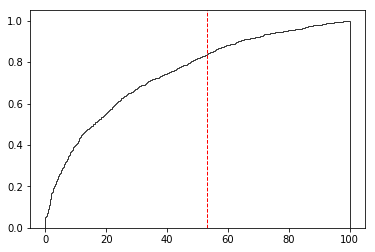

In [150]:
plt.hist(inter_arrivals,bins=500, normed=1, cumulative=True, label='CDF',histtype='step', alpha=0.8, color='k',range=[0,100])
plt.axvline(np.mean(np.array(inter_arrivals)), color='r', linestyle='dashed', linewidth=1)

In [134]:
elapsed_size

[(1366, 2330),
 (1088, 116),
 (4228, 232),
 (1420, 552),
 (332, 436),
 (5208, 2828),
 (5316, 2828),
 (5424, 2828),
 (5718, 2936),
 (6174, 2990),
 (7370, 3106),
 (14920, 2330),
 (2200, 1320),
 (15190, 2708),
 (15298, 2708),
 (3686, 2246),
 (8254, 4082),
 (8544, 4518),
 (4578, 3086),
 (5504, 3202),
 (6322, 3260),
 (15298, 2816),
 (8718, 4518),
 (15298, 2948),
 (15738, 3330),
 (16340, 3536),
 (16942, 3742),
 (17544, 3948),
 (17888, 4654),
 (18232, 5360),
 (19104, 5476),
 (9188, 4724),
 (9658, 4930),
 (10128, 5136),
 (19448, 6128),
 (11224, 5688),
 (6998, 4078),
 (1340, 1150),
 (1684, 1802),
 (8950, 4194),
 (19502, 7856),
 (12100, 8450),
 (19502, 7964),
 (20258, 7964),
 (13844, 8674),
 (14188, 9380),
 (14296, 9380),
 (9568, 4912),
 (9954, 7400),
 (10340, 9888),
 (10502, 9888),
 (14350, 9488),
 (14890, 9488),
 (15762, 9546),
 (15870, 9546),
 (2572, 5054),
 (15978, 9546),
 (2904, 5490),
 (3012, 5490),
 (3606, 5490),
 (1914, 1042),
 (36728, 8018),
 (36836, 8018),
 (11884, 11528),
 (3992, 5602

(0, 1000)

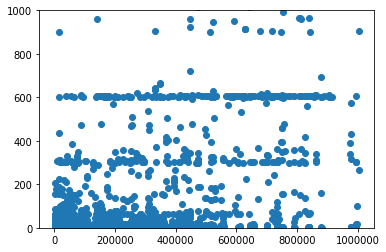

In [145]:
plt.scatter([i[0] for i in elapsed_size], elapsed1)
plt.ylim([0,1000])

In [54]:
elapsed1

[206.33899699999998,
 13.113835000000023,
 43.86362999999997,
 6.368038000000013,
 6.368401000000063,
 10.782392999999956,
 10.783187000000055,
 46.00889799999999,
 46.009045000000015,
 36.750586,
 9.443017000000054,
 1.309340000000077,
 45.64901699999996,
 12.875654999999938,
 603.659119,
 0.9624669999999469,
 0.9649540000000343,
 35.756468999999925,
 35.946236,
 156.97324500000002,
 156.97565400000008,
 66.74036000000001,
 66.92785299999991,
 307.9495139999998,
 308.53882199999975,
 78.48749399999997,
 78.4883960000002,
 10.138104000000112,
 78.35700999999995,
 13.40145399999983,
 32.57486599999993,
 32.57787200000007,
 900.8323280000001,
 43.15182699999991,
 43.152299000000085,
 434.9987449999999,
 435.06635299999994,
 36.69968800000015,
 36.700562999999875,
 1.5709870000000592,
 1.5715060000002268,
 1.4875600000002578,
 1.4881960000000163,
 2.364565000000084,
 2.365144999999984,
 2.4649829999998474,
 2.5541370000000825,
 4.083353999999872,
 4.172984000000042,
 12.652383999999984,
 

/home/jay/.local/lib/python3.5/site-packages/matplotlib/axes/_axes.py:6462: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


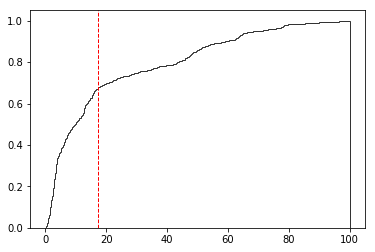

In [70]:
plt.hist(elapsed1,bins=500, normed=1, cumulative=True, label='CDF',histtype='step', alpha=0.8, color='k',range=[0,100])
plt.axvline(np.median(np.array(elapsed1)), color='r', linestyle='dashed', linewidth=1)

In [20]:
(unique_tcps)

[('142.164.6.70', '131.243.1.10', '1313', ' 21'),
 ('131.243.1.10', '142.164.6.70', '21', ' 1313'),
 ('73.6.91.115', '131.243.2.12', '2027', ' 21'),
 ('131.243.2.12', '73.6.91.115', '21', ' 2027'),
 ('82.143.24.12', '131.243.2.12', '3537', ' 21'),
 ('131.243.2.12', '82.143.24.12', '21', ' 3537'),
 ('79.37.53.67', '131.243.2.12', '35280', ' 21'),
 ('131.243.2.12', '79.37.53.67', '21', ' 35280'),
 ('67.243.63.146', '131.243.1.10', '1380', ' 21'),
 ('131.243.1.10', '67.243.63.146', '21', ' 1380'),
 ('67.243.63.146', '131.243.1.10', '1383', ' 21'),
 ('131.243.1.10', '67.243.63.146', '21', ' 1383'),
 ('67.243.63.146', '131.243.1.10', '1385', ' 21'),
 ('131.243.1.10', '67.243.63.146', '21', ' 1385'),
 ('67.243.63.146', '131.243.1.10', '1388', ' 21'),
 ('131.243.1.10', '67.243.63.146', '21', ' 1388'),
 ('67.243.63.146', '131.243.1.10', '1390', ' 21'),
 ('131.243.1.10', '67.243.63.146', '21', ' 1390'),
 ('40.175.116.120', '128.3.12.44', '45958', ' 21'),
 ('128.3.12.44', '40.175.116.120', '21',

In [24]:
times_day1

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0

Text(0,0.5,'Unique TCP connections')

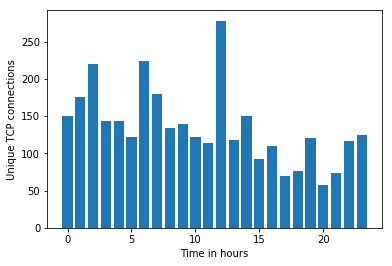

In [34]:
counter = collections.Counter(times_day1)
plt.bar(list(counter.keys()),list(counter.values()))
plt.xlabel("Time in hours")
plt.ylabel("Unique TCP connections")